In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import optuna

# ✅ Check for GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cpu


In [ ]:
""" MODEL STUFF """

# Define LSTM Model
class LSTMModel(nn.Module):
    def __init__(self, input_size, hidden_size=128, num_layers=2, dropout=0.2):
        super(LSTMModel, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True, dropout=dropout)
        self.fc = nn.Linear(hidden_size, 1)

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        return self.fc(lstm_out[:, -1, :])  # Last time step output


# Helper: Create sequences for LSTM
def create_sequences(data, dates, seq_len=30):
    X, y, y_dates = [], [], []
    data_array = data  # Already a NumPy array
    for i in range(len(data_array) - seq_len):
        X.append(data_array[i:i+seq_len])
        y.append(data_array[i+seq_len, 0])
        y_dates.append(dates[i+seq_len])
    return np.array(X), np.array(y), np.array(y_dates)

# Helper: Inverse scale predictions for VN-INDEX (first column)
def inverse_scale_predictions(predictions, scaler):
    num_features = scaler.min_.shape[0]
    dummy = np.zeros((predictions.shape[0], num_features))
    dummy[:, 0] = predictions.flatten()
    return scaler.inverse_transform(dummy)[:, 0]


# Training function only, returns both the model and the overall average training loss across all epochs
def train_model(params, X_train_tensor, y_train_tensor, epochs=20):
    model = LSTMModel(
        input_size=X_train_tensor.shape[2],
        hidden_size=params['hidden_size'],
        num_layers=params['num_layers'],
        dropout=params['dropout']
    ).to(device)
    optimizer = optim.Adam(model.parameters(), lr=params['learning_rate'])
    criterion = nn.MSELoss()
    train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
    train_loader = DataLoader(train_dataset, batch_size=params['batch_size'], shuffle=True)

    epoch_losses = []
    for epoch in range(epochs):
        model.train()
        epoch_loss = 0
        for batch_X, batch_y in train_loader:
            optimizer.zero_grad()
            loss = criterion(model(batch_X), batch_y)
            loss.backward()
            optimizer.step()
            epoch_loss += loss.item()
        avg_loss = epoch_loss / len(train_loader)
        epoch_losses.append(avg_loss)
    overall_avg_loss = np.mean(epoch_losses)
    return model, overall_avg_loss


# Evaluation function (used after tuning)
def evaluate_model(model, test_loader, criterion):
    model.eval()
    val_loss = 0
    with torch.no_grad():
        for batch_X, batch_y in test_loader:
            val_loss += criterion(model(batch_X), batch_y).item()
    return val_loss / len(test_loader)


# Optuna objective: returns the overall average training loss and stores the trained model
def objective(trial, X_train_tensor, y_train_tensor):
    params = {
        'hidden_size': trial.suggest_categorical('hidden_size', [64, 128, 256]),
        'num_layers': trial.suggest_int('num_layers', 1, 1),
        'dropout': trial.suggest_float('dropout', 0.1, 0.5),
        'learning_rate': trial.suggest_float('learning_rate', 1e-4, 1e-2, log=True),
        'batch_size': trial.suggest_categorical('batch_size', [32, 64, 128])
    }
    model, overall_avg_loss = train_model(params, X_train_tensor, y_train_tensor, epochs=50)
    trial.set_user_attr("model", model)
    return overall_avg_loss


# Main pipeline
def lstm_model_pipeline(data, seq_len=30, tuning=True, best_params={'hidden_size': 128, 'num_layers': 2,
    'dropout': 0.3, 'learning_rate': 1e-4, 'batch_size': 32}):

    if isinstance(data, pd.Series):
        data = data.to_frame()

    train_size = int(0.9 * len(data))
    scaler = MinMaxScaler()
    scaler.fit(data[:train_size])
    data_scaled = scaler.transform(data)

    X, y, y_dates = create_sequences(data_scaled, data.index, seq_len)
    X_train, X_test = X[:train_size], X[train_size:]
    y_train, y_test = y[:train_size], y[train_size:]
    y_dates_train, y_dates_test = y_dates[:train_size], y_dates[train_size:]

    X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
    y_train_tensor = torch.tensor(y_train, dtype=torch.float32).reshape(-1, 1).to(device)
    X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
    y_test_tensor = torch.tensor(y_test, dtype=torch.float32).reshape(-1, 1).to(device)

    if tuning:
        study = optuna.create_study(direction='minimize')
        study.optimize(lambda trial: objective(trial, X_train_tensor, y_train_tensor), n_trials=10)
        best_params = study.best_params
        print("Best Hyperparameters:", best_params)
        print(f"Best Overall Average Training Loss: {study.best_value:.4f}")
        final_model = study.best_trial.user_attrs["model"]
    else:
        final_model, overall_avg_loss = train_model(best_params, X_train_tensor, y_train_tensor, epochs=50)
        print(f"Overall Average Training Loss: {overall_avg_loss:.4f}")

    criterion = nn.MSELoss()
    test_dataset = TensorDataset(X_test_tensor, y_test_tensor)
    test_loader = DataLoader(test_dataset, batch_size=best_params['batch_size'], shuffle=False)

    val_loss = evaluate_model(final_model, test_loader, criterion)
    print(f"Final Evaluation Loss on Test Set: {val_loss:.4f}")

    final_model.eval()
    with torch.no_grad():
        y_pred_tensor = final_model(X_test_tensor).cpu().numpy()
        y_true_tensor = y_test_tensor.cpu().numpy()

    y_pred = inverse_scale_predictions(y_pred_tensor, scaler)
    y_true = inverse_scale_predictions(y_true_tensor, scaler)

    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    if len(y_true) > 1:
        directional_accuracy = np.mean(np.sign(np.diff(y_true)) == np.sign(np.diff(y_pred)))
    else:
        directional_accuracy = np.nan

    print(f"RMSE: {rmse:.4f}, MAE: {mae:.4f}, R²: {r2:.4f}, Directional Accuracy: {directional_accuracy:.4f}")

    plt.figure(figsize=(12,6))
    plt.plot(y_dates_test, y_true, label="Actual VN-INDEX", marker='o', color="blue")
    plt.plot(y_dates_test, y_pred, label="Predicted VN-INDEX", marker='s', linestyle="dashed", color="red")
    plt.xlabel("Date")
    plt.ylabel("VN-INDEX")
    plt.xticks(rotation=45)
    plt.legend()
    plt.grid(True, linestyle="--", alpha=0.7)
    plt.title(f"LSTM Predictions vs. Actual VN-INDEX_{seq_len}-day_sequence")
    plt.show()

    results_df = pd.DataFrame({
        "Date": y_dates_test,
        "Actual VN-INDEX": y_true,
        "Predicted VN-INDEX": y_pred
    })
    print("Predicted vs. Actual VN-INDEX (Test Set):")
    print(results_df)

    data_for_prediction = np.array(data_scaled[-seq_len:])
    return final_model, torch.tensor(data_for_prediction, dtype=torch.float32).to(device), scaler, y_pred, y_true, y_dates_test, rmse


# Future Prediction Function
def future_prediction(X_test, y_pred, data, scaler, model, num_days=30, seq_len=30):
    if isinstance(data, pd.Series):
        data = data.to_frame()

    model.eval()
    input_seq = X_test.cpu().numpy()
    future_preds = []
    for _ in range(num_days):
        input_tensor = torch.tensor(input_seq, dtype=torch.float32).unsqueeze(0).to(device)
        with torch.no_grad():
            pred = model(input_tensor).cpu().numpy()[0, 0]
        future_preds.append(pred)
        input_seq = np.roll(input_seq, -1, axis=0)
        input_seq[-1, 0] = pred

    future_preds = inverse_scale_predictions(np.array(future_preds).reshape(-1,1), scaler)
    last_date = data.index[-1]
    future_dates = []
    while len(future_dates) < num_days:
        last_date += pd.Timedelta(days=1)
        if last_date.weekday() < 5:
            future_dates.append(last_date)

    plt.figure(figsize=(12,6))
    plt.plot(future_dates, future_preds, marker='o', linestyle="dashed", color="red", label="Predicted VN-INDEX")
    plt.xlabel("Date")
    plt.ylabel("VN-INDEX")
    plt.xticks(rotation=45)
    plt.legend()
    plt.grid(True, linestyle="--", alpha=0.7)
    plt.title(f"Predicted VN-INDEX for Next {num_days} Trading Days_{seq_len}-day_sequence")
    plt.show()

    historical_dates = data.index[-100:]
    historical_values = data.iloc[-100:, 0].values
    plt.figure(figsize=(12,6))
    plt.plot(historical_dates, historical_values, label="Historical VN-INDEX", color="blue")
    plt.plot(historical_dates, y_pred[-100:], label="Test Predictions", color="red")
    plt.plot(future_dates, future_preds, color="green", label="Future Predicted VN-INDEX")
    plt.xlabel("Date")
    plt.ylabel("VN-INDEX")
    plt.xticks(rotation=45)
    plt.legend()
    plt.grid(True, linestyle="--", alpha=0.7)
    plt.title(f"Historical VN-INDEX with Future Predictions_{seq_len}-day_sequence")
    plt.show()

    future_df = pd.DataFrame({"Date": future_dates, "Predicted VN-INDEX": future_preds})
    print(future_df)

    return future_preds, future_dates

In [3]:
def ensemble_lstm_model(data, seq_len_list=[5, 10, 20, 40, 60]):
    # Dictionaries to store predictions and errors
    predictions_dict = {}
    future_dict = {}
    errors_dict = {}
    ground_truth = None  # will be extracted from one of the pipelines
    y_dates_test = None
    future_dates = None

    for seq_len in seq_len_list:
        print(f"\nTraining LSTM with sequence length = {seq_len}")
        # 🚀 Train the model and get the test set
        model, X_test_tensor, scaler, y_pred, y_true, y_dates_test, rmse = lstm_model_pipeline(data, seq_len=seq_len)

        # 🔮 Generate future predictions
        future_preds, future_dates = future_prediction(X_test_tensor, y_pred, data, scaler, model, num_days=30, seq_len = seq_len)

        predictions_dict[seq_len] = y_pred
        future_dict[seq_len] = future_preds
        
        # Assume all models use the same test set (i.e. y_true is aligned across models)
        if ground_truth is None:
            ground_truth = y_true

        if y_dates_test is None:
            y_dates_test = y_dates_test

        if future_dates is None:
            future_dates = future_dates


        errors_dict[seq_len] = rmse
        print(f"Sequence {seq_len}: RMSE = {rmse:.4f}")

    # Align predictions: Find the minimum length among all prediction arrays (and ground truth)
    all_lengths = [len(arr) for arr in predictions_dict.values()]
    all_lengths.append(len(ground_truth))
    min_len = min(all_lengths)
    print(f"\nMinimum number of samples among models: {min_len}")

    # Trim each predictions array and ground truth to the latest min_len entries
    for seq in seq_len_list:
        predictions_dict[seq] = predictions_dict[seq][-min_len:]
    ground_truth = ground_truth[-min_len:]
    y_dates_test = y_dates_test[-min_len:]

        # Compute weights inversely proportional to RMSE
    epsilon = 1e-6  # small number to prevent division by zero
    inv_errors = {seq: 1.0 / (errors_dict[seq] + epsilon) for seq in seq_len_list}
    total_inv = sum(inv_errors.values())
    weights = {seq: inv_errors[seq] / total_inv for seq in seq_len_list}

    print("\nModel weights based on inverse RMSE:")
    for seq in seq_len_list:
        print(f"Sequence {seq}: weight = {weights[seq]:.3f}")

    # Compute the weighted average ensemble prediction
    ensemble_preds = np.zeros_like(ground_truth, dtype=float)
    for seq in seq_len_list:
        ensemble_preds += weights[seq] * predictions_dict[seq]

    ensemble_rmse = np.sqrt(mean_squared_error(ground_truth, ensemble_preds))
    print(f"\nEnsemble RMSE (weighted average): {ensemble_rmse:.4f}")

    # Compute additional metrics: MAE and Directional Accuracy for ensemble predictions
    ensemble_mae = np.mean(np.abs(ground_truth - ensemble_preds))
    ensemble_r2 = r2_score(ground_truth, ensemble_preds)
    if len(ground_truth) > 1:
        ensemble_directional_accuracy = np.mean(np.sign(np.diff(ground_truth)) == np.sign(np.diff(ensemble_preds)))
    else:
        ensemble_directional_accuracy = np.nan

    print(f"\nEnsemble RMSE (weighted average): {ensemble_rmse:.4f}")
    print(f"Ensemble MAE (weighted average): {ensemble_mae:.4f}")
    print(f"Ensemble R² (weighted average): {ensemble_r2:.4f}")
    print(f"Ensemble Directional Accuracy (weighted average): {ensemble_directional_accuracy:.4f}")


    plt.figure(figsize=(12,6))
    plt.plot(y_dates_test, ground_truth, label="Actual VN-INDEX", marker='o', color="blue")
    plt.plot(y_dates_test, ensemble_preds, label="Predicted VN-INDEX", marker='s', linestyle="dashed", color="red")
    plt.xlabel("Date")
    plt.ylabel("VN-INDEX")
    plt.xticks(rotation=45)
    plt.legend()
    plt.grid(True, linestyle="--", alpha=0.7)
    plt.title("LSTM Predictions vs. Actual VN-INDEX")
    plt.show()

    results_df = pd.DataFrame({
        "Date": y_dates_test,
        "Actual VN-INDEX": ground_truth,
        "Predicted VN-INDEX": ensemble_preds
    })
    print("Predicted vs. Actual VN-INDEX (Test Set):")
    print(results_df)

    # Compute the weighted average future prediction
    ensemble_future_preds = np.zeros_like(future_dict[seq_len_list[0]], dtype=float)
    for seq in seq_len_list:
        ensemble_future_preds += weights[seq] * future_dict[seq]

    plt.figure(figsize=(12,6))
    plt.plot(future_dates, ensemble_future_preds, marker='o', linestyle="dashed", color="red", label="Predicted VN-INDEX")
    plt.xlabel("Date")
    plt.ylabel("VN-INDEX")
    plt.xticks(rotation=45)
    plt.legend()
    plt.grid(True, linestyle="--", alpha=0.7)
    plt.title(f"Predicted VN-INDEX for Next {len(ensemble_future_preds)} Trading Days")
    plt.show()

    historical_dates = data.index[-100:]
    if isinstance(data, pd.Series):
        historical_values = data.iloc[-100:].values
    else:
        historical_values = data.iloc[-100:, 0].values 
    plt.figure(figsize=(12,6))
    plt.plot(historical_dates, historical_values, label="Historical VN-INDEX", color="blue")
    plt.plot(historical_dates, ensemble_preds[-100:], label="Test Predictions", color="red")
    plt.plot(future_dates, ensemble_future_preds, color="green", label="Future Predicted VN-INDEX")
    plt.xlabel("Date")
    plt.ylabel("VN-INDEX")
    plt.xticks(rotation=45)
    plt.legend()
    plt.grid(True, linestyle="--", alpha=0.7)
    plt.title("Historical VN-INDEX with Future Predictions")
    plt.show()

    print(f"\nEnsemble Future Predictions (weighted average) for next {len(ensemble_future_preds)} days:")
    ensemble_future_df = pd.DataFrame({
        "Date": future_dates, 
        "Predicted Future VN-INDEX": ensemble_future_preds
    })
    print(ensemble_future_df)

In [4]:
# =============================================================================
# FEATURE ENGINEERING FUNCTIONS
# =============================================================================

def compute_RSI(series, window=14):
    """
    Compute the Relative Strength Index (RSI) for a time-series.
    
    Args:
        series (pd.Series): Series of prices.
        window (int): Window size.
    
    Returns:
        pd.Series: RSI values.
    """
    delta = series.diff(1)
    gain = delta.where(delta > 0, 0).rolling(window).mean()
    loss = (-delta.where(delta < 0, 0)).rolling(window).mean()
    RS = gain / loss
    return 100 - (100 / (1 + RS))


def lag_features_indicators(df, numerical_columns):
    """
    Generate lag features, moving averages, RSI, MACD, volatility, seasonality,
    and interaction features.
    
    Args:
        df (pd.DataFrame): Input data.
        numerical_columns (list): List of numerical column names.
    
    Returns:
        pd.DataFrame: DataFrame with additional features.
    """
    copy_df = df.copy()
    # Lagged Features
    lag_days = [1, 2, 3, 5, 10]
    for col in numerical_columns:
        for lag in lag_days:
            copy_df[f'{col}_Lag{lag}'] = copy_df[col].shift(lag)
    
    # Moving Averages and Exponential Moving Averages
    for col in numerical_columns:
        copy_df[f'{col}_SMA_10'] = copy_df[col].rolling(window=10).mean()
        copy_df[f'{col}_SMA_20'] = copy_df[col].rolling(window=20).mean()
        copy_df[f'{col}_EMA_10'] = copy_df[col].ewm(span=10, adjust=False).mean()
        copy_df[f'{col}_EMA_20'] = copy_df[col].ewm(span=20, adjust=False).mean()
    
    # Relative Strength Index (RSI)
    for col in numerical_columns:
        copy_df[f'{col}_RSI_14'] = compute_RSI(copy_df[col])
    
    # Moving Average Convergence Divergence (MACD)
    for col in numerical_columns:
        copy_df[f'{col}_EMA_12'] = copy_df[col].ewm(span=12, adjust=False).mean()
        copy_df[f'{col}_EMA_26'] = copy_df[col].ewm(span=26, adjust=False).mean()
        copy_df[f'{col}_MACD'] = copy_df[f'{col}_EMA_12'] - copy_df[f'{col}_EMA_26']
    
    # Additional Feature: Rolling Standard Deviation for Volatility
    for col in numerical_columns:
        copy_df[f'{col}_RollingStd_10'] = copy_df[col].rolling(window=10).std()
    
    # Seasonality Features: Day of Week and Month
    copy_df['DayOfWeek'] = copy_df.index.dayofweek
    copy_df['Month'] = copy_df.index.month
    
    # Interaction Feature: Ratio of EMA_10 to EMA_20
    for col in numerical_columns:
        copy_df[f'{col}_EMA_Ratio'] = copy_df[f'{col}_EMA_10'] / copy_df[f'{col}_EMA_20']
    
    # Drop NA values caused by shifting and rolling
    copy_df.dropna(inplace=True)
    
    return copy_df


def quicky_data(df):
    """
    Preprocess the data by converting the 'Date' column to datetime,
    setting it as index, and dropping unnecessary columns.
    
    Args:
        df (pd.DataFrame): Raw data.
    
    Returns:
        pd.DataFrame: Preprocessed data.
    """
    df['Date'] = pd.to_datetime(df['Date'])
    df.set_index('Date', inplace=True)
    
    if 'Index' in df.columns:
        df.drop(columns=['Index'], inplace=True)
    
    return df

def select_features_by_correlation(df, target_col="VN_Index_Close", train_ratio=0.9, corr_threshold=0.05):
    """
    Splits the DataFrame by time (first train_ratio% of rows is 'training'),
    calculates correlation of each feature with the target on TRAIN rows only,
    and returns the subset of columns (target + selected features).
    
    Args:
        df (pd.DataFrame): Full dataset (includes the target column).
        target_col (str): Target column name, default = "VN_Index_Close".
        train_ratio (float): Proportion of data used for 'training'.
        corr_threshold (float): Minimum absolute correlation needed to keep a feature.
    
    Returns:
        pd.DataFrame: A filtered DataFrame with only 'target_col' + selected features.
    """
    # Sort by index if needed (assuming your index is Date or similar)
    df = df.sort_index()
    n_train = int(len(df) * train_ratio)
    
    # TRAIN portion (first 90% by default)
    df_train = df.iloc[:n_train]
    
    # Identify all potential features (exclude the target itself)
    all_features = [col for col in df.columns if col != target_col]
    
    # Calculate absolute correlation with the target on the training portion only
    corr_series = df_train[all_features].corrwith(df_train[target_col]).abs()
    
    # Filter by threshold
    selected_features = corr_series[corr_series >= corr_threshold].index.tolist()
    
    print(f"Features with abs(corr) >= {corr_threshold}:")
    print(selected_features)
    
    # Return only target + selected features
    return df[[target_col] + selected_features]

In [5]:
# 📂 Load dataset
file_path_1 = "../ready_data/cleaned_vn_index_historical_data.csv"
df_1 = pd.read_csv(file_path_1)
df_1 = quicky_data(df_1)

[I 2025-04-14 14:43:51,227] A new study created in memory with name: no-name-6f1905f2-7ddb-4572-8862-fd4f03199238



Training LSTM with sequence length = 5


/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.16306878074823847 and num_layers=1
  warnings.warn(
[I 2025-04-14 14:44:06,377] Trial 0 finished with value: 0.0007493688937472598 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.16306878074823847, 'learning_rate': 0.0008855670722307971, 'batch_size': 32}. Best is trial 0 with value: 0.0007493688937472598.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3851967135117473 and num_layers=1
  warnings.warn(
[I 2025-04-14 14:44:23,522] Trial 1 finished with value: 0.0005904726998608112 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.3851967135117473, 'learning_ra

Best Hyperparameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.4451075167086901, 'learning_rate': 0.00978673313637201, 'batch_size': 32}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0002
RMSE: 13.4926, MAE: 8.7692, R²: 0.9575, Directional Accuracy: 0.5335


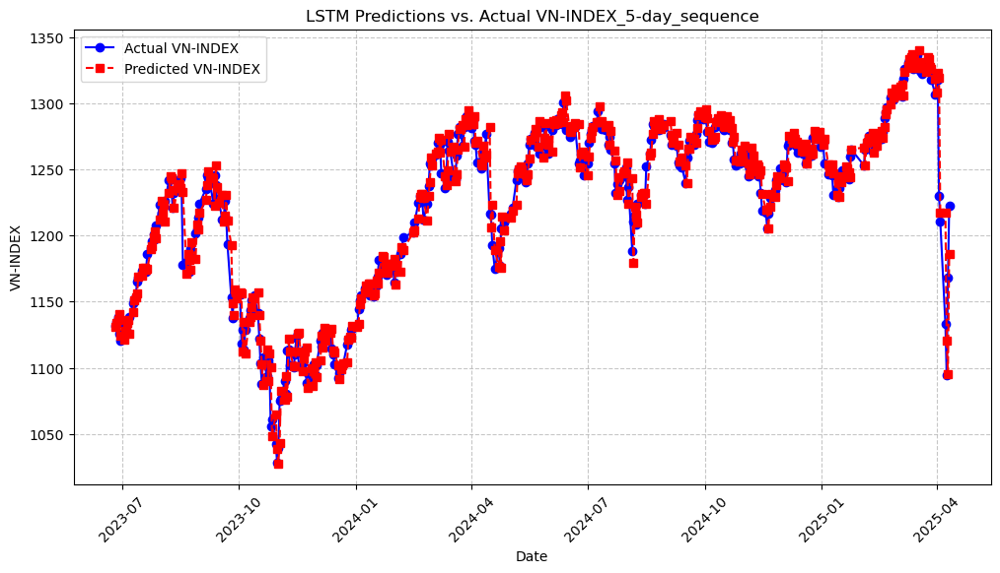

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-06-26      1132.029991         1130.921989
1   2023-06-27      1134.330002         1133.536921
2   2023-06-28      1138.349975         1135.846721
3   2023-06-29      1125.389999         1140.268244
4   2023-06-30      1120.180020         1123.950816
..         ...              ...                 ...
444 2025-04-04      1210.670016         1217.077633
445 2025-04-08      1132.790007         1217.282184
446 2025-04-09      1094.299993         1120.378868
447 2025-04-10      1168.339995         1095.430962
448 2025-04-11      1222.460024         1186.195338

[449 rows x 3 columns]


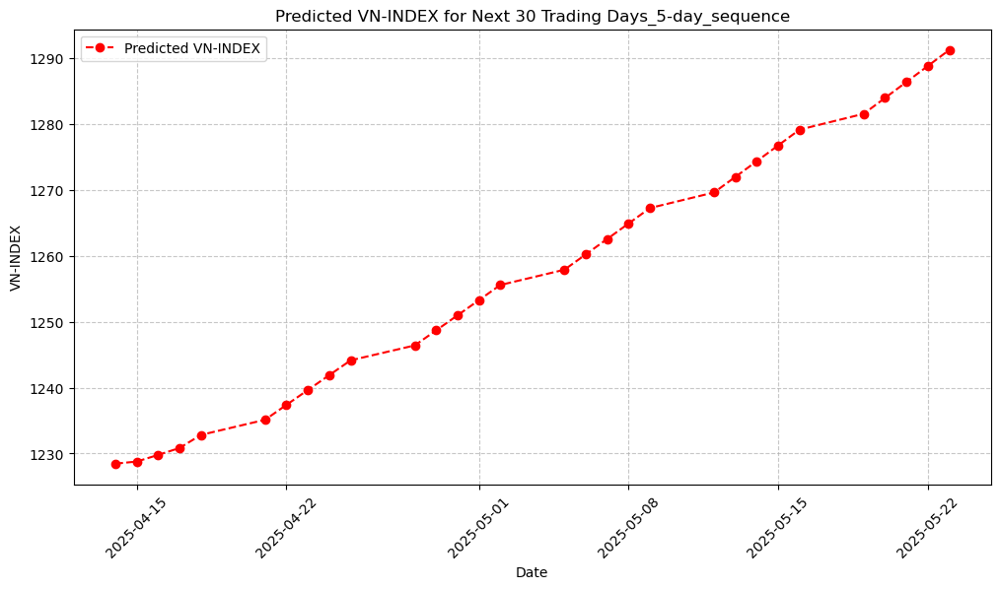

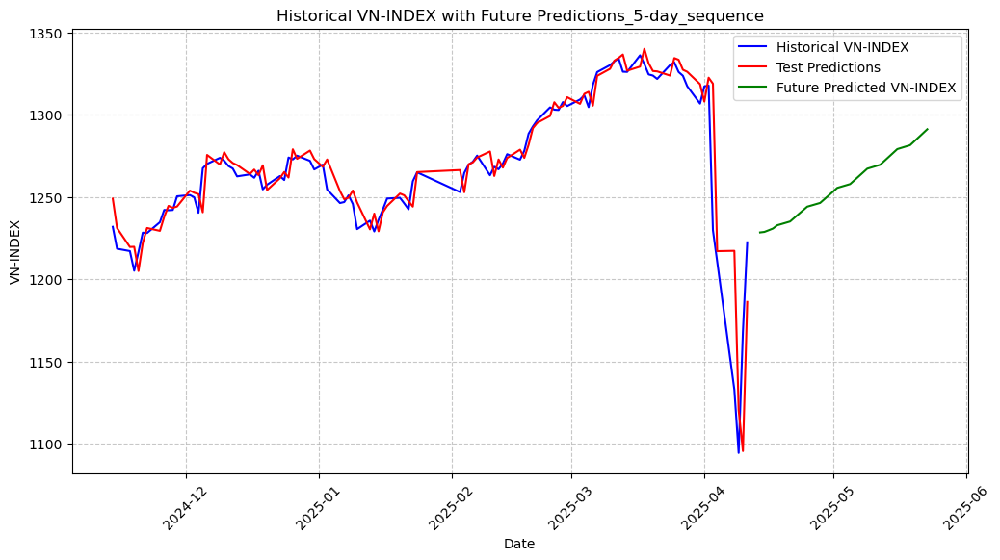

[I 2025-04-14 14:45:48,125] A new study created in memory with name: no-name-9a89da6d-bb4b-455d-93ad-ee797574c893


         Date  Predicted VN-INDEX
0  2025-04-14         1228.461697
1  2025-04-15         1228.780316
2  2025-04-16         1229.787352
3  2025-04-17         1230.841942
4  2025-04-18         1232.822486
5  2025-04-21         1235.120108
6  2025-04-22         1237.381044
7  2025-04-23         1239.633733
8  2025-04-24         1241.884727
9  2025-04-25         1244.138340
10 2025-04-28         1246.402976
11 2025-04-29         1248.679172
12 2025-04-30         1250.966081
13 2025-05-01         1253.263396
14 2025-05-02         1255.570575
15 2025-05-05         1257.887697
16 2025-05-06         1260.214453
17 2025-05-07         1262.550612
18 2025-05-08         1264.896020
19 2025-05-09         1267.250369
20 2025-05-12         1269.613580
21 2025-05-13         1271.985424
22 2025-05-14         1274.365592
23 2025-05-15         1276.753929
24 2025-05-16         1279.150128
25 2025-05-19         1281.554034
26 2025-05-20         1283.965339
27 2025-05-21         1286.383889
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.39808863758206453 and num_layers=1
  warnings.warn(
[I 2025-04-14 14:46:17,061] Trial 0 finished with value: 0.0010819863432675447 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.39808863758206453, 'learning_rate': 0.0006908421361341844, 'batch_size': 64}. Best is trial 0 with value: 0.0010819863432675447.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2910862245087808 and num_layers=1
  warnings.warn(
[I 2025-04-14 14:46:36,024] Trial 1 finished with value: 0.00037512091351374013 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.2910862245087808, 'learning_r

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.4906102099248537, 'learning_rate': 0.004189975109362662, 'batch_size': 32}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0002
RMSE: 18.6887, MAE: 15.6253, R²: 0.9174, Directional Accuracy: 0.5350


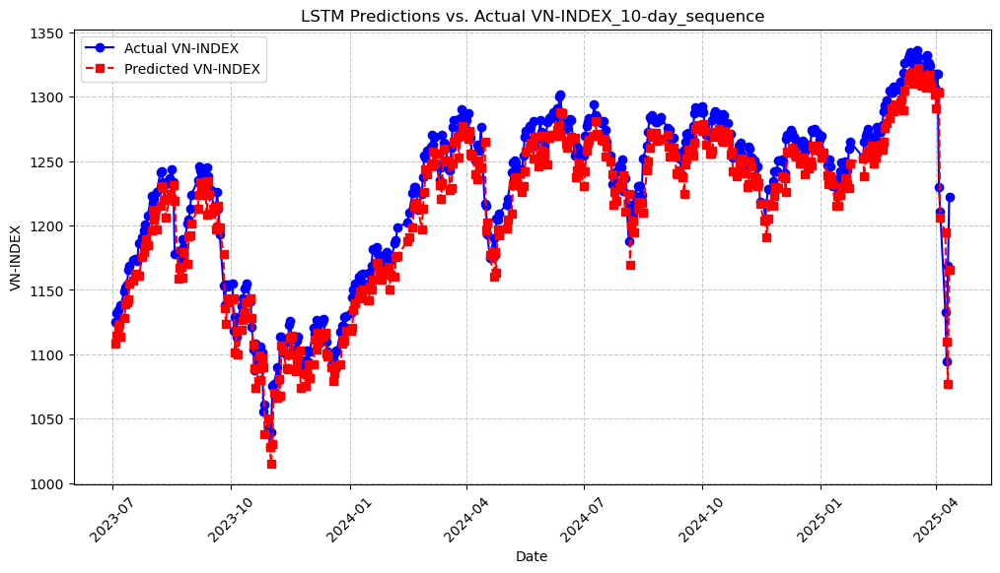

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-03      1125.499982         1107.985688
1   2023-07-04      1132.000009         1114.646797
2   2023-07-05      1134.620028         1121.342589
3   2023-07-06      1126.219998         1123.494158
4   2023-07-07      1138.069969         1113.631746
..         ...              ...                 ...
439 2025-04-04      1210.670016         1206.185756
440 2025-04-08      1132.790007         1194.689320
441 2025-04-09      1094.299993         1109.674203
442 2025-04-10      1168.339995         1076.746622
443 2025-04-11      1222.460024         1165.678511

[444 rows x 3 columns]


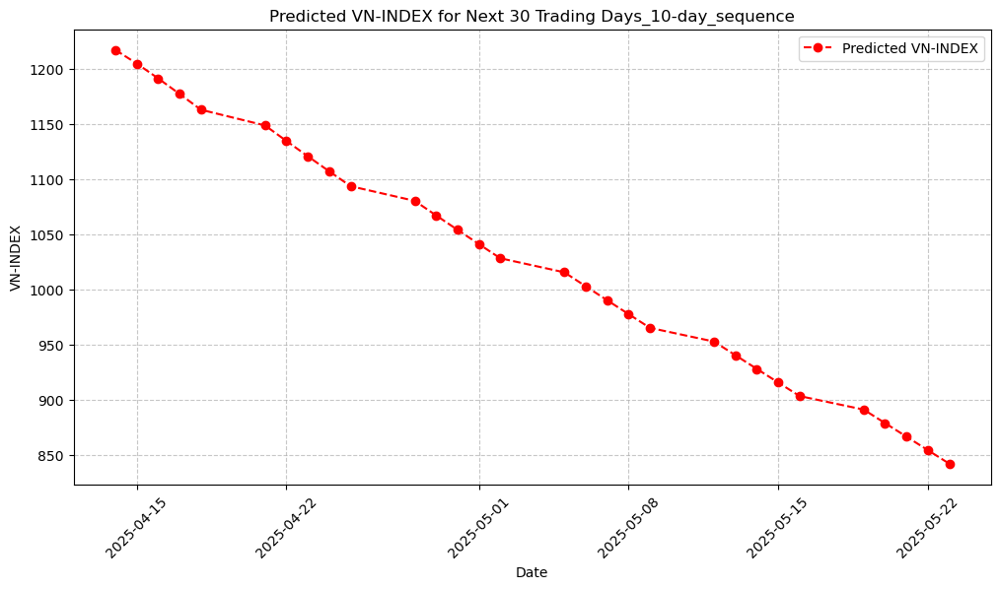

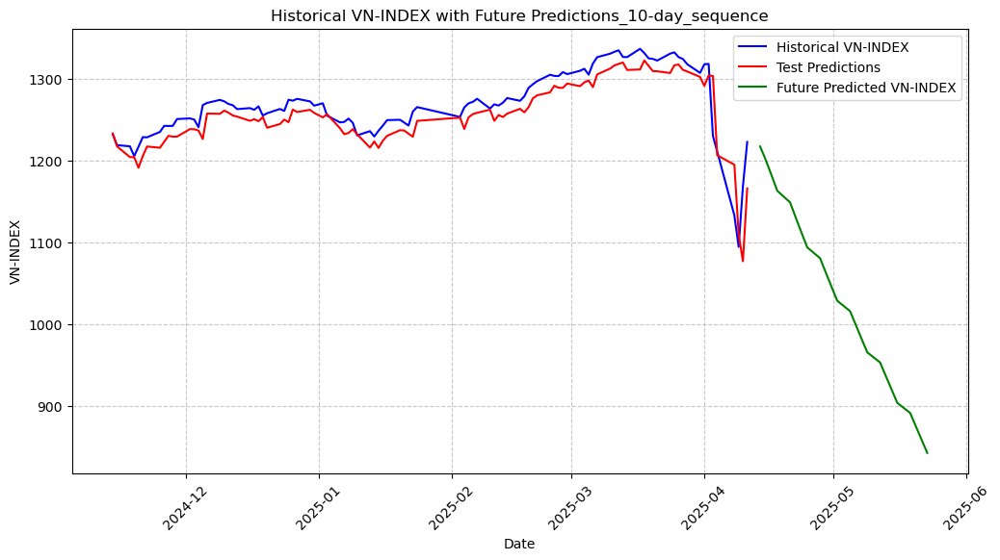

[I 2025-04-14 14:49:28,234] A new study created in memory with name: no-name-b2e3fa27-7100-496e-9c60-ff30710b0e06


         Date  Predicted VN-INDEX
0  2025-04-14         1216.949768
1  2025-04-15         1204.619094
2  2025-04-16         1191.198607
3  2025-04-17         1177.122307
4  2025-04-18         1162.846696
5  2025-04-21         1148.605228
6  2025-04-22         1134.539178
7  2025-04-23         1120.704271
8  2025-04-24         1107.086554
9  2025-04-25         1093.644950
10 2025-04-28         1080.353329
11 2025-04-29         1067.195739
12 2025-04-30         1054.158999
13 2025-05-01         1041.231394
14 2025-05-02         1028.402289
15 2025-05-05         1015.661971
16 2025-05-06         1003.001347
17 2025-05-07          990.412016
18 2025-05-08          977.886038
19 2025-05-09          965.416093
20 2025-05-12          952.995089
21 2025-05-13          940.616629
22 2025-05-14          928.274548
23 2025-05-15          915.963450
24 2025-05-16          903.678557
25 2025-05-19          891.414858
26 2025-05-20          879.168463
27 2025-05-21          866.935363
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.28912334356726865 and num_layers=1
  warnings.warn(
[I 2025-04-14 14:49:52,984] Trial 0 finished with value: 0.0044699632304491385 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.28912334356726865, 'learning_rate': 0.00021169869248327284, 'batch_size': 128}. Best is trial 0 with value: 0.0044699632304491385.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4179160400849239 and num_layers=1
  warnings.warn(
[I 2025-04-14 14:50:05,583] Trial 1 finished with value: 0.002582646278233369 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.4179160400849239, 'learning_ra

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.4547960280187998, 'learning_rate': 0.00804341177619463, 'batch_size': 64}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0001
RMSE: 13.6722, MAE: 9.0966, R²: 0.9551, Directional Accuracy: 0.5219


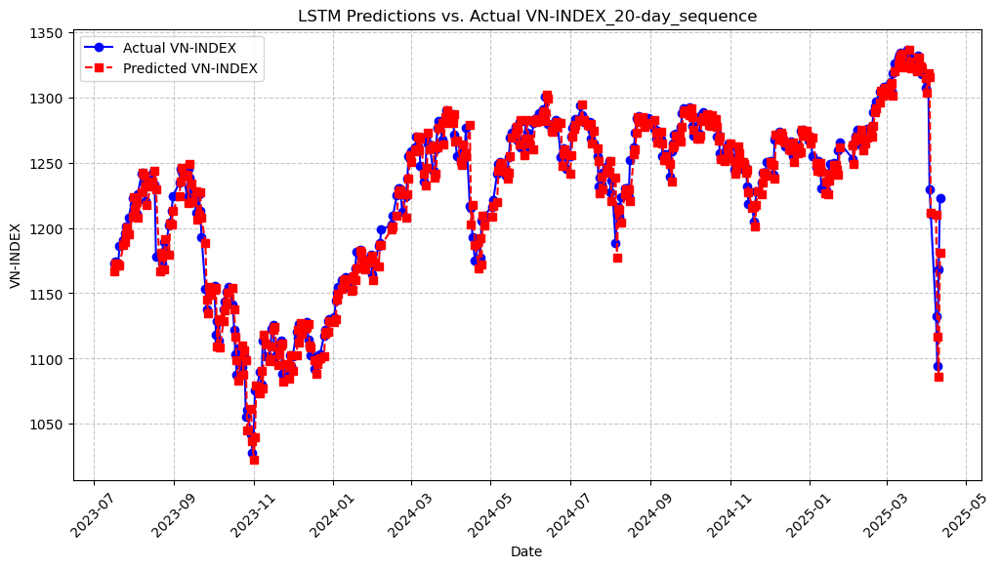

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-17      1173.130004         1166.862661
1   2023-07-18      1174.090025         1172.486136
2   2023-07-19      1172.980020         1172.815315
3   2023-07-20      1172.809997         1171.215665
4   2023-07-21      1185.899994         1171.321332
..         ...              ...                 ...
429 2025-04-04      1210.670016         1211.852624
430 2025-04-08      1132.790007         1210.464154
431 2025-04-09      1094.299993         1116.698094
432 2025-04-10      1168.339995         1086.036074
433 2025-04-11      1222.460024         1180.625582

[434 rows x 3 columns]


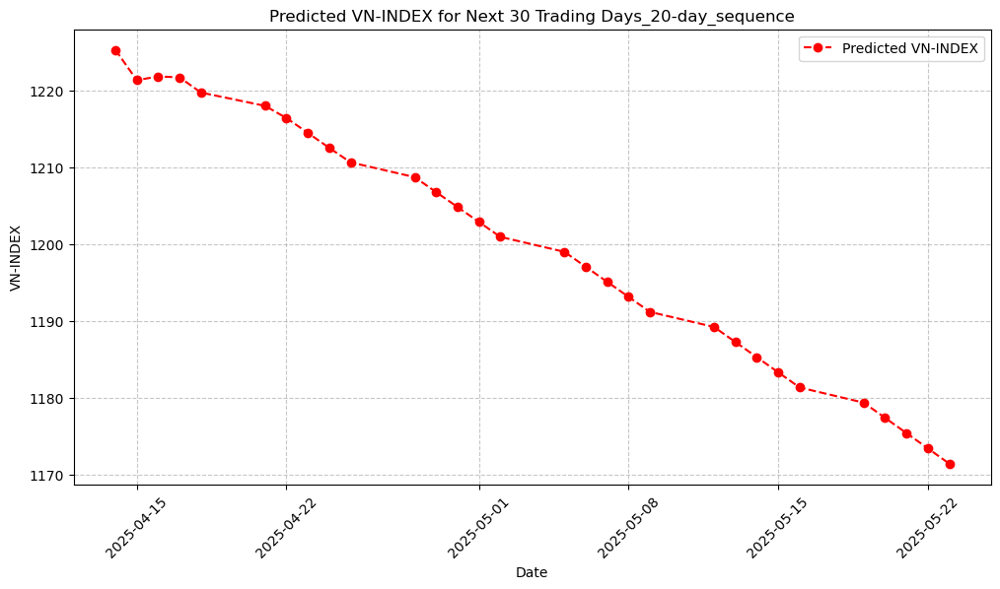

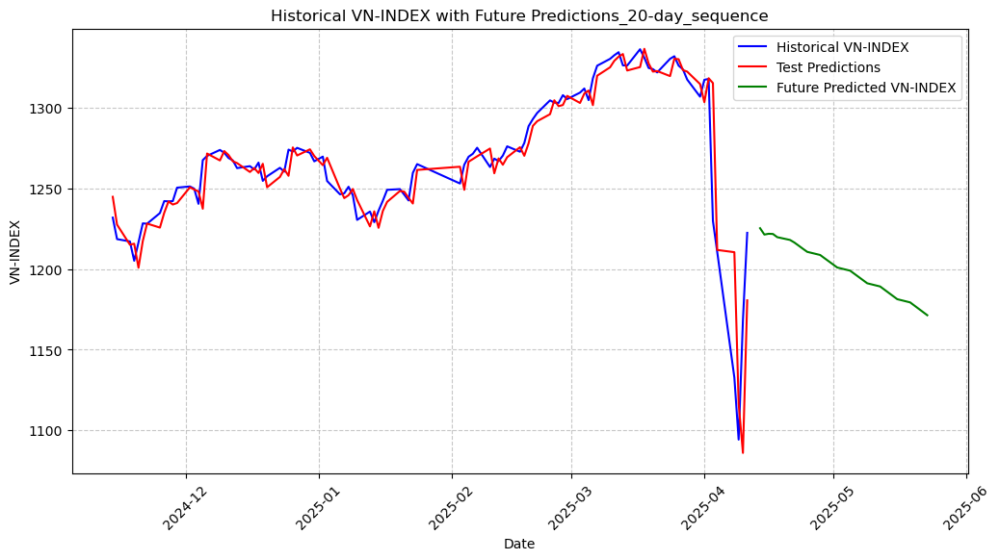

[I 2025-04-14 14:53:17,458] A new study created in memory with name: no-name-ffa4146a-d09f-423b-835d-e5e7fc8fb262


         Date  Predicted VN-INDEX
0  2025-04-14         1225.324364
1  2025-04-15         1221.385627
2  2025-04-16         1221.874809
3  2025-04-17         1221.750644
4  2025-04-18         1219.774108
5  2025-04-21         1218.036883
6  2025-04-22         1216.443399
7  2025-04-23         1214.518887
8  2025-04-24         1212.562697
9  2025-04-25         1210.672945
10 2025-04-28         1208.742884
11 2025-04-29         1206.791473
12 2025-04-30         1204.852317
13 2025-05-01         1202.910001
14 2025-05-02         1200.960208
15 2025-05-05         1199.009645
16 2025-05-06         1197.057464
17 2025-05-07         1195.101429
18 2025-05-08         1193.142311
19 2025-05-09         1191.180804
20 2025-05-12         1189.216445
21 2025-05-13         1187.249234
22 2025-05-14         1185.279094
23 2025-05-15         1183.305795
24 2025-05-16         1181.329413
25 2025-05-19         1179.349870
26 2025-05-20         1177.367168
27 2025-05-21         1175.381228
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.21205582541013648 and num_layers=1
  warnings.warn(
[I 2025-04-14 14:53:49,487] Trial 0 finished with value: 0.0019459028490973651 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.21205582541013648, 'learning_rate': 0.0006090022292038283, 'batch_size': 64}. Best is trial 0 with value: 0.0019459028490973651.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4321786189823141 and num_layers=1
  warnings.warn(
[I 2025-04-14 14:56:30,269] Trial 1 finished with value: 0.00043498008950010103 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.4321786189823141, 'learning_ra

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.4321786189823141, 'learning_rate': 0.0012795123943840055, 'batch_size': 32}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0001
RMSE: 14.5965, MAE: 10.3225, R²: 0.9507, Directional Accuracy: 0.5254


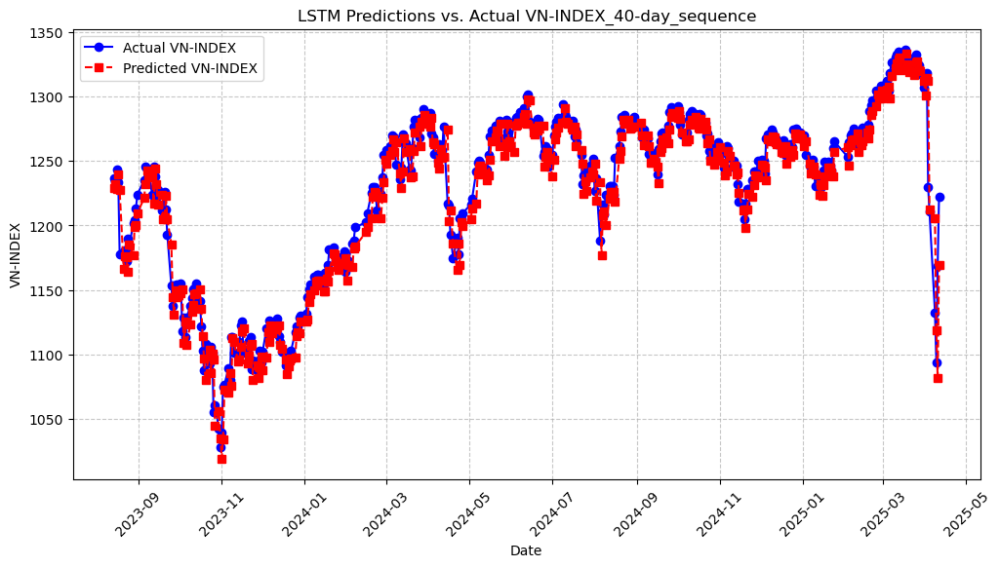

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-08-14      1236.839992         1229.314663
1   2023-08-15      1234.050027         1231.985550
2   2023-08-16      1243.260017         1227.892513
3   2023-08-17      1233.479995         1239.797436
4   2023-08-18      1177.989995         1227.392386
..         ...              ...                 ...
409 2025-04-04      1210.670016         1212.149509
410 2025-04-08      1132.790007         1205.597535
411 2025-04-09      1094.299993         1118.565187
412 2025-04-10      1168.339995         1081.680064
413 2025-04-11      1222.460024         1169.050300

[414 rows x 3 columns]


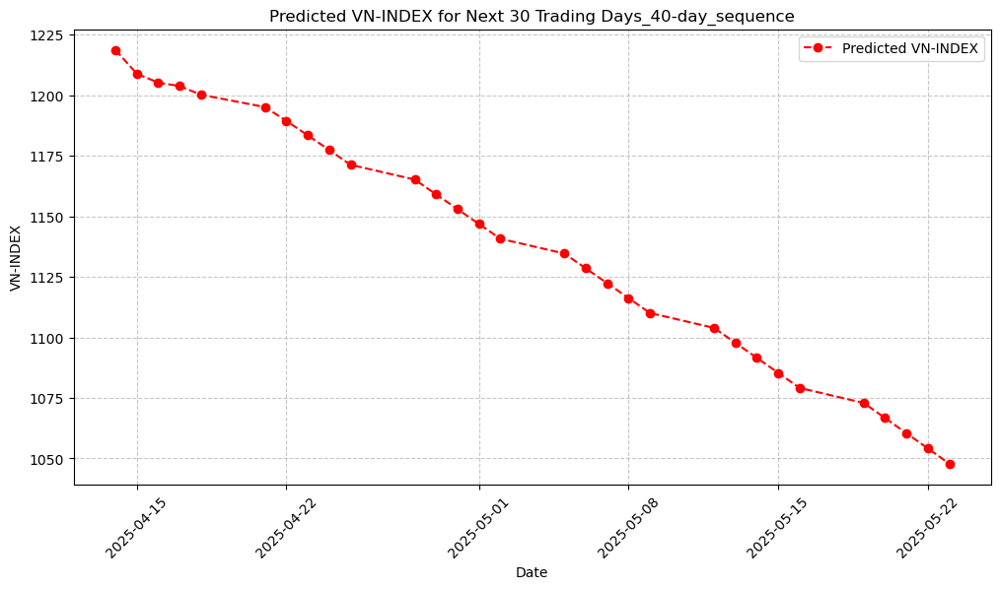

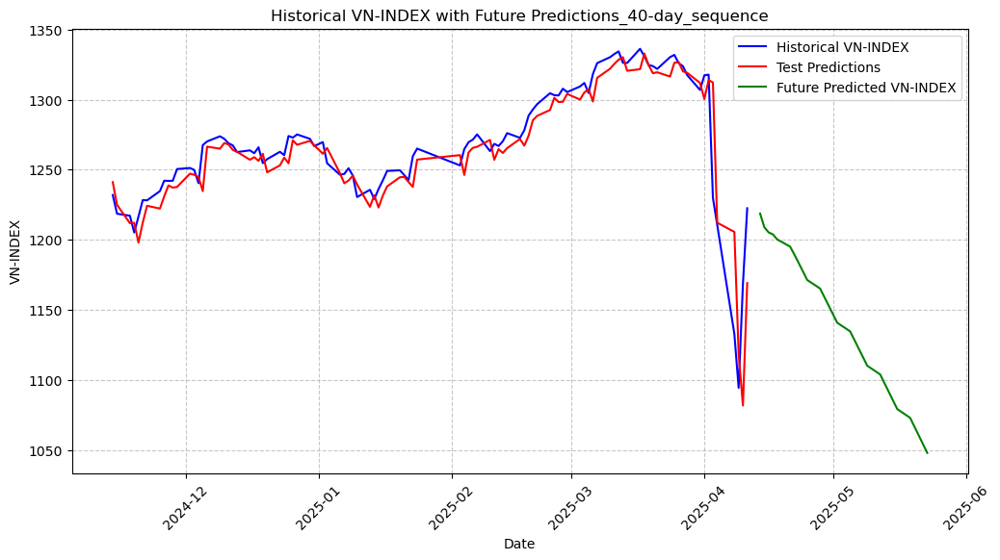

[I 2025-04-14 15:06:39,170] A new study created in memory with name: no-name-6b870eb5-3604-4be0-a710-c3af50f21186


         Date  Predicted VN-INDEX
0  2025-04-14         1218.713815
1  2025-04-15         1208.892713
2  2025-04-16         1205.216872
3  2025-04-17         1203.807747
4  2025-04-18         1200.217456
5  2025-04-21         1195.107286
6  2025-04-22         1189.389242
7  2025-04-23         1183.429651
8  2025-04-24         1177.370636
9  2025-04-25         1171.276476
10 2025-04-28         1165.173529
11 2025-04-29         1159.069349
12 2025-04-30         1152.964707
13 2025-05-01         1146.857984
14 2025-05-02         1140.747253
15 2025-05-05         1134.630587
16 2025-05-06         1128.506599
17 2025-05-07         1122.374134
18 2025-05-08         1116.232188
19 2025-05-09         1110.079915
20 2025-05-12         1103.916620
21 2025-05-13         1097.741610
22 2025-05-14         1091.554345
23 2025-05-15         1085.354287
24 2025-05-16         1079.140817
25 2025-05-19         1072.913552
26 2025-05-20         1066.671643
27 2025-05-21         1060.414858
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2221343306563068 and num_layers=1
  warnings.warn(
[I 2025-04-14 15:08:14,126] Trial 0 finished with value: 0.000432513440177047 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.2221343306563068, 'learning_rate': 0.006094802097470135, 'batch_size': 32}. Best is trial 0 with value: 0.000432513440177047.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1763891947966296 and num_layers=1
  warnings.warn(
[I 2025-04-14 15:13:02,688] Trial 1 finished with value: 0.00046377101885383356 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.1763891947966296, 'learning_rate': 

Best Hyperparameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.46419006236868277, 'learning_rate': 0.004184114740264559, 'batch_size': 32}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0003
RMSE: 21.4829, MAE: 18.5834, R²: 0.8975, Directional Accuracy: 0.5242


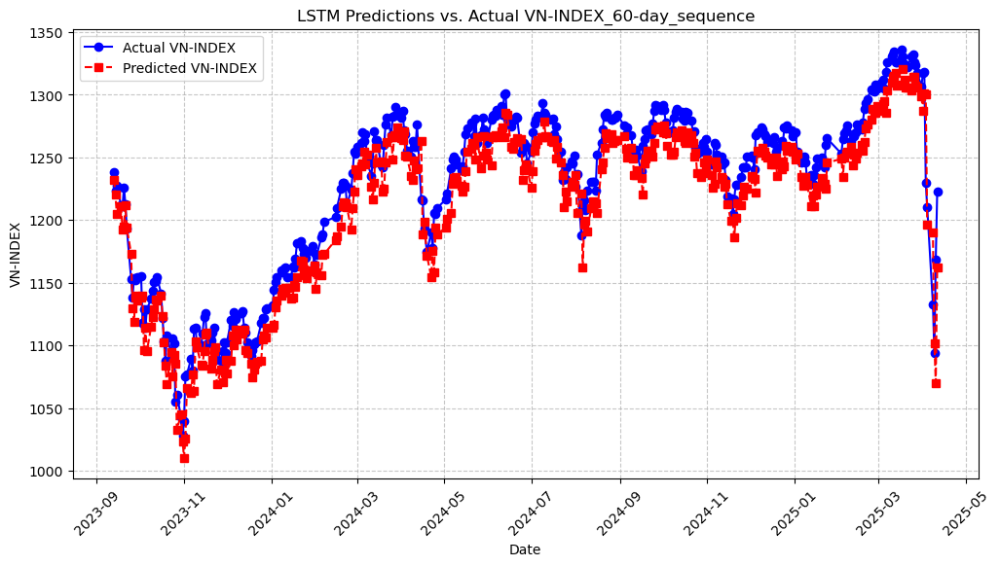

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-13      1238.390007         1232.322282
1   2023-09-14      1223.810034         1220.101128
2   2023-09-15      1227.360016         1204.622716
3   2023-09-18      1211.810003         1211.080969
4   2023-09-19      1211.500015         1192.145603
..         ...              ...                 ...
389 2025-04-04      1210.670016         1196.459147
390 2025-04-08      1132.790007         1189.873569
391 2025-04-09      1094.299993         1101.317796
392 2025-04-10      1168.339995         1070.201970
393 2025-04-11      1222.460024         1162.504338

[394 rows x 3 columns]


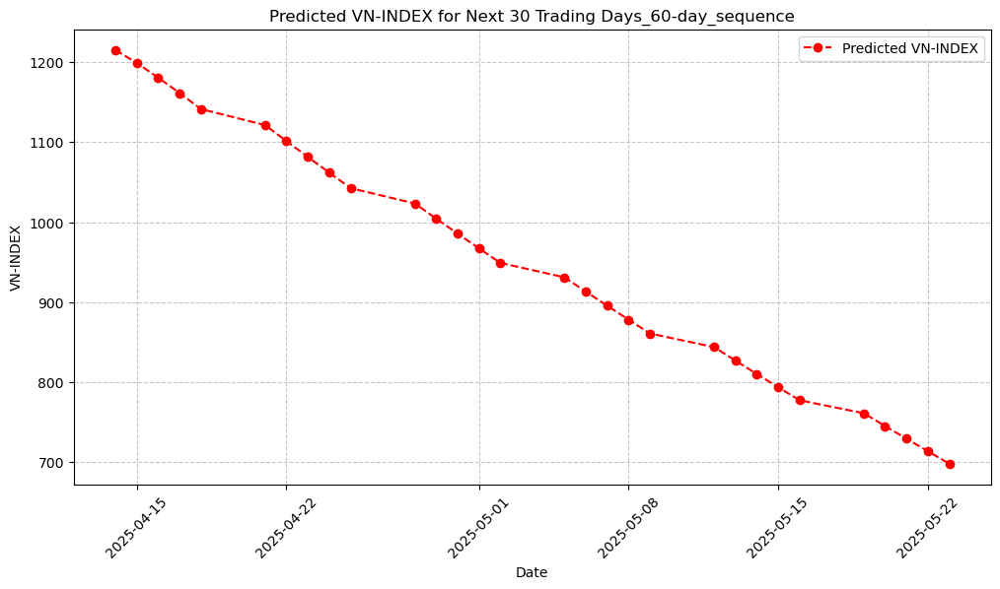

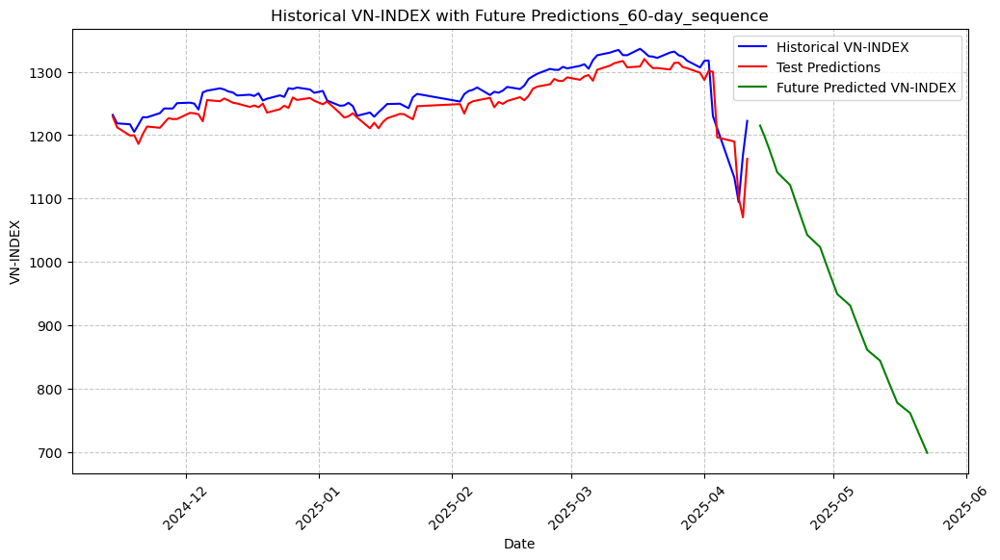

         Date  Predicted VN-INDEX
0  2025-04-14         1215.075199
1  2025-04-15         1198.719157
2  2025-04-16         1180.556679
3  2025-04-17         1161.192402
4  2025-04-18         1141.266570
5  2025-04-21         1121.203241
6  2025-04-22         1101.215906
7  2025-04-23         1081.402601
8  2025-04-24         1061.805794
9  2025-04-25         1042.440977
10 2025-04-28         1023.311079
11 2025-04-29         1004.413016
12 2025-04-30          985.741239
13 2025-05-01          967.289737
14 2025-05-02          949.052267
15 2025-05-05          931.023201
16 2025-05-06          913.197378
17 2025-05-07          895.570017
18 2025-05-08          878.136687
19 2025-05-09          860.893535
20 2025-05-12          843.836823
21 2025-05-13          826.963274
22 2025-05-14          810.269691
23 2025-05-15          793.753337
24 2025-05-16          777.411554
25 2025-05-19          761.241913
26 2025-05-20          745.242063
27 2025-05-21          729.410002
28 2025-05-22 

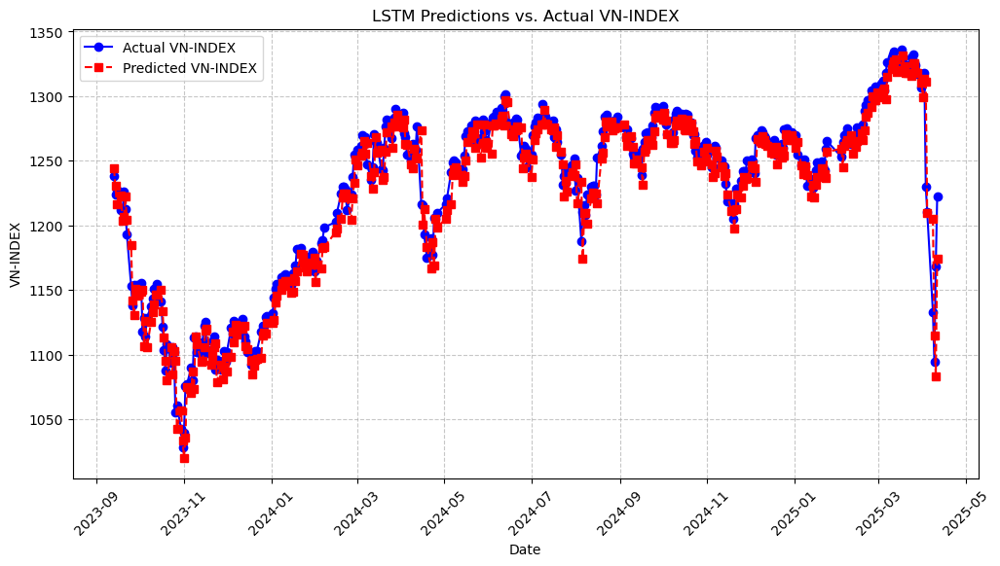

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-13      1238.390007         1243.957366
1   2023-09-14      1223.810034         1230.501284
2   2023-09-15      1227.360016         1216.140451
3   2023-09-18      1211.810003         1222.916749
4   2023-09-19      1211.500015         1203.336305
..         ...              ...                 ...
389 2025-04-04      1210.670016         1209.914248
390 2025-04-08      1132.790007         1205.300983
391 2025-04-09      1094.299993         1114.509975
392 2025-04-10      1168.339995         1083.388222
393 2025-04-11      1222.460024         1174.218401

[394 rows x 3 columns]


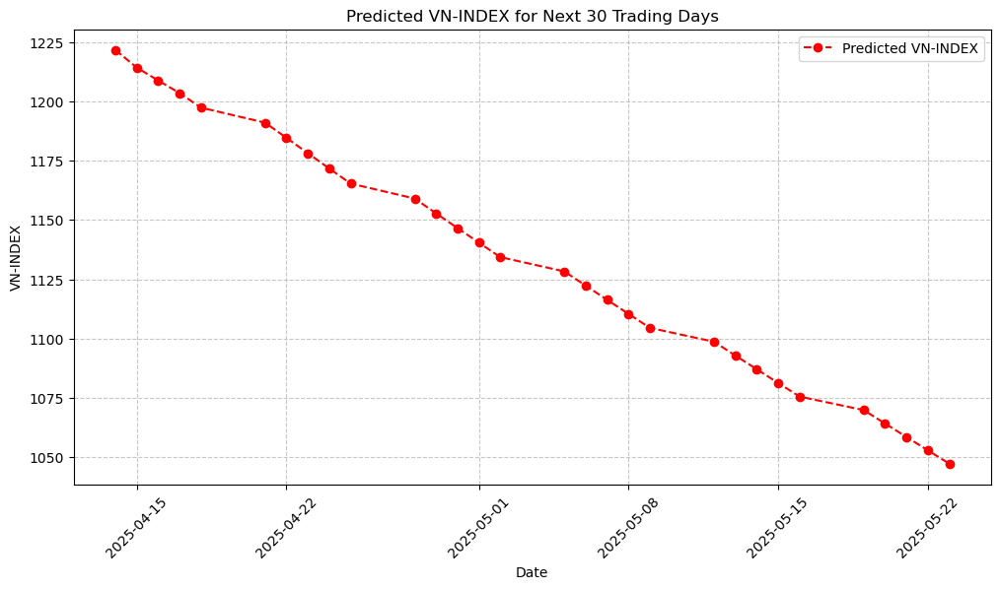

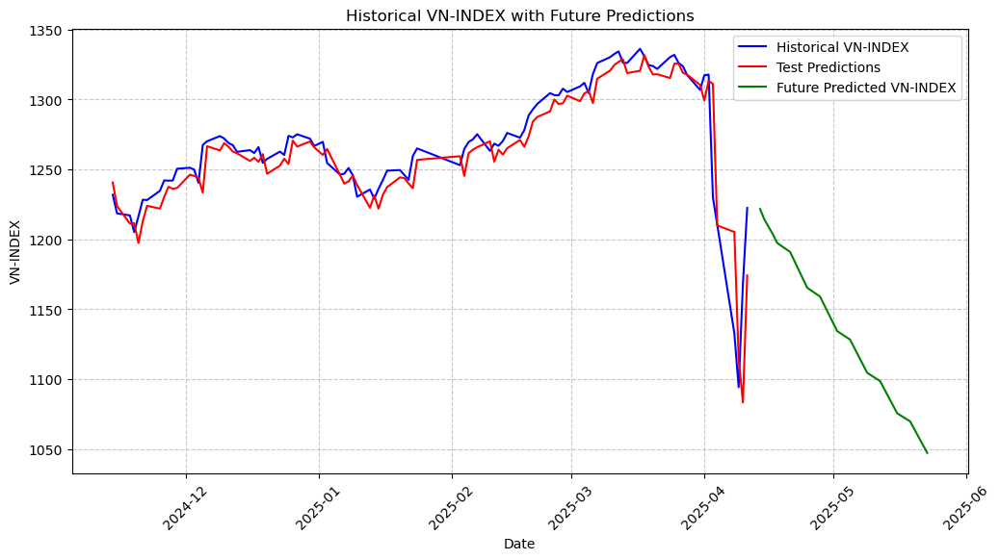


Ensemble Future Predictions (weighted average) for next 30 days:
         Date  Predicted Future VN-INDEX
0  2025-04-14                1221.697135
1  2025-04-15                1214.229470
2  2025-04-16                1208.830985
3  2025-04-17                1203.505079
4  2025-04-18                1197.377793
5  2025-04-21                1191.036158
6  2025-04-22                1184.628261
7  2025-04-23                1178.154180
8  2025-04-24                1171.719505
9  2025-04-25                1165.357237
10 2025-04-28                1159.046351
11 2025-04-29                1152.789843
12 2025-04-30                1146.592414
13 2025-05-01                1140.447200
14 2025-05-02                1134.349935
15 2025-05-05                1128.299296
16 2025-05-06                1122.292413
17 2025-05-07                1116.326335
18 2025-05-08                1110.398989
19 2025-05-09                1104.508470
20 2025-05-12                1098.652751
21 2025-05-13                109

In [6]:
# 📊 Select only VN-INDEX for prediction
data = df_1["VN_Index_Close"]

ensemble_lstm_model(data)

[I 2025-04-14 15:27:19,850] A new study created in memory with name: no-name-e375f3a0-00e3-419c-a636-c8c227c4f675



Training LSTM with sequence length = 5


/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.44940421505169464 and num_layers=1
  warnings.warn(
[I 2025-04-14 15:27:43,064] Trial 0 finished with value: 0.0003860203852954669 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.44940421505169464, 'learning_rate': 0.006879209234207531, 'batch_size': 32}. Best is trial 0 with value: 0.0003860203852954669.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.27660487730413336 and num_layers=1
  warnings.warn(
[I 2025-04-14 15:27:53,013] Trial 1 finished with value: 0.0006930263042005436 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.27660487730413336, 'learning_ra

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.44940421505169464, 'learning_rate': 0.006879209234207531, 'batch_size': 32}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0002
RMSE: 14.9602, MAE: 11.2193, R²: 0.9477, Directional Accuracy: 0.5067


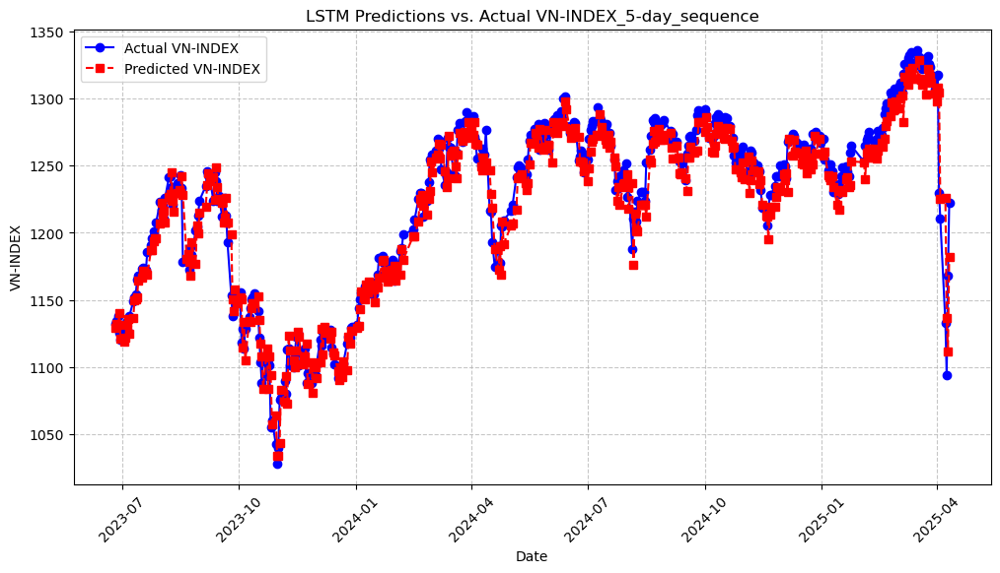

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-06-26      1132.029991         1129.416908
1   2023-06-27      1134.330002         1132.430153
2   2023-06-28      1138.349975         1131.165232
3   2023-06-29      1125.389999         1139.857060
4   2023-06-30      1120.180020         1121.419354
..         ...              ...                 ...
444 2025-04-04      1210.670016         1225.164592
445 2025-04-08      1132.790007         1225.761676
446 2025-04-09      1094.299993         1136.428160
447 2025-04-10      1168.339995         1111.392159
448 2025-04-11      1222.460024         1182.326891

[449 rows x 3 columns]


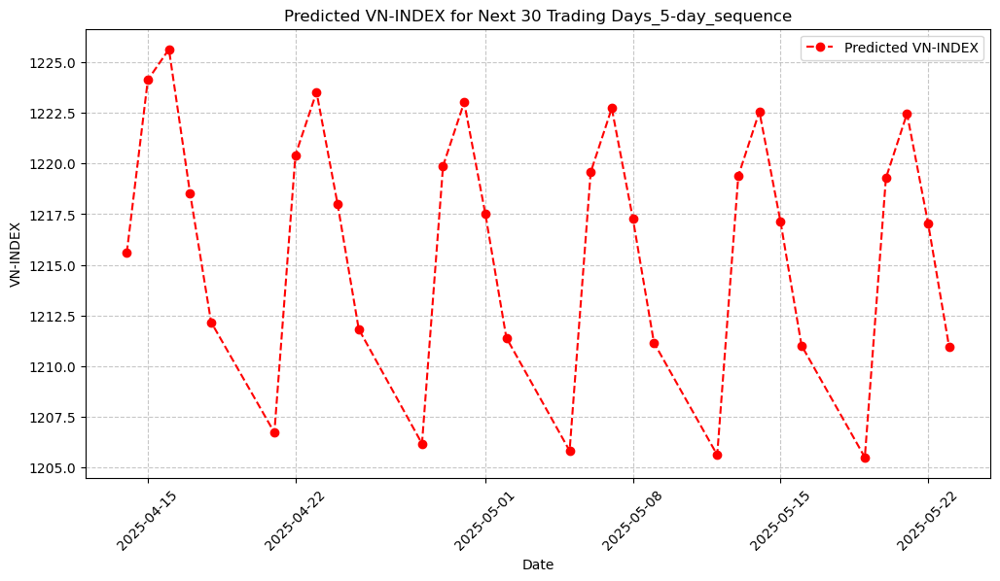

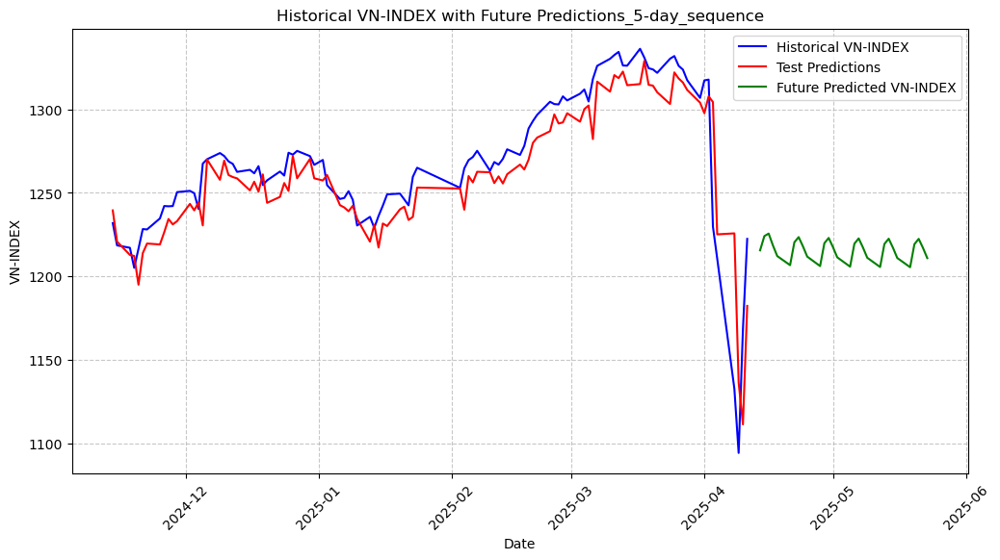

[I 2025-04-14 15:28:45,982] A new study created in memory with name: no-name-43041007-2e25-4962-bd9f-c5bc38e82d47


         Date  Predicted VN-INDEX
0  2025-04-14         1215.592667
1  2025-04-15         1224.132816
2  2025-04-16         1225.642367
3  2025-04-17         1218.550112
4  2025-04-18         1212.174018
5  2025-04-21         1206.721414
6  2025-04-22         1220.421906
7  2025-04-23         1223.528410
8  2025-04-24         1217.988558
9  2025-04-25         1211.829811
10 2025-04-28         1206.176970
11 2025-04-29         1219.886865
12 2025-04-30         1223.021424
13 2025-05-01         1217.542305
14 2025-05-02         1211.405447
15 2025-05-05         1205.824438
16 2025-05-06         1219.573333
17 2025-05-07         1222.731937
18 2025-05-08         1217.289198
19 2025-05-09         1211.159584
20 2025-05-12         1205.618653
21 2025-05-13         1219.390670
22 2025-05-14         1222.563148
23 2025-05-15         1217.141834
24 2025-05-16         1211.016382
25 2025-05-19         1205.498882
26 2025-05-20         1219.284463
27 2025-05-21         1222.465111
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.19326578359095029 and num_layers=1
  warnings.warn(
[I 2025-04-14 15:29:15,841] Trial 0 finished with value: 0.002330392761600706 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.19326578359095029, 'learning_rate': 0.0001509228550095065, 'batch_size': 64}. Best is trial 0 with value: 0.002330392761600706.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.10882832151386719 and num_layers=1
  warnings.warn(
[I 2025-04-14 15:29:51,642] Trial 1 finished with value: 0.0007392484828955048 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.10882832151386719, 'learning_ra

Best Hyperparameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.2801741994231073, 'learning_rate': 0.0030329795655027036, 'batch_size': 32}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0001
RMSE: 15.5864, MAE: 11.6035, R²: 0.9425, Directional Accuracy: 0.4966


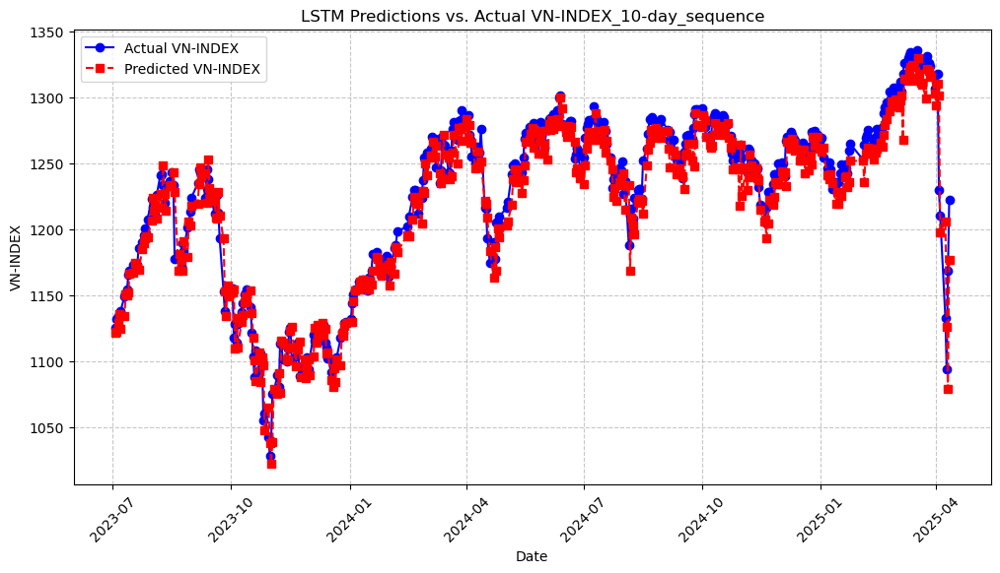

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-03      1125.499982         1121.425211
1   2023-07-04      1132.000009         1122.560496
2   2023-07-05      1134.620028         1129.259217
3   2023-07-06      1126.219998         1135.630378
4   2023-07-07      1138.069969         1124.788522
..         ...              ...                 ...
439 2025-04-04      1210.670016         1198.018333
440 2025-04-08      1132.790007         1206.180053
441 2025-04-09      1094.299993         1125.820991
442 2025-04-10      1168.339995         1079.058812
443 2025-04-11      1222.460024         1177.185969

[444 rows x 3 columns]


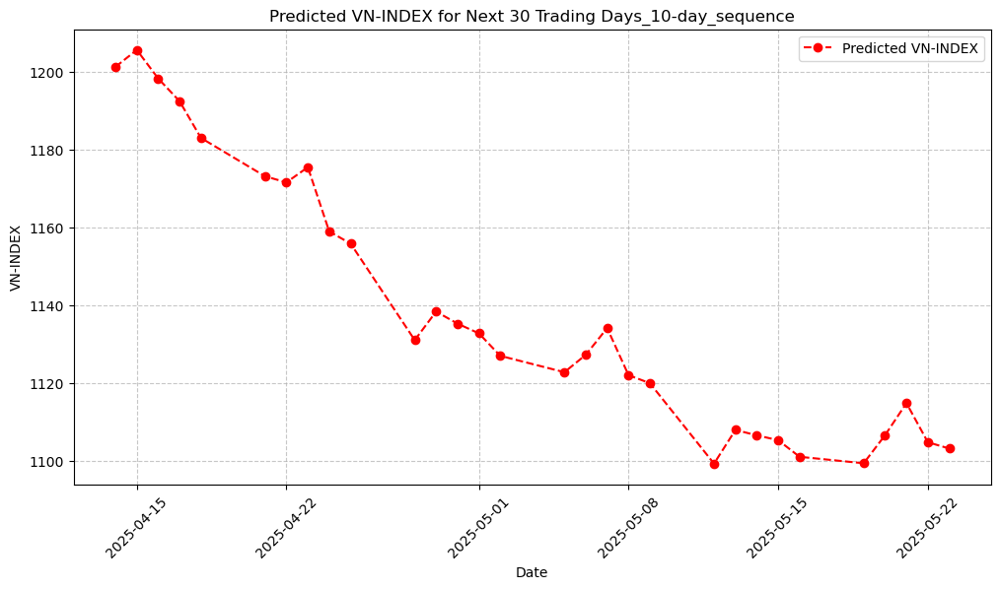

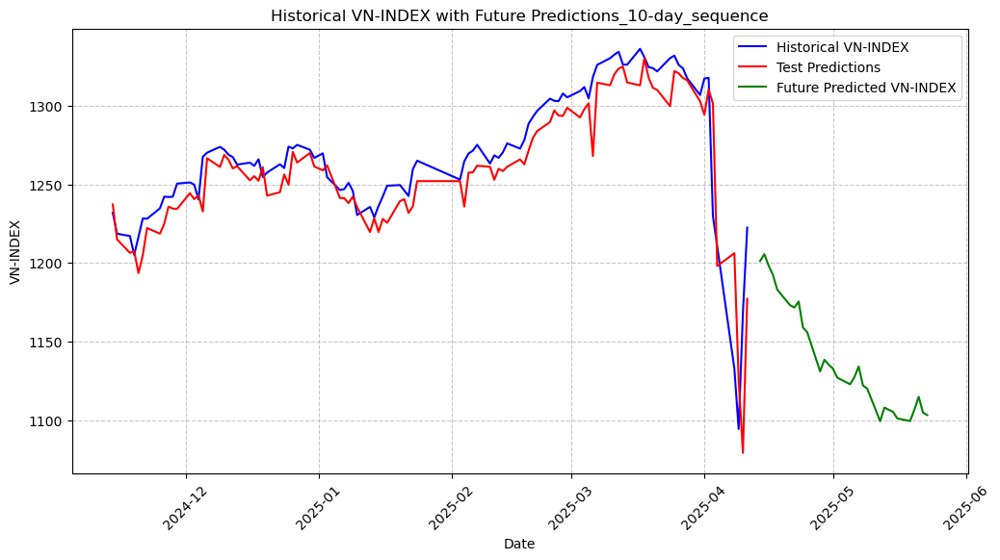

[I 2025-04-14 15:33:10,707] A new study created in memory with name: no-name-7162c6c2-a122-44c0-8535-1fb9c53417cf


         Date  Predicted VN-INDEX
0  2025-04-14         1201.225185
1  2025-04-15         1205.567785
2  2025-04-16         1198.243232
3  2025-04-17         1192.391081
4  2025-04-18         1182.958890
5  2025-04-21         1173.098096
6  2025-04-22         1171.541453
7  2025-04-23         1175.432944
8  2025-04-24         1158.931157
9  2025-04-25         1155.810704
10 2025-04-28         1131.008928
11 2025-04-29         1138.343346
12 2025-04-30         1135.242546
13 2025-05-01         1132.744919
14 2025-05-02         1126.966219
15 2025-05-05         1122.760732
16 2025-05-06         1127.224182
17 2025-05-07         1134.100325
18 2025-05-08         1122.004029
19 2025-05-09         1119.930612
20 2025-05-12         1099.262876
21 2025-05-13         1107.927498
22 2025-05-14         1106.532862
23 2025-05-15         1105.295995
24 2025-05-16         1101.024148
25 2025-05-19         1099.359834
26 2025-05-20         1106.584963
27 2025-05-21         1114.812812
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.147987271180694 and num_layers=1
  warnings.warn(
[I 2025-04-14 15:33:40,091] Trial 0 finished with value: 0.0012993662879262047 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.147987271180694, 'learning_rate': 0.00036234758597747233, 'batch_size': 32}. Best is trial 0 with value: 0.0012993662879262047.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.13610815612313343 and num_layers=1
  warnings.warn(
[I 2025-04-14 15:34:17,773] Trial 1 finished with value: 0.0009268049179485161 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.13610815612313343, 'learning_rate

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.32754455351229417, 'learning_rate': 0.0039734947263379465, 'batch_size': 32}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0001
RMSE: 14.3928, MAE: 10.1016, R²: 0.9503, Directional Accuracy: 0.5266


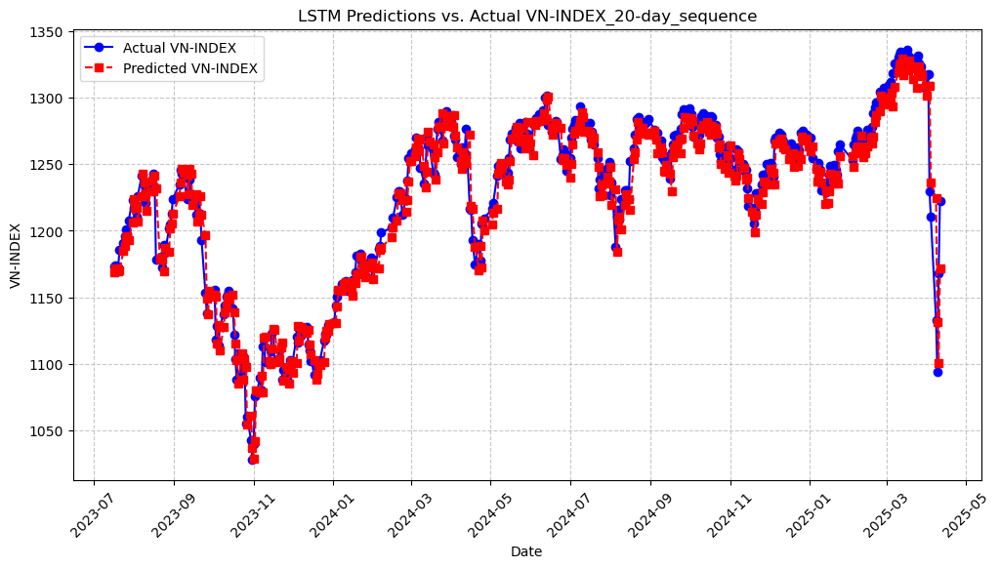

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-17      1173.130004         1168.459227
1   2023-07-18      1174.090025         1171.881345
2   2023-07-19      1172.980020         1171.459601
3   2023-07-20      1172.809997         1169.791357
4   2023-07-21      1185.899994         1170.326783
..         ...              ...                 ...
429 2025-04-04      1210.670016         1236.626346
430 2025-04-08      1132.790007         1224.351395
431 2025-04-09      1094.299993         1131.408936
432 2025-04-10      1168.339995         1100.780443
433 2025-04-11      1222.460024         1171.877568

[434 rows x 3 columns]


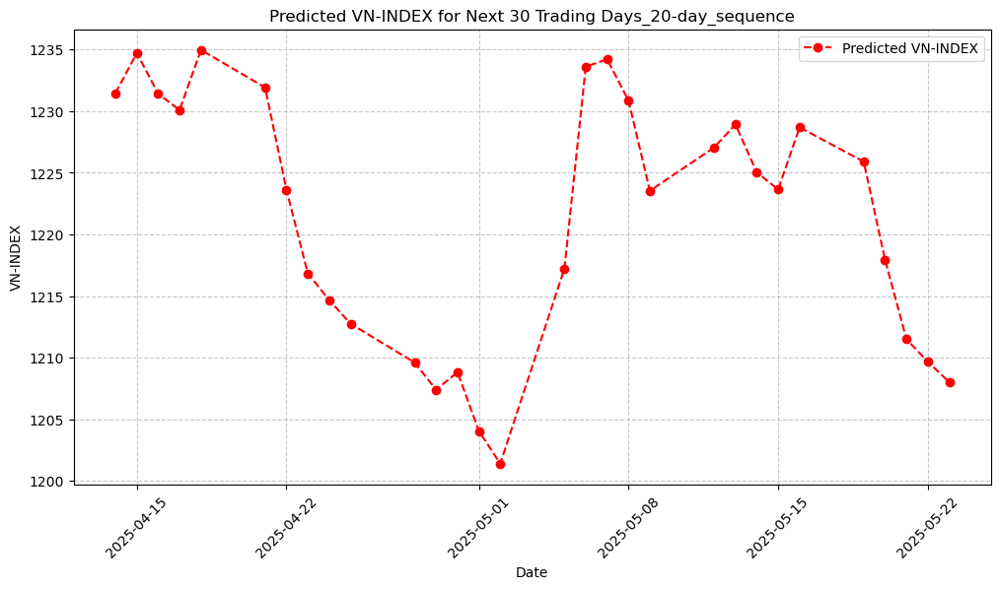

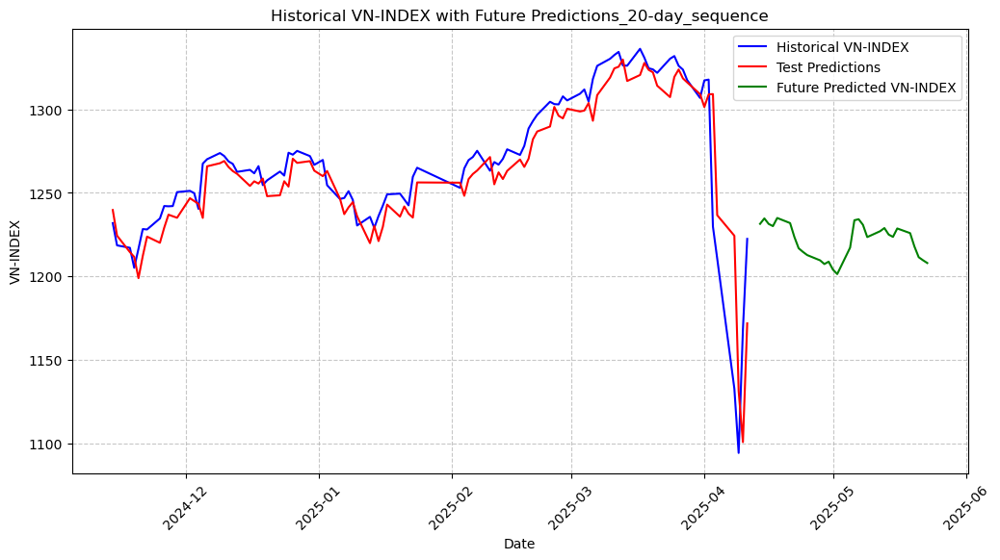

[I 2025-04-14 15:39:57,166] A new study created in memory with name: no-name-2dc0573c-c802-4318-b7bc-b30f018cc43b


         Date  Predicted VN-INDEX
0  2025-04-14         1231.460760
1  2025-04-15         1234.721718
2  2025-04-16         1231.421916
3  2025-04-17         1230.097262
4  2025-04-18         1234.971743
5  2025-04-21         1231.928208
6  2025-04-22         1223.607563
7  2025-04-23         1216.833311
8  2025-04-24         1214.665402
9  2025-04-25         1212.746594
10 2025-04-28         1209.599396
11 2025-04-29         1207.388172
12 2025-04-30         1208.824581
13 2025-05-01         1204.037964
14 2025-05-02         1201.396519
15 2025-05-05         1217.220834
16 2025-05-06         1233.615644
17 2025-05-07         1234.216351
18 2025-05-08         1230.855660
19 2025-05-09         1223.542822
20 2025-05-12         1227.050336
21 2025-05-13         1228.931765
22 2025-05-14         1225.037421
23 2025-05-15         1223.649799
24 2025-05-16         1228.690064
25 2025-05-19         1225.907884
26 2025-05-20         1217.932834
27 2025-05-21         1211.489687
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.24202981660929807 and num_layers=1
  warnings.warn(
[I 2025-04-14 15:40:31,752] Trial 0 finished with value: 0.0029132183674528277 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.24202981660929807, 'learning_rate': 0.00047774525324215686, 'batch_size': 64}. Best is trial 0 with value: 0.0029132183674528277.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.334461843007909 and num_layers=1
  warnings.warn(
[I 2025-04-14 15:41:06,072] Trial 1 finished with value: 0.0007155434193339261 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.334461843007909, 'learning_rate'

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.13188107882877587, 'learning_rate': 0.007760731168326251, 'batch_size': 32}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0001
RMSE: 14.3697, MAE: 10.1058, R²: 0.9522, Directional Accuracy: 0.5133


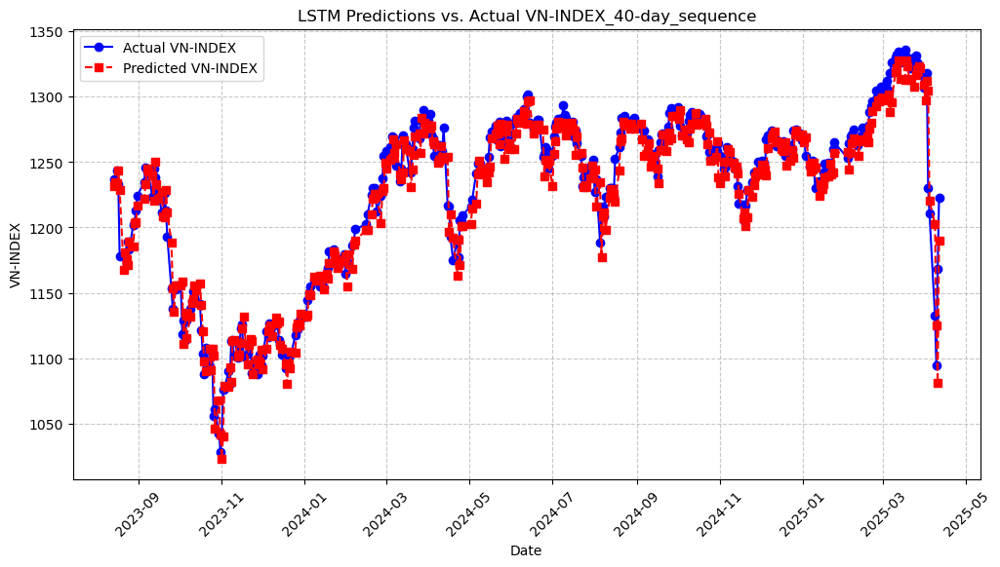

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-08-14      1236.839992         1231.698608
1   2023-08-15      1234.050027         1234.337124
2   2023-08-16      1243.260017         1234.219279
3   2023-08-17      1233.479995         1243.503876
4   2023-08-18      1177.989995         1228.732300
..         ...              ...                 ...
409 2025-04-04      1210.670016         1220.513700
410 2025-04-08      1132.790007         1202.494346
411 2025-04-09      1094.299993         1124.789678
412 2025-04-10      1168.339995         1081.140707
413 2025-04-11      1222.460024         1190.191726

[414 rows x 3 columns]


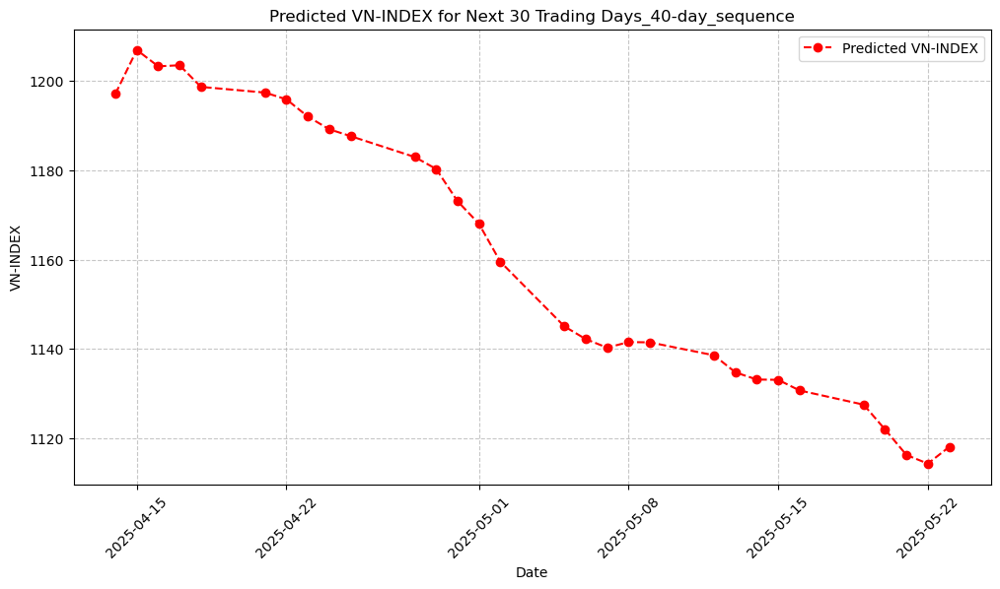

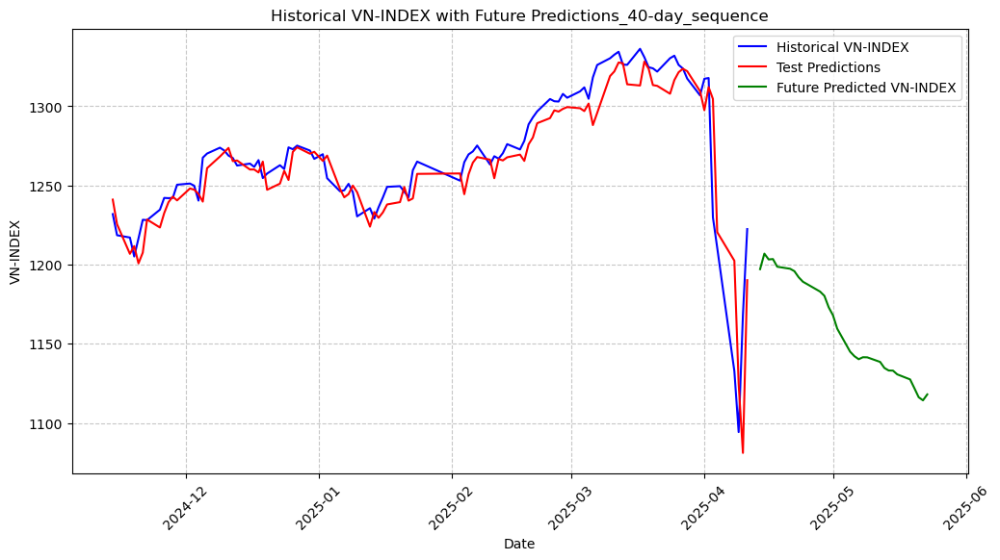

[I 2025-04-14 15:50:20,556] A new study created in memory with name: no-name-c155d0d4-eec2-4cef-9614-80eb9cf6cf11


         Date  Predicted VN-INDEX
0  2025-04-14         1197.146252
1  2025-04-15         1206.951939
2  2025-04-16         1203.288121
3  2025-04-17         1203.529590
4  2025-04-18         1198.685168
5  2025-04-21         1197.409842
6  2025-04-22         1195.892506
7  2025-04-23         1192.035851
8  2025-04-24         1189.200028
9  2025-04-25         1187.662576
10 2025-04-28         1182.988177
11 2025-04-29         1180.319602
12 2025-04-30         1173.113510
13 2025-05-01         1168.052899
14 2025-05-02         1159.567009
15 2025-05-05         1145.069351
16 2025-05-06         1142.222044
17 2025-05-07         1140.304006
18 2025-05-08         1141.560141
19 2025-05-09         1141.493319
20 2025-05-12         1138.594142
21 2025-05-13         1134.771708
22 2025-05-14         1133.178455
23 2025-05-15         1133.107008
24 2025-05-16         1130.729924
25 2025-05-19         1127.544651
26 2025-05-20         1121.981293
27 2025-05-21         1116.286370
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.17847983615591134 and num_layers=1
  warnings.warn(
[I 2025-04-14 15:53:17,254] Trial 0 finished with value: 0.0037839011471169216 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.17847983615591134, 'learning_rate': 0.00020266914452952002, 'batch_size': 128}. Best is trial 0 with value: 0.0037839011471169216.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3699870756304769 and num_layers=1
  warnings.warn(
[I 2025-04-14 15:55:15,323] Trial 1 finished with value: 0.0004931321215818229 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.3699870756304769, 'learning_

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.3699870756304769, 'learning_rate': 0.0013835015638473224, 'batch_size': 32}
Best Overall Average Training Loss: 0.0005
Final Evaluation Loss on Test Set: 0.0002
RMSE: 15.1178, MAE: 10.6698, R²: 0.9492, Directional Accuracy: 0.5318


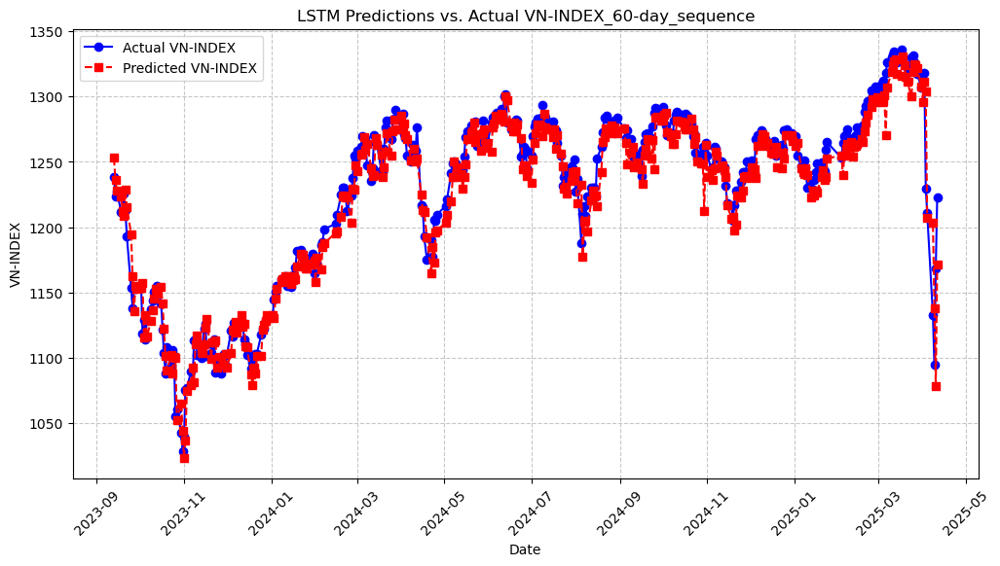

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-13      1238.390007         1252.983004
1   2023-09-14      1223.810034         1236.149726
2   2023-09-15      1227.360016         1228.318495
3   2023-09-18      1211.810003         1223.863985
4   2023-09-19      1211.500015         1212.119065
..         ...              ...                 ...
389 2025-04-04      1210.670016         1207.232562
390 2025-04-08      1132.790007         1203.279257
391 2025-04-09      1094.299993         1138.175790
392 2025-04-10      1168.339995         1077.896551
393 2025-04-11      1222.460024         1171.546077

[394 rows x 3 columns]


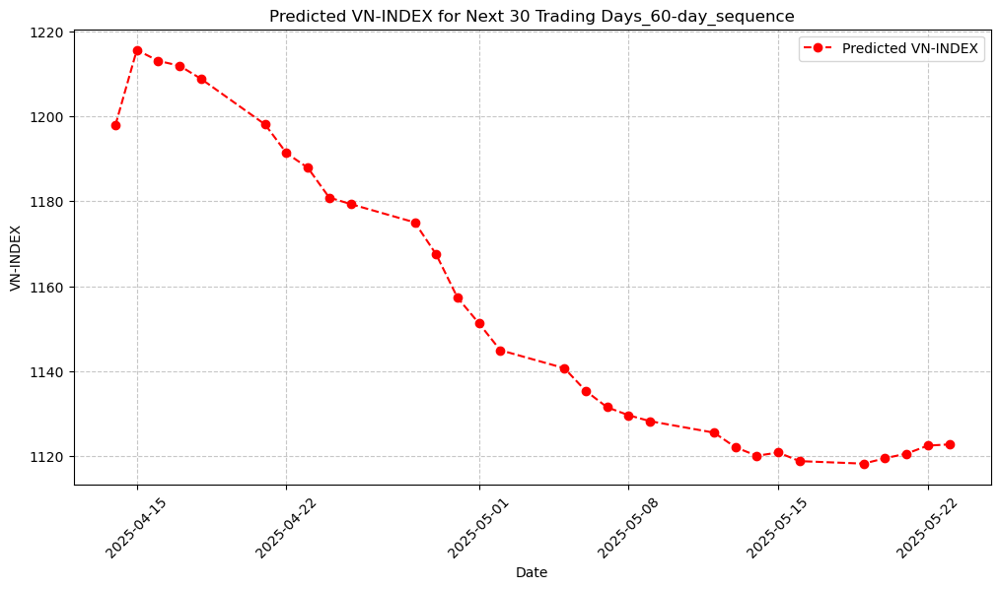

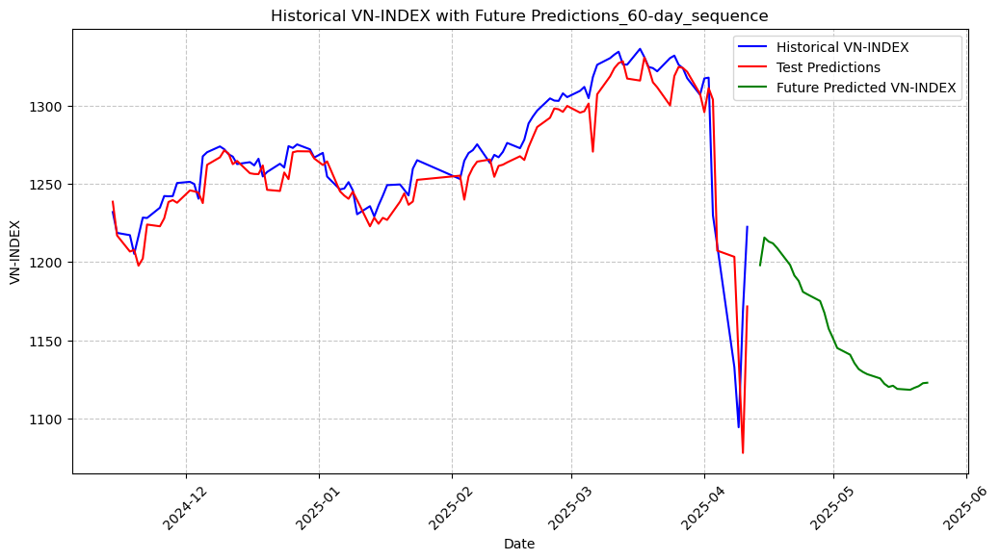

         Date  Predicted VN-INDEX
0  2025-04-14         1197.929236
1  2025-04-15         1215.610857
2  2025-04-16         1213.048180
3  2025-04-17         1211.890082
4  2025-04-18         1208.829822
5  2025-04-21         1198.074442
6  2025-04-22         1191.339651
7  2025-04-23         1187.874527
8  2025-04-24         1180.873064
9  2025-04-25         1179.347558
10 2025-04-28         1175.029313
11 2025-04-29         1167.516085
12 2025-04-30         1157.316633
13 2025-05-01         1151.293225
14 2025-05-02         1144.954127
15 2025-05-05         1140.708254
16 2025-05-06         1135.358387
17 2025-05-07         1131.515374
18 2025-05-08         1129.648744
19 2025-05-09         1128.246555
20 2025-05-12         1125.542604
21 2025-05-13         1122.107230
22 2025-05-14         1120.093236
23 2025-05-15         1120.871981
24 2025-05-16         1118.839336
25 2025-05-19         1118.248417
26 2025-05-20         1119.526750
27 2025-05-21         1120.597370
28 2025-05-22 

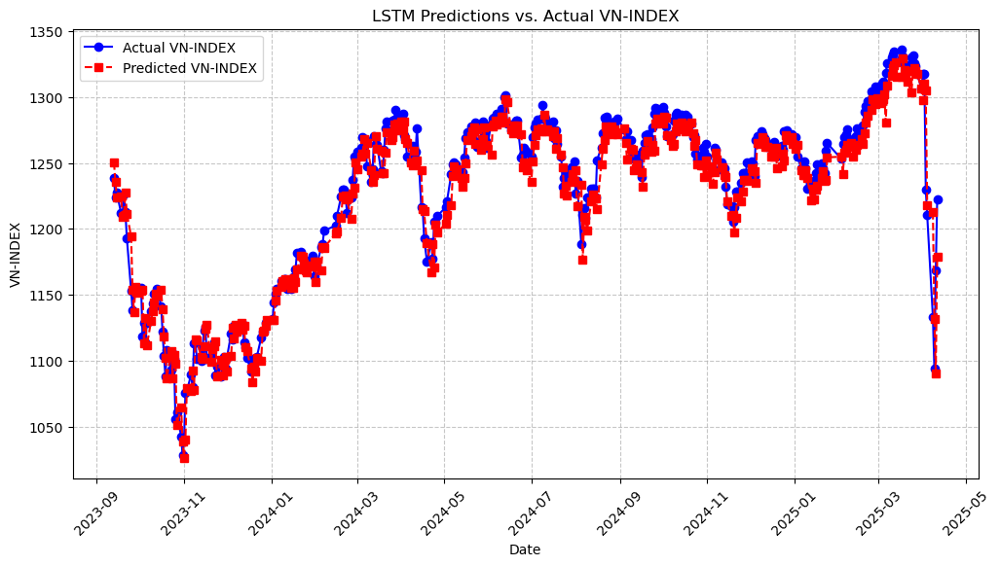

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-13      1238.390007         1250.478396
1   2023-09-14      1223.810034         1235.643953
2   2023-09-15      1227.360016         1224.122449
3   2023-09-18      1211.810003         1224.664424
4   2023-09-19      1211.500015         1208.834654
..         ...              ...                 ...
389 2025-04-04      1210.670016         1217.862458
390 2025-04-08      1132.790007         1212.494599
391 2025-04-09      1094.299993         1131.301742
392 2025-04-10      1168.339995         1090.178011
393 2025-04-11      1222.460024         1178.693419

[394 rows x 3 columns]


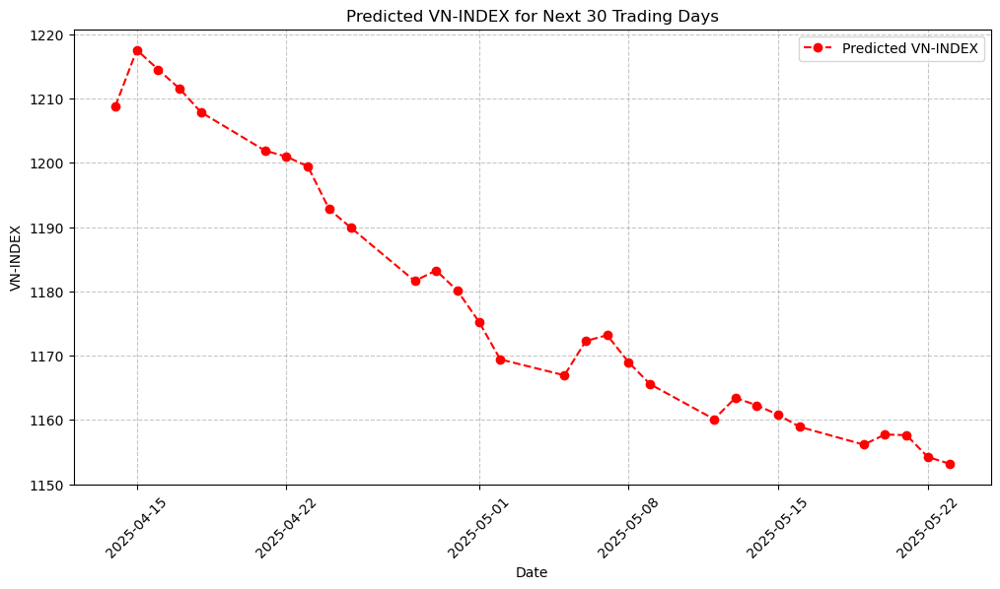

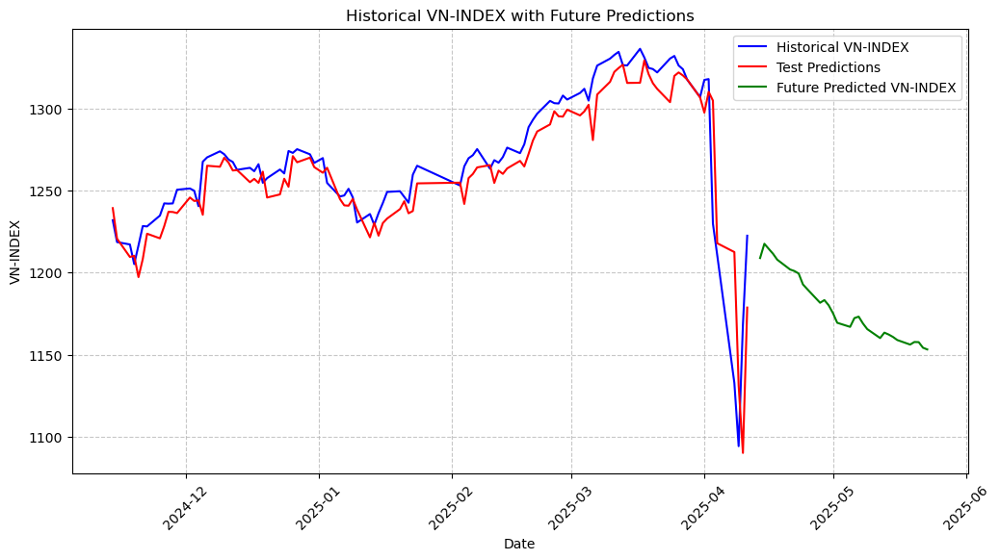


Ensemble Future Predictions (weighted average) for next 30 days:
         Date  Predicted Future VN-INDEX
0  2025-04-14                1208.837029
1  2025-04-15                1217.545665
2  2025-04-16                1214.503673
3  2025-04-17                1211.525332
4  2025-04-18                1207.860352
5  2025-04-21                1201.885750
6  2025-04-22                1200.954014
7  2025-04-23                1199.434347
8  2025-04-24                1192.771636
9  2025-04-25                1189.936892
10 2025-04-28                1181.612859
11 2025-04-29                1183.250685
12 2025-04-30                1180.080859
13 2025-05-01                1175.293324
14 2025-05-02                1169.421141
15 2025-05-05                1166.943091
16 2025-05-06                1172.274350
17 2025-05-07                1173.185515
18 2025-05-08                1168.993464
19 2025-05-09                1165.578296
20 2025-05-12                1160.125597
21 2025-05-13                116

In [7]:
# 📊 Select additional VN-INDEX statistics for prediction
data = df_1

ensemble_lstm_model(data)

[I 2025-04-14 16:13:11,508] A new study created in memory with name: no-name-3b76281b-5978-4322-8681-fd70573e3b3a



Training LSTM with sequence length = 5


/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3447600390716467 and num_layers=1
  warnings.warn(
[I 2025-04-14 16:13:15,503] Trial 0 finished with value: 0.0005073025634214901 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.3447600390716467, 'learning_rate': 0.004583564804837703, 'batch_size': 128}. Best is trial 0 with value: 0.0005073025634214901.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.20886361909335288 and num_layers=1
  warnings.warn(
[I 2025-04-14 16:13:27,124] Trial 1 finished with value: 0.0001963472989951498 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.20886361909335288, 'learning_rat

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.20886361909335288, 'learning_rate': 0.008413854652466168, 'batch_size': 32}
Best Overall Average Training Loss: 0.0002
Final Evaluation Loss on Test Set: 0.0001
RMSE: 15.5681, MAE: 11.1547, R²: 0.9431, Directional Accuracy: 0.5516


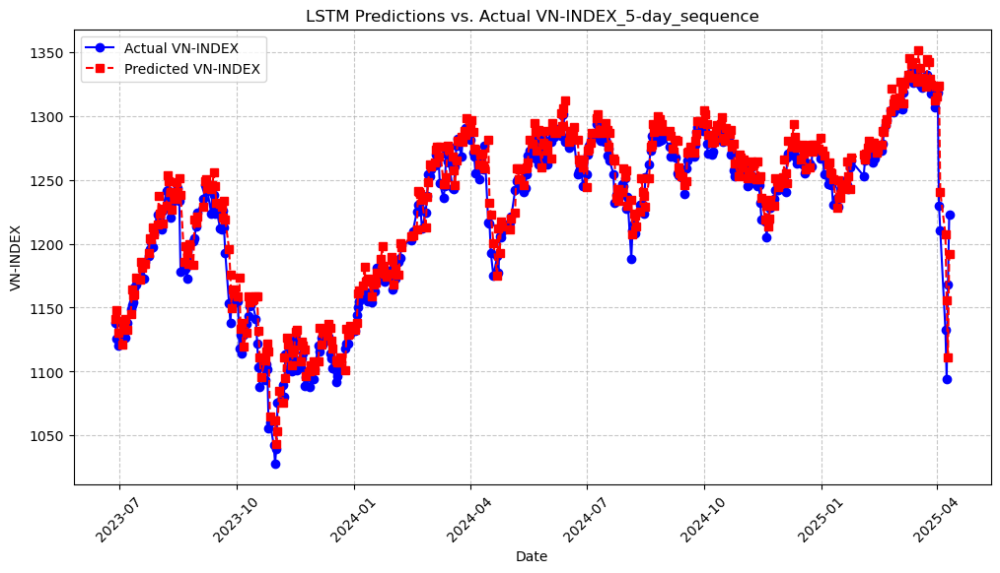

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-06-28      1138.349975         1140.974155
1   2023-06-29      1125.389999         1148.116277
2   2023-06-30      1120.180020         1130.612927
3   2023-07-03      1125.499982         1120.772095
4   2023-07-04      1132.000009         1136.935454
..         ...              ...                 ...
442 2025-04-04      1210.670016         1240.346350
443 2025-04-08      1132.790007         1207.686367
444 2025-04-09      1094.299993         1155.426880
445 2025-04-10      1168.339995         1110.912457
446 2025-04-11      1222.460024         1191.543201

[447 rows x 3 columns]


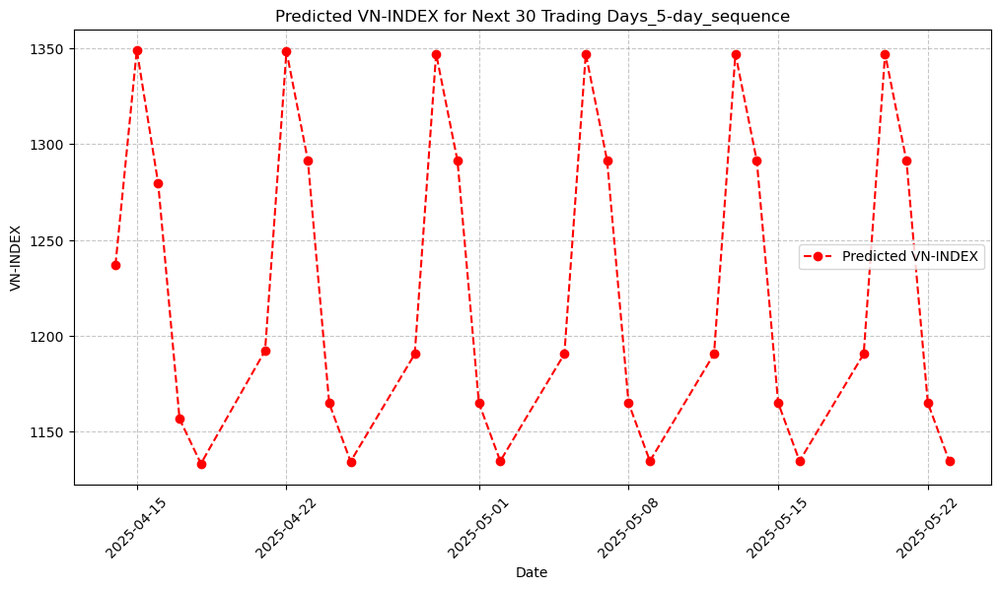

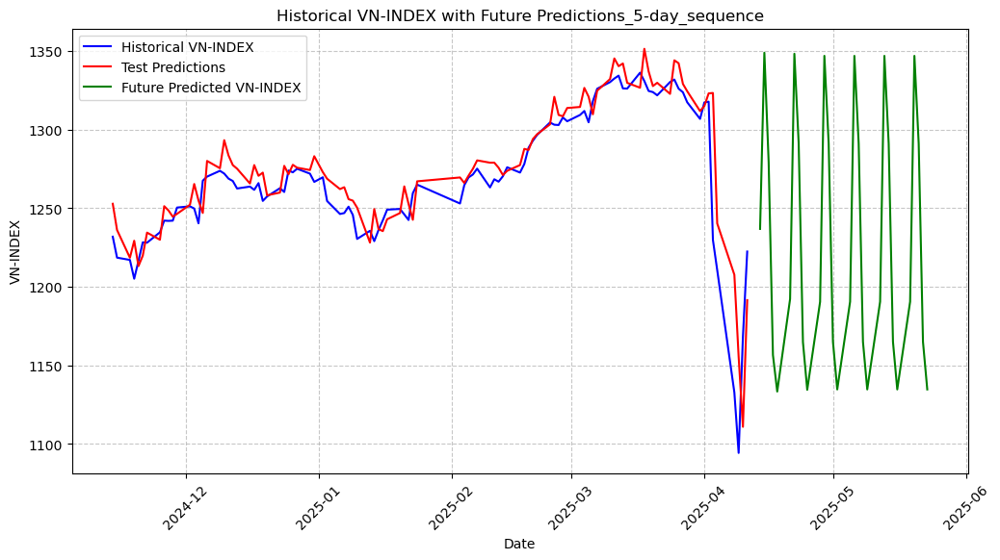

[I 2025-04-14 16:14:44,662] A new study created in memory with name: no-name-28e483df-763f-4a8d-97b2-610fdcd63890


         Date  Predicted VN-INDEX
0  2025-04-14         1236.860725
1  2025-04-15         1348.966454
2  2025-04-16         1279.363928
3  2025-04-17         1156.615654
4  2025-04-18         1133.375993
5  2025-04-21         1192.271617
6  2025-04-22         1348.311025
7  2025-04-23         1291.521805
8  2025-04-24         1164.805274
9  2025-04-25         1134.478368
10 2025-04-28         1190.476819
11 2025-04-29         1346.995158
12 2025-04-30         1291.203725
13 2025-05-01         1165.015067
14 2025-05-02         1134.714134
15 2025-05-05         1190.551503
16 2025-05-06         1346.972961
17 2025-05-07         1291.168657
18 2025-05-08         1164.999036
19 2025-05-09         1134.715676
20 2025-05-12         1190.557206
21 2025-05-13         1346.975659
22 2025-05-14         1291.168888
23 2025-05-15         1164.998265
24 2025-05-16         1134.715213
25 2025-05-19         1190.557129
26 2025-05-20         1346.975890
27 2025-05-21         1291.168965
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.18895131379317218 and num_layers=1
  warnings.warn(
[I 2025-04-14 16:15:19,376] Trial 0 finished with value: 0.00024284201537465576 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.18895131379317218, 'learning_rate': 0.0031541177689854588, 'batch_size': 32}. Best is trial 0 with value: 0.00024284201537465576.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.20591137096864728 and num_layers=1
  warnings.warn(
[I 2025-04-14 16:15:43,765] Trial 1 finished with value: 0.0005341380441336696 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.20591137096864728, 'learnin

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.4795754842105407, 'learning_rate': 0.004770671916087327, 'batch_size': 64}
Best Overall Average Training Loss: 0.0002
Final Evaluation Loss on Test Set: 0.0002
RMSE: 17.4474, MAE: 13.2000, R²: 0.9276, Directional Accuracy: 0.5420


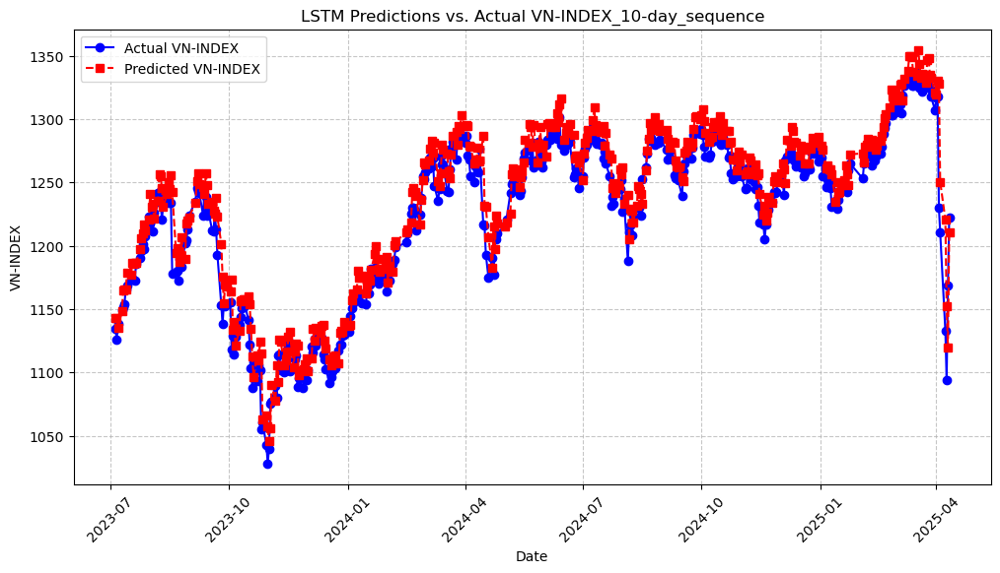

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-05      1134.620028         1143.002793
1   2023-07-06      1126.219998         1143.229927
2   2023-07-07      1138.069969         1135.452956
3   2023-07-10      1149.020035         1148.014772
4   2023-07-11      1151.769999         1164.907165
..         ...              ...                 ...
437 2025-04-04      1210.670016         1250.447766
438 2025-04-08      1132.790007         1220.669387
439 2025-04-09      1094.299993         1152.639074
440 2025-04-10      1168.339995         1119.722207
441 2025-04-11      1222.460024         1210.779152

[442 rows x 3 columns]


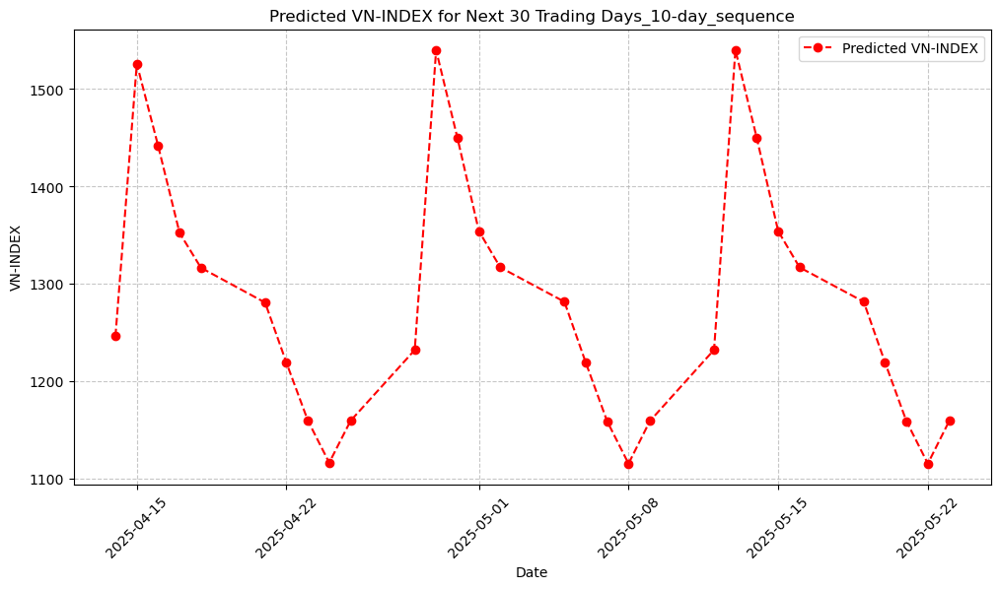

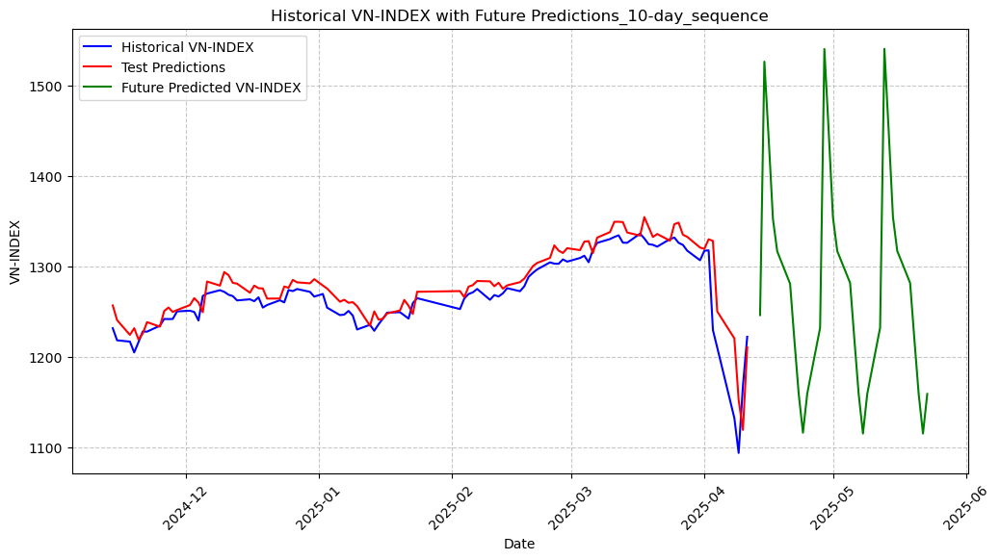

[I 2025-04-14 16:18:15,088] A new study created in memory with name: no-name-af456391-617e-4dd3-890e-331936d83822


         Date  Predicted VN-INDEX
0  2025-04-14         1246.380856
1  2025-04-15         1525.992371
2  2025-04-16         1441.557228
3  2025-04-17         1352.475972
4  2025-04-18         1316.668406
5  2025-04-21         1280.975139
6  2025-04-22         1219.119989
7  2025-04-23         1159.927172
8  2025-04-24         1116.618170
9  2025-04-25         1159.696030
10 2025-04-28         1232.283052
11 2025-04-29         1539.990520
12 2025-04-30         1449.663610
13 2025-05-01         1354.299596
14 2025-05-02         1317.088377
15 2025-05-05         1281.812152
16 2025-05-06         1219.341497
17 2025-05-07         1159.177714
18 2025-05-08         1115.688053
19 2025-05-09         1159.422498
20 2025-05-12         1232.467719
21 2025-05-13         1540.178886
22 2025-05-14         1449.703842
23 2025-05-15         1354.297977
24 2025-05-16         1317.090149
25 2025-05-19         1281.814387
26 2025-05-20         1219.334098
27 2025-05-21         1159.165845
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.13555091119576668 and num_layers=1
  warnings.warn(
[I 2025-04-14 16:19:08,870] Trial 0 finished with value: 0.001853236157144238 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.13555091119576668, 'learning_rate': 0.00016829240267042604, 'batch_size': 128}. Best is trial 0 with value: 0.001853236157144238.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3139118721350955 and num_layers=1
  warnings.warn(
[I 2025-04-14 16:19:32,507] Trial 1 finished with value: 0.004116346885593885 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.3139118721350955, 'learning_rat

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.3722176473213318, 'learning_rate': 0.007373081949944542, 'batch_size': 32}
Best Overall Average Training Loss: 0.0002
Final Evaluation Loss on Test Set: 0.0003
RMSE: 22.8506, MAE: 18.8915, R²: 0.8749, Directional Accuracy: 0.5128


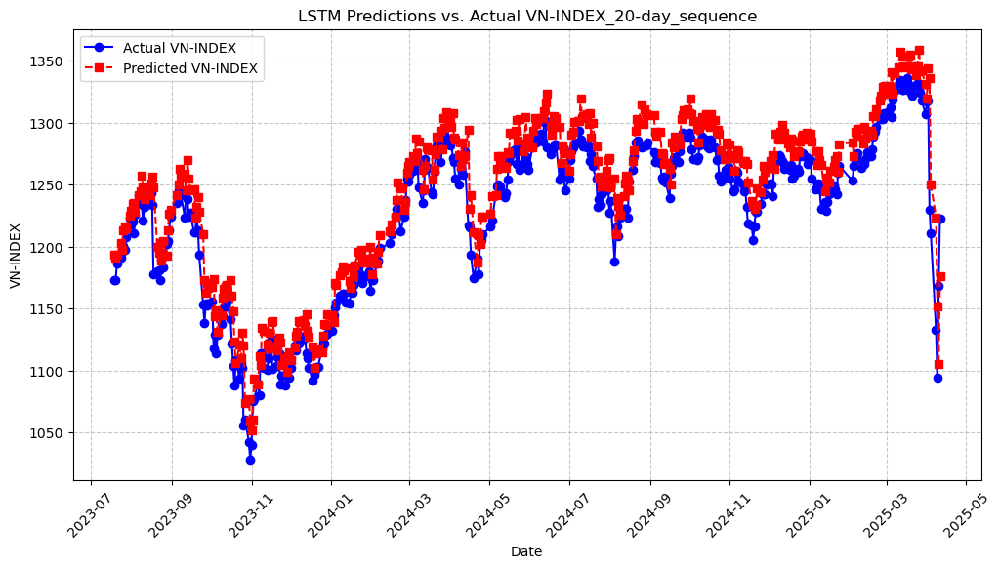

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-19      1172.980020         1193.154720
1   2023-07-20      1172.809997         1191.008545
2   2023-07-21      1185.899994         1193.603670
3   2023-07-24      1190.719984         1202.539896
4   2023-07-25      1195.899982         1197.537012
..         ...              ...                 ...
427 2025-04-04      1210.670016         1250.382099
428 2025-04-08      1132.790007         1223.535423
429 2025-04-09      1094.299993         1151.790038
430 2025-04-10      1168.339995         1104.892595
431 2025-04-11      1222.460024         1175.691756

[432 rows x 3 columns]


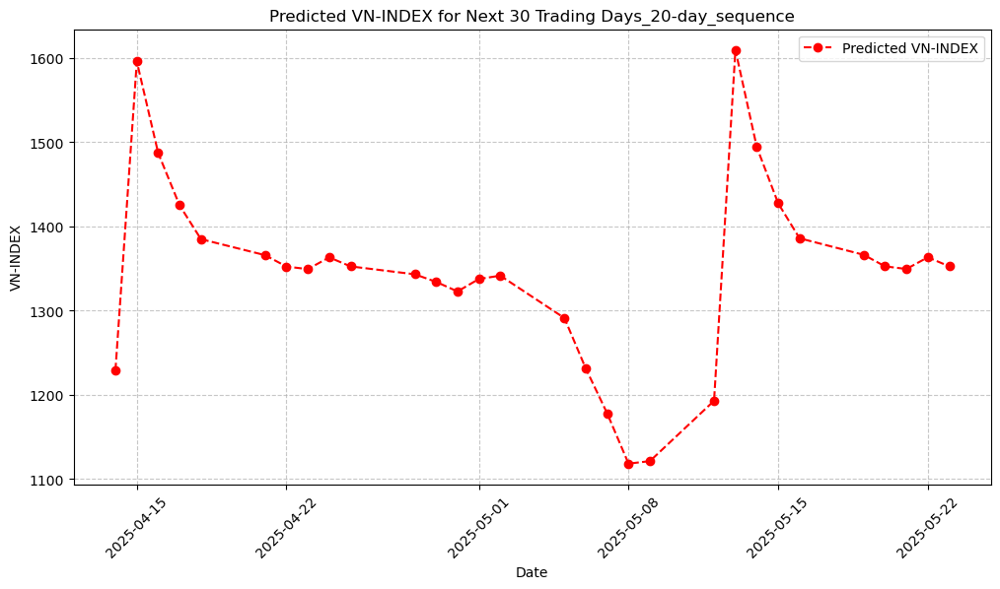

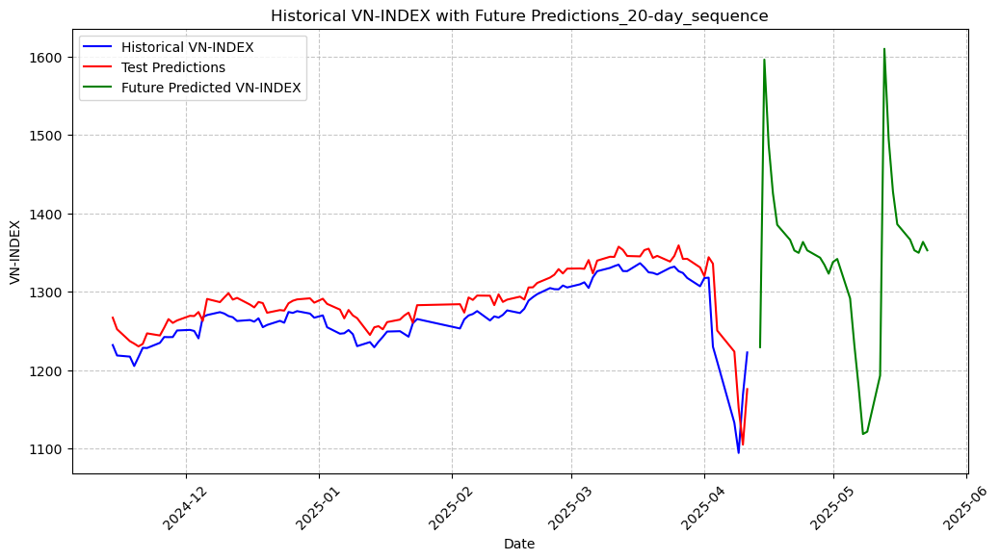

[I 2025-04-14 16:24:46,233] A new study created in memory with name: no-name-28d7ee59-45f1-463f-99c0-ceeee4295af8


         Date  Predicted VN-INDEX
0  2025-04-14         1229.191038
1  2025-04-15         1595.965695
2  2025-04-16         1487.298114
3  2025-04-17         1425.151937
4  2025-04-18         1385.023351
5  2025-04-21         1366.000892
6  2025-04-22         1352.451925
7  2025-04-23         1349.405770
8  2025-04-24         1363.371239
9  2025-04-25         1352.638827
10 2025-04-28         1343.294191
11 2025-04-29         1334.292530
12 2025-04-30         1322.892280
13 2025-05-01         1337.694223
14 2025-05-02         1341.667720
15 2025-05-05         1291.346310
16 2025-05-06         1231.443419
17 2025-05-07         1178.169806
18 2025-05-08         1118.405415
19 2025-05-09         1121.398621
20 2025-05-12         1193.024698
21 2025-05-13         1609.689926
22 2025-05-14         1494.270675
23 2025-05-15         1427.576113
24 2025-05-16         1386.027612
25 2025-05-19         1366.416084
26 2025-05-20         1352.683761
27 2025-05-21         1349.576332
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.28493750768149656 and num_layers=1
  warnings.warn(
[I 2025-04-14 16:25:38,449] Trial 0 finished with value: 0.00043886457698363304 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.28493750768149656, 'learning_rate': 0.0017623097447540753, 'batch_size': 64}. Best is trial 0 with value: 0.00043886457698363304.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2833641036027144 and num_layers=1
  warnings.warn(
[I 2025-04-14 16:27:49,052] Trial 1 finished with value: 0.00036415116243460944 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.2833641036027144, 'learning

Best Hyperparameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.18446610248686537, 'learning_rate': 0.005455255596439602, 'batch_size': 32}
Best Overall Average Training Loss: 0.0002
Final Evaluation Loss on Test Set: 0.0001
RMSE: 15.0922, MAE: 10.8291, R²: 0.9476, Directional Accuracy: 0.5134


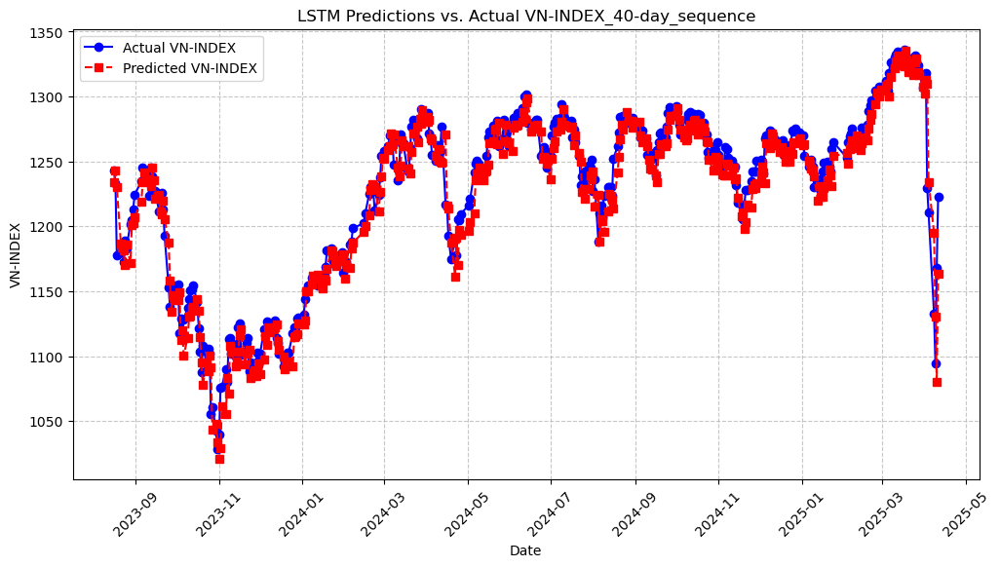

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-08-16      1243.260017         1233.981895
1   2023-08-17      1233.479995         1243.314045
2   2023-08-18      1177.989995         1230.059034
3   2023-08-21      1179.759976         1186.653845
4   2023-08-22      1180.490011         1183.971243
..         ...              ...                 ...
407 2025-04-04      1210.670016         1234.173652
408 2025-04-08      1132.790007         1195.115302
409 2025-04-09      1094.299993         1130.233959
410 2025-04-10      1168.339995         1080.411365
411 2025-04-11      1222.460024         1163.799703

[412 rows x 3 columns]


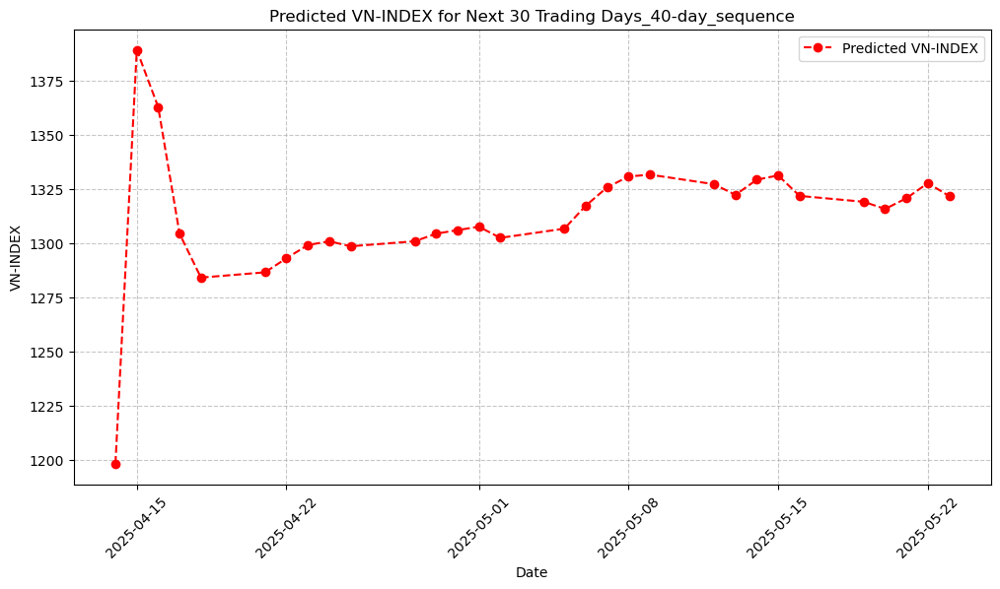

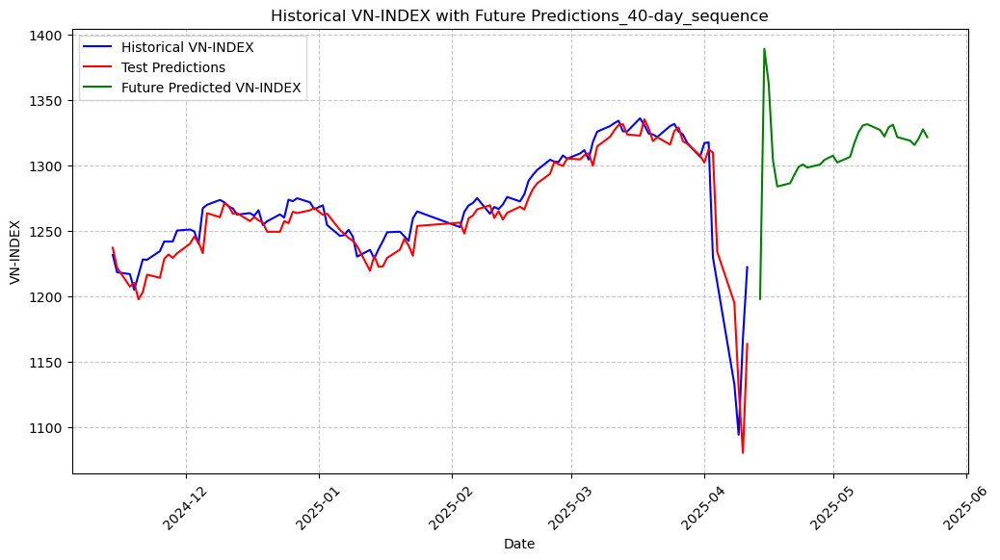

[I 2025-04-14 16:35:02,091] A new study created in memory with name: no-name-6a1d3bb1-c7b1-470f-8734-1d2fa304f143


         Date  Predicted VN-INDEX
0  2025-04-14         1198.076985
1  2025-04-15         1389.367801
2  2025-04-16         1363.004141
3  2025-04-17         1304.367096
4  2025-04-18         1284.109389
5  2025-04-21         1286.549211
6  2025-04-22         1293.060182
7  2025-04-23         1299.150335
8  2025-04-24         1300.918389
9  2025-04-25         1298.587471
10 2025-04-28         1300.904053
11 2025-04-29         1304.414342
12 2025-04-30         1306.068405
13 2025-05-01         1307.643777
14 2025-05-02         1302.482354
15 2025-05-05         1306.733314
16 2025-05-06         1317.366687
17 2025-05-07         1325.834310
18 2025-05-08         1330.842897
19 2025-05-09         1331.709043
20 2025-05-12         1327.286596
21 2025-05-13         1322.370188
22 2025-05-14         1329.375428
23 2025-05-15         1331.362138
24 2025-05-16         1321.875225
25 2025-05-19         1319.169732
26 2025-05-20         1315.841259
27 2025-05-21         1320.813082
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2725944350108655 and num_layers=1
  warnings.warn(
[I 2025-04-14 16:38:23,548] Trial 0 finished with value: 0.0002913254803138443 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.2725944350108655, 'learning_rate': 0.001005099394187567, 'batch_size': 64}. Best is trial 0 with value: 0.0002913254803138443.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1257837849630732 and num_layers=1
  warnings.warn(
[I 2025-04-14 16:41:58,349] Trial 1 finished with value: 0.0003082780406991681 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.1257837849630732, 'learning_rate'

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.2725944350108655, 'learning_rate': 0.001005099394187567, 'batch_size': 64}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0004
RMSE: 14.8203, MAE: 10.0363, R²: 0.9515, Directional Accuracy: 0.5422


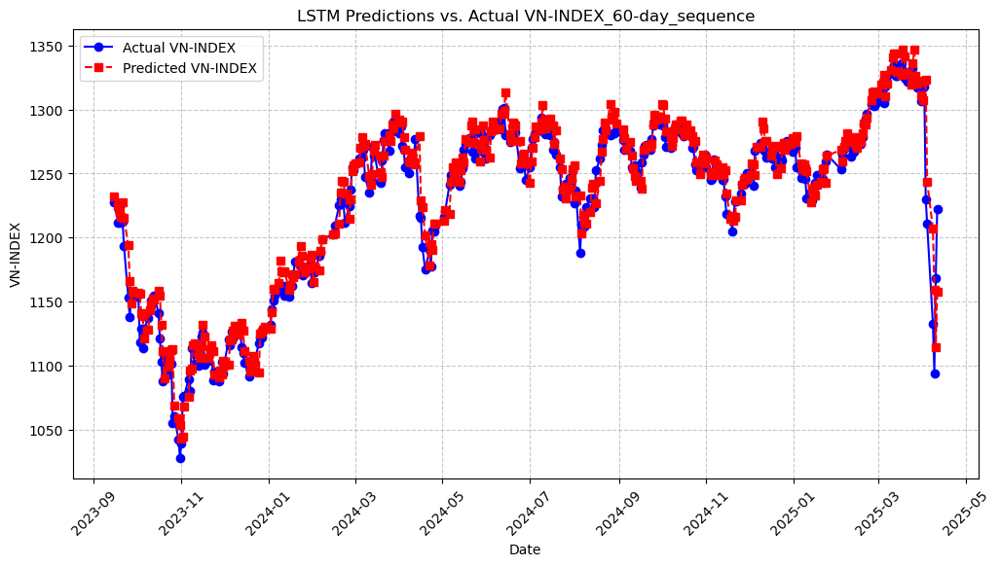

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-15      1227.360016         1231.811828
1   2023-09-18      1211.810003         1224.708397
2   2023-09-19      1211.500015         1220.268377
3   2023-09-20      1226.109969         1216.057495
4   2023-09-21      1212.739965         1227.881183
..         ...              ...                 ...
387 2025-04-04      1210.670016         1243.558598
388 2025-04-08      1132.790007         1207.123195
389 2025-04-09      1094.299993         1159.328546
390 2025-04-10      1168.339995         1114.772811
391 2025-04-11      1222.460024         1157.916800

[392 rows x 3 columns]


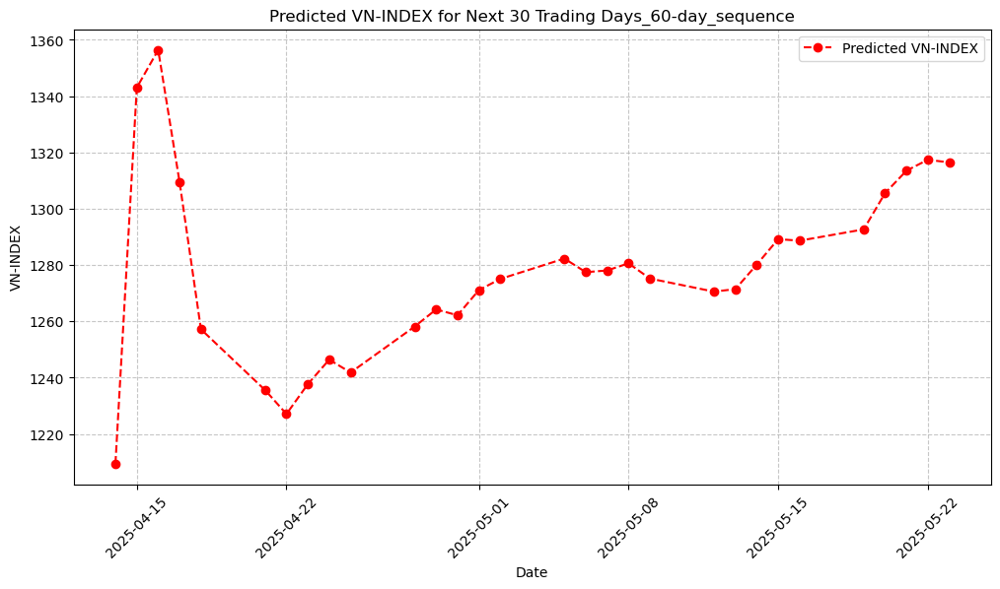

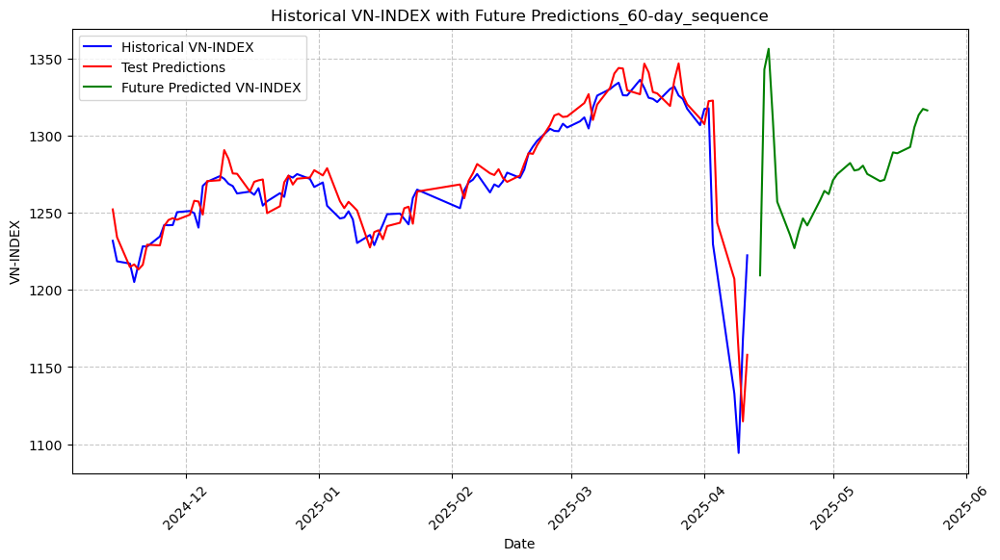

         Date  Predicted VN-INDEX
0  2025-04-14         1209.466753
1  2025-04-15         1343.030293
2  2025-04-16         1356.397214
3  2025-04-17         1309.477112
4  2025-04-18         1257.191882
5  2025-04-21         1235.599425
6  2025-04-22         1227.097582
7  2025-04-23         1237.714385
8  2025-04-24         1246.406675
9  2025-04-25         1241.826691
10 2025-04-28         1258.172020
11 2025-04-29         1264.239050
12 2025-04-30         1262.168562
13 2025-05-01         1271.095462
14 2025-05-02         1275.063025
15 2025-05-05         1282.308347
16 2025-05-06         1277.473328
17 2025-05-07         1278.078582
18 2025-05-08         1280.620218
19 2025-05-09         1275.206997
20 2025-05-12         1270.557647
21 2025-05-13         1271.464179
22 2025-05-14         1280.199091
23 2025-05-15         1289.203219
24 2025-05-16         1288.654228
25 2025-05-19         1292.672659
26 2025-05-20         1305.549550
27 2025-05-21         1313.521825
28 2025-05-22 

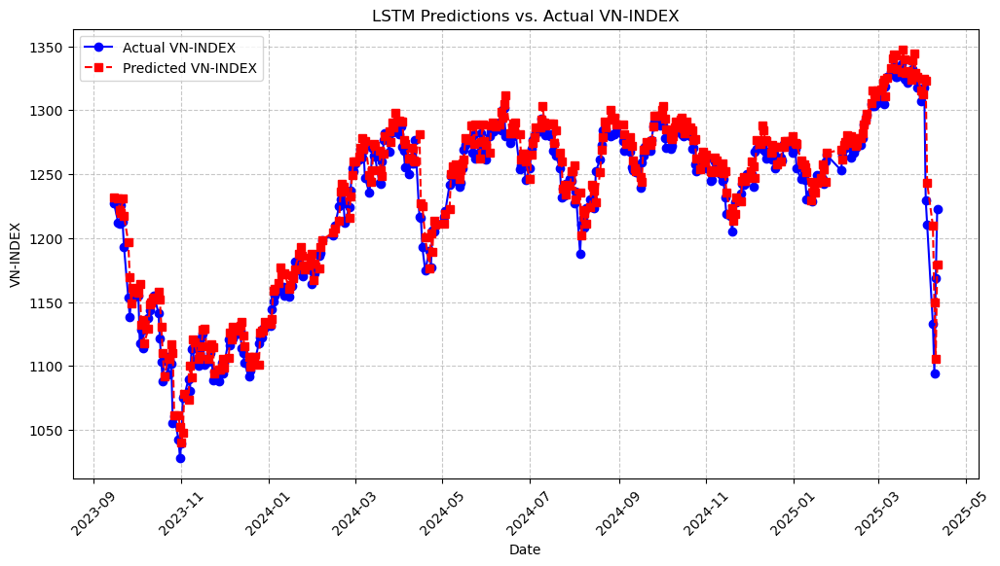

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-15      1227.360016         1231.887202
1   2023-09-18      1211.810003         1231.070425
2   2023-09-19      1211.500015         1222.148630
3   2023-09-20      1226.109969         1219.529842
4   2023-09-21      1212.739965         1230.936644
..         ...              ...                 ...
387 2025-04-04      1210.670016         1243.108132
388 2025-04-08      1132.790007         1209.581612
389 2025-04-09      1094.299993         1149.658710
390 2025-04-10      1168.339995         1105.832887
391 2025-04-11      1222.460024         1179.175860

[392 rows x 3 columns]


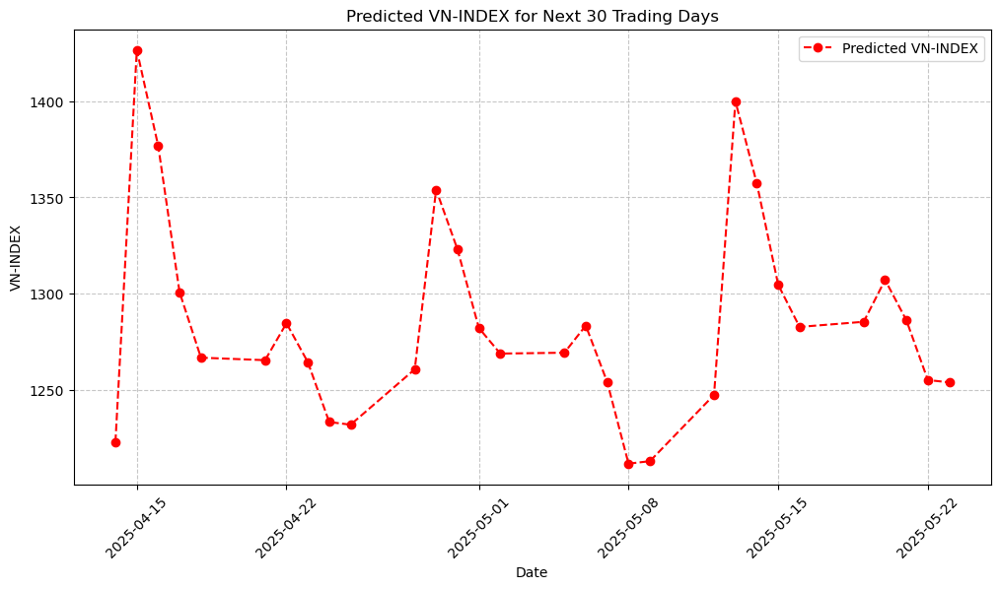

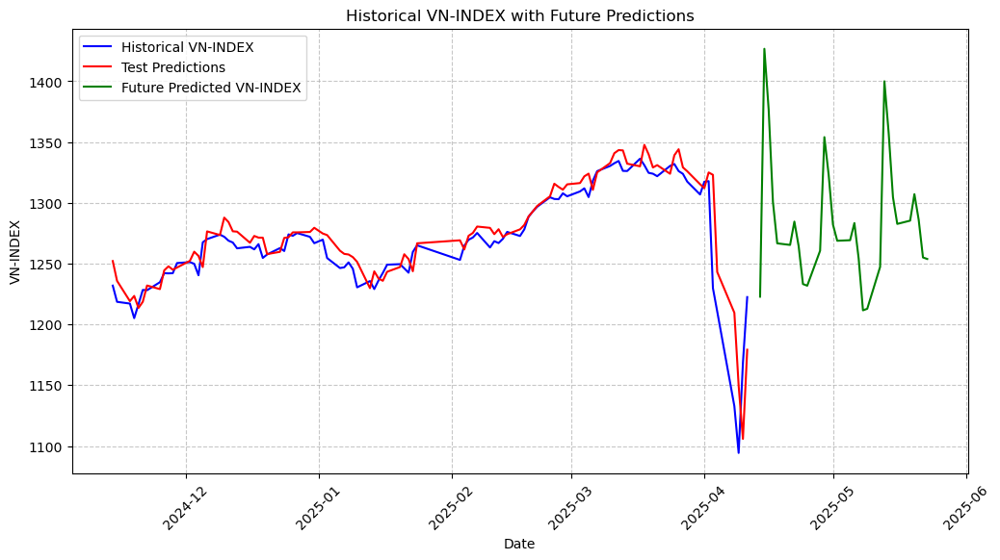


Ensemble Future Predictions (weighted average) for next 30 days:
         Date  Predicted Future VN-INDEX
0  2025-04-14                1222.788642
1  2025-04-15                1426.653554
2  2025-04-16                1376.792571
3  2025-04-17                1300.679999
4  2025-04-18                1266.667079
5  2025-04-21                1265.361476
6  2025-04-22                1284.564484
7  2025-04-23                1264.320661
8  2025-04-24                1233.198655
9  2025-04-25                1231.820406
10 2025-04-28                1260.594483
11 2025-04-29                1354.018451
12 2025-04-30                1322.953664
13 2025-05-01                1282.100849
14 2025-05-02                1268.793536
15 2025-05-05                1269.238734
16 2025-05-06                1283.363131
17 2025-05-07                1254.062273
18 2025-05-08                1211.563641
19 2025-05-09                1212.849570
20 2025-05-12                1247.296791
21 2025-05-13                139

In [8]:
# 📊 Select additional VN-INDEX statistics for prediction
data = lag_features_indicators(df_1[['VN_Index_Close']], ['VN_Index_Close'])

ensemble_lstm_model(data)

[I 2025-04-14 16:54:00,367] A new study created in memory with name: no-name-a075da88-1cb7-47e6-8982-b85ee63047a3



Training LSTM with sequence length = 5


/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.35055083094992606 and num_layers=1
  warnings.warn(
[I 2025-04-14 16:54:06,403] Trial 0 finished with value: 0.003584355134805719 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.35055083094992606, 'learning_rate': 0.00010214238926073406, 'batch_size': 64}. Best is trial 0 with value: 0.003584355134805719.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4233711605978436 and num_layers=1
  warnings.warn(
[I 2025-04-14 16:54:12,607] Trial 1 finished with value: 0.0005421002665434571 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.4233711605978436, 'learning_rate

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.23526225530943035, 'learning_rate': 0.005367648359212949, 'batch_size': 64}
Best Overall Average Training Loss: 0.0002
Final Evaluation Loss on Test Set: 0.0002
RMSE: 16.6216, MAE: 12.1788, R²: 0.9352, Directional Accuracy: 0.5224


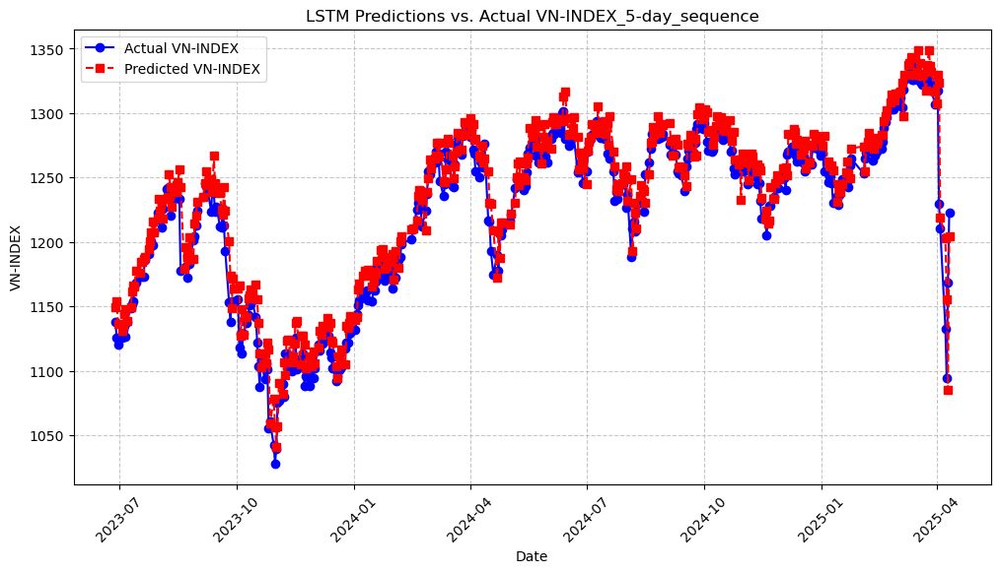

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-06-28      1138.349975         1149.256264
1   2023-06-29      1125.389999         1153.831547
2   2023-06-30      1120.180020         1136.441417
3   2023-07-03      1125.499982         1131.271592
4   2023-07-04      1132.000009         1135.464054
..         ...              ...                 ...
442 2025-04-04      1210.670016         1218.930467
443 2025-04-08      1132.790007         1203.023144
444 2025-04-09      1094.299993         1155.908741
445 2025-04-10      1168.339995         1085.240373
446 2025-04-11      1222.460024         1204.483060

[447 rows x 3 columns]


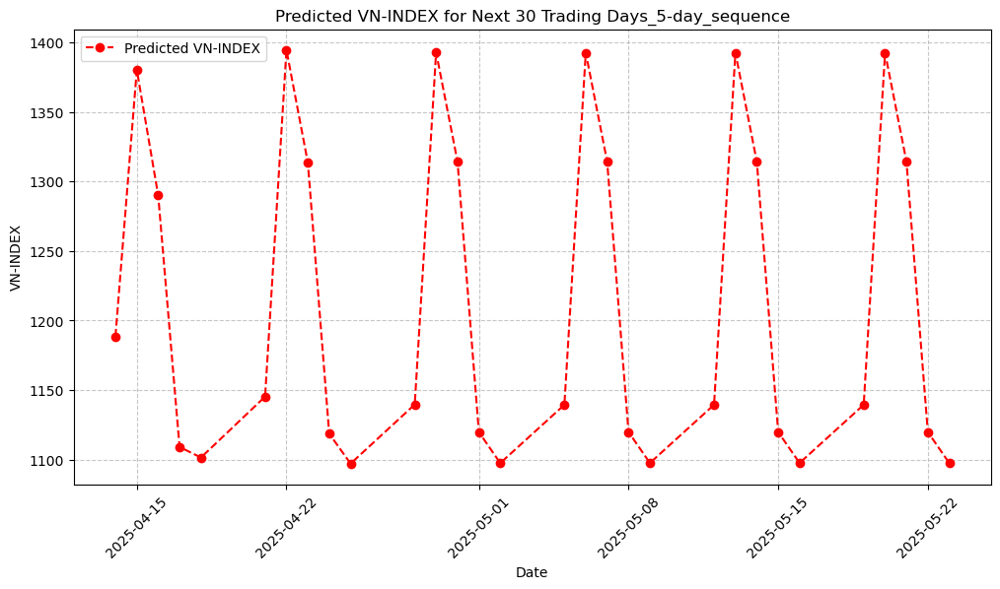

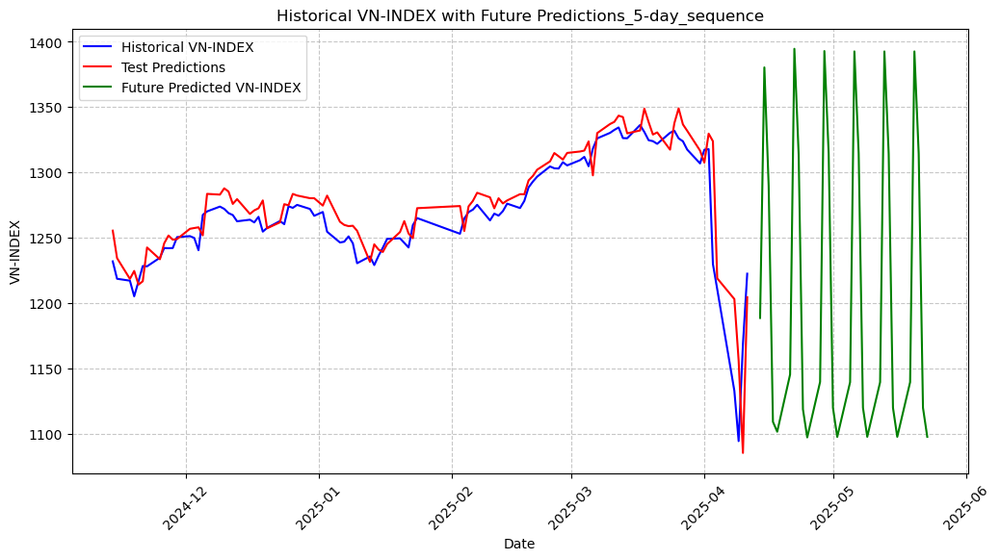

[I 2025-04-14 16:55:45,411] A new study created in memory with name: no-name-4771052a-a803-401d-bd78-d0c52f3fabb6


         Date  Predicted VN-INDEX
0  2025-04-14         1188.572423
1  2025-04-15         1380.376544
2  2025-04-16         1290.030443
3  2025-04-17         1109.086290
4  2025-04-18         1101.477029
5  2025-04-21         1145.284693
6  2025-04-22         1394.628956
7  2025-04-23         1313.585564
8  2025-04-24         1118.633936
9  2025-04-25         1097.099746
10 2025-04-28         1139.631082
11 2025-04-29         1392.905373
12 2025-04-30         1314.444465
13 2025-05-01         1119.813769
14 2025-05-02         1097.490814
15 2025-05-05         1139.404256
16 2025-05-06         1392.642400
17 2025-05-07         1314.365851
18 2025-05-08         1119.858472
19 2025-05-09         1097.556018
20 2025-05-12         1139.421443
21 2025-05-13         1392.629760
22 2025-05-14         1314.352902
23 2025-05-15         1119.854618
24 2025-05-16         1097.559409
25 2025-05-19         1139.424526
26 2025-05-20         1392.630531
27 2025-05-21         1314.352363
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.13358919964418223 and num_layers=1
  warnings.warn(
[I 2025-04-14 16:56:19,909] Trial 0 finished with value: 0.0006674561804028501 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.13358919964418223, 'learning_rate': 0.00011151846624225514, 'batch_size': 32}. Best is trial 0 with value: 0.0006674561804028501.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3733161207073852 and num_layers=1
  warnings.warn(
[I 2025-04-14 16:56:29,229] Trial 1 finished with value: 0.0002784627322216693 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.3733161207073852, 'learning_ra

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.46963332342664066, 'learning_rate': 0.0014004152093148364, 'batch_size': 32}
Best Overall Average Training Loss: 0.0002
Final Evaluation Loss on Test Set: 0.0002
RMSE: 15.8565, MAE: 11.8232, R²: 0.9402, Directional Accuracy: 0.5374


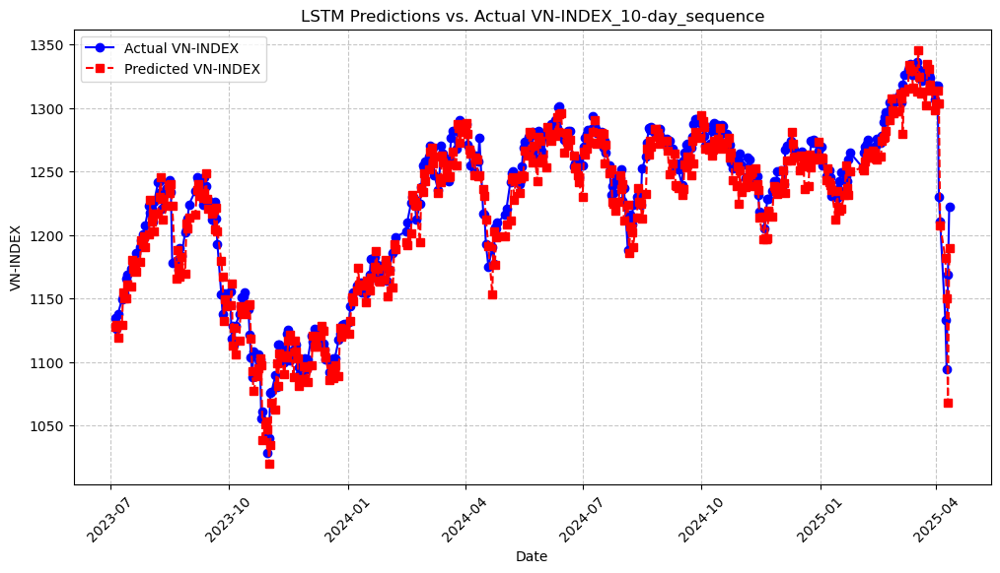

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-05      1134.620028         1127.322835
1   2023-07-06      1126.219998         1129.516332
2   2023-07-07      1138.069969         1118.797100
3   2023-07-10      1149.020035         1129.325654
4   2023-07-11      1151.769999         1154.575070
..         ...              ...                 ...
437 2025-04-04      1210.670016         1207.440581
438 2025-04-08      1132.790007         1181.575738
439 2025-04-09      1094.299993         1149.892039
440 2025-04-10      1168.339995         1068.027896
441 2025-04-11      1222.460024         1189.641271

[442 rows x 3 columns]


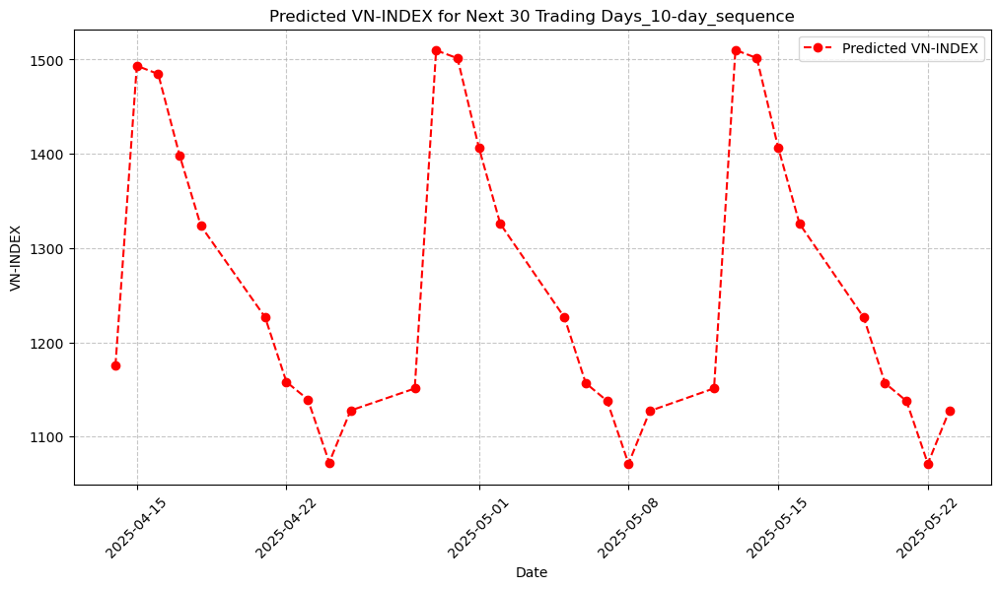

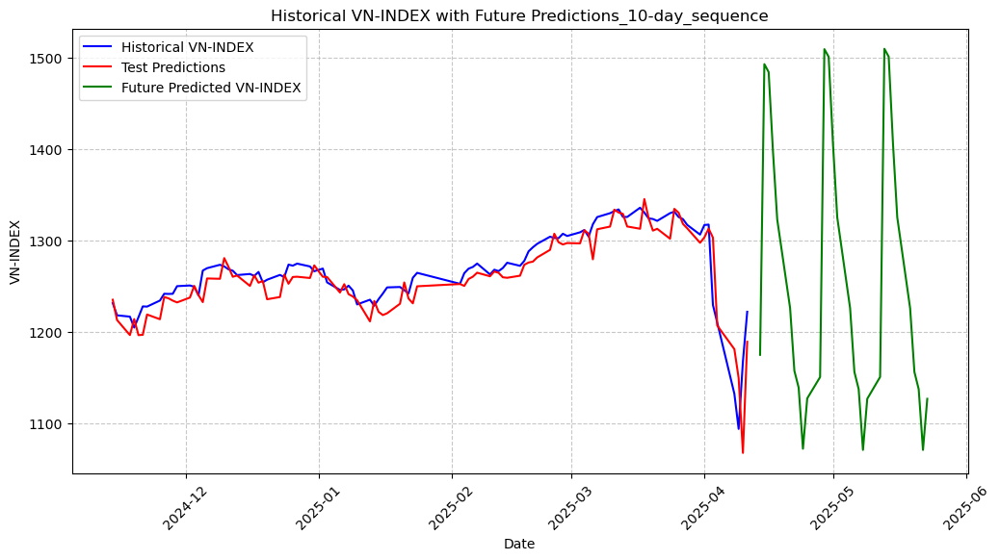

[I 2025-04-14 16:59:15,516] A new study created in memory with name: no-name-ad8848b8-701e-465f-b882-f32185670d90


         Date  Predicted VN-INDEX
0  2025-04-14         1175.318260
1  2025-04-15         1493.330076
2  2025-04-16         1484.628845
3  2025-04-17         1398.389578
4  2025-04-18         1323.385701
5  2025-04-21         1226.612562
6  2025-04-22         1157.909555
7  2025-04-23         1139.407262
8  2025-04-24         1072.576204
9  2025-04-25         1127.682227
10 2025-04-28         1151.010290
11 2025-04-29         1509.746852
12 2025-04-30         1501.312216
13 2025-05-01         1406.588139
14 2025-05-02         1325.767102
15 2025-05-05         1226.406469
16 2025-05-06         1156.677004
17 2025-05-07         1137.789654
18 2025-05-08         1071.310742
19 2025-05-09         1127.216321
20 2025-05-12         1151.158887
21 2025-05-13         1510.108787
22 2025-05-14         1501.517153
23 2025-05-15         1406.640857
24 2025-05-16         1325.749684
25 2025-05-19         1226.370476
26 2025-05-20         1156.642629
27 2025-05-21         1137.765607
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.49645762361998896 and num_layers=1
  warnings.warn(
[I 2025-04-14 17:00:34,533] Trial 0 finished with value: 0.0004171557098030831 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.49645762361998896, 'learning_rate': 0.003983337202857387, 'batch_size': 32}. Best is trial 0 with value: 0.0004171557098030831.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1662692639553668 and num_layers=1
  warnings.warn(
[I 2025-04-14 17:00:48,977] Trial 1 finished with value: 0.00215943023496493 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.1662692639553668, 'learning_rate':

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.33050966799957876, 'learning_rate': 0.0029960772231411815, 'batch_size': 32}
Best Overall Average Training Loss: 0.0002
Final Evaluation Loss on Test Set: 0.0002
RMSE: 15.1766, MAE: 11.3653, R²: 0.9448, Directional Accuracy: 0.5197


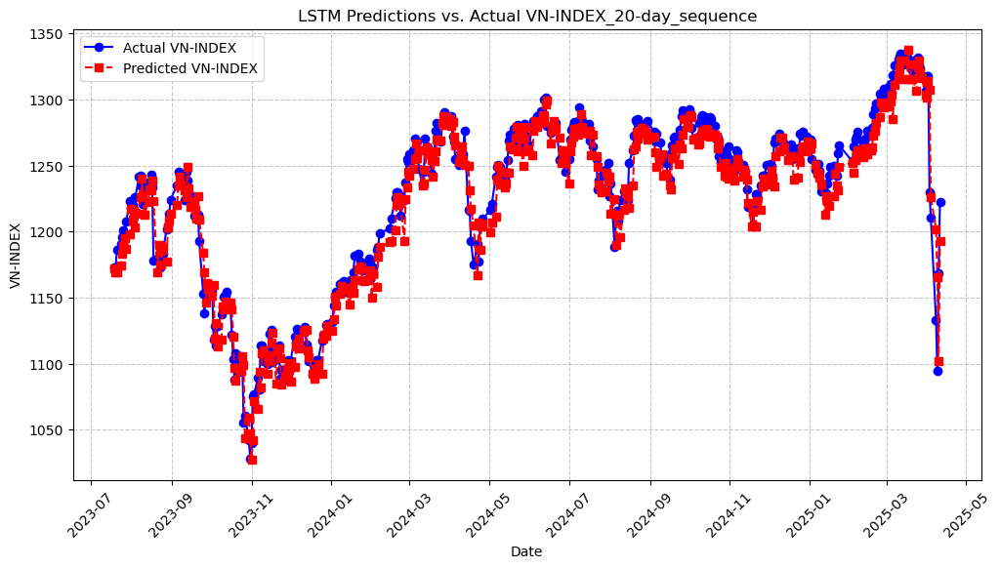

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-19      1172.980020         1172.408447
1   2023-07-20      1172.809997         1168.992264
2   2023-07-21      1185.899994         1168.948101
3   2023-07-24      1190.719984         1174.284865
4   2023-07-25      1195.899982         1183.056926
..         ...              ...                 ...
427 2025-04-04      1210.670016         1225.901178
428 2025-04-08      1132.790007         1201.990597
429 2025-04-09      1094.299993         1165.282356
430 2025-04-10      1168.339995         1101.667091
431 2025-04-11      1222.460024         1192.900764

[432 rows x 3 columns]


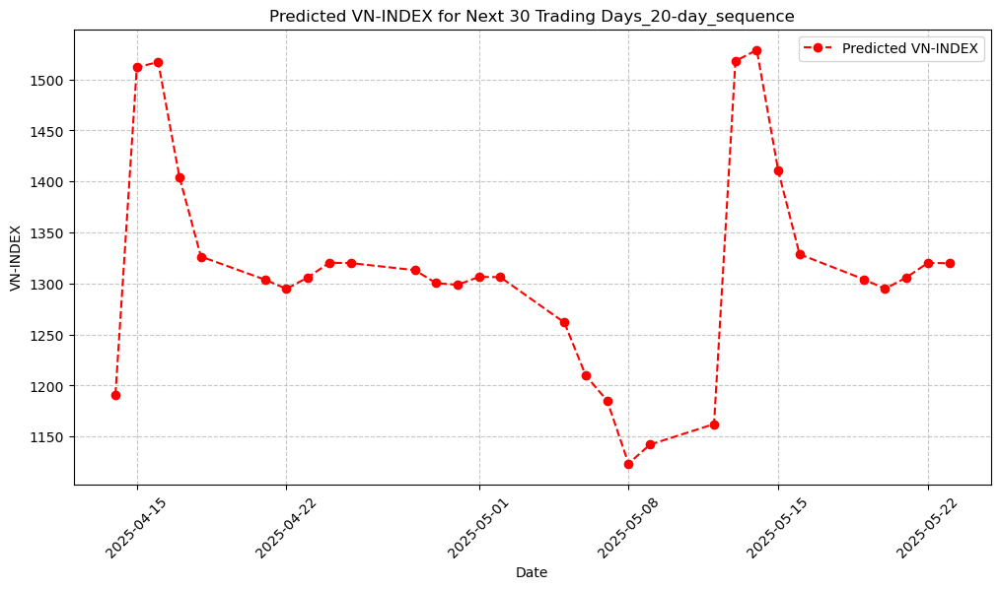

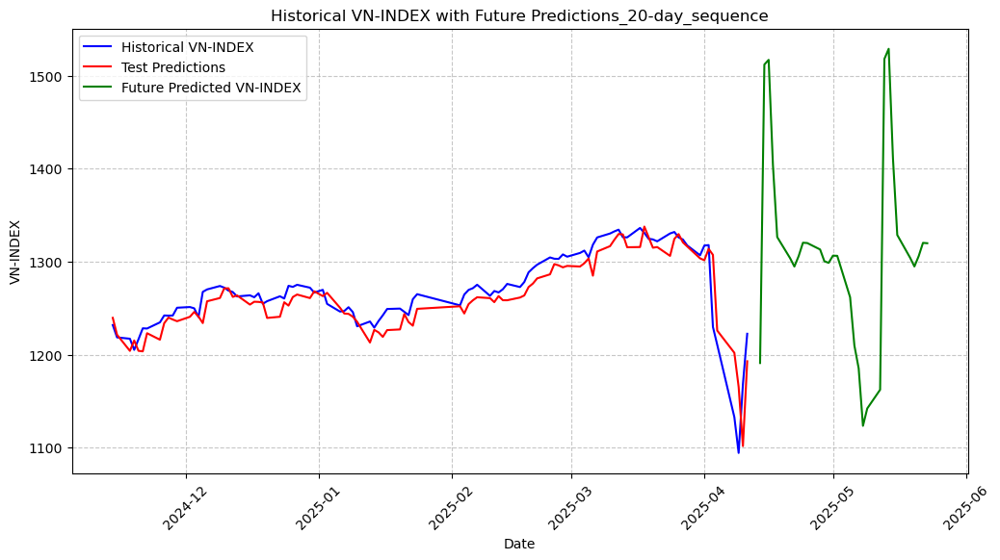

         Date  Predicted VN-INDEX
0  2025-04-14         1191.027737
1  2025-04-15         1511.995071
2  2025-04-16         1517.046588
3  2025-04-17         1403.841489
4  2025-04-18         1326.414978
5  2025-04-21         1303.769318
6  2025-04-22         1294.762262
7  2025-04-23         1305.996419
8  2025-04-24         1320.364749
9  2025-04-25         1320.044202
10 2025-04-28         1313.125284
11 2025-04-29         1300.435758
12 2025-04-30         1298.731828
13 2025-05-01         1306.468414
14 2025-05-02         1306.284749
15 2025-05-05         1261.753293
16 2025-05-06         1209.808880
17 2025-05-07         1185.229305
18 2025-05-08         1123.468955
19 2025-05-09         1142.121695
20 2025-05-12         1162.267107
21 2025-05-13         1518.042371
22 2025-05-14         1528.929931
23 2025-05-15         1410.895517
24 2025-05-16         1328.699729
25 2025-05-19         1304.204010
26 2025-05-20         1294.853362
27 2025-05-21         1305.953489
28 2025-05-22 

[I 2025-04-14 17:07:03,119] A new study created in memory with name: no-name-0105754e-ed38-4845-8655-4365af65636c
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.17440860988987528 and num_layers=1
  warnings.warn(
[I 2025-04-14 17:09:36,183] Trial 0 finished with value: 0.000390619698336665 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.17440860988987528, 'learning_rate': 0.00036843894687821826, 'batch_size': 32}. Best is trial 0 with value: 0.000390619698336665.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.296313617528458 and num_layers=1
  warnings.warn(
[I 2025-04-14 17:10:27,967] Trial 1 finished with value: 0.00118

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.1141179789852128, 'learning_rate': 0.0019920001529528833, 'batch_size': 64}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0002
RMSE: 18.2805, MAE: 13.5167, R²: 0.9231, Directional Accuracy: 0.5353


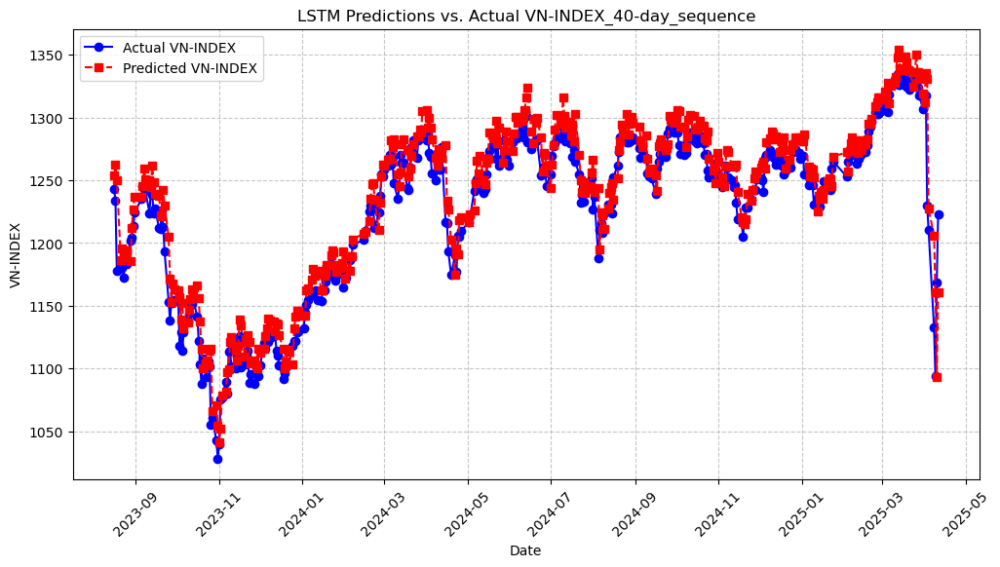

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-08-16      1243.260017         1253.842599
1   2023-08-17      1233.479995         1262.221280
2   2023-08-18      1177.989995         1249.683741
3   2023-08-21      1179.759976         1186.398271
4   2023-08-22      1180.490011         1195.384441
..         ...              ...                 ...
407 2025-04-04      1210.670016         1227.496126
408 2025-04-08      1132.790007         1205.605320
409 2025-04-09      1094.299993         1160.441094
410 2025-04-10      1168.339995         1092.934954
411 2025-04-11      1222.460024         1161.009584

[412 rows x 3 columns]


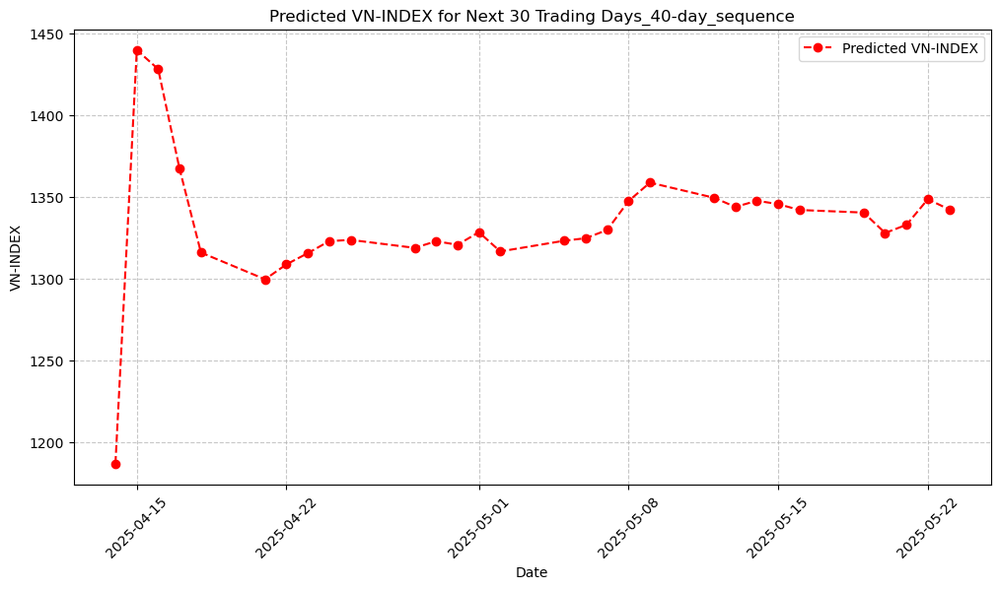

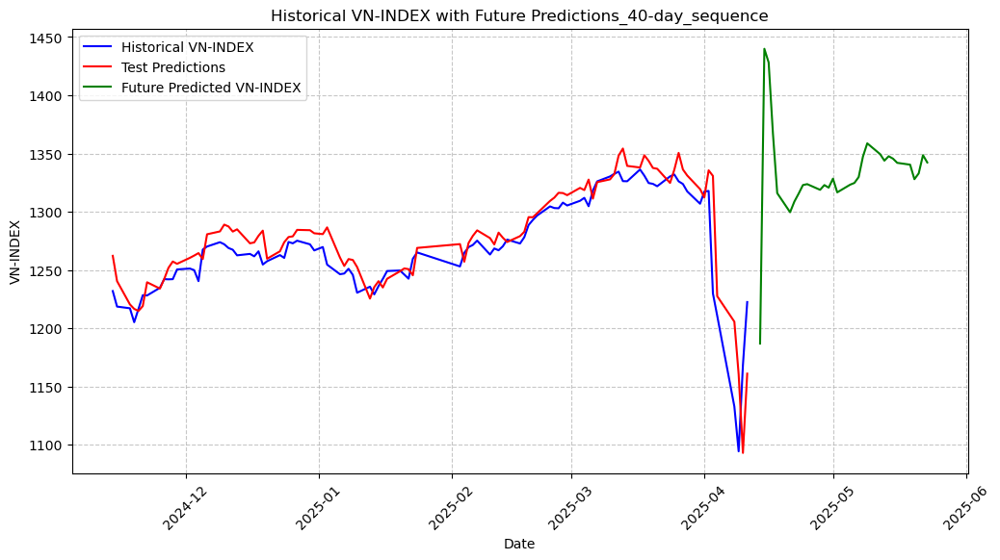

[I 2025-04-14 17:19:05,681] A new study created in memory with name: no-name-d0ca6e33-1d66-43f2-b459-87780dfd0496


         Date  Predicted VN-INDEX
0  2025-04-14         1186.808376
1  2025-04-15         1439.860004
2  2025-04-16         1428.122098
3  2025-04-17         1367.109587
4  2025-04-18         1315.940220
5  2025-04-21         1299.577704
6  2025-04-22         1308.721642
7  2025-04-23         1315.567573
8  2025-04-24         1322.915787
9  2025-04-25         1323.674494
10 2025-04-28         1318.798472
11 2025-04-29         1322.876634
12 2025-04-30         1320.663946
13 2025-05-01         1328.378412
14 2025-05-02         1316.623549
15 2025-05-05         1323.190013
16 2025-05-06         1324.702262
17 2025-05-07         1329.743605
18 2025-05-08         1347.407268
19 2025-05-09         1358.710559
20 2025-05-12         1349.451397
21 2025-05-13         1343.836708
22 2025-05-14         1347.638024
23 2025-05-15         1345.569000
24 2025-05-16         1341.965915
25 2025-05-19         1340.398636
26 2025-05-20         1327.915357
27 2025-05-21         1332.885871
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2190589901687776 and num_layers=1
  warnings.warn(
[I 2025-04-14 17:19:47,147] Trial 0 finished with value: 0.001737657306134679 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.2190589901687776, 'learning_rate': 0.0002598805669341161, 'batch_size': 128}. Best is trial 0 with value: 0.001737657306134679.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.28245651061559524 and num_layers=1
  warnings.warn(
[I 2025-04-14 17:23:21,248] Trial 1 finished with value: 0.0010510617190357151 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.28245651061559524, 'learning_rate

Best Hyperparameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.12488995220356824, 'learning_rate': 0.00344755844914385, 'batch_size': 32}
Best Overall Average Training Loss: 0.0002
Final Evaluation Loss on Test Set: 0.0003
RMSE: 19.9856, MAE: 17.0972, R²: 0.9117, Directional Accuracy: 0.5269


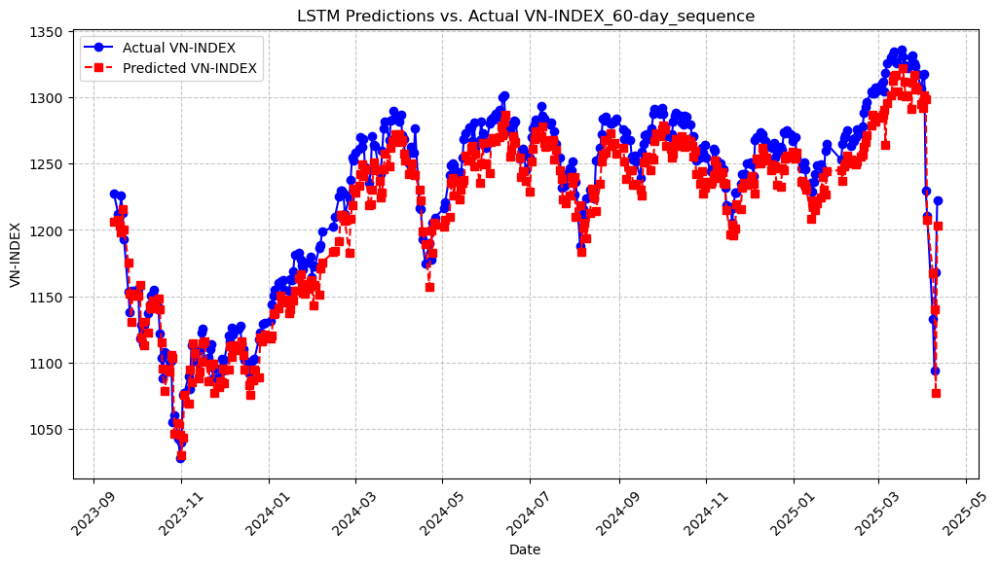

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-15      1227.360016         1206.437862
1   2023-09-18      1211.810003         1207.600739
2   2023-09-19      1211.500015         1203.611442
3   2023-09-20      1226.109969         1198.230515
4   2023-09-21      1212.739965         1215.534477
..         ...              ...                 ...
387 2025-04-04      1210.670016         1207.992347
388 2025-04-08      1132.790007         1167.206252
389 2025-04-09      1094.299993         1140.281346
390 2025-04-10      1168.339995         1077.085358
391 2025-04-11      1222.460024         1203.320568

[392 rows x 3 columns]


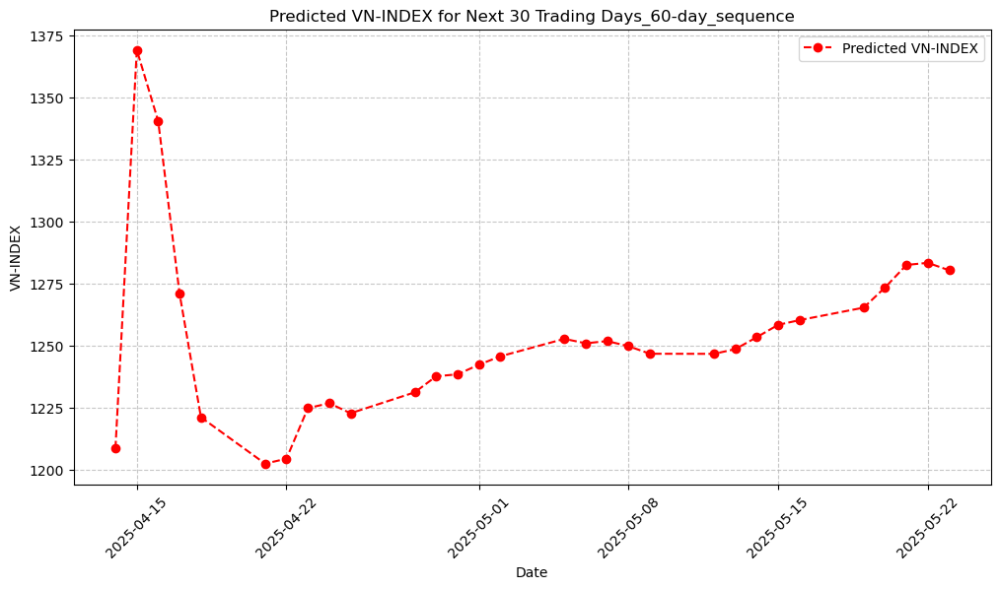

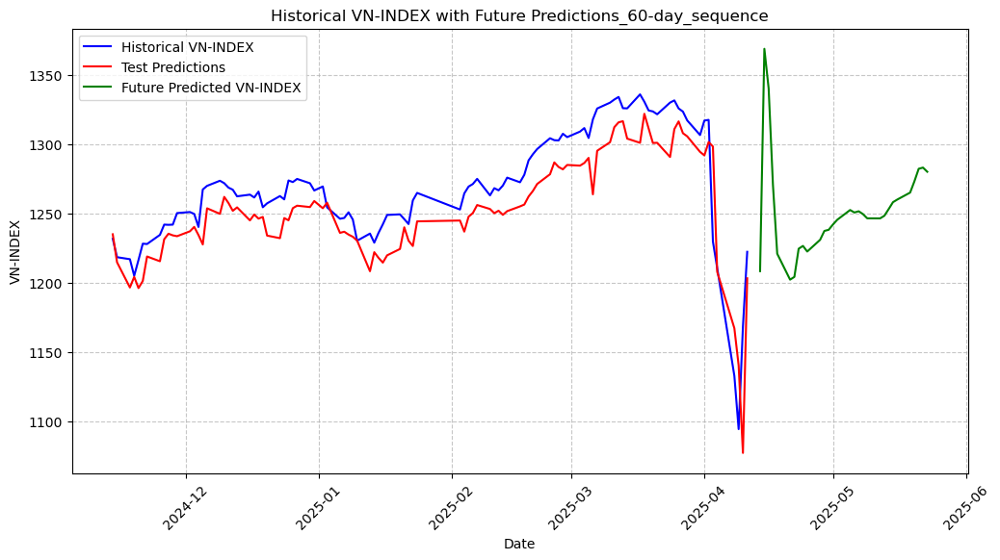

         Date  Predicted VN-INDEX
0  2025-04-14         1208.487695
1  2025-04-15         1369.204122
2  2025-04-16         1340.524342
3  2025-04-17         1270.900236
4  2025-04-18         1221.047045
5  2025-04-21         1202.338196
6  2025-04-22         1204.332537
7  2025-04-23         1224.702308
8  2025-04-24         1226.726013
9  2025-04-25         1222.664036
10 2025-04-28         1231.106918
11 2025-04-29         1237.560393
12 2025-04-30         1238.369659
13 2025-05-01         1242.221613
14 2025-05-02         1245.626620
15 2025-05-05         1252.673787
16 2025-05-06         1250.880145
17 2025-05-07         1251.774808
18 2025-05-08         1249.718270
19 2025-05-09         1246.664407
20 2025-05-12         1246.626487
21 2025-05-13         1248.547146
22 2025-05-14         1253.359583
23 2025-05-15         1258.331406
24 2025-05-16         1260.231024
25 2025-05-19         1265.265893
26 2025-05-20         1273.413663
27 2025-05-21         1282.487003
28 2025-05-22 

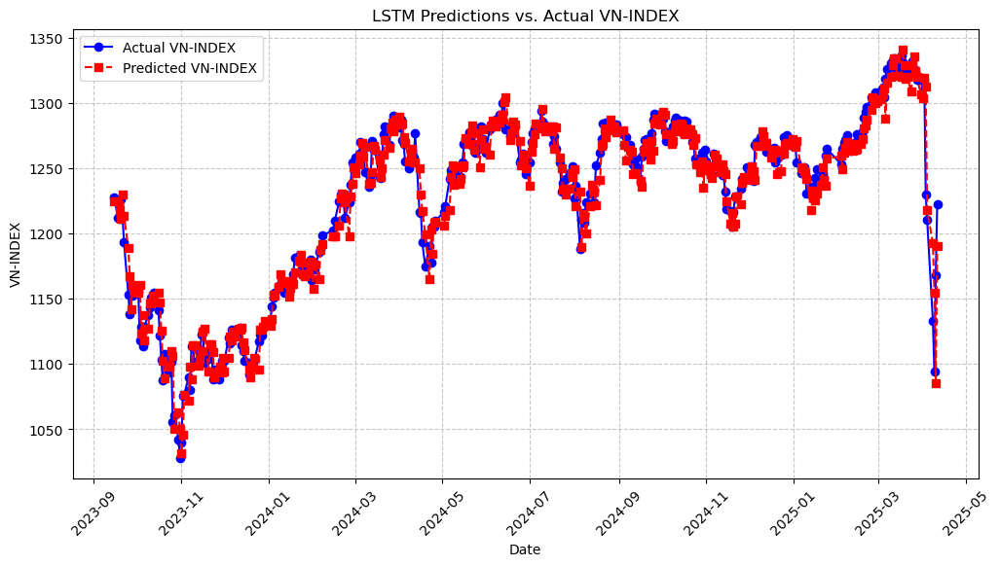

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-15      1227.360016         1224.918822
1   2023-09-18      1211.810003         1224.887127
2   2023-09-19      1211.500015         1217.672046
3   2023-09-20      1226.109969         1211.080570
4   2023-09-21      1212.739965         1229.796863
..         ...              ...                 ...
387 2025-04-04      1210.670016         1217.759679
388 2025-04-08      1132.790007         1192.570777
389 2025-04-09      1094.299993         1154.902088
390 2025-04-10      1168.339995         1085.273458
391 2025-04-11      1222.460024         1190.410039

[392 rows x 3 columns]


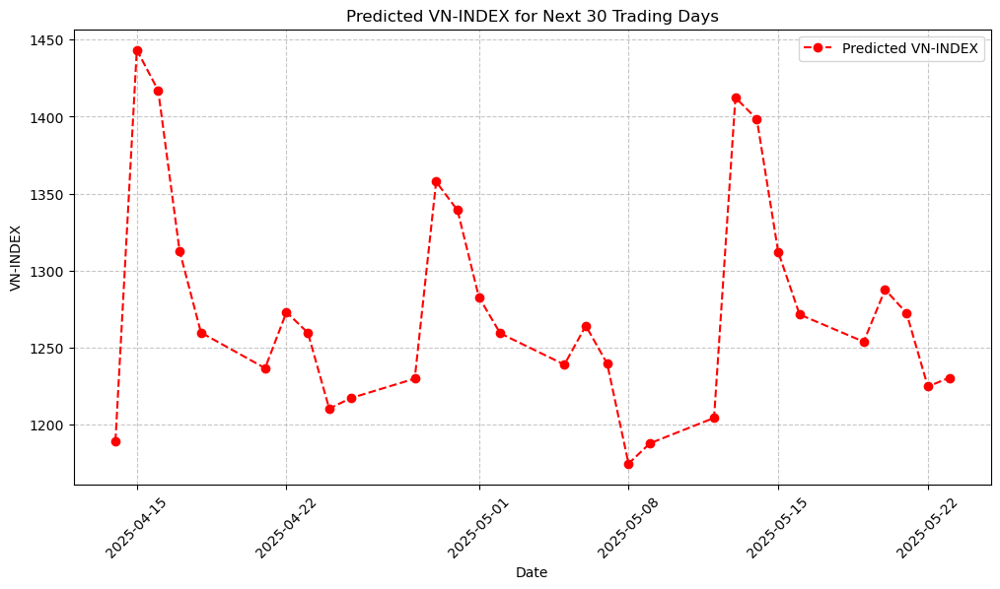

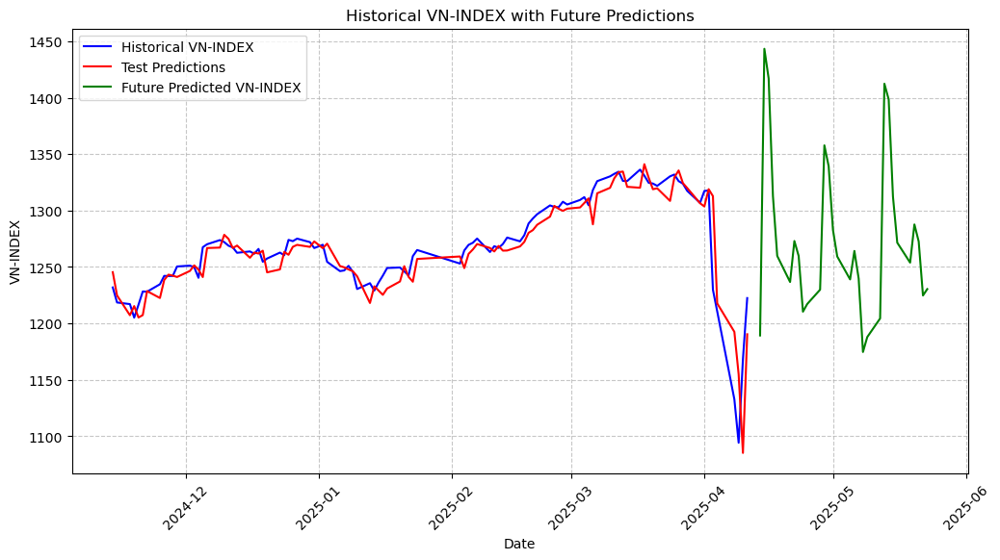


Ensemble Future Predictions (weighted average) for next 30 days:
         Date  Predicted Future VN-INDEX
0  2025-04-14                1189.341096
1  2025-04-15                1443.300881
2  2025-04-16                1417.000813
3  2025-04-17                1312.850996
4  2025-04-18                1259.821240
5  2025-04-21                1236.712085
6  2025-04-22                1273.038900
7  2025-04-23                1259.737553
8  2025-04-24                1210.415794
9  2025-04-25                1217.211194
10 2025-04-28                1229.903796
11 2025-04-29                1357.759779
12 2025-04-30                1339.229823
13 2025-05-01                1282.880041
14 2025-05-02                1259.314921
15 2025-05-05                1239.009162
16 2025-05-06                1264.219560
17 2025-05-07                1239.719660
18 2025-05-08                1174.719914
19 2025-05-09                1187.918501
20 2025-05-12                1204.415185
21 2025-05-13                141

In [9]:
# 📊 Select additional VN-INDEX statistics for prediction
data = lag_features_indicators(df_1, ['VN_Index_Close'])

ensemble_lstm_model(data)


Training LSTM with sequence length = 5


/var/folders/fl/t1q3j3rn0dg278fhg2bvg0dw0000gn/T/ipykernel_31202/3744217377.py:65: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  copy_df['Month'] = copy_df.index.month
/var/folders/fl/t1q3j3rn0dg278fhg2bvg0dw0000gn/T/ipykernel_31202/3744217377.py:69: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  copy_df[f'{col}_EMA_Ratio'] = copy_df[f'{col}_EMA_10'] / copy_df[f'{col}_EMA_20']
/var/folders/fl/t1q3j3rn0dg278fhg2bvg0dw0000gn/T/ipykernel_31202/3744217377.py:69: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.20310489546603896, 'learning_rate': 0.002238613124963185, 'batch_size': 32}
Best Overall Average Training Loss: 0.0002
Final Evaluation Loss on Test Set: 0.0004
RMSE: 27.2892, MAE: 21.5368, R²: 0.8252, Directional Accuracy: 0.5090


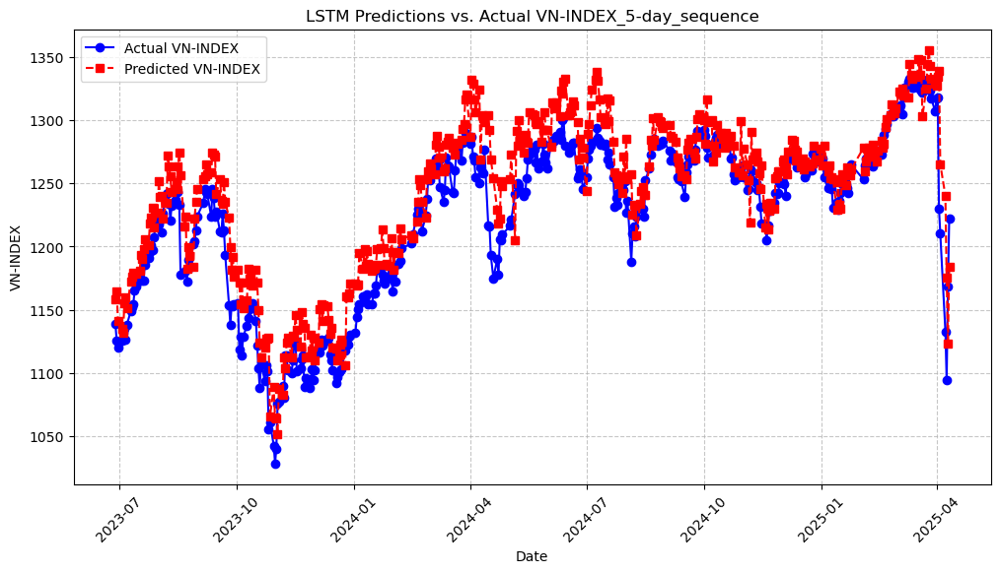

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-06-28      1138.349975         1158.095532
1   2023-06-29      1125.389999         1164.258365
2   2023-06-30      1120.180020         1140.929916
3   2023-07-03      1125.499982         1134.728470
4   2023-07-04      1132.000009         1131.325235
..         ...              ...                 ...
442 2025-04-04      1210.670016         1265.193137
443 2025-04-08      1132.790007         1240.326773
444 2025-04-09      1094.299993         1175.262921
445 2025-04-10      1168.339995         1122.936612
446 2025-04-11      1222.460024         1183.927234

[447 rows x 3 columns]


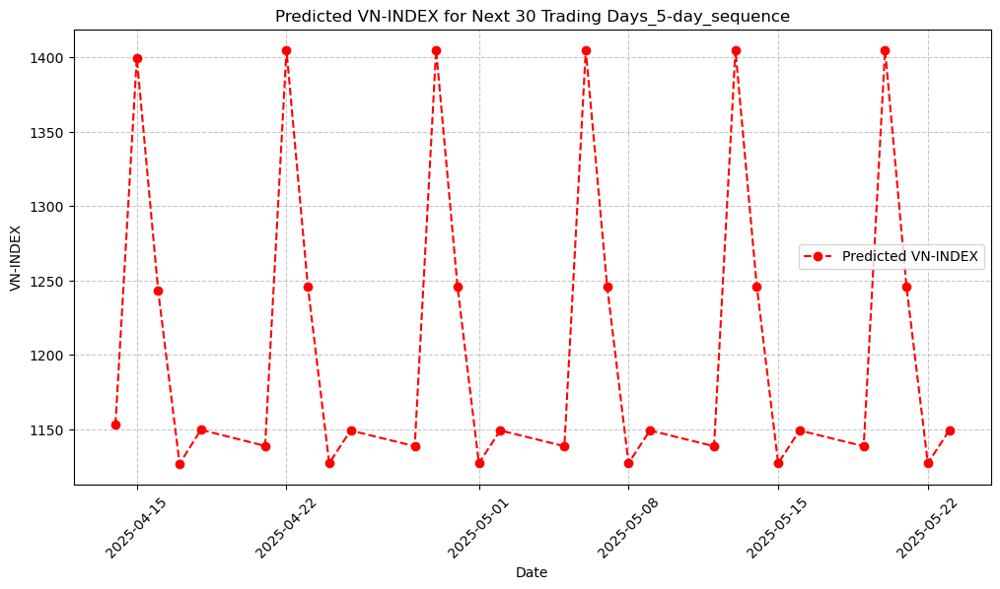

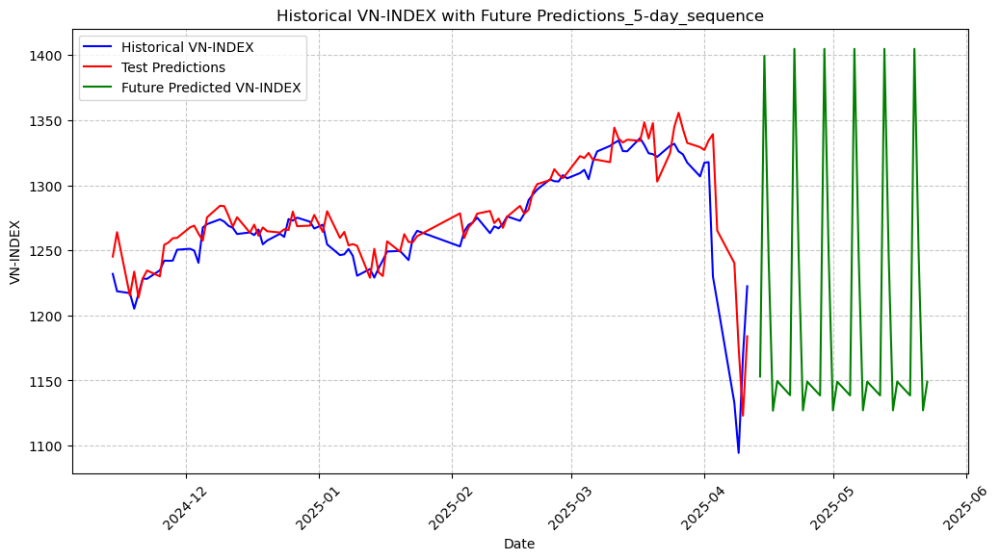

[I 2025-04-14 17:38:26,331] A new study created in memory with name: no-name-6c693be7-7b19-4d95-8010-dbe35b16e556


         Date  Predicted VN-INDEX
0  2025-04-14         1152.991605
1  2025-04-15         1399.575115
2  2025-04-16         1242.859700
3  2025-04-17         1126.773305
4  2025-04-18         1149.527483
5  2025-04-21         1138.695493
6  2025-04-22         1404.914114
7  2025-04-23         1245.924507
8  2025-04-24         1127.038128
9  2025-04-25         1149.092561
10 2025-04-28         1138.488398
11 2025-04-29         1404.912727
12 2025-04-30         1245.954873
13 2025-05-01         1127.047377
14 2025-05-02         1149.091096
15 2025-05-05         1138.486625
16 2025-05-06         1404.912187
17 2025-05-07         1245.955105
18 2025-05-08         1127.047531
19 2025-05-09         1149.091019
20 2025-05-12         1138.486548
21 2025-05-13         1404.912264
22 2025-05-14         1245.955105
23 2025-05-15         1127.047531
24 2025-05-16         1149.091019
25 2025-05-19         1138.486548
26 2025-05-20         1404.912187
27 2025-05-21         1245.955105
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.25098452829561796 and num_layers=1
  warnings.warn(
[I 2025-04-14 17:39:04,151] Trial 0 finished with value: 0.0003704378877155534 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.25098452829561796, 'learning_rate': 0.004249752663252617, 'batch_size': 32}. Best is trial 0 with value: 0.0003704378877155534.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.14250639309396687 and num_layers=1
  warnings.warn(
[I 2025-04-14 17:39:11,336] Trial 1 finished with value: 0.002227582179975798 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.14250639309396687, 'learning_rat

Best Hyperparameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.44173678735709554, 'learning_rate': 0.001846433452372023, 'batch_size': 32}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0020
RMSE: 57.0154, MAE: 53.1253, R²: 0.2267, Directional Accuracy: 0.5306


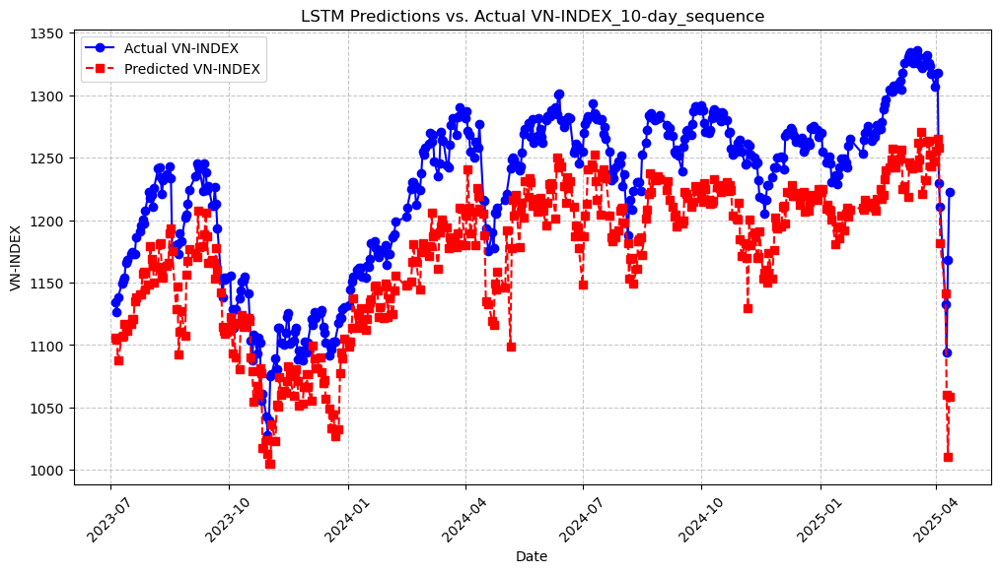

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-05      1134.620028         1106.096937
1   2023-07-06      1126.219998         1104.046102
2   2023-07-07      1138.069969         1087.496684
3   2023-07-10      1149.020035         1106.374169
4   2023-07-11      1151.769999         1107.446100
..         ...              ...                 ...
437 2025-04-04      1210.670016         1181.740828
438 2025-04-08      1132.790007         1141.282833
439 2025-04-09      1094.299993         1060.409078
440 2025-04-10      1168.339995         1010.504325
441 2025-04-11      1222.460024         1058.330034

[442 rows x 3 columns]


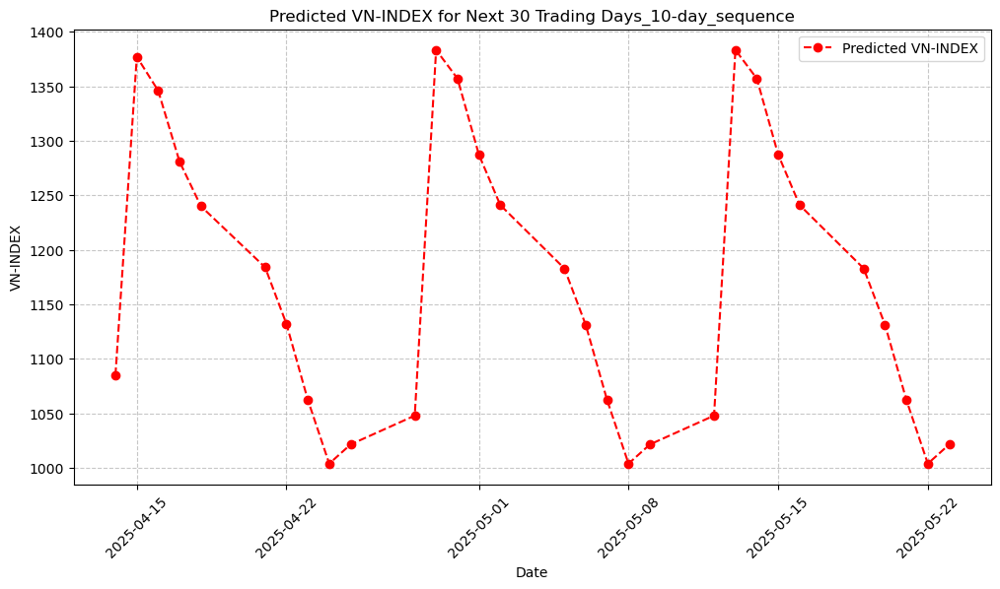

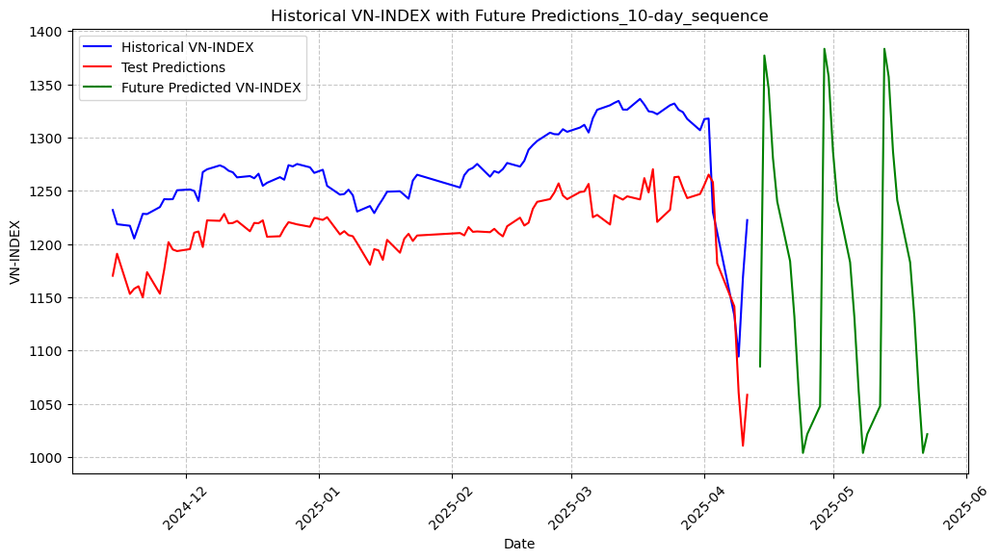

[I 2025-04-14 17:42:18,004] A new study created in memory with name: no-name-a3361d7b-84b5-4364-82af-9573c9a646fe


         Date  Predicted VN-INDEX
0  2025-04-14         1085.015089
1  2025-04-15         1377.049227
2  2025-04-16         1345.935328
3  2025-04-17         1280.833248
4  2025-04-18         1239.907573
5  2025-04-21         1183.945038
6  2025-04-22         1131.935345
7  2025-04-23         1062.218135
8  2025-04-24         1003.759437
9  2025-04-25         1021.361826
10 2025-04-28         1047.806567
11 2025-04-29         1383.317418
12 2025-04-30         1357.097268
13 2025-05-01         1287.295046
14 2025-05-02         1241.060277
15 2025-05-05         1182.860621
16 2025-05-06         1130.970006
17 2025-05-07         1061.946915
18 2025-05-08         1003.757202
19 2025-05-09         1021.391037
20 2025-05-12         1047.824294
21 2025-05-13         1383.325433
22 2025-05-14         1357.098193
23 2025-05-15         1287.291809
24 2025-05-16         1241.056886
25 2025-05-19         1182.858849
26 2025-05-20         1130.969698
27 2025-05-21         1061.947146
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.49594072198554695 and num_layers=1
  warnings.warn(
[I 2025-04-14 17:42:46,569] Trial 0 finished with value: 0.0005241844524618954 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.49594072198554695, 'learning_rate': 0.006297350334031764, 'batch_size': 64}. Best is trial 0 with value: 0.0005241844524618954.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2057758129374601 and num_layers=1
  warnings.warn(
[I 2025-04-14 17:43:13,446] Trial 1 finished with value: 0.00027791320665528476 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.2057758129374601, 'learning_rat

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.4809128764024041, 'learning_rate': 0.0008168212638679791, 'batch_size': 32}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0004
RMSE: 24.2577, MAE: 17.5886, R²: 0.8590, Directional Accuracy: 0.5406


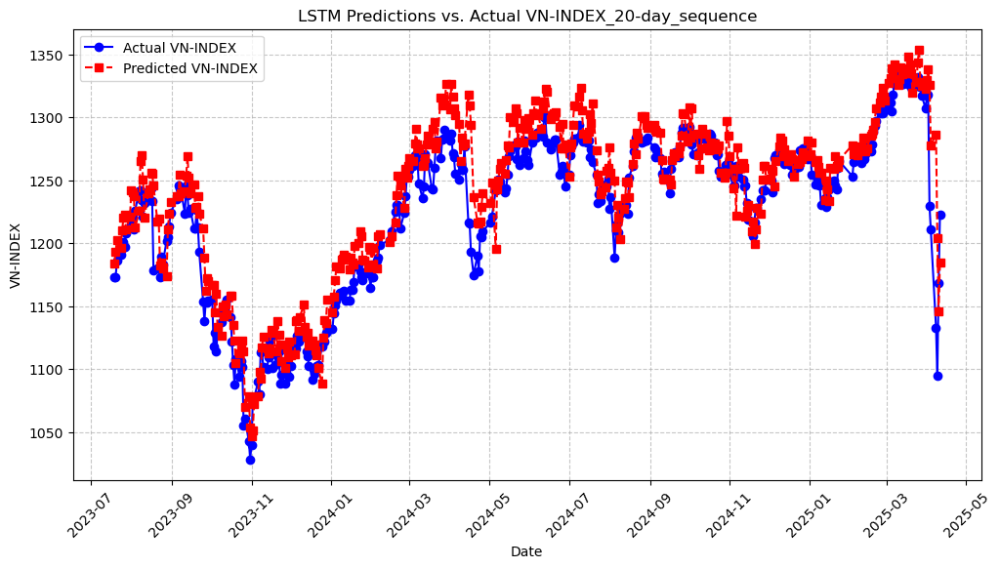

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-19      1172.980020         1184.029510
1   2023-07-20      1172.809997         1192.721415
2   2023-07-21      1185.899994         1202.327945
3   2023-07-24      1190.719984         1195.879789
4   2023-07-25      1195.899982         1209.829690
..         ...              ...                 ...
427 2025-04-04      1210.670016         1277.956191
428 2025-04-08      1132.790007         1286.364313
429 2025-04-09      1094.299993         1204.288836
430 2025-04-10      1168.339995         1145.820967
431 2025-04-11      1222.460024         1184.275758

[432 rows x 3 columns]


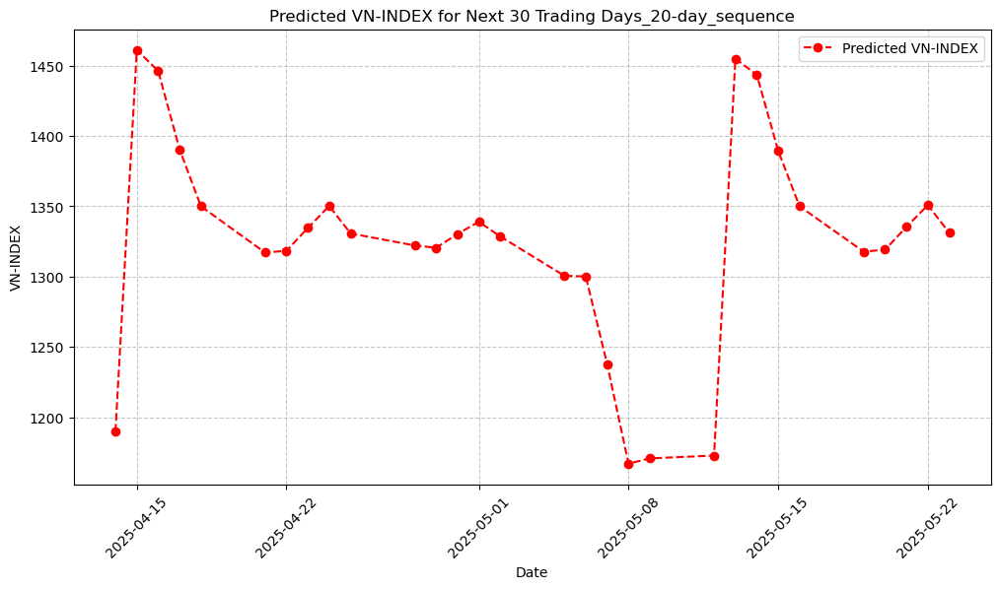

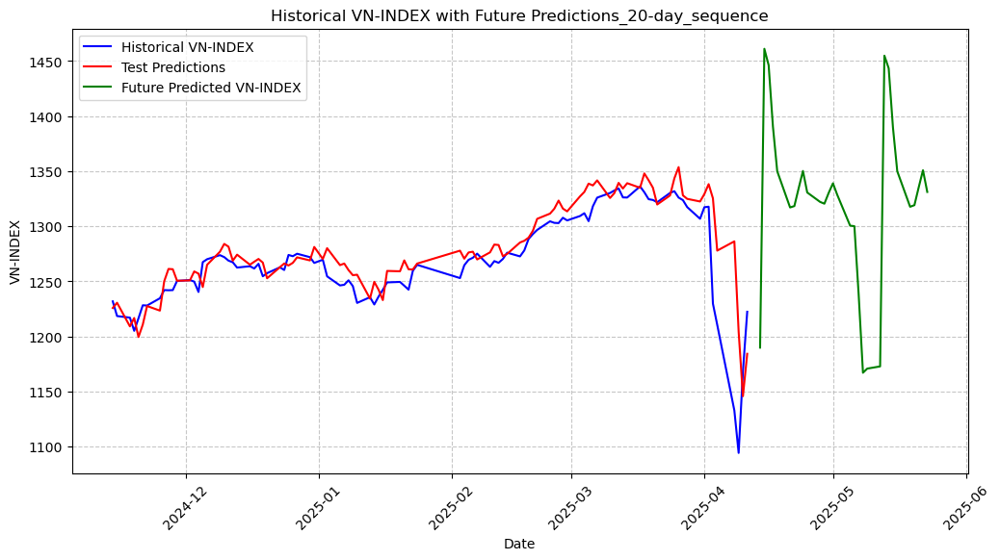

[I 2025-04-14 17:47:34,933] A new study created in memory with name: no-name-1128746e-5fc5-4480-a8ba-9b8b7dca628c


         Date  Predicted VN-INDEX
0  2025-04-14         1189.910641
1  2025-04-15         1461.161126
2  2025-04-16         1446.242109
3  2025-04-17         1390.492912
4  2025-04-18         1350.001852
5  2025-04-21         1317.129456
6  2025-04-22         1318.415804
7  2025-04-23         1334.604059
8  2025-04-24         1350.254189
9  2025-04-25         1330.730371
10 2025-04-28         1322.179740
11 2025-04-29         1320.545408
12 2025-04-30         1330.327125
13 2025-05-01         1339.045774
14 2025-05-02         1328.620960
15 2025-05-05         1300.642930
16 2025-05-06         1300.132398
17 2025-05-07         1237.836468
18 2025-05-08         1167.092261
19 2025-05-09         1170.851264
20 2025-05-12         1172.842599
21 2025-05-13         1454.951972
22 2025-05-14         1443.461470
23 2025-05-15         1389.531966
24 2025-05-16         1350.016959
25 2025-05-19         1317.761147
26 2025-05-20         1319.215822
27 2025-05-21         1335.379336
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.14986441253867389 and num_layers=1
  warnings.warn(
[I 2025-04-14 17:48:32,011] Trial 0 finished with value: 0.00028725062333421645 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.14986441253867389, 'learning_rate': 0.003938055373762706, 'batch_size': 64}. Best is trial 0 with value: 0.00028725062333421645.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.15833244774696353 and num_layers=1
  warnings.warn(
[I 2025-04-14 17:50:00,234] Trial 1 finished with value: 0.0005457505369872706 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.15833244774696353, 'learning

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.25447946251126347, 'learning_rate': 0.0016837415791230886, 'batch_size': 32}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0003
RMSE: 22.4786, MAE: 17.8305, R²: 0.8837, Directional Accuracy: 0.5207


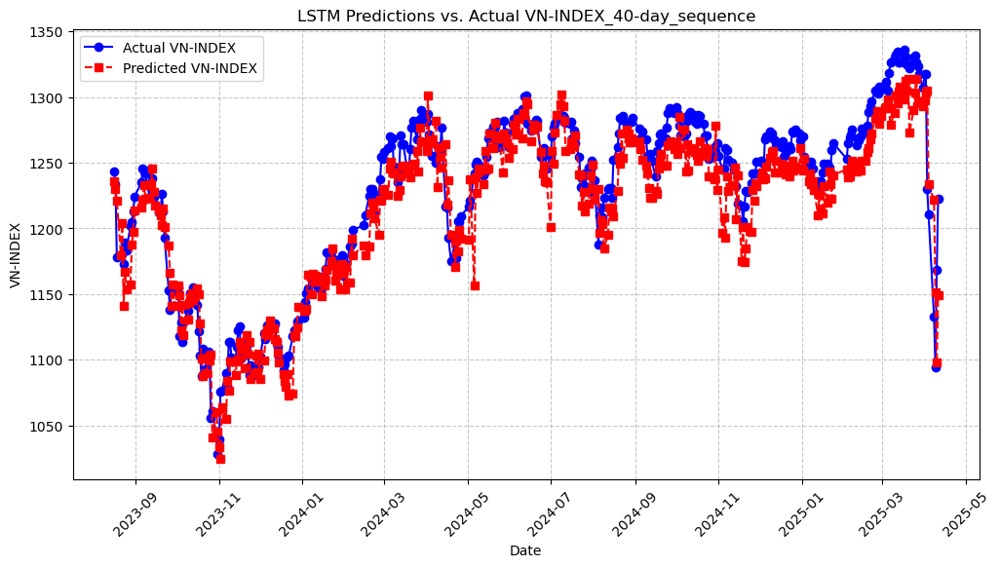

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-08-16      1243.260017         1236.229111
1   2023-08-17      1233.479995         1230.000690
2   2023-08-18      1177.989995         1221.039646
3   2023-08-21      1179.759976         1179.793888
4   2023-08-22      1180.490011         1203.798883
..         ...              ...                 ...
407 2025-04-04      1210.670016         1233.345349
408 2025-04-08      1132.790007         1221.551950
409 2025-04-09      1094.299993         1151.396888
410 2025-04-10      1168.339995         1097.791245
411 2025-04-11      1222.460024         1148.817718

[412 rows x 3 columns]


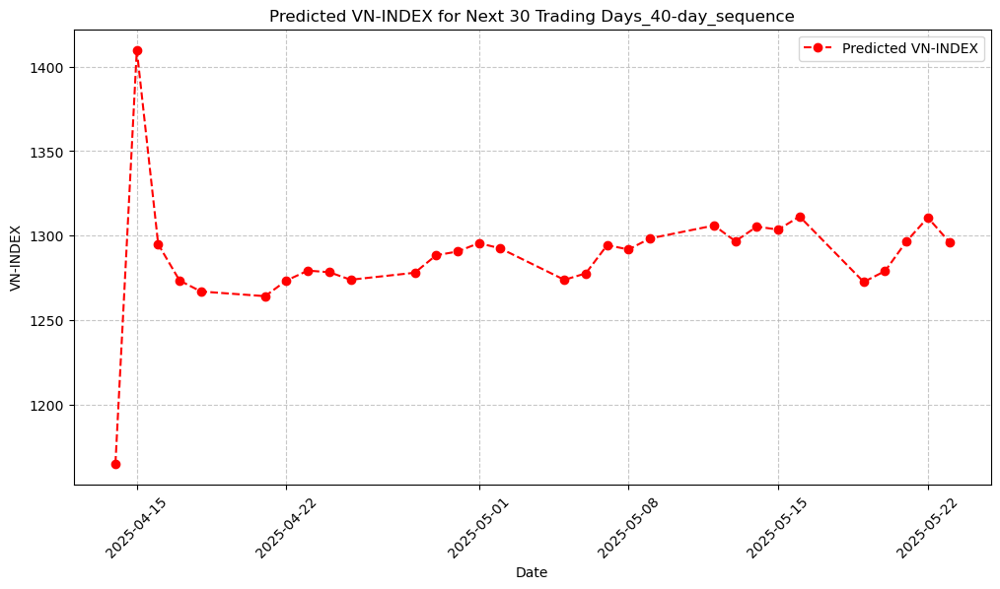

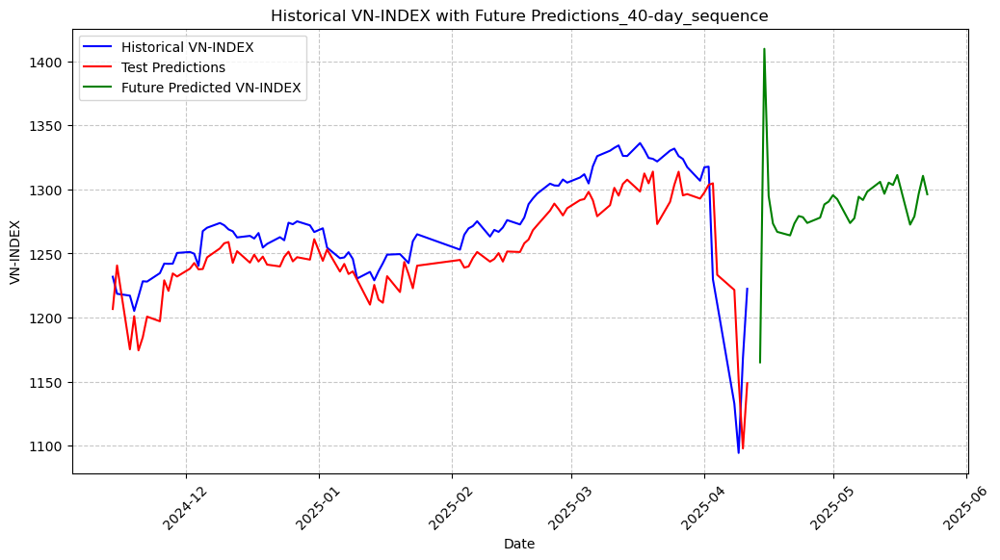

[I 2025-04-14 18:03:05,149] A new study created in memory with name: no-name-b7bccb73-7ac4-48d1-857f-cbcee37e7e79


         Date  Predicted VN-INDEX
0  2025-04-14         1165.045588
1  2025-04-15         1409.850330
2  2025-04-16         1294.889201
3  2025-04-17         1273.410195
4  2025-04-18         1266.926816
5  2025-04-21         1264.153268
6  2025-04-22         1273.438866
7  2025-04-23         1279.269591
8  2025-04-24         1278.344561
9  2025-04-25         1273.874174
10 2025-04-28         1278.014535
11 2025-04-29         1288.353566
12 2025-04-30         1290.564019
13 2025-05-01         1295.540005
14 2025-05-02         1292.447683
15 2025-05-05         1273.825618
16 2025-05-06         1277.646588
17 2025-05-07         1294.347840
18 2025-05-08         1291.783468
19 2025-05-09         1298.319103
20 2025-05-12         1305.974145
21 2025-05-13         1296.668045
22 2025-05-14         1305.342146
23 2025-05-15         1303.513821
24 2025-05-16         1311.284627
25 2025-05-19         1272.576111
26 2025-05-20         1279.006464
27 2025-05-21         1296.593747
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.30468234773961556 and num_layers=1
  warnings.warn(
[I 2025-04-14 18:06:14,450] Trial 0 finished with value: 0.0006654335472308048 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.30468234773961556, 'learning_rate': 0.000812395932502214, 'batch_size': 128}. Best is trial 0 with value: 0.0006654335472308048.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4588356639805701 and num_layers=1
  warnings.warn(
[I 2025-04-14 18:07:40,243] Trial 1 finished with value: 0.00036313487102802356 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.4588356639805701, 'learning_r

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.2304114613402958, 'learning_rate': 0.0021351622443358067, 'batch_size': 64}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0016
RMSE: 40.7389, MAE: 33.8832, R²: 0.6332, Directional Accuracy: 0.4910


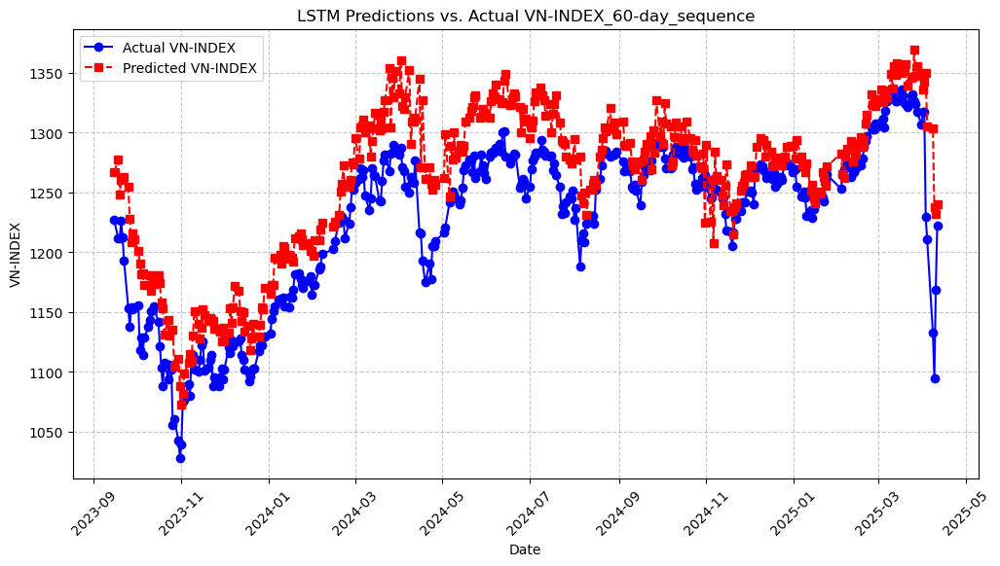

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-15      1227.360016         1266.847046
1   2023-09-18      1211.810003         1277.230086
2   2023-09-19      1211.500015         1248.176040
3   2023-09-20      1226.109969         1260.545944
4   2023-09-21      1212.739965         1261.542652
..         ...              ...                 ...
387 2025-04-04      1210.670016         1305.182837
388 2025-04-08      1132.790007         1303.373934
389 2025-04-09      1094.299993         1237.587831
390 2025-04-10      1168.339995         1231.845355
391 2025-04-11      1222.460024         1239.972469

[392 rows x 3 columns]


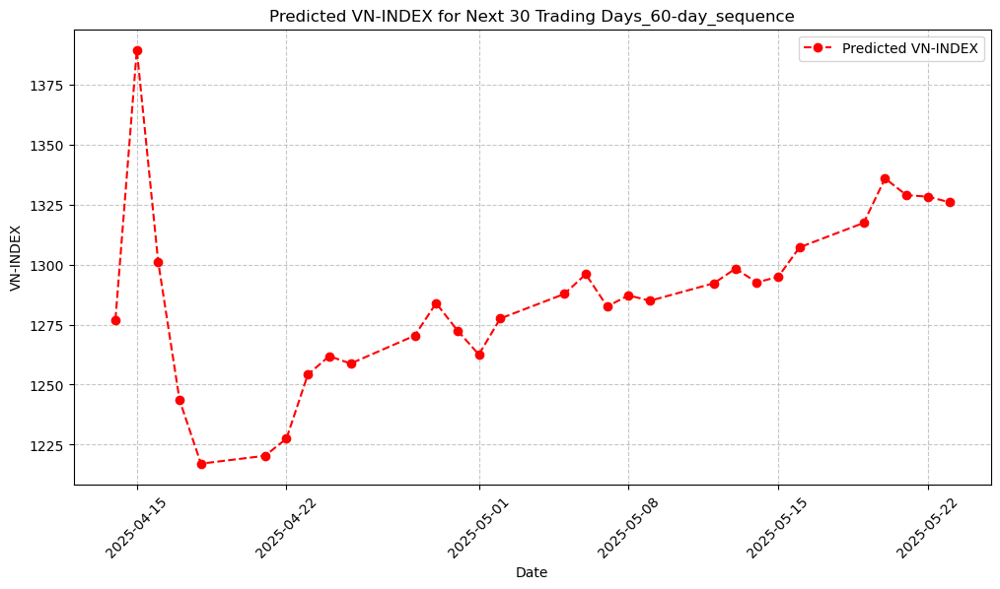

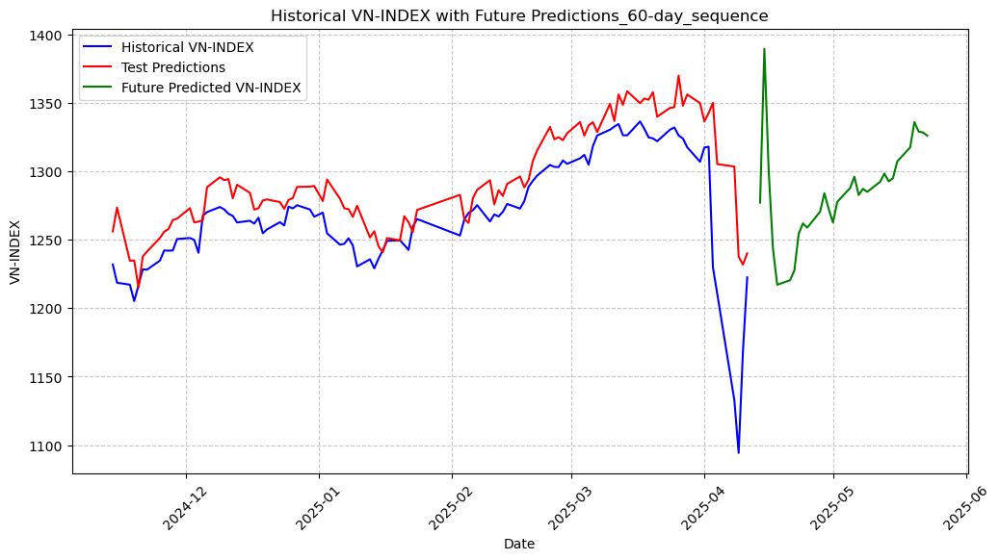

         Date  Predicted VN-INDEX
0  2025-04-14         1277.049042
1  2025-04-15         1389.332347
2  2025-04-16         1301.129260
3  2025-04-17         1243.534782
4  2025-04-18         1217.087806
5  2025-04-21         1220.375739
6  2025-04-22         1227.524798
7  2025-04-23         1254.187809
8  2025-04-24         1261.850867
9  2025-04-25         1258.763015
10 2025-04-28         1270.390399
11 2025-04-29         1283.894355
12 2025-04-30         1272.504819
13 2025-05-01         1262.520785
14 2025-05-02         1277.510786
15 2025-05-05         1287.754016
16 2025-05-06         1295.987105
17 2025-05-07         1282.521840
18 2025-05-08         1287.148068
19 2025-05-09         1284.900466
20 2025-05-12         1292.218853
21 2025-05-13         1298.264612
22 2025-05-14         1292.576626
23 2025-05-15         1294.854595
24 2025-05-16         1307.160067
25 2025-05-19         1317.323989
26 2025-05-20         1335.840386
27 2025-05-21         1328.879771
28 2025-05-22 

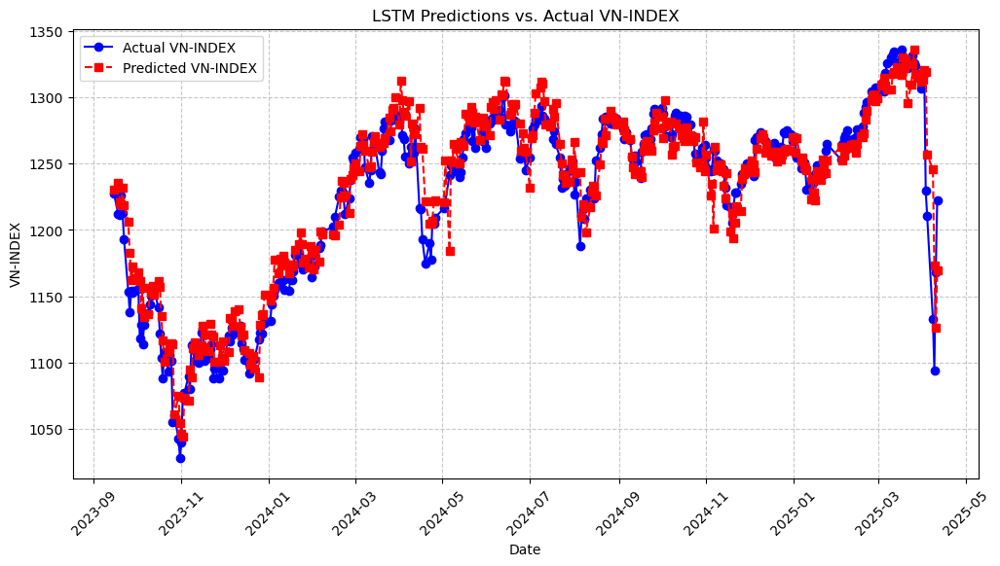

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-15      1227.360016         1230.195189
1   2023-09-18      1211.810003         1235.530416
2   2023-09-19      1211.500015         1221.139410
3   2023-09-20      1226.109969         1219.495481
4   2023-09-21      1212.739965         1231.560758
..         ...              ...                 ...
387 2025-04-04      1210.670016         1256.845277
388 2025-04-08      1132.790007         1245.636092
389 2025-04-09      1094.299993         1173.136140
390 2025-04-10      1168.339995         1126.136059
391 2025-04-11      1222.460024         1169.486266

[392 rows x 3 columns]


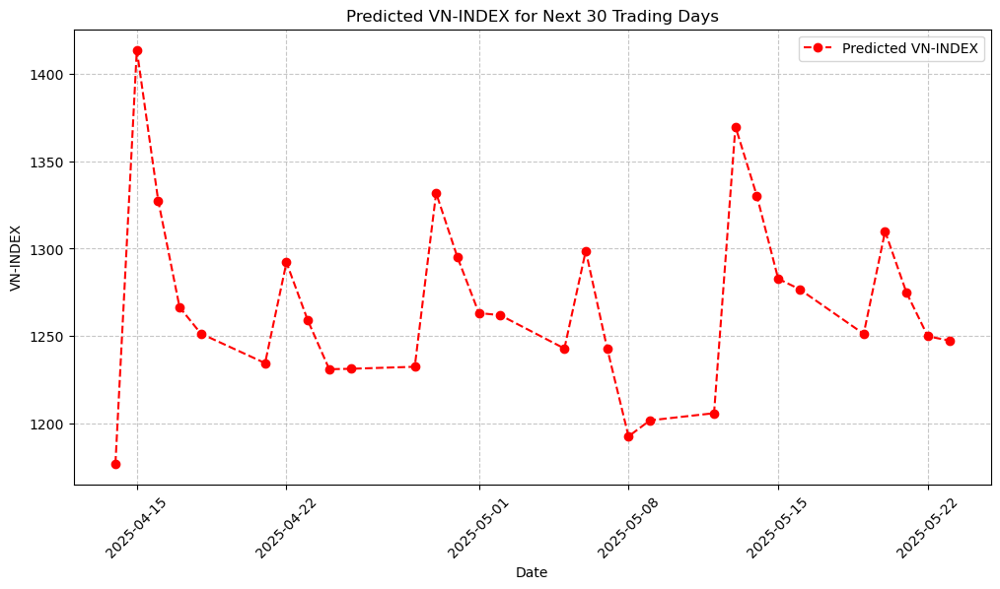

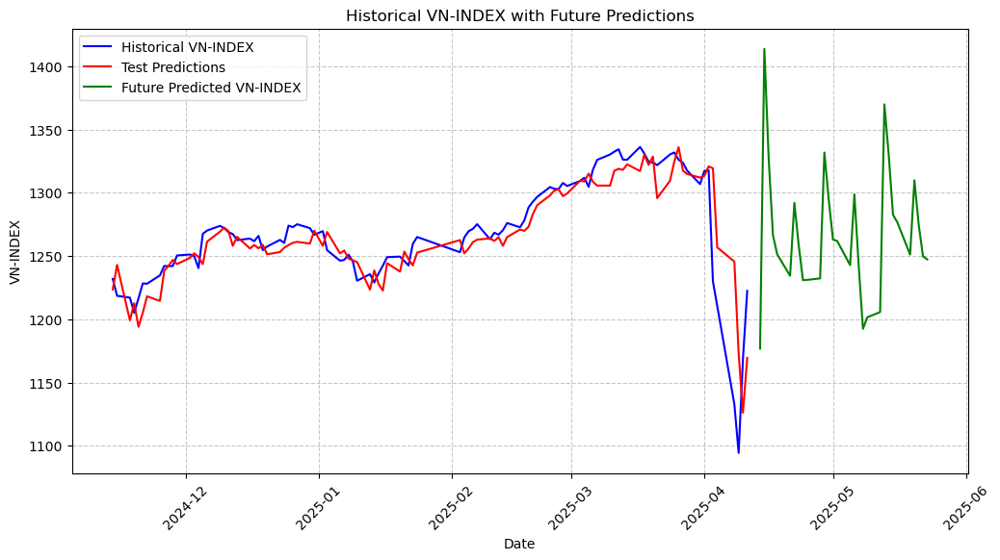


Ensemble Future Predictions (weighted average) for next 30 days:
         Date  Predicted Future VN-INDEX
0  2025-04-14                1176.775986
1  2025-04-15                1413.862470
2  2025-04-16                1327.613745
3  2025-04-17                1266.417019
4  2025-04-18                1251.269979
5  2025-04-21                1234.386850
6  2025-04-22                1292.066255
7  2025-04-23                1258.816265
8  2025-04-24                1230.905096
9  2025-04-25                1231.132444
10 2025-04-28                1232.302127
11 2025-04-29                1331.861329
12 2025-04-30                1294.992093
13 2025-05-01                1263.090855
14 2025-05-02                1261.859397
15 2025-05-05                1242.766025
16 2025-05-06                1298.737236
17 2025-05-07                1242.843955
18 2025-05-08                1192.401569
19 2025-05-09                1201.569570
20 2025-05-12                1205.688369
21 2025-05-13                136

In [10]:
# 📊 Select additional VN-INDEX statistics for prediction
data = lag_features_indicators(df_1, df_1.columns)

ensemble_lstm_model(data)

In [11]:
# 📂 Load dataset
file_path_2 = "../ready_data/vn_index_external_data.csv"
df_2 = pd.read_csv(file_path_2)
df_2 = quicky_data(df_2)

[I 2025-04-14 18:22:37,435] A new study created in memory with name: no-name-d3b897ab-9f9b-44a2-94a3-f0ad83966a86



Training LSTM with sequence length = 5


/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2418098182082835 and num_layers=1
  warnings.warn(
[I 2025-04-14 18:22:43,842] Trial 0 finished with value: 0.00062355294123563 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.2418098182082835, 'learning_rate': 0.0014428911441034537, 'batch_size': 64}. Best is trial 0 with value: 0.00062355294123563.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.20654145368662716 and num_layers=1
  warnings.warn(
[I 2025-04-14 18:22:53,184] Trial 1 finished with value: 0.0004191664986547039 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.20654145368662716, 'learning_rate': 

Best Hyperparameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.20654145368662716, 'learning_rate': 0.0035721010836175056, 'batch_size': 32}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0003
RMSE: 17.4186, MAE: 13.3292, R²: 0.9291, Directional Accuracy: 0.5268


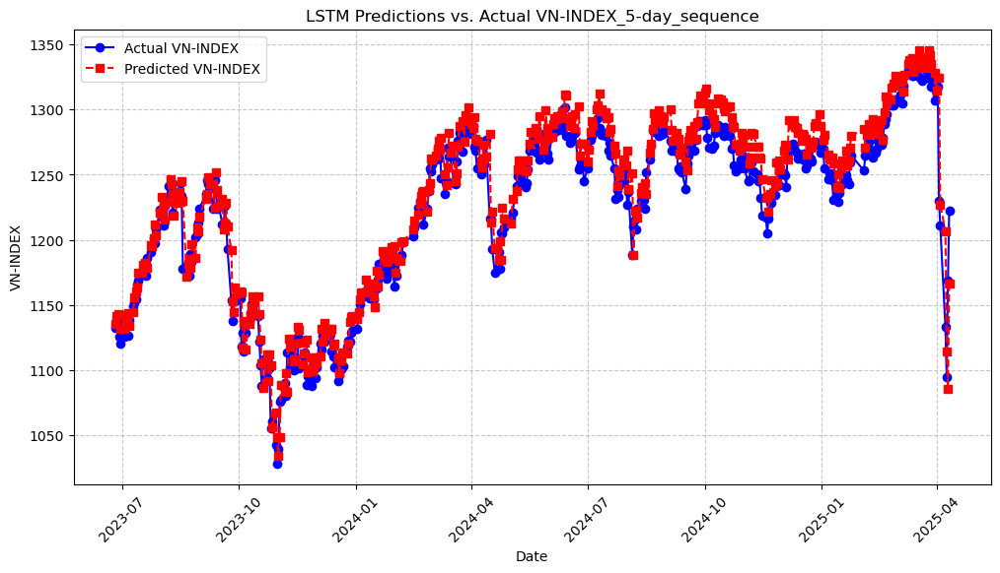

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-06-26      1132.029991         1135.643634
1   2023-06-27      1134.330002         1141.409232
2   2023-06-28      1138.349975         1143.029769
3   2023-06-29      1125.389999         1142.059805
4   2023-06-30      1120.180020         1131.533486
..         ...              ...                 ...
444 2025-04-04      1210.670016         1227.096349
445 2025-04-08      1132.790007         1206.775827
446 2025-04-09      1094.299993         1114.214957
447 2025-04-10      1168.339995         1085.229660
448 2025-04-11      1222.460024         1166.156210

[449 rows x 3 columns]


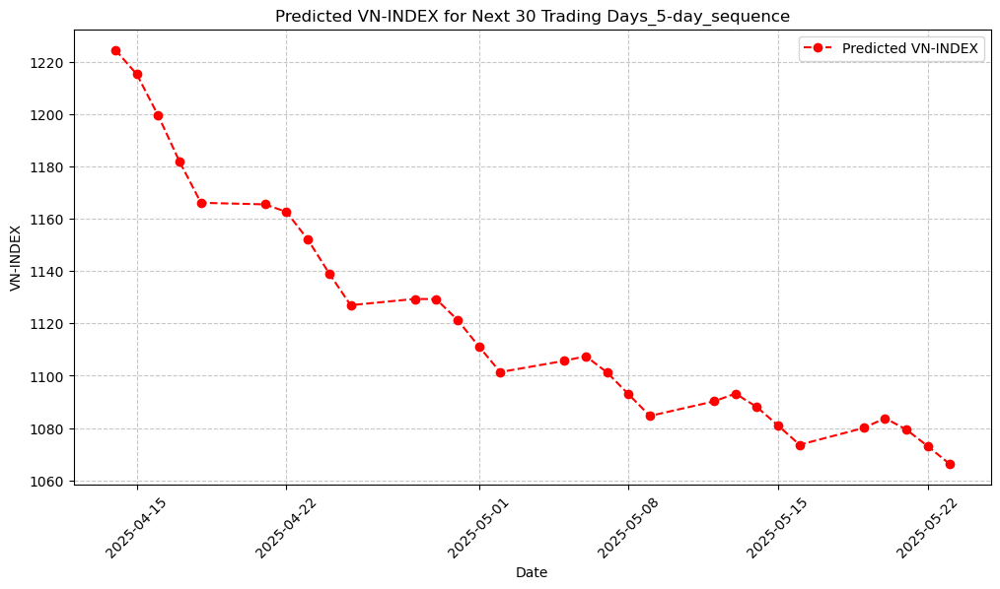

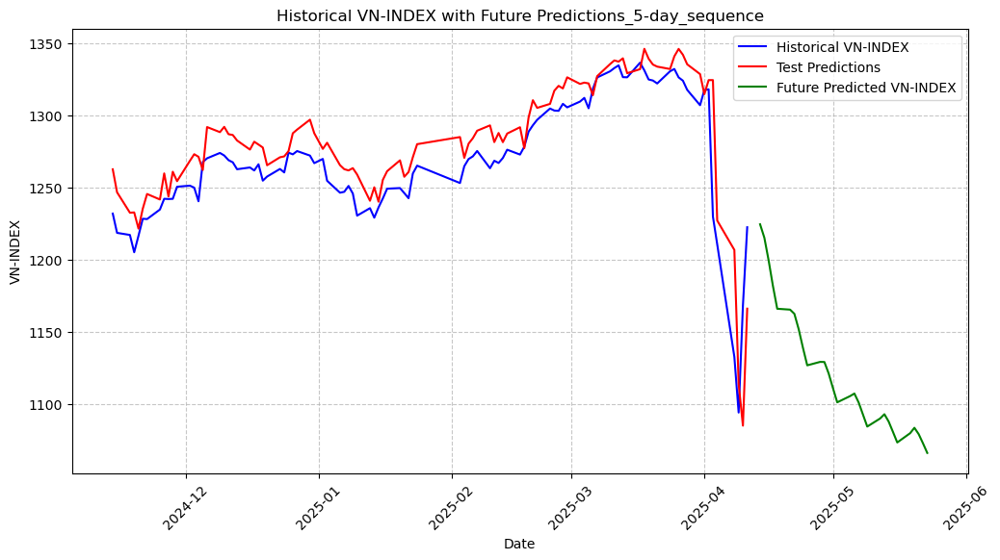

[I 2025-04-14 18:24:34,371] A new study created in memory with name: no-name-7d306fca-d925-4fd2-afa6-f476074a09ad


         Date  Predicted VN-INDEX
0  2025-04-14         1224.500300
1  2025-04-15         1215.176088
2  2025-04-16         1199.432468
3  2025-04-17         1181.803026
4  2025-04-18         1166.081449
5  2025-04-21         1165.474653
6  2025-04-22         1162.594128
7  2025-04-23         1152.024417
8  2025-04-24         1139.072303
9  2025-04-25         1126.949494
10 2025-04-28         1129.325654
11 2025-04-29         1129.263379
12 2025-04-30         1121.323783
13 2025-05-01         1111.174968
14 2025-05-02         1101.369589
15 2025-05-05         1105.685136
16 2025-05-06         1107.452189
17 2025-05-07         1101.220376
18 2025-05-08         1092.898267
19 2025-05-09         1084.605369
20 2025-05-12         1090.185606
21 2025-05-13         1093.145594
22 2025-05-14         1088.028796
23 2025-05-15         1080.902552
24 2025-05-16         1073.600503
25 2025-05-19         1080.008967
26 2025-05-20         1083.749936
27 2025-05-21         1079.363712
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.269642215235226 and num_layers=1
  warnings.warn(
[I 2025-04-14 18:25:01,545] Trial 0 finished with value: 0.0011744971589405396 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.269642215235226, 'learning_rate': 0.0007975193771420135, 'batch_size': 128}. Best is trial 0 with value: 0.0011744971589405396.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2296040522594579 and num_layers=1
  warnings.warn(
[I 2025-04-14 18:25:37,282] Trial 1 finished with value: 0.0006756863904809052 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.2296040522594579, 'learning_rate'

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.13062997718400773, 'learning_rate': 0.0006621655650044617, 'batch_size': 32}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0002
RMSE: 19.0669, MAE: 14.4269, R²: 0.9140, Directional Accuracy: 0.5327


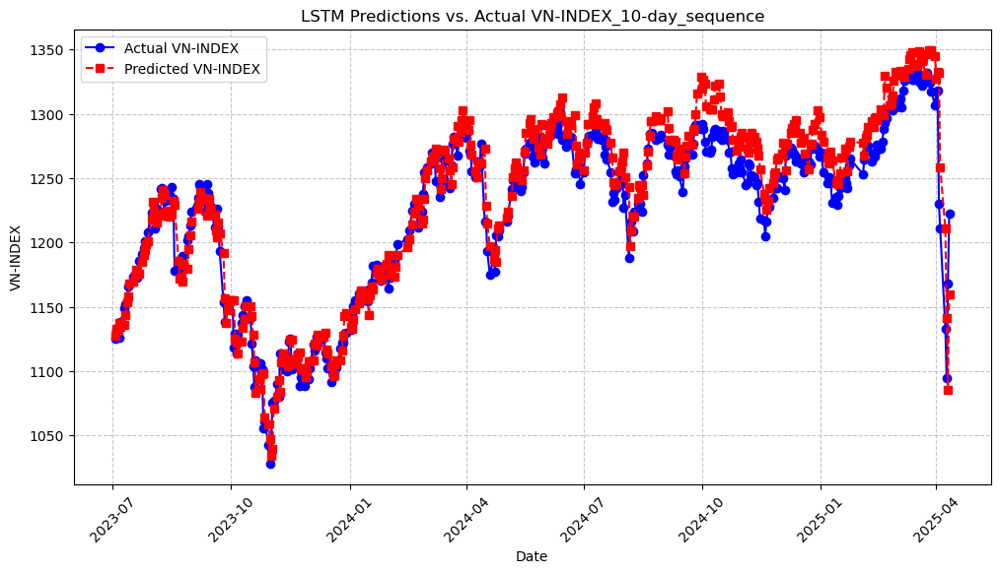

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-03      1125.499982         1127.849706
1   2023-07-04      1132.000009         1132.705843
2   2023-07-05      1134.620028         1131.980433
3   2023-07-06      1126.219998         1137.177386
4   2023-07-07      1138.069969         1134.641840
..         ...              ...                 ...
439 2025-04-04      1210.670016         1258.487479
440 2025-04-08      1132.790007         1210.620535
441 2025-04-09      1094.299993         1141.460409
442 2025-04-10      1168.339995         1085.463730
443 2025-04-11      1222.460024         1159.903125

[444 rows x 3 columns]


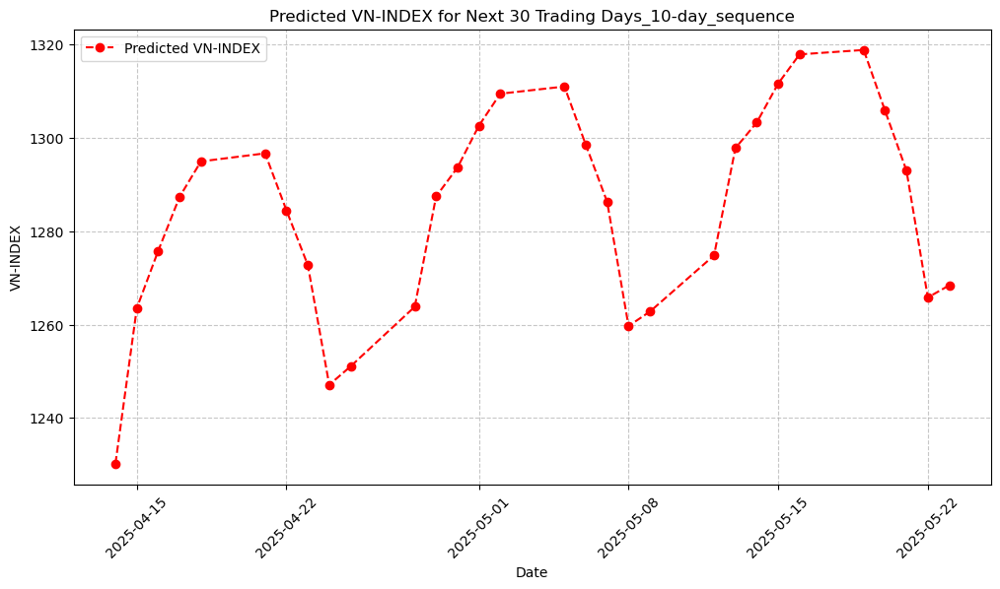

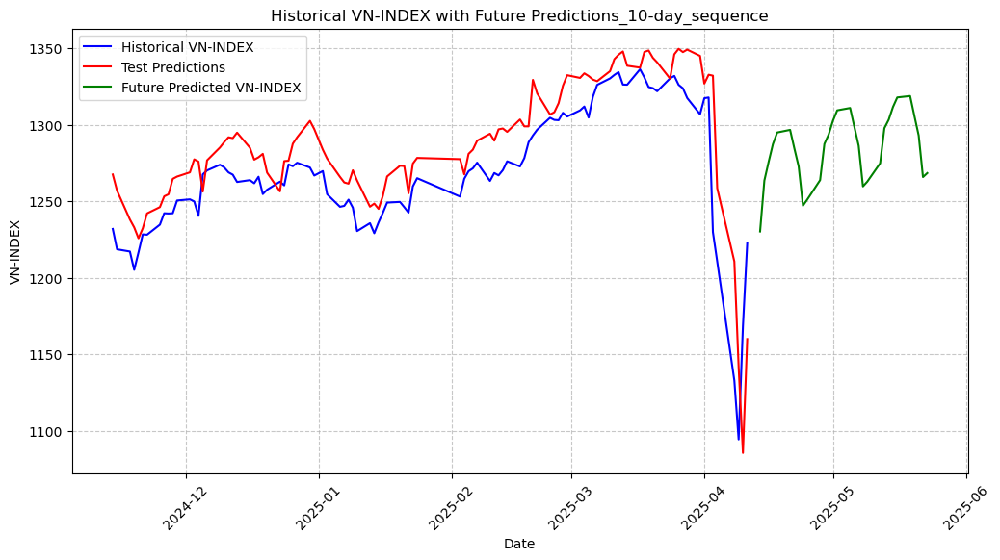

[I 2025-04-14 18:28:23,925] A new study created in memory with name: no-name-d75ba27f-bd0e-4271-b4ff-ae98d83cd3a8


         Date  Predicted VN-INDEX
0  2025-04-14         1230.223739
1  2025-04-15         1263.513254
2  2025-04-16         1275.769784
3  2025-04-17         1287.328496
4  2025-04-18         1294.920955
5  2025-04-21         1296.648160
6  2025-04-22         1284.431400
7  2025-04-23         1272.714072
8  2025-04-24         1247.095399
9  2025-04-25         1251.048935
10 2025-04-28         1263.807133
11 2025-04-29         1287.433469
12 2025-04-30         1293.608865
13 2025-05-01         1302.558810
14 2025-05-02         1309.413064
15 2025-05-05         1310.950824
16 2025-05-06         1298.503461
17 2025-05-07         1286.260033
18 2025-05-08         1259.687351
19 2025-05-09         1262.770348
20 2025-05-12         1274.797200
21 2025-05-13         1297.766412
22 2025-05-14         1303.266340
23 2025-05-15         1311.587832
24 2025-05-16         1317.834212
25 2025-05-19         1318.779743
26 2025-05-20         1305.755181
27 2025-05-21         1292.967232
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.47601210130234656 and num_layers=1
  warnings.warn(
[I 2025-04-14 18:28:50,487] Trial 0 finished with value: 0.0010499177306996898 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.47601210130234656, 'learning_rate': 0.00022919492257310626, 'batch_size': 32}. Best is trial 0 with value: 0.0010499177306996898.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.14301600397845235 and num_layers=1
  warnings.warn(
[I 2025-04-14 18:29:54,685] Trial 1 finished with value: 0.0007563311889941815 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.14301600397845235, 'learning_

Best Hyperparameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.2352811347931083, 'learning_rate': 0.0013539986464559995, 'batch_size': 32}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0003
RMSE: 19.6399, MAE: 15.1921, R²: 0.9074, Directional Accuracy: 0.5196


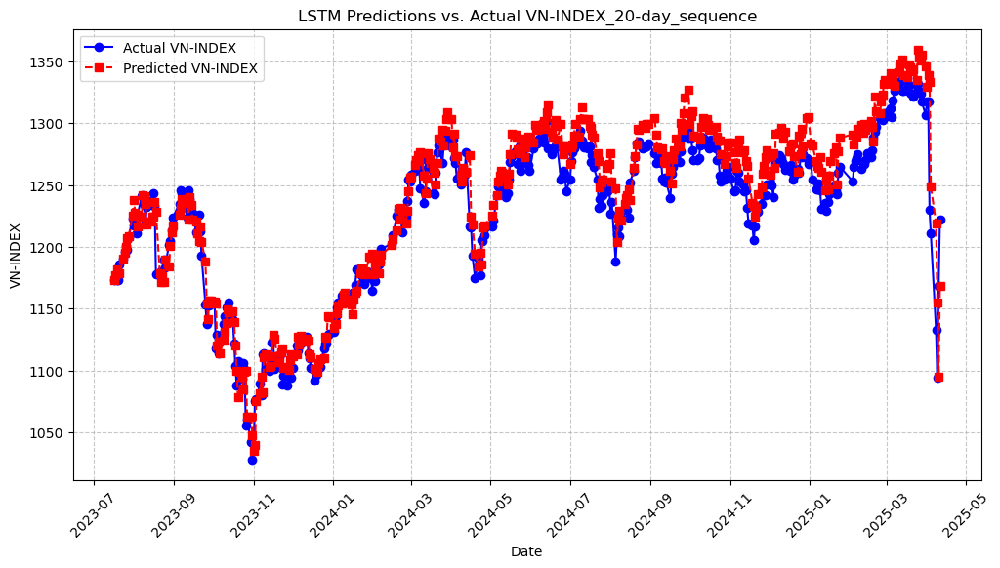

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-17      1173.130004         1172.897398
1   2023-07-18      1174.090025         1176.991668
2   2023-07-19      1172.980020         1181.626144
3   2023-07-20      1172.809997         1178.733672
4   2023-07-21      1185.899994         1179.055066
..         ...              ...                 ...
429 2025-04-04      1210.670016         1248.853049
430 2025-04-08      1132.790007         1219.317296
431 2025-04-09      1094.299993         1154.934307
432 2025-04-10      1168.339995         1095.083209
433 2025-04-11      1222.460024         1168.108853

[434 rows x 3 columns]


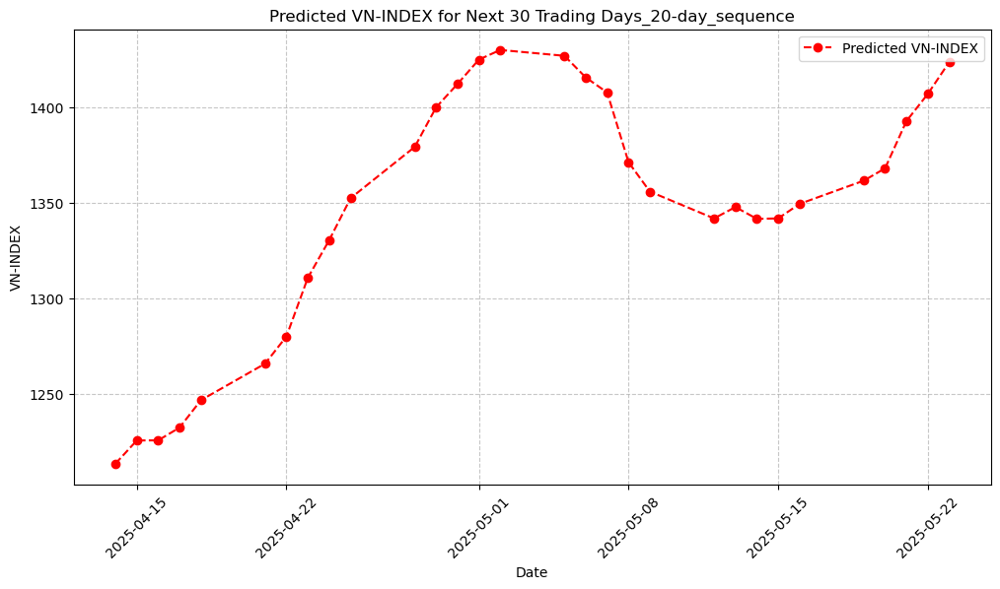

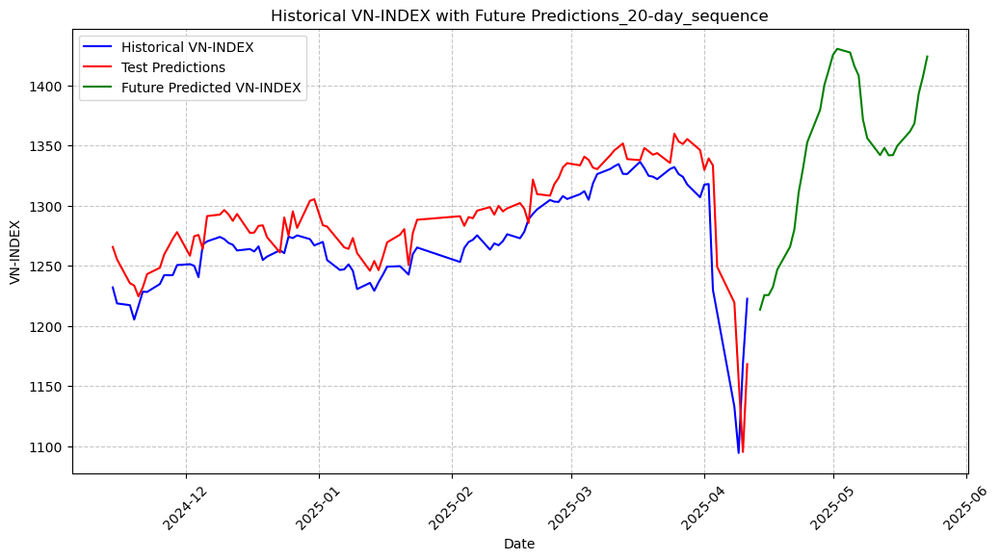

[I 2025-04-14 18:36:58,952] A new study created in memory with name: no-name-9c2cc4ac-5b0b-48c5-a038-32ab1ace6906


         Date  Predicted VN-INDEX
0  2025-04-14         1213.316086
1  2025-04-15         1225.460013
2  2025-04-16         1225.521286
3  2025-04-17         1232.227405
4  2025-04-18         1246.602595
5  2025-04-21         1265.725634
6  2025-04-22         1280.032768
7  2025-04-23         1310.785888
8  2025-04-24         1330.508169
9  2025-04-25         1352.508651
10 2025-04-28         1379.378989
11 2025-04-29         1400.148769
12 2025-04-30         1412.385646
13 2025-05-01         1425.150472
14 2025-05-02         1430.216556
15 2025-05-05         1427.152520
16 2025-05-06         1415.807532
17 2025-05-07         1407.923583
18 2025-05-08         1371.363168
19 2025-05-09         1355.947878
20 2025-05-12         1341.887301
21 2025-05-13         1347.852518
22 2025-05-14         1341.686295
23 2025-05-15         1341.888688
24 2025-05-16         1349.499028
25 2025-05-19         1361.666154
26 2025-05-20         1368.149070
27 2025-05-21         1392.944064
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.15245128707043565 and num_layers=1
  warnings.warn(
[I 2025-04-14 18:39:19,183] Trial 0 finished with value: 0.0018902008075951926 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.15245128707043565, 'learning_rate': 0.00014866211320701059, 'batch_size': 64}. Best is trial 0 with value: 0.0018902008075951926.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2980491667606734 and num_layers=1
  warnings.warn(
[I 2025-04-14 18:42:02,069] Trial 1 finished with value: 0.0009422606178566184 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.2980491667606734, 'learning_r

Best Hyperparameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.4025029520219103, 'learning_rate': 0.007060433700315614, 'batch_size': 32}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0005
RMSE: 29.5634, MAE: 26.6668, R²: 0.7979, Directional Accuracy: 0.5085


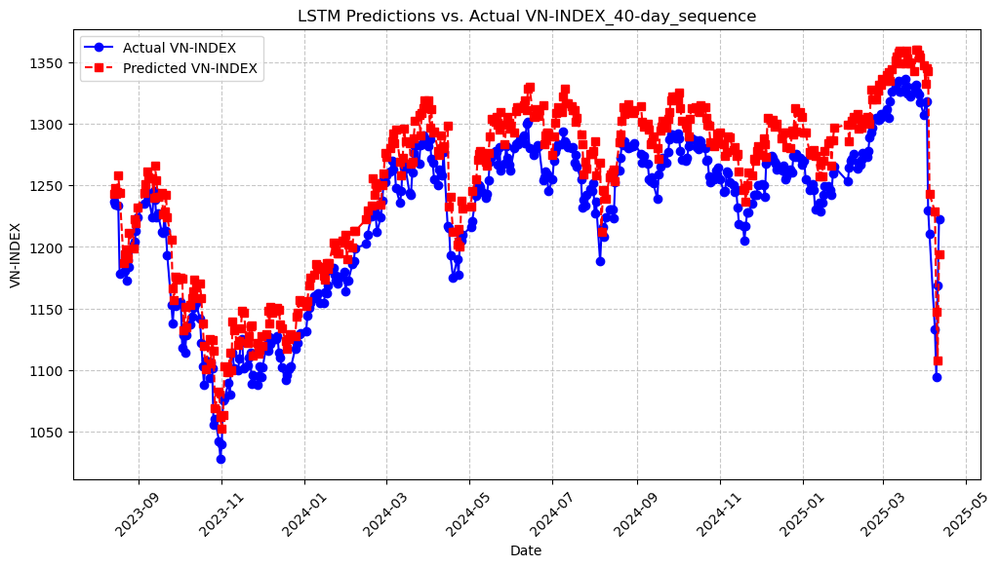

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-08-14      1236.839992         1243.347495
1   2023-08-15      1234.050027         1247.965091
2   2023-08-16      1243.260017         1244.736118
3   2023-08-17      1233.479995         1258.317610
4   2023-08-18      1177.989995         1243.561141
..         ...              ...                 ...
409 2025-04-04      1210.670016         1243.053230
410 2025-04-08      1132.790007         1228.486206
411 2025-04-09      1094.299993         1147.311635
412 2025-04-10      1168.339995         1107.501284
413 2025-04-11      1222.460024         1193.934544

[414 rows x 3 columns]


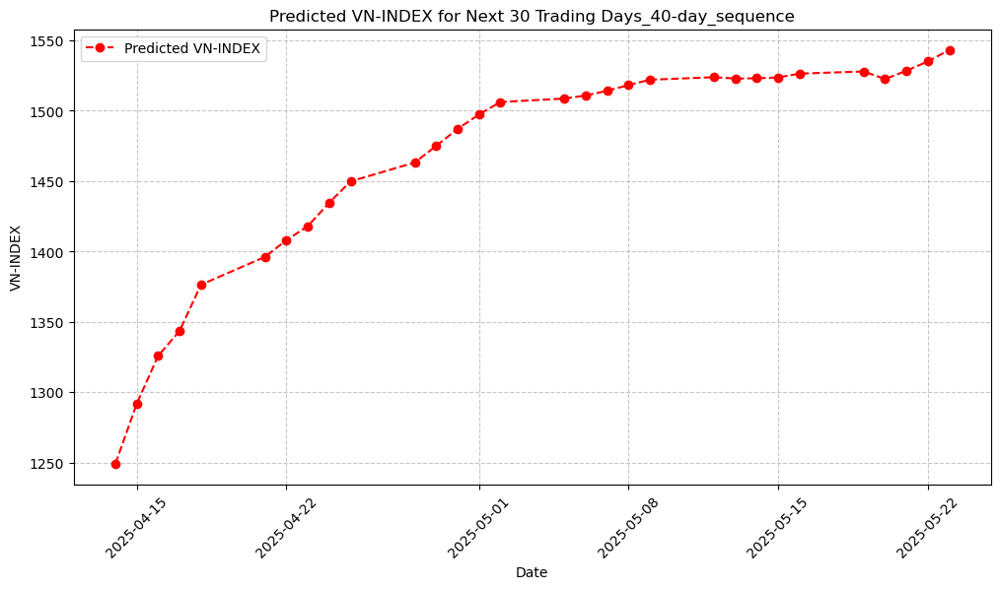

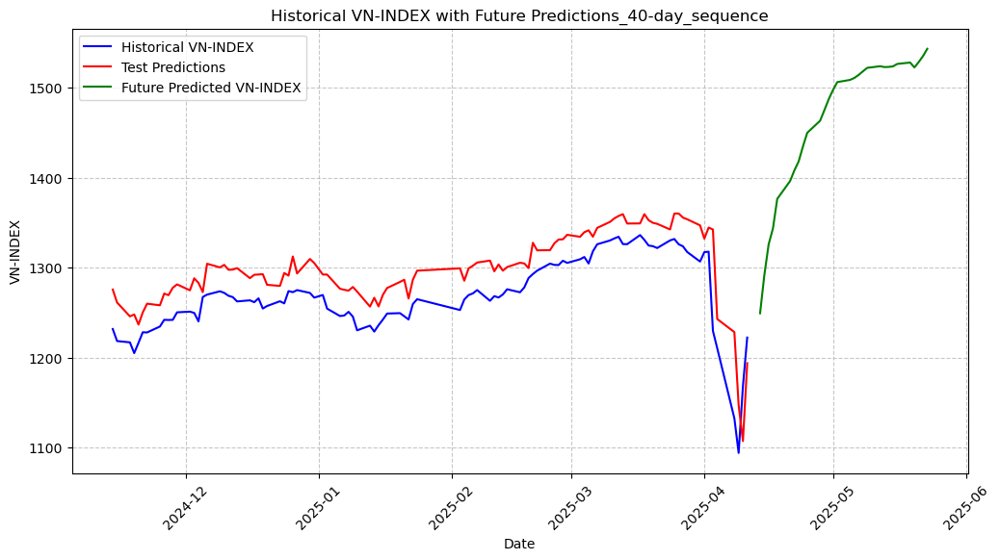

[I 2025-04-14 18:56:41,669] A new study created in memory with name: no-name-5f458834-aa59-4c5c-8866-e70abfda7cb8


         Date  Predicted VN-INDEX
0  2025-04-14         1249.410132
1  2025-04-15         1292.037424
2  2025-04-16         1326.058207
3  2025-04-17         1343.562251
4  2025-04-18         1376.445591
5  2025-04-21         1396.265832
6  2025-04-22         1408.114030
7  2025-04-23         1418.084884
8  2025-04-24         1434.701510
9  2025-04-25         1449.850204
10 2025-04-28         1463.234697
11 2025-04-29         1474.986245
12 2025-04-30         1487.069361
13 2025-05-01         1497.292706
14 2025-05-02         1506.161109
15 2025-05-05         1508.635460
16 2025-05-06         1510.826953
17 2025-05-07         1514.158972
18 2025-05-08         1518.201912
19 2025-05-09         1522.011012
20 2025-05-12         1523.798643
21 2025-05-13         1522.862206
22 2025-05-14         1523.032384
23 2025-05-15         1523.640875
24 2025-05-16         1526.353304
25 2025-05-19         1527.891527
26 2025-05-20         1522.476225
27 2025-05-21         1528.408995
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.24765261137936023 and num_layers=1
  warnings.warn(
[I 2025-04-14 18:57:40,799] Trial 0 finished with value: 0.0015159661109532862 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.24765261137936023, 'learning_rate': 0.0005102320564980249, 'batch_size': 64}. Best is trial 0 with value: 0.0015159661109532862.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4564139813842043 and num_layers=1
  warnings.warn(
[I 2025-04-14 18:58:55,314] Trial 1 finished with value: 0.0004158030601035989 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.4564139813842043, 'learning_rate

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.23233123286359497, 'learning_rate': 0.006270284693129593, 'batch_size': 32}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0009
RMSE: 37.4926, MAE: 34.7042, R²: 0.6877, Directional Accuracy: 0.5064


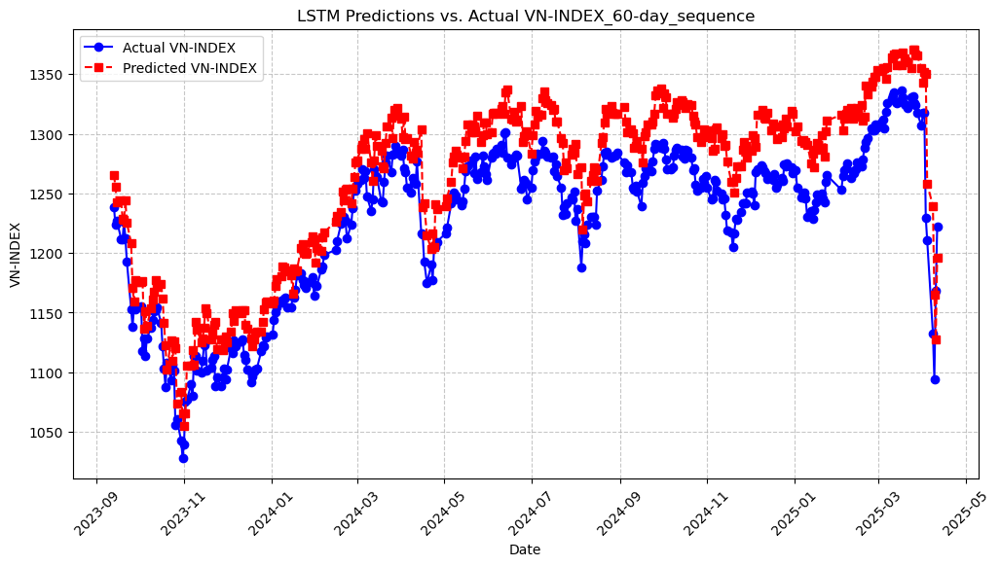

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-13      1238.390007         1265.618194
1   2023-09-14      1223.810034         1255.394309
2   2023-09-15      1227.360016         1242.898853
3   2023-09-18      1211.810003         1244.296032
4   2023-09-19      1211.500015         1228.992498
..         ...              ...                 ...
389 2025-04-04      1210.670016         1258.140574
390 2025-04-08      1132.790007         1239.382090
391 2025-04-09      1094.299993         1164.760803
392 2025-04-10      1168.339995         1127.755292
393 2025-04-11      1222.460024         1195.920098

[394 rows x 3 columns]


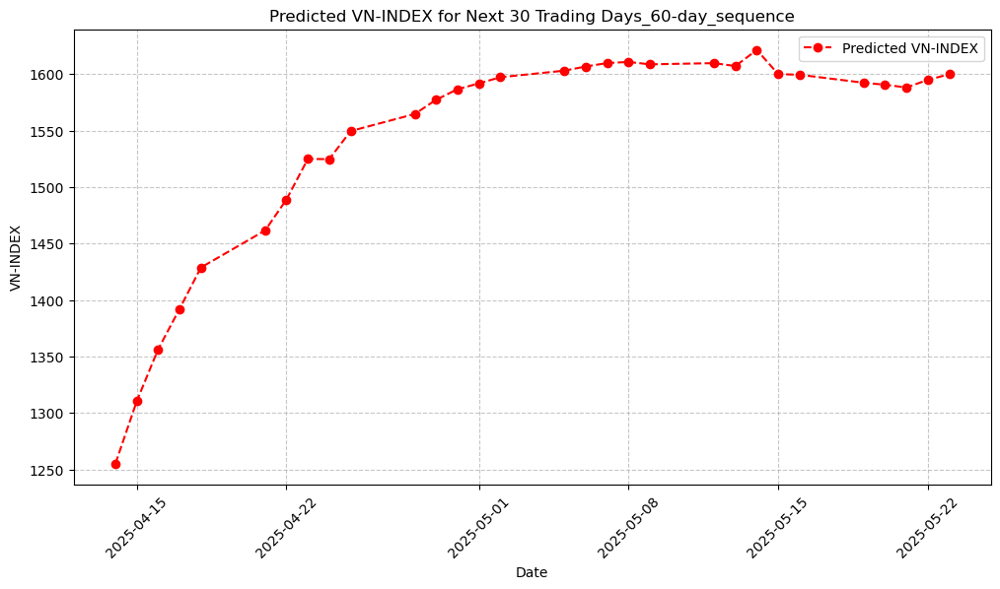

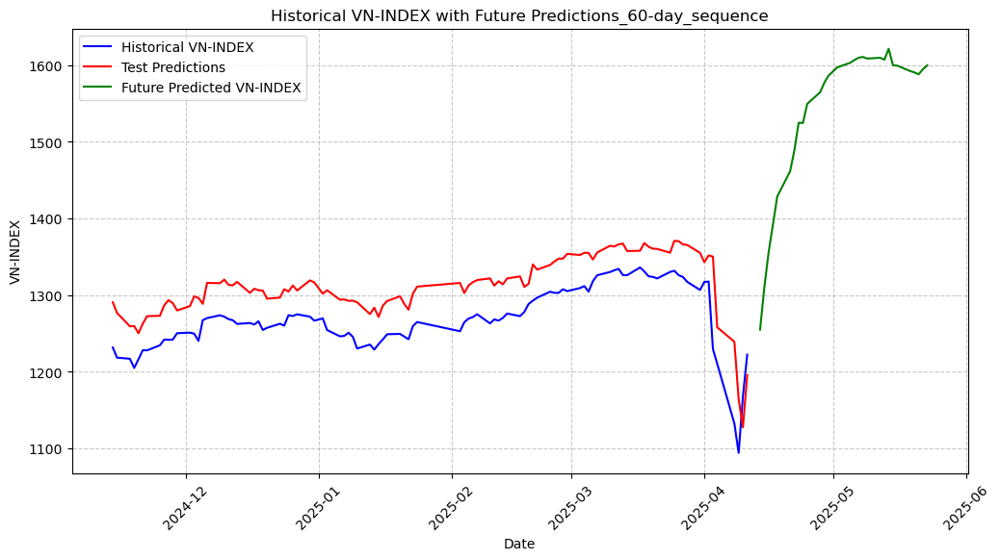

         Date  Predicted VN-INDEX
0  2025-04-14         1255.103051
1  2025-04-15         1310.552588
2  2025-04-16         1356.446386
3  2025-04-17         1392.128401
4  2025-04-18         1428.787931
5  2025-04-21         1461.550344
6  2025-04-22         1488.950019
7  2025-04-23         1524.927993
8  2025-04-24         1524.679896
9  2025-04-25         1549.554814
10 2025-04-28         1564.681619
11 2025-04-29         1577.313418
12 2025-04-30         1586.662832
13 2025-05-01         1591.793735
14 2025-05-02         1597.232775
15 2025-05-05         1603.081226
16 2025-05-06         1606.765006
17 2025-05-07         1609.792741
18 2025-05-08         1610.775576
19 2025-05-09         1608.668092
20 2025-05-12         1609.727383
21 2025-05-13         1607.154996
22 2025-05-14         1621.399624
23 2025-05-15         1600.042855
24 2025-05-16         1599.433825
25 2025-05-19         1592.378256
26 2025-05-20         1590.588930
27 2025-05-21         1588.179012
28 2025-05-22 

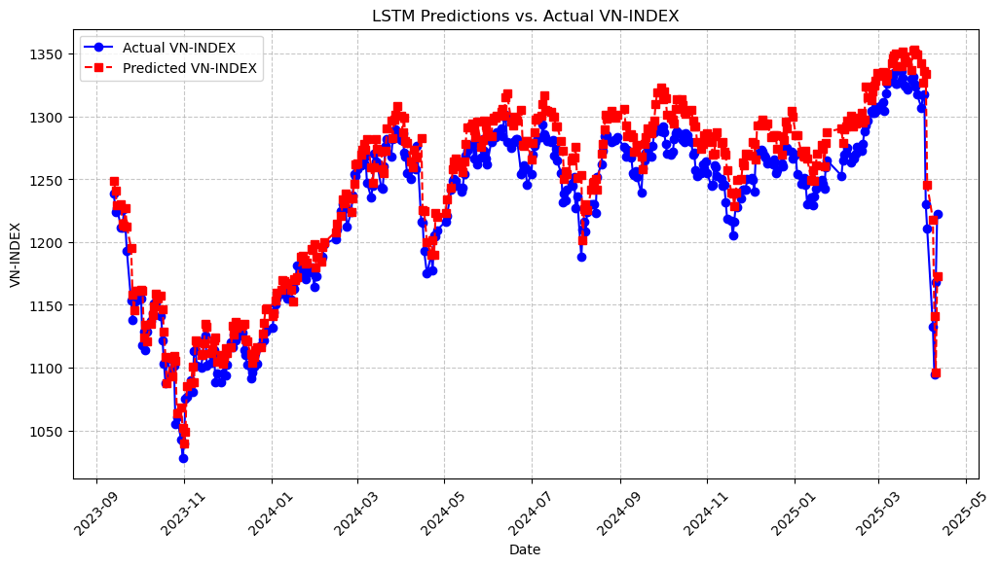

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-13      1238.390007         1248.473455
1   2023-09-14      1223.810034         1240.757878
2   2023-09-15      1227.360016         1229.445022
3   2023-09-18      1211.810003         1230.103303
4   2023-09-19      1211.500015         1214.449521
..         ...              ...                 ...
389 2025-04-04      1210.670016         1245.724660
390 2025-04-08      1132.790007         1217.822238
391 2025-04-09      1094.299993         1141.195000
392 2025-04-10      1168.339995         1096.083213
393 2025-04-11      1222.460024         1172.957578

[394 rows x 3 columns]


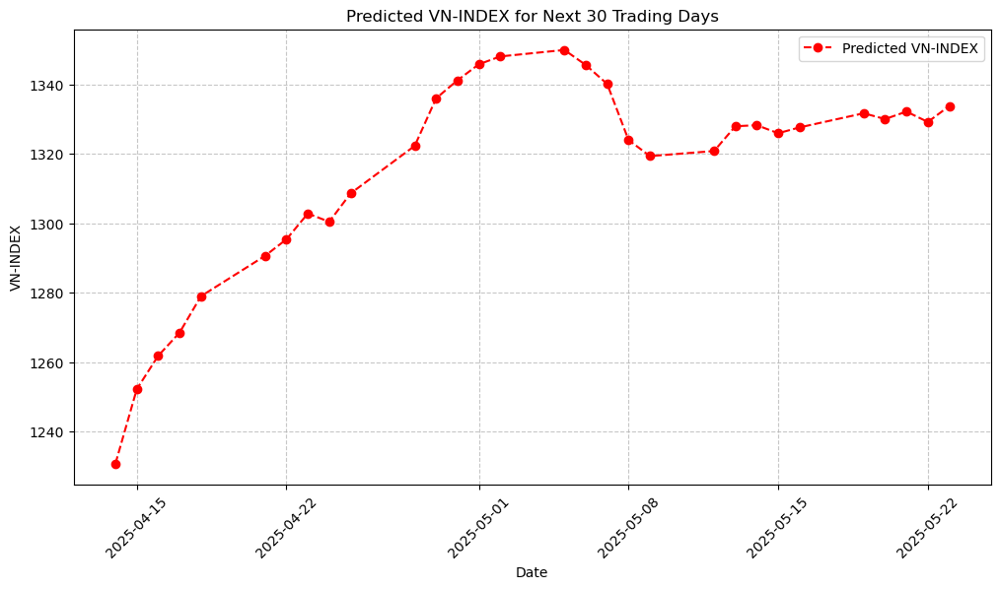

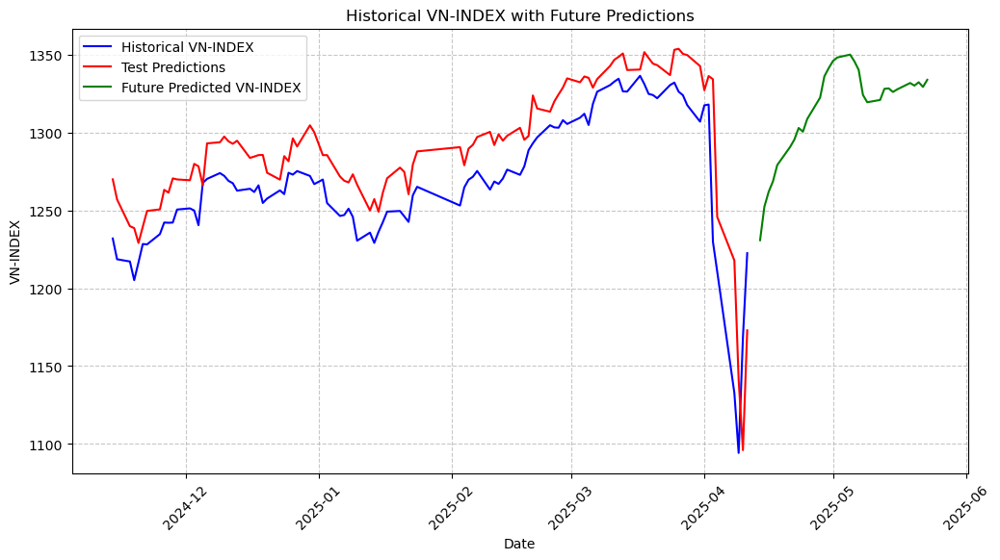


Ensemble Future Predictions (weighted average) for next 30 days:
         Date  Predicted Future VN-INDEX
0  2025-04-14                1230.780099
1  2025-04-15                1252.246063
2  2025-04-16                1261.813266
3  2025-04-17                1268.498996
4  2025-04-18                1278.973214
5  2025-04-21                1290.604648
6  2025-04-22                1295.367781
7  2025-04-23                1302.785713
8  2025-04-24                1300.401501
9  2025-04-25                1308.569977
10 2025-04-28                1322.263095
11 2025-04-29                1335.945402
12 2025-04-30                1341.139100
13 2025-05-01                1345.745930
14 2025-05-02                1348.003590
15 2025-05-05                1349.865928
16 2025-05-06                1345.542515
17 2025-05-07                1340.083783
18 2025-05-08                1323.949759
19 2025-05-09                1319.309921
20 2025-05-12                1320.773897
21 2025-05-13                132

In [12]:
data = df_2

ensemble_lstm_model(data)

[I 2025-04-14 19:13:35,148] A new study created in memory with name: no-name-9a606829-ea1d-4711-b9fa-60cb612b79b7



Training LSTM with sequence length = 5


/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1625805111320242 and num_layers=1
  warnings.warn(
[I 2025-04-14 19:13:54,429] Trial 0 finished with value: 0.0007357570425551785 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.1625805111320242, 'learning_rate': 0.00018617215991554052, 'batch_size': 64}. Best is trial 0 with value: 0.0007357570425551785.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.22549223782953504 and num_layers=1
  warnings.warn(
[I 2025-04-14 19:14:03,509] Trial 1 finished with value: 0.0006958724264507054 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.22549223782953504, 'learning_r

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.2064342642149978, 'learning_rate': 0.0014559918163498354, 'batch_size': 32}
Best Overall Average Training Loss: 0.0002
Final Evaluation Loss on Test Set: 0.0002
RMSE: 19.0591, MAE: 15.1447, R²: 0.9148, Directional Accuracy: 0.5045


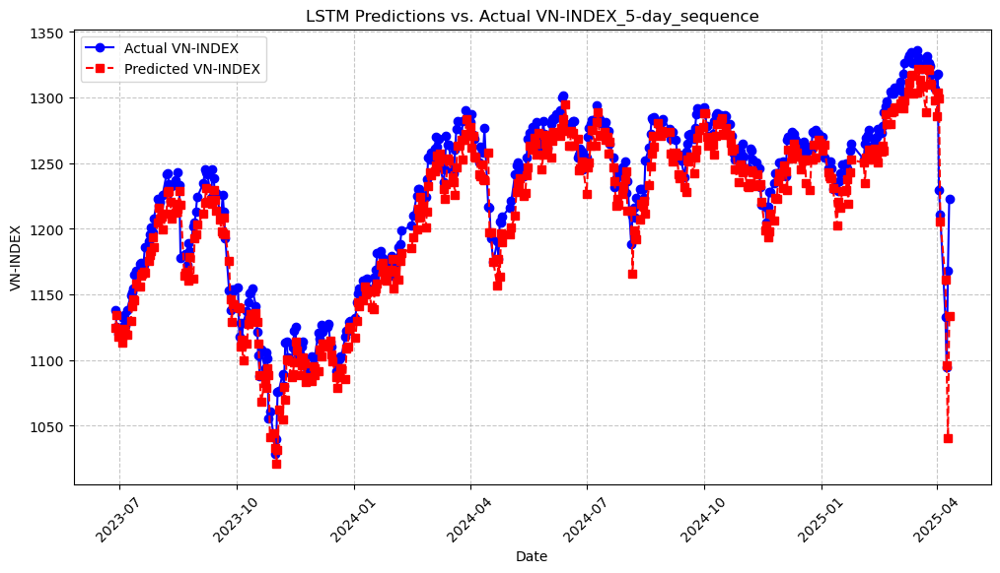

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-06-28      1138.349975         1124.315602
1   2023-06-29      1125.389999         1134.634749
2   2023-06-30      1120.180020         1117.579193
3   2023-07-03      1125.499982         1113.017782
4   2023-07-04      1132.000009         1119.347092
..         ...              ...                 ...
442 2025-04-04      1210.670016         1205.924479
443 2025-04-08      1132.790007         1161.537149
444 2025-04-09      1094.299993         1096.198378
445 2025-04-10      1168.339995         1040.510222
446 2025-04-11      1222.460024         1133.615305

[447 rows x 3 columns]


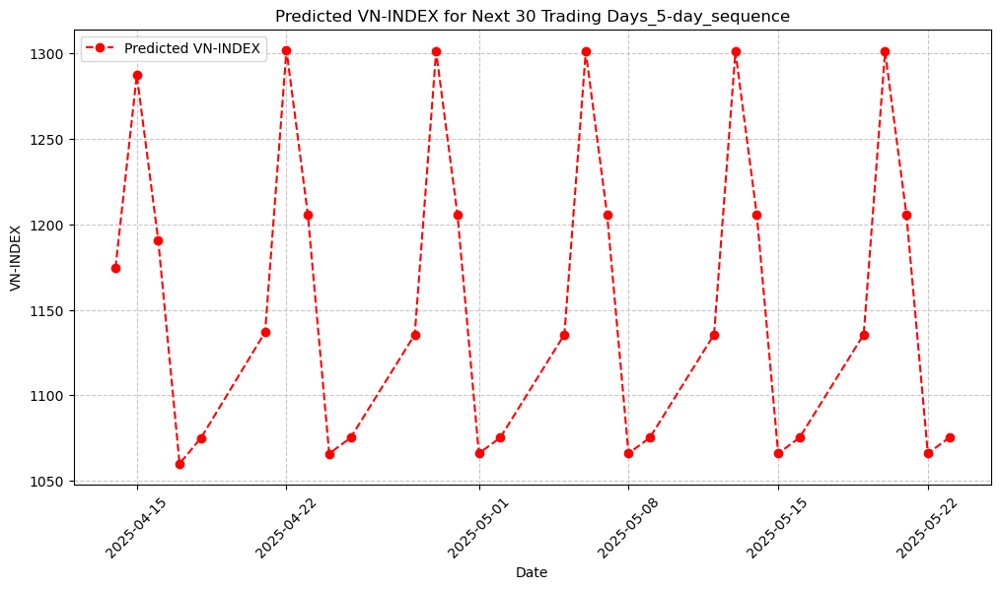

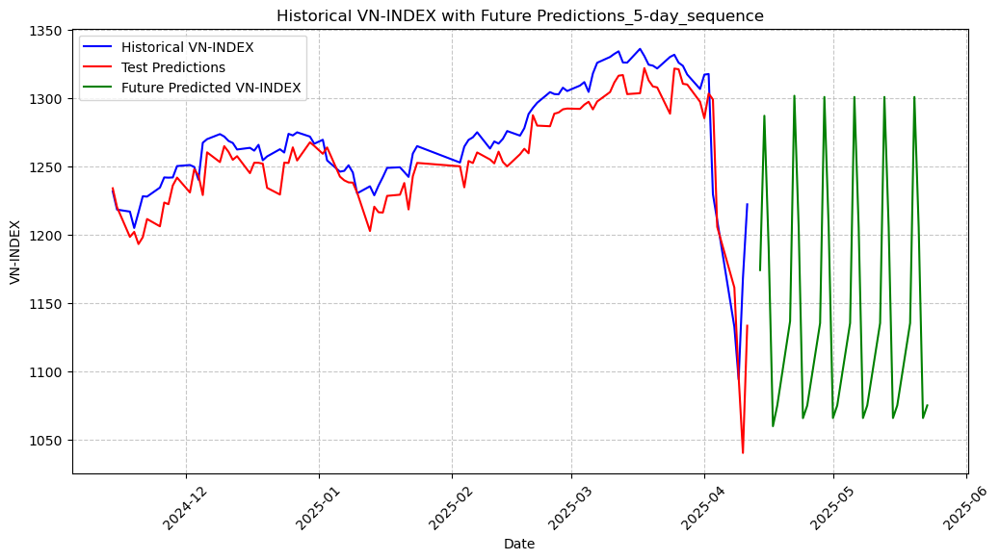

[I 2025-04-14 19:15:50,654] A new study created in memory with name: no-name-5f6378d5-ad0f-49bf-81be-6cc94d5c1738


         Date  Predicted VN-INDEX
0  2025-04-14         1174.329953
1  2025-04-15         1287.264217
2  2025-04-16         1190.819871
3  2025-04-17         1060.076816
4  2025-04-18         1075.063040
5  2025-04-21         1136.890367
6  2025-04-22         1301.894518
7  2025-04-23         1205.716305
8  2025-04-24         1065.948390
9  2025-04-25         1075.185124
10 2025-04-28         1135.499508
11 2025-04-29         1301.032611
12 2025-04-30         1205.522235
13 2025-05-01         1066.042496
14 2025-05-02         1075.286706
15 2025-05-05         1135.538892
16 2025-05-06         1301.030992
17 2025-05-07         1205.512447
18 2025-05-08         1066.036870
19 2025-05-09         1075.285627
20 2025-05-12         1135.539586
21 2025-05-13         1301.031686
22 2025-05-14         1205.512601
23 2025-05-15         1066.036793
24 2025-05-16         1075.285473
25 2025-05-19         1135.539586
26 2025-05-20         1301.031763
27 2025-05-21         1205.512678
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2668749124433305 and num_layers=1
  warnings.warn(
[I 2025-04-14 19:16:17,147] Trial 0 finished with value: 0.0005664502860599896 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.2668749124433305, 'learning_rate': 0.0021441170300793132, 'batch_size': 128}. Best is trial 0 with value: 0.0005664502860599896.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.10951181961131536 and num_layers=1
  warnings.warn(
[I 2025-04-14 19:16:32,723] Trial 1 finished with value: 0.0004549585847840021 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.10951181961131536, 'learning_ra

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.41615266947036544, 'learning_rate': 0.000383310371124921, 'batch_size': 32}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0002
RMSE: 15.5025, MAE: 11.6562, R²: 0.9428, Directional Accuracy: 0.5624


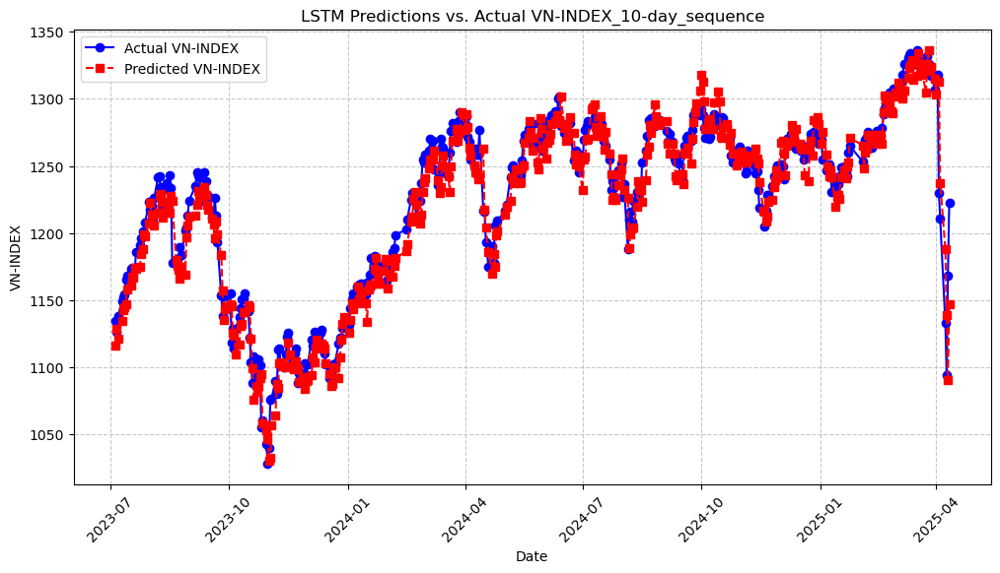

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-05      1134.620028         1116.176696
1   2023-07-06      1126.219998         1128.526022
2   2023-07-07      1138.069969         1120.910055
3   2023-07-10      1149.020035         1134.478137
4   2023-07-11      1151.769999         1142.360390
..         ...              ...                 ...
437 2025-04-04      1210.670016         1237.183892
438 2025-04-08      1132.790007         1188.114918
439 2025-04-09      1094.299993         1139.022745
440 2025-04-10      1168.339995         1090.324569
441 2025-04-11      1222.460024         1146.949315

[442 rows x 3 columns]


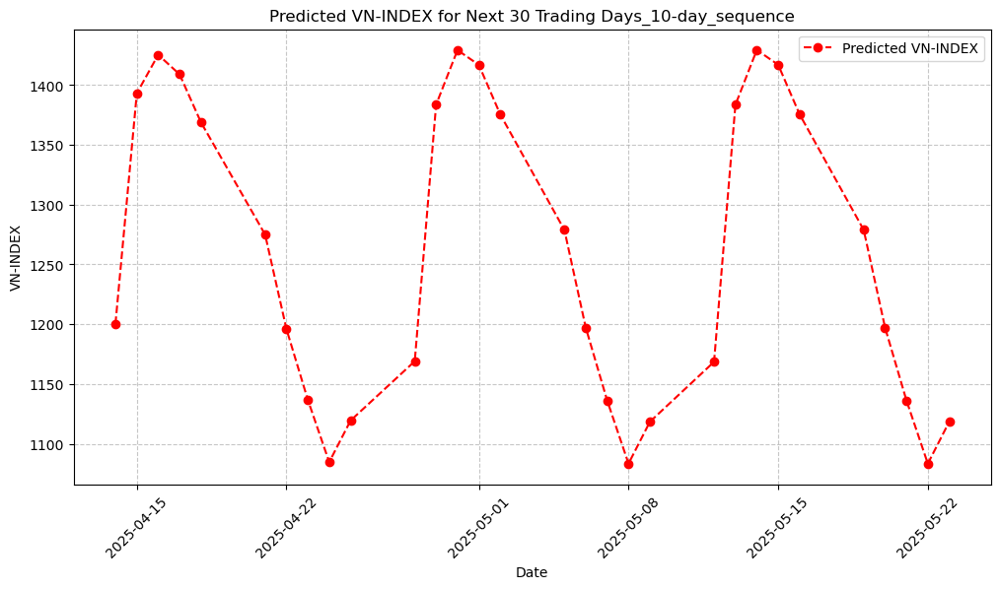

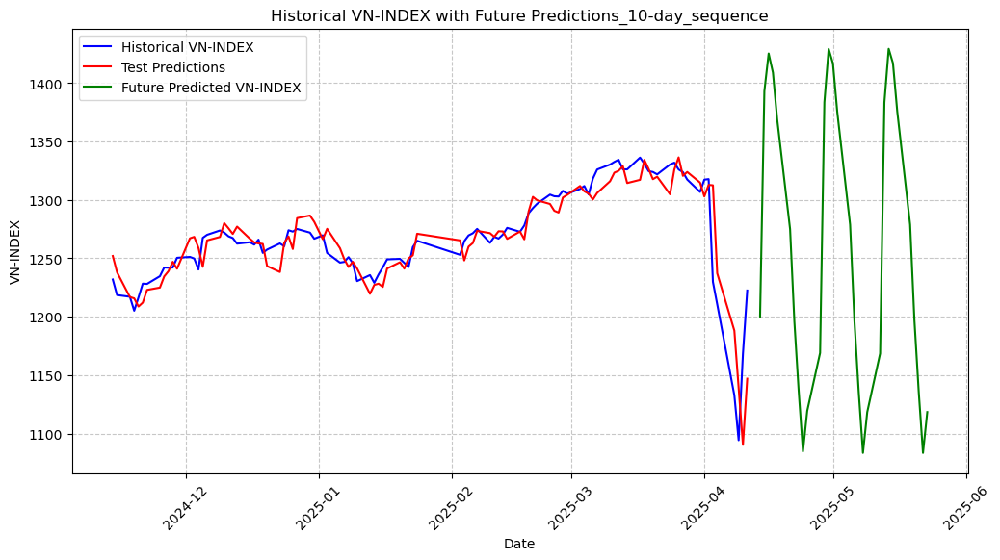

[I 2025-04-14 19:20:04,682] A new study created in memory with name: no-name-f4e8ca30-44c3-4e96-99f7-3b81cb37cd83


         Date  Predicted VN-INDEX
0  2025-04-14         1200.226705
1  2025-04-15         1393.111235
2  2025-04-16         1425.358492
3  2025-04-17         1409.007152
4  2025-04-18         1368.887352
5  2025-04-21         1275.066108
6  2025-04-22         1195.922564
7  2025-04-23         1136.738225
8  2025-04-24         1084.686449
9  2025-04-25         1119.474109
10 2025-04-28         1169.031263
11 2025-04-29         1383.632338
12 2025-04-30         1429.287596
13 2025-05-01         1416.865281
14 2025-05-02         1375.489424
15 2025-05-05         1278.845150
16 2025-05-06         1197.145404
17 2025-05-07         1136.262916
18 2025-05-08         1083.423763
19 2025-05-09         1118.425223
20 2025-05-12         1168.529826
21 2025-05-13         1383.531064
22 2025-05-14         1429.390873
23 2025-05-15         1417.012414
24 2025-05-16         1375.598713
25 2025-05-19         1278.900720
26 2025-05-20         1197.157967
27 2025-05-21         1136.250584
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4432232168352153 and num_layers=1
  warnings.warn(
[I 2025-04-14 19:20:23,014] Trial 0 finished with value: 0.0008850953216824564 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.4432232168352153, 'learning_rate': 0.00016401693811820878, 'batch_size': 64}. Best is trial 0 with value: 0.0008850953216824564.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4039965623005442 and num_layers=1
  warnings.warn(
[I 2025-04-14 19:21:16,532] Trial 1 finished with value: 0.0017865018791985677 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.4039965623005442, 'learning_rate

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.25749369183214676, 'learning_rate': 0.001237031864944779, 'batch_size': 32}
Best Overall Average Training Loss: 0.0002
Final Evaluation Loss on Test Set: 0.0005
RMSE: 27.2029, MAE: 23.7451, R²: 0.8227, Directional Accuracy: 0.5128


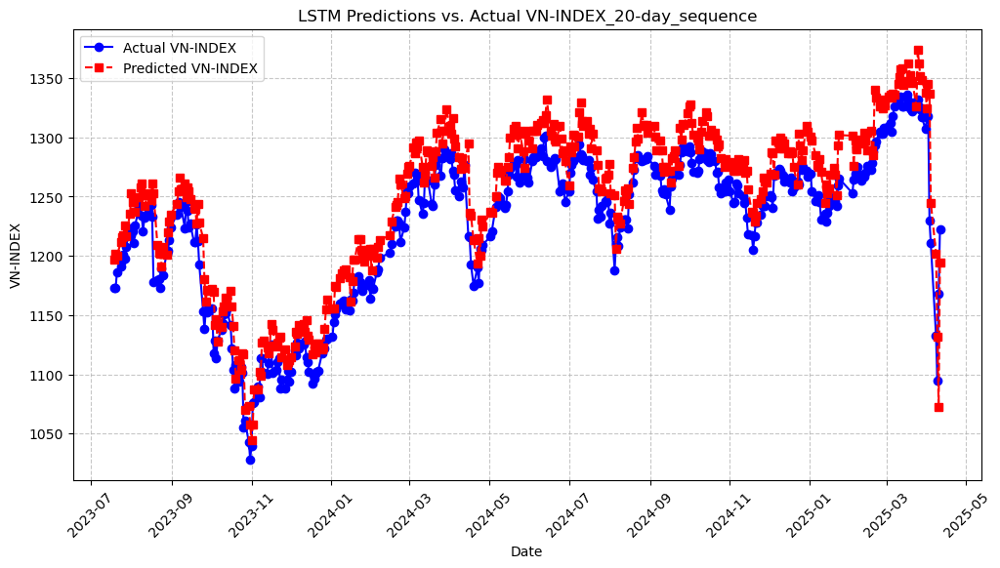

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-19      1172.980020         1197.154653
1   2023-07-20      1172.809997         1201.392125
2   2023-07-21      1185.899994         1200.080806
3   2023-07-24      1190.719984         1211.520902
4   2023-07-25      1195.899982         1215.520527
..         ...              ...                 ...
427 2025-04-04      1210.670016         1244.965179
428 2025-04-08      1132.790007         1202.092410
429 2025-04-09      1094.299993         1132.064211
430 2025-04-10      1168.339995         1072.704299
431 2025-04-11      1222.460024         1194.305650

[432 rows x 3 columns]


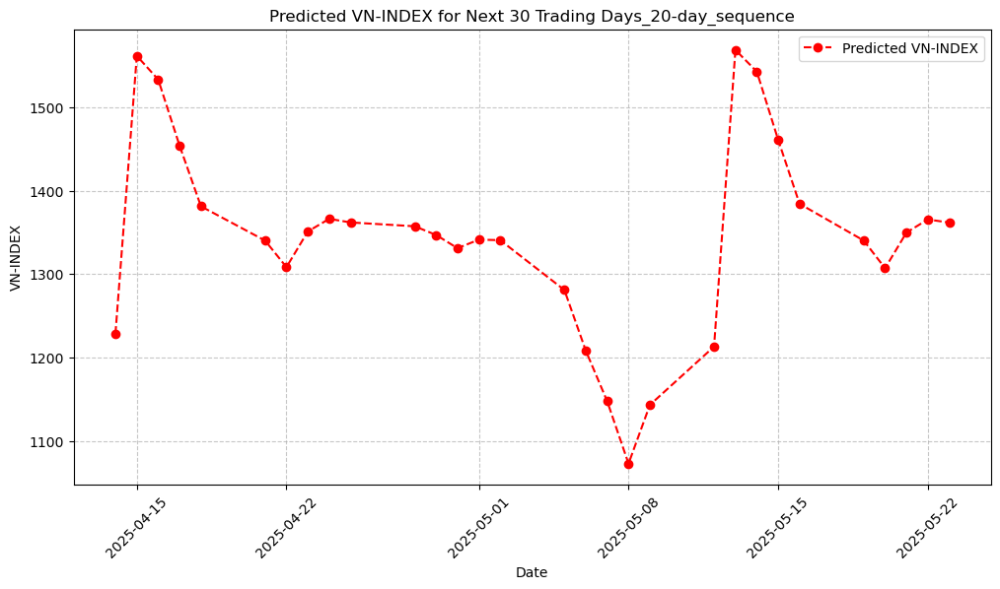

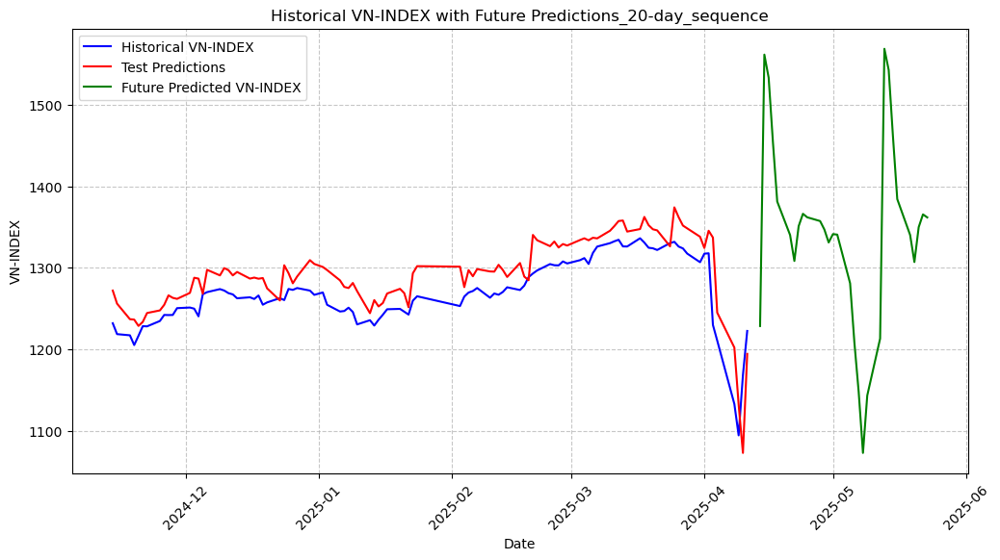

[I 2025-04-14 19:27:18,011] A new study created in memory with name: no-name-defa2569-73be-4b08-83ab-7137bab7c534


         Date  Predicted VN-INDEX
0  2025-04-14         1228.512796
1  2025-04-15         1561.745293
2  2025-04-16         1533.446870
3  2025-04-17         1454.093071
4  2025-04-18         1381.340111
5  2025-04-21         1340.239018
6  2025-04-22         1308.392310
7  2025-04-23         1351.167042
8  2025-04-24         1366.316121
9  2025-04-25         1362.000574
10 2025-04-28         1357.404018
11 2025-04-29         1346.982133
12 2025-04-30         1331.121439
13 2025-05-01         1341.372762
14 2025-05-02         1340.740995
15 2025-05-05         1280.958260
16 2025-05-06         1208.269270
17 2025-05-07         1147.662086
18 2025-05-08         1072.702218
19 2025-05-09         1143.161718
20 2025-05-12         1213.062362
21 2025-05-13         1568.876855
22 2025-05-14         1542.905728
23 2025-05-15         1460.981700
24 2025-05-16         1384.340022
25 2025-05-19         1340.316631
26 2025-05-20         1307.088312
27 2025-05-21         1349.885780
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3259970301590963 and num_layers=1
  warnings.warn(
[I 2025-04-14 19:30:25,298] Trial 0 finished with value: 0.00019858627231145398 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.3259970301590963, 'learning_rate': 0.001733244511627927, 'batch_size': 32}. Best is trial 0 with value: 0.00019858627231145398.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3726335828270255 and num_layers=1
  warnings.warn(
[I 2025-04-14 19:31:36,754] Trial 1 finished with value: 0.0002511002478360069 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.3726335828270255, 'learning_rat

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.3259970301590963, 'learning_rate': 0.001733244511627927, 'batch_size': 32}
Best Overall Average Training Loss: 0.0002
Final Evaluation Loss on Test Set: 0.0009
RMSE: 38.5162, MAE: 36.0450, R²: 0.6585, Directional Accuracy: 0.5134


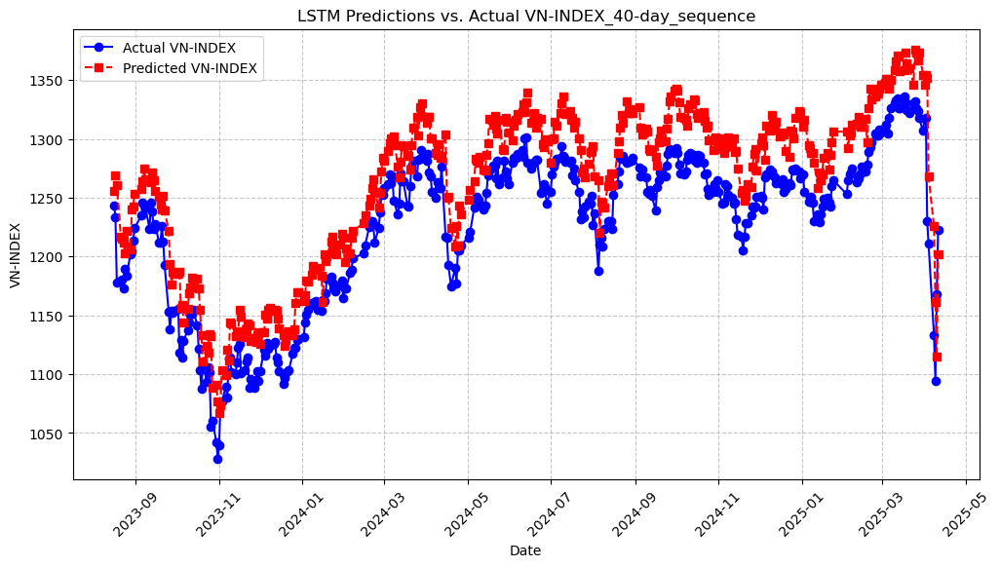

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-08-16      1243.260017         1255.986769
1   2023-08-17      1233.479995         1269.121392
2   2023-08-18      1177.989995         1260.540703
3   2023-08-21      1179.759976         1216.473457
4   2023-08-22      1180.490011         1215.010766
..         ...              ...                 ...
407 2025-04-04      1210.670016         1268.079982
408 2025-04-08      1132.790007         1225.725914
409 2025-04-09      1094.299993         1161.537457
410 2025-04-10      1168.339995         1115.052355
411 2025-04-11      1222.460024         1202.011176

[412 rows x 3 columns]


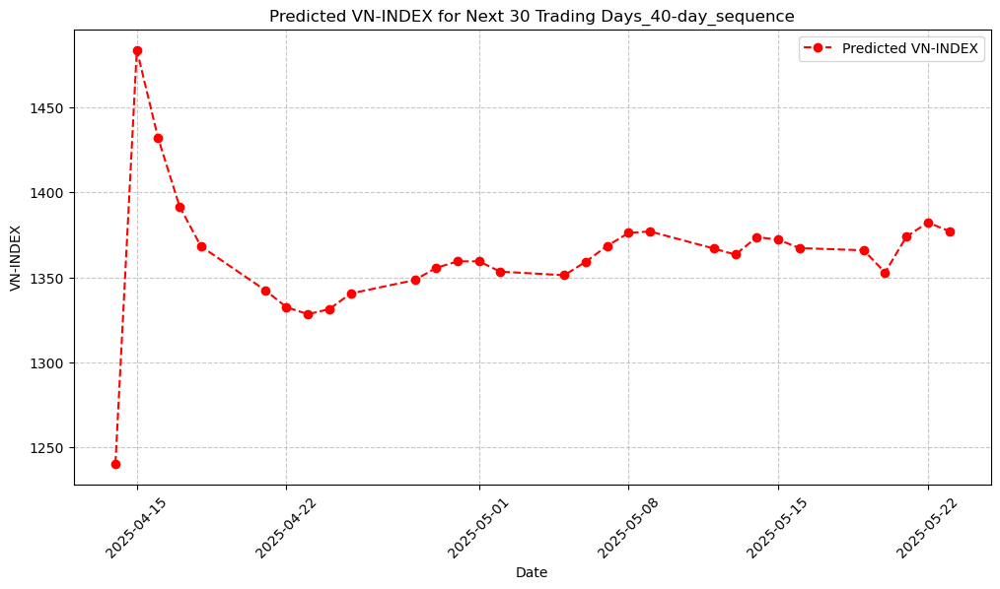

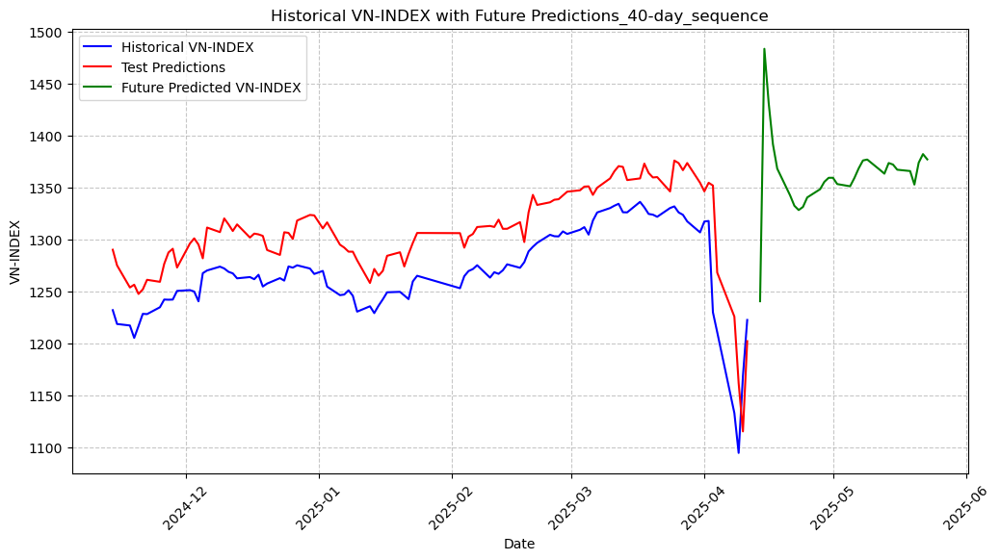

[I 2025-04-14 19:38:15,157] A new study created in memory with name: no-name-dd27abc6-1411-4105-8f8e-7660b08f9007


         Date  Predicted VN-INDEX
0  2025-04-14         1240.491555
1  2025-04-15         1483.777497
2  2025-04-16         1431.787303
3  2025-04-17         1391.734327
4  2025-04-18         1368.303833
5  2025-04-21         1342.536332
6  2025-04-22         1332.524013
7  2025-04-23         1328.377795
8  2025-04-24         1331.329767
9  2025-04-25         1340.528813
10 2025-04-28         1348.451067
11 2025-04-29         1355.605983
12 2025-04-30         1359.451154
13 2025-05-01         1359.476356
14 2025-05-02         1353.417496
15 2025-05-05         1351.294135
16 2025-05-06         1359.256082
17 2025-05-07         1368.538289
18 2025-05-08         1376.173446
19 2025-05-09         1377.057936
20 2025-05-12         1366.947811
21 2025-05-13         1363.431973
22 2025-05-14         1373.705493
23 2025-05-15         1372.232551
24 2025-05-16         1367.252018
25 2025-05-19         1365.973146
26 2025-05-20         1352.921531
27 2025-05-21         1374.016790
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3478755402132956 and num_layers=1
  warnings.warn(
[I 2025-04-14 19:41:18,461] Trial 0 finished with value: 0.0006931766174375298 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.3478755402132956, 'learning_rate': 0.0009698672591369821, 'batch_size': 128}. Best is trial 0 with value: 0.0006931766174375298.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.10098283997606768 and num_layers=1
  warnings.warn(
[I 2025-04-14 19:44:46,216] Trial 1 finished with value: 0.0005129484582744226 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.10098283997606768, 'learning_r

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.14944633886029474, 'learning_rate': 0.0007246751694668252, 'batch_size': 64}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0005
RMSE: 17.6632, MAE: 12.3556, R²: 0.9310, Directional Accuracy: 0.5550


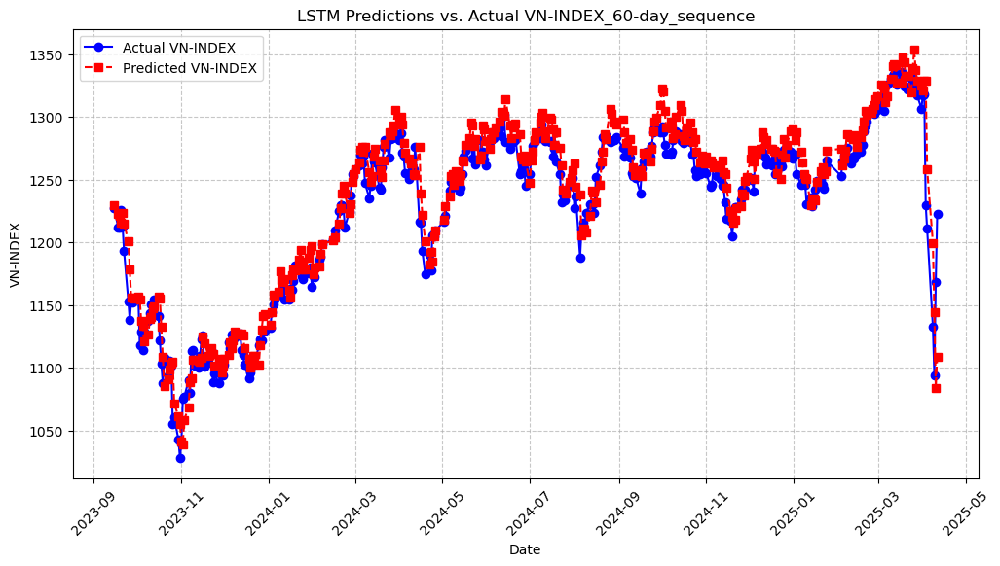

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-15      1227.360016         1229.704267
1   2023-09-18      1211.810003         1223.007859
2   2023-09-19      1211.500015         1221.184466
3   2023-09-20      1226.109969         1215.910902
4   2023-09-21      1212.739965         1223.627757
..         ...              ...                 ...
387 2025-04-04      1210.670016         1258.093790
388 2025-04-08      1132.790007         1199.597173
389 2025-04-09      1094.299993         1144.198581
390 2025-04-10      1168.339995         1084.162970
391 2025-04-11      1222.460024         1108.772449

[392 rows x 3 columns]


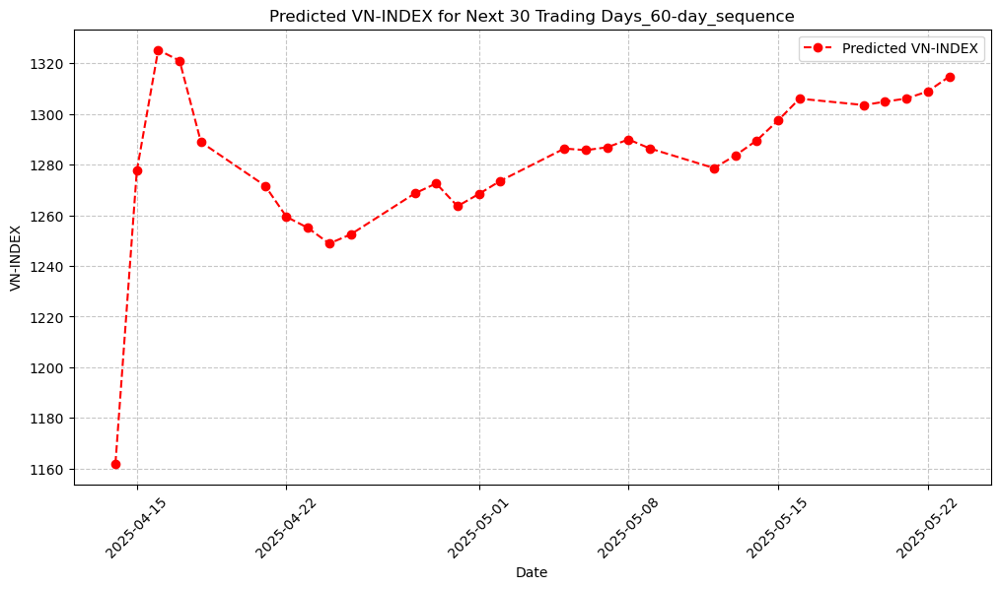

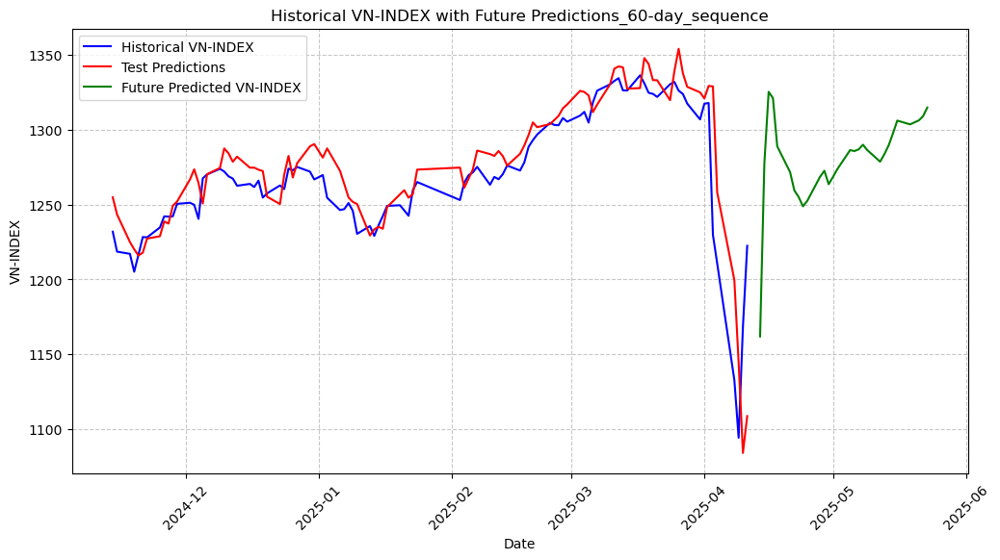

         Date  Predicted VN-INDEX
0  2025-04-14         1161.907639
1  2025-04-15         1277.569361
2  2025-04-16         1325.302352
3  2025-04-17         1321.077057
4  2025-04-18         1288.908646
5  2025-04-21         1271.673972
6  2025-04-22         1259.397094
7  2025-04-23         1255.040621
8  2025-04-24         1248.839561
9  2025-04-25         1252.431701
10 2025-04-28         1268.621882
11 2025-04-29         1272.582663
12 2025-04-30         1263.597572
13 2025-05-01         1268.416945
14 2025-05-02         1273.573744
15 2025-05-05         1286.362926
16 2025-05-06         1285.729694
17 2025-05-07         1286.857580
18 2025-05-08         1289.957455
19 2025-05-09         1286.394217
20 2025-05-12         1278.646456
21 2025-05-13         1283.656585
22 2025-05-14         1289.588430
23 2025-05-15         1297.515231
24 2025-05-16         1306.070178
25 2025-05-19         1303.549506
26 2025-05-20         1304.880633
27 2025-05-21         1306.138927
28 2025-05-22 

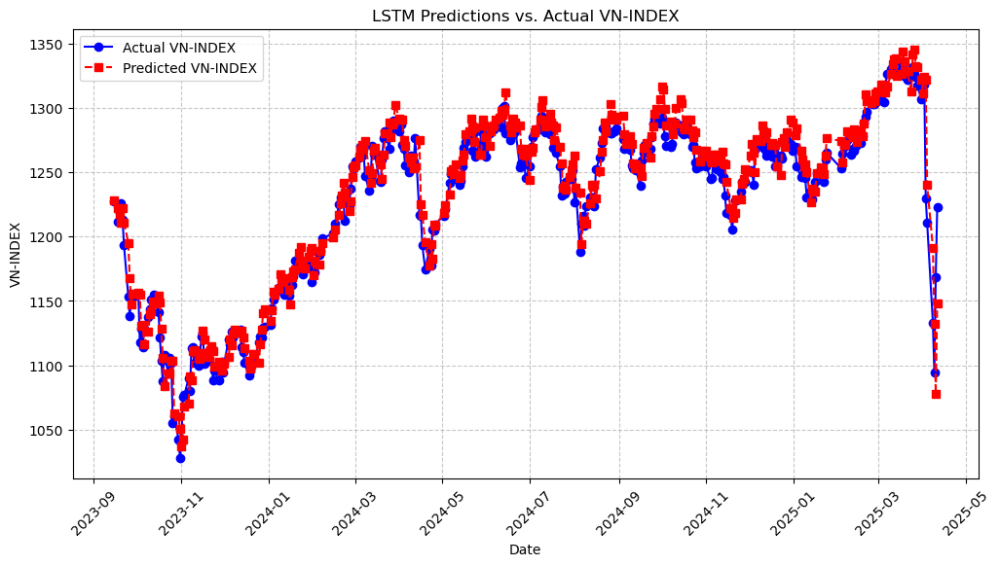

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-15      1227.360016         1228.476639
1   2023-09-18      1211.810003         1221.756739
2   2023-09-19      1211.500015         1217.609536
3   2023-09-20      1226.109969         1210.673419
4   2023-09-21      1212.739965         1222.342529
..         ...              ...                 ...
387 2025-04-04      1210.670016         1239.857840
388 2025-04-08      1132.790007         1191.271321
389 2025-04-09      1094.299993         1132.145671
390 2025-04-10      1168.339995         1077.763948
391 2025-04-11      1222.460024         1148.258781

[392 rows x 3 columns]


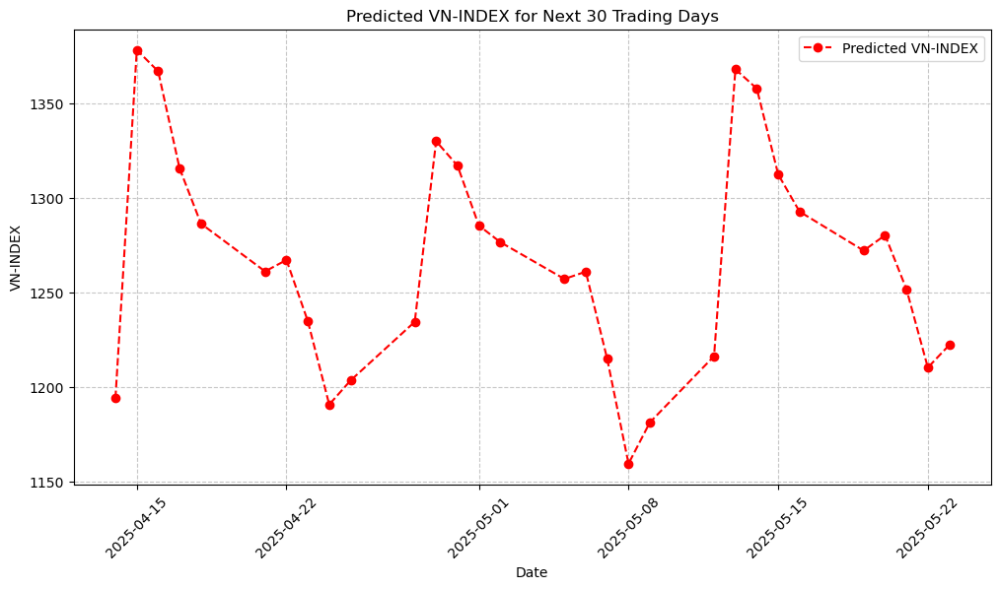

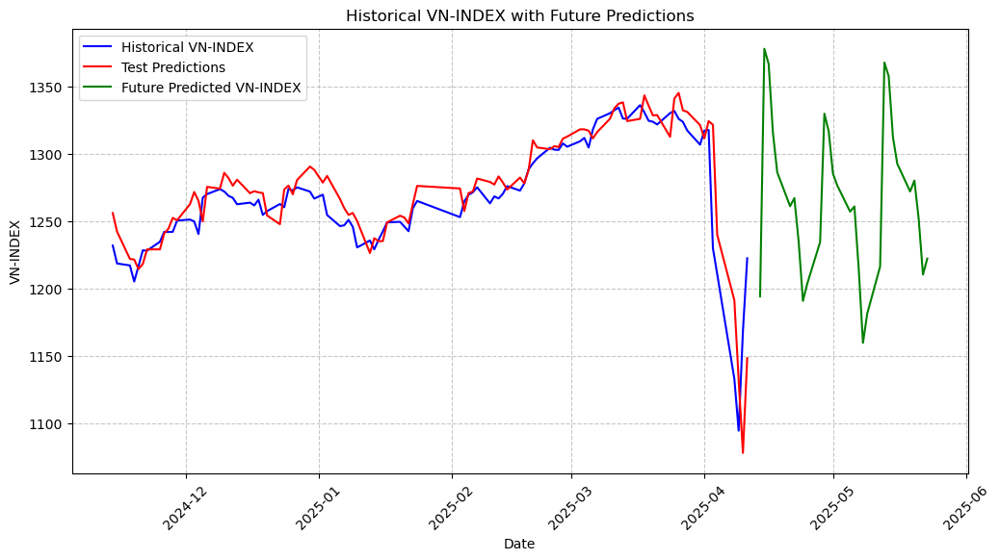


Ensemble Future Predictions (weighted average) for next 30 days:
         Date  Predicted Future VN-INDEX
0  2025-04-14                1194.120536
1  2025-04-15                1378.123073
2  2025-04-16                1366.833649
3  2025-04-17                1315.584457
4  2025-04-18                1286.361947
5  2025-04-21                1261.125509
6  2025-04-22                1267.162207
7  2025-04-23                1234.807240
8  2025-04-24                1190.761559
9  2025-04-25                1203.508233
10 2025-04-28                1234.461411
11 2025-04-29                1329.907503
12 2025-04-30                1316.966421
13 2025-05-01                1285.359070
14 2025-05-02                1276.588768
15 2025-05-05                1257.116607
16 2025-05-06                1260.974785
17 2025-05-07                1215.009928
18 2025-05-08                1159.539695
19 2025-05-09                1181.351644
20 2025-05-12                1216.313495
21 2025-05-13                136

In [13]:
data = lag_features_indicators(df_2, ['VN_Index_Close'])

ensemble_lstm_model(data)

/var/folders/fl/t1q3j3rn0dg278fhg2bvg0dw0000gn/T/ipykernel_31202/3744217377.py:40: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  copy_df[f'{col}_Lag{lag}'] = copy_df[col].shift(lag)
/var/folders/fl/t1q3j3rn0dg278fhg2bvg0dw0000gn/T/ipykernel_31202/3744217377.py:40: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  copy_df[f'{col}_Lag{lag}'] = copy_df[col].shift(lag)
/var/folders/fl/t1q3j3rn0dg278fhg2bvg0dw0000gn/T/ipykernel_31202/3744217377.py:40: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of call


Training LSTM with sequence length = 5


/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.17446858549852615 and num_layers=1
  warnings.warn(
[I 2025-04-14 19:59:29,964] Trial 0 finished with value: 0.004775405800633053 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.17446858549852615, 'learning_rate': 0.002381999017490832, 'batch_size': 128}. Best is trial 0 with value: 0.004775405800633053.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3899181695998849 and num_layers=1
  warnings.warn(
[I 2025-04-14 20:00:06,961] Trial 1 finished with value: 0.003285970243032064 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.3899181695998849, 'learning_rate'

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.30884045091847956, 'learning_rate': 0.001060121600628167, 'batch_size': 64}
Best Overall Average Training Loss: 0.0005
Final Evaluation Loss on Test Set: 0.0003
RMSE: 23.6255, MAE: 18.1040, R²: 0.8669, Directional Accuracy: 0.5523


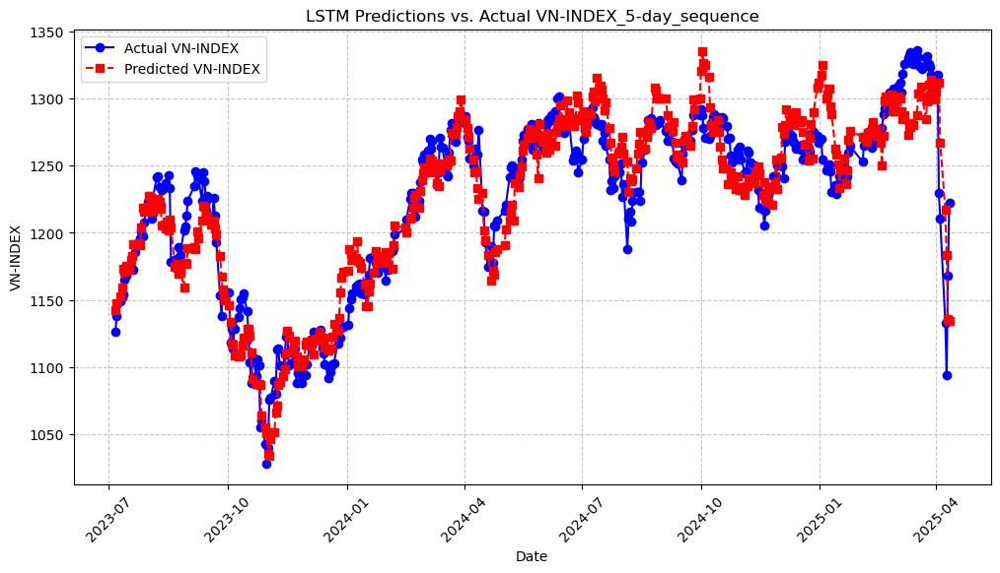

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-06      1126.219998         1142.153680
1   2023-07-07      1138.069969         1147.620621
2   2023-07-10      1149.020035         1152.814877
3   2023-07-11      1151.769999         1159.167078
4   2023-07-12      1154.200033         1172.880904
..         ...              ...                 ...
436 2025-04-04      1210.670016         1267.292296
437 2025-04-08      1132.790007         1216.892426
438 2025-04-09      1094.299993         1183.167834
439 2025-04-10      1168.339995         1135.633923
440 2025-04-11      1222.460024         1134.373163

[441 rows x 3 columns]


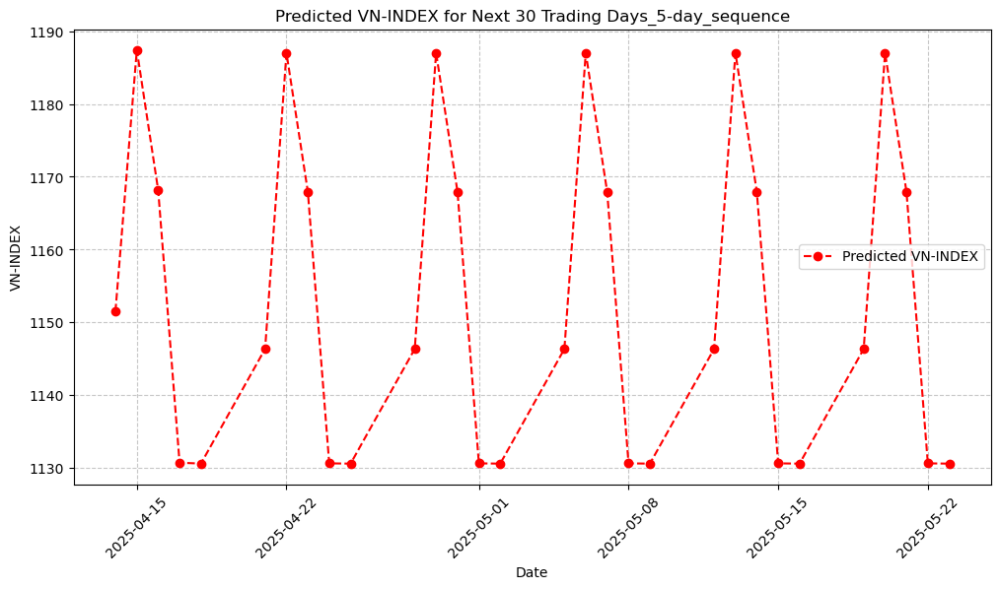

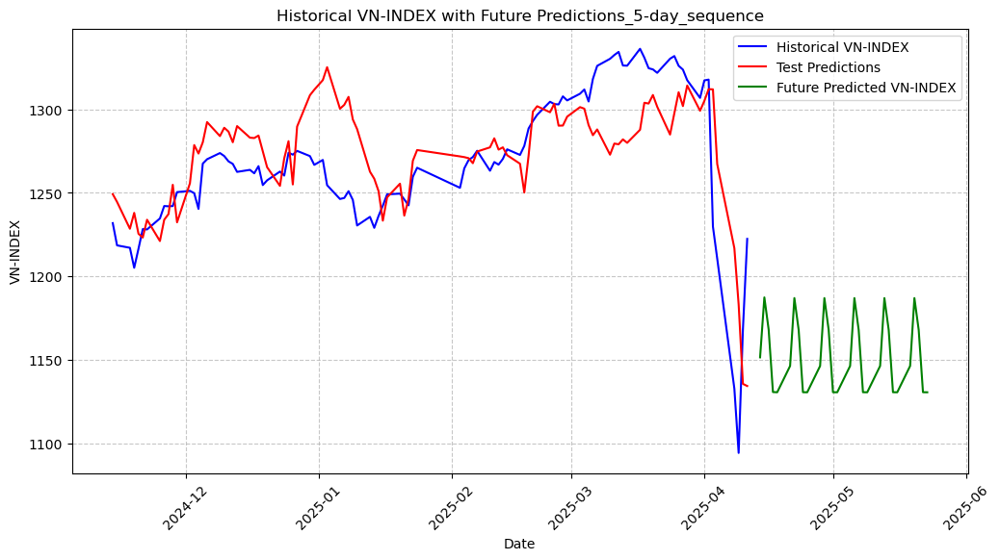

[I 2025-04-14 20:02:32,365] A new study created in memory with name: no-name-bf3a7494-954f-4e34-b3f6-b2e5046c1116


         Date  Predicted VN-INDEX
0  2025-04-14         1151.520822
1  2025-04-15         1187.412474
2  2025-04-16         1168.161340
3  2025-04-17         1130.745338
4  2025-04-18         1130.625721
5  2025-04-21         1146.363175
6  2025-04-22         1187.013082
7  2025-04-23         1167.957713
8  2025-04-24         1130.656242
9  2025-04-25         1130.616935
10 2025-04-28         1146.362327
11 2025-04-29         1187.012466
12 2025-04-30         1167.957405
13 2025-05-01         1130.656165
14 2025-05-02         1130.616935
15 2025-05-05         1146.362327
16 2025-05-06         1187.012466
17 2025-05-07         1167.957405
18 2025-05-08         1130.656088
19 2025-05-09         1130.616935
20 2025-05-12         1146.362327
21 2025-05-13         1187.012466
22 2025-05-14         1167.957405
23 2025-05-15         1130.656088
24 2025-05-16         1130.616935
25 2025-05-19         1146.362327
26 2025-05-20         1187.012466
27 2025-05-21         1167.957405
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.12074444448495325 and num_layers=1
  warnings.warn(
[I 2025-04-14 20:03:16,723] Trial 0 finished with value: 0.0006967139099830842 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.12074444448495325, 'learning_rate': 0.000188646225729297, 'batch_size': 64}. Best is trial 0 with value: 0.0006967139099830842.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.23474135123013903 and num_layers=1
  warnings.warn(
[I 2025-04-14 20:03:48,424] Trial 1 finished with value: 0.0019462141097008295 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.23474135123013903, 'learning_r

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.17667780544076683, 'learning_rate': 0.0006350094250206383, 'batch_size': 32}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0004
RMSE: 25.8587, MAE: 19.8673, R²: 0.8394, Directional Accuracy: 0.5425


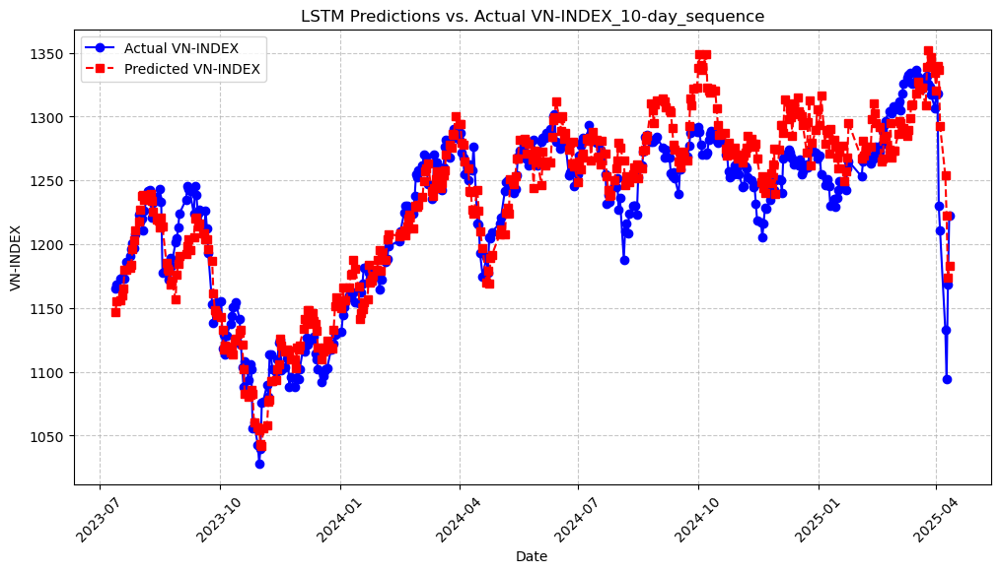

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-13      1165.420009         1146.641332
1   2023-07-14      1168.400035         1155.614476
2   2023-07-17      1173.130004         1155.683456
3   2023-07-18      1174.090025         1159.667744
4   2023-07-19      1172.980020         1165.064394
..         ...              ...                 ...
431 2025-04-04      1210.670016         1292.627880
432 2025-04-08      1132.790007         1253.886685
433 2025-04-09      1094.299993         1222.435746
434 2025-04-10      1168.339995         1173.804315
435 2025-04-11      1222.460024         1183.158431

[436 rows x 3 columns]


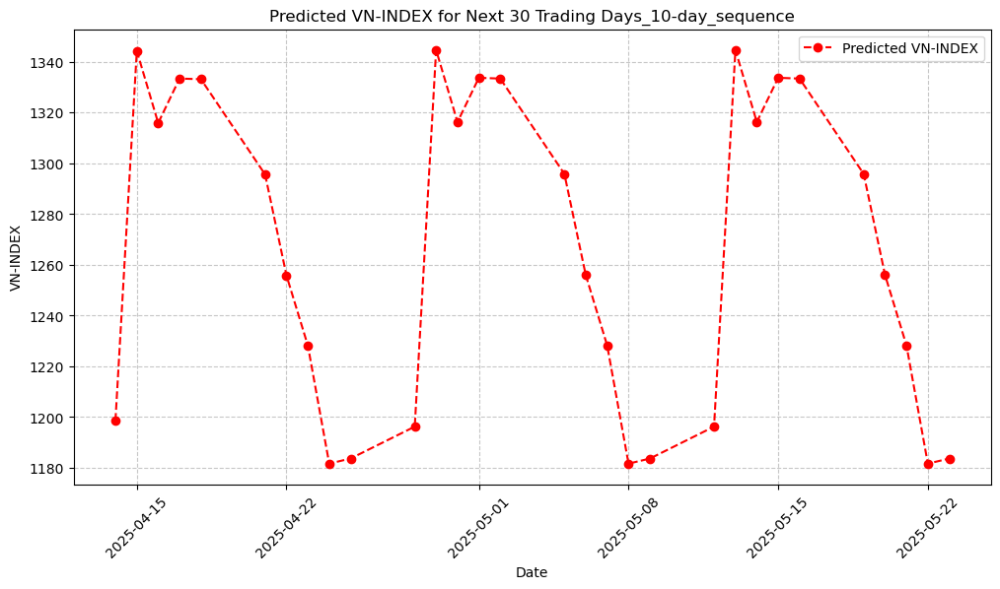

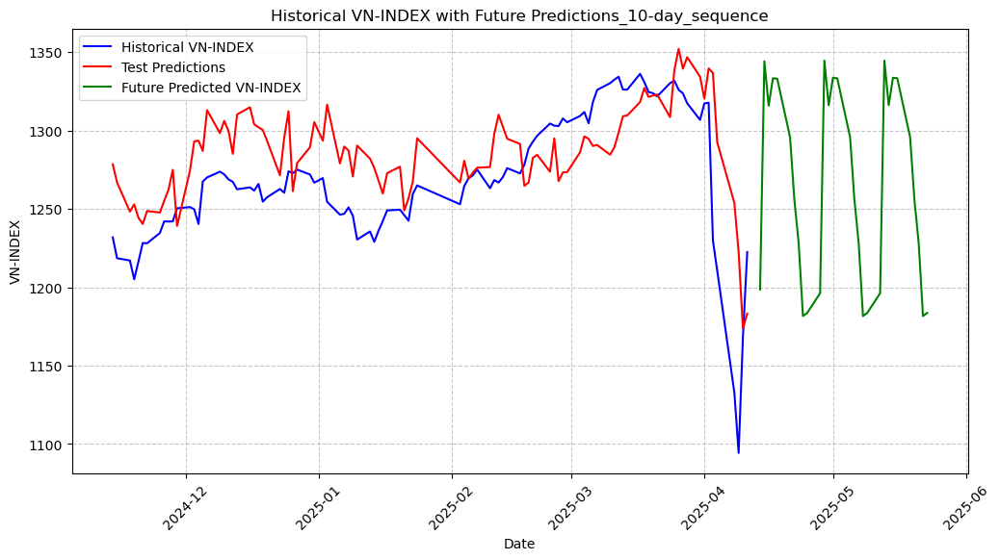

         Date  Predicted VN-INDEX
0  2025-04-14         1198.612180
1  2025-04-15         1344.338838
2  2025-04-16         1315.924420
3  2025-04-17         1333.447502
4  2025-04-18         1333.186455
5  2025-04-21         1295.660933
6  2025-04-22         1255.848038
7  2025-04-23         1228.223695
8  2025-04-24         1181.675779
9  2025-04-25         1183.687846
10 2025-04-28         1196.251666
11 2025-04-29         1344.714569
12 2025-04-30         1316.297916
13 2025-05-01         1333.754329
14 2025-05-02         1333.431008
15 2025-05-05         1295.842594
16 2025-05-06         1255.973436
17 2025-05-07         1228.278032
18 2025-05-08         1181.662753
19 2025-05-09         1183.669194
20 2025-05-12         1196.250664
21 2025-05-13         1344.715648
22 2025-05-14         1316.298764
23 2025-05-15         1333.754792
24 2025-05-16         1333.431239
25 2025-05-19         1295.842748
26 2025-05-20         1255.973513
27 2025-05-21         1228.278032
28 2025-05-22 

[I 2025-04-14 20:07:19,110] A new study created in memory with name: no-name-dba38993-b3db-413c-88e3-7c65d4392bfc
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.35612420500974507 and num_layers=1
  warnings.warn(
[I 2025-04-14 20:07:39,108] Trial 0 finished with value: 0.0010781665074409829 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.35612420500974507, 'learning_rate': 0.0002444313013207179, 'batch_size': 128}. Best is trial 0 with value: 0.0010781665074409829.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2095672368824209 and num_layers=1
  warnings.warn(
[I 2025-04-14 20:08:28,346] Trial 1 finished with value: 0.000

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.2095672368824209, 'learning_rate': 0.00035163207504018923, 'batch_size': 32}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0008
RMSE: 33.7967, MAE: 26.4445, R²: 0.7285, Directional Accuracy: 0.5388


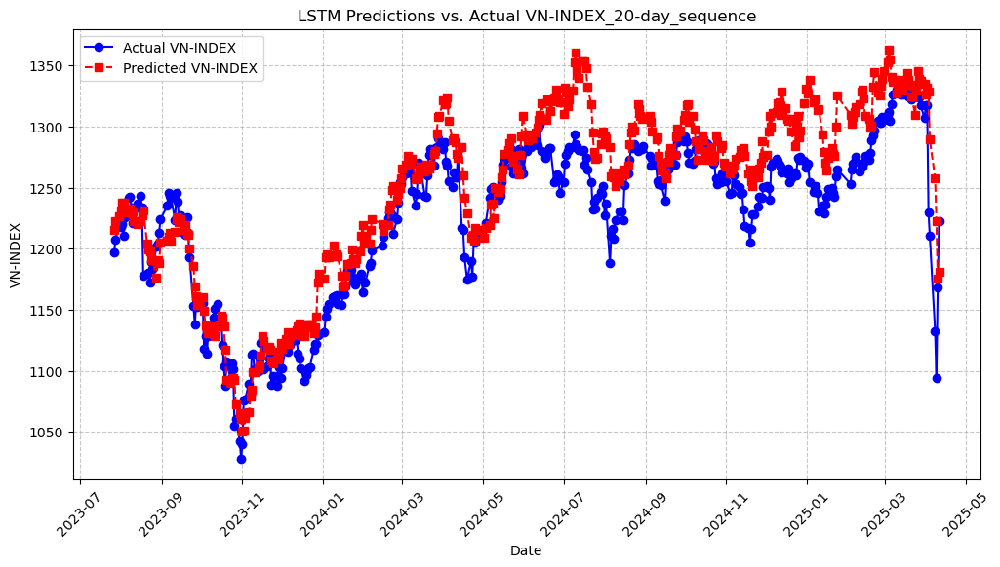

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-27      1197.329994         1215.519140
1   2023-07-28      1207.670028         1222.520295
2   2023-07-31      1222.900034         1226.805630
3   2023-08-01      1217.560032         1231.340450
4   2023-08-02      1220.429999         1237.610722
..         ...              ...                 ...
421 2025-04-04      1210.670016         1289.231890
422 2025-04-08      1132.790007         1257.970705
423 2025-04-09      1094.299993         1222.671281
424 2025-04-10      1168.339995         1175.769445
425 2025-04-11      1222.460024         1181.316079

[426 rows x 3 columns]


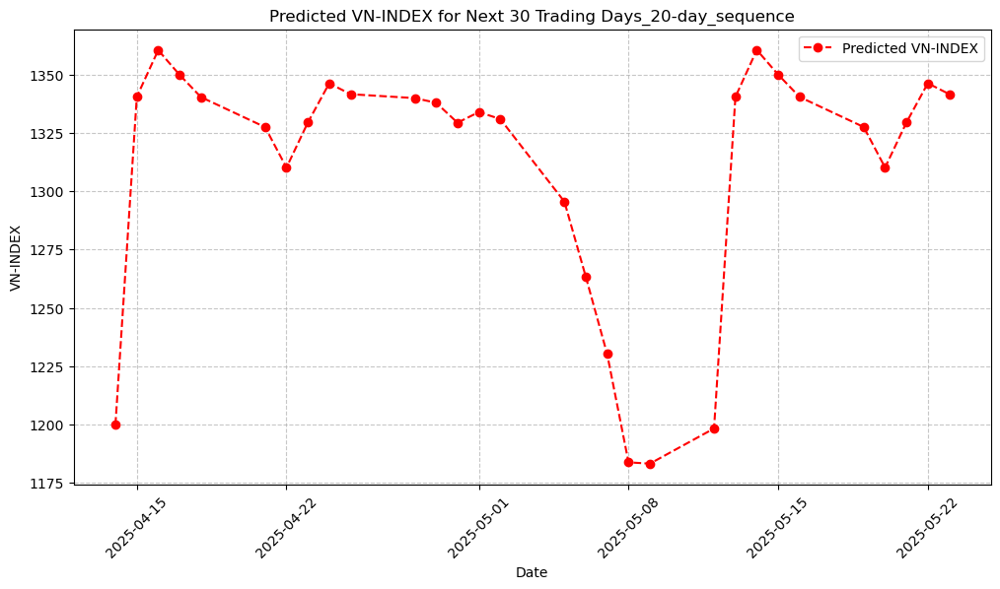

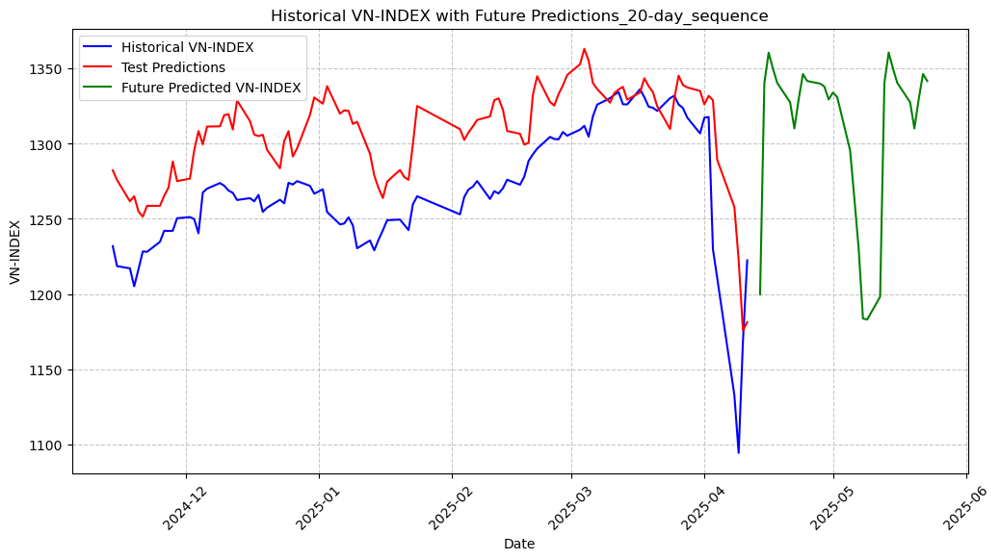

         Date  Predicted VN-INDEX
0  2025-04-14         1199.848739
1  2025-04-15         1340.591011
2  2025-04-16         1360.608173
3  2025-04-17         1350.011872
4  2025-04-18         1340.461297
5  2025-04-21         1327.566987
6  2025-04-22         1310.190730
7  2025-04-23         1329.536973
8  2025-04-24         1346.363777
9  2025-04-25         1341.700245
10 2025-04-28         1340.027376
11 2025-04-29         1338.030107
12 2025-04-30         1329.465141
13 2025-05-01         1334.032177
14 2025-05-02         1331.042208
15 2025-05-05         1295.586634
16 2025-05-06         1263.376141
17 2025-05-07         1230.145818
18 2025-05-08         1183.659252
19 2025-05-09         1183.101243
20 2025-05-12         1198.199454
21 2025-05-13         1340.532050
22 2025-05-14         1360.694032
23 2025-05-15         1350.099041
24 2025-05-16         1340.529737
25 2025-05-19         1327.621709
26 2025-05-20         1310.221637
27 2025-05-21         1329.569575
28 2025-05-22 

[I 2025-04-14 20:13:15,438] A new study created in memory with name: no-name-99d90d77-9ea0-41c6-80b4-0f2931f4cc82
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.11460436915237021 and num_layers=1
  warnings.warn(
[I 2025-04-14 20:16:17,076] Trial 0 finished with value: 0.0004756833219791933 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.11460436915237021, 'learning_rate': 0.00012005459779460166, 'batch_size': 32}. Best is trial 0 with value: 0.0004756833219791933.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3365910330028057 and num_layers=1
  warnings.warn(
[I 2025-04-14 20:17:06,897] Trial 1 finished with value: 0.00

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.11460436915237021, 'learning_rate': 0.00012005459779460166, 'batch_size': 32}
Best Overall Average Training Loss: 0.0005
Final Evaluation Loss on Test Set: 0.0014
RMSE: 47.9414, MAE: 39.4839, R²: 0.4757, Directional Accuracy: 0.5580


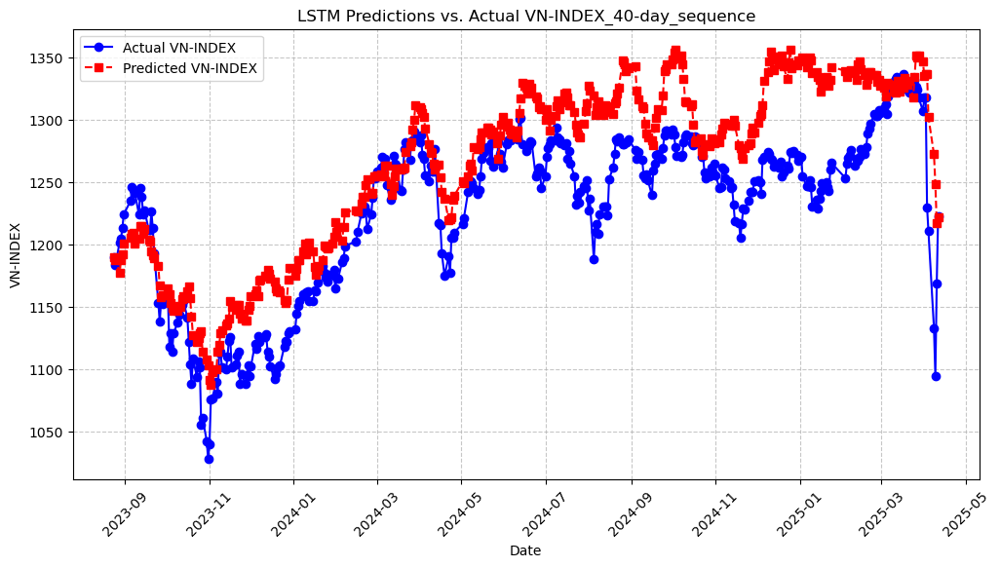

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-08-24      1189.390013         1189.701079
1   2023-08-25      1183.369997         1187.642152
2   2023-08-28      1201.719994         1176.811395
3   2023-08-29      1204.430034         1187.295092
4   2023-08-30      1213.160013         1192.048568
..         ...              ...                 ...
401 2025-04-04      1210.670016         1301.876098
402 2025-04-08      1132.790007         1272.113519
403 2025-04-09      1094.299993         1248.370649
404 2025-04-10      1168.339995         1216.738666
405 2025-04-11      1222.460024         1221.617077

[406 rows x 3 columns]


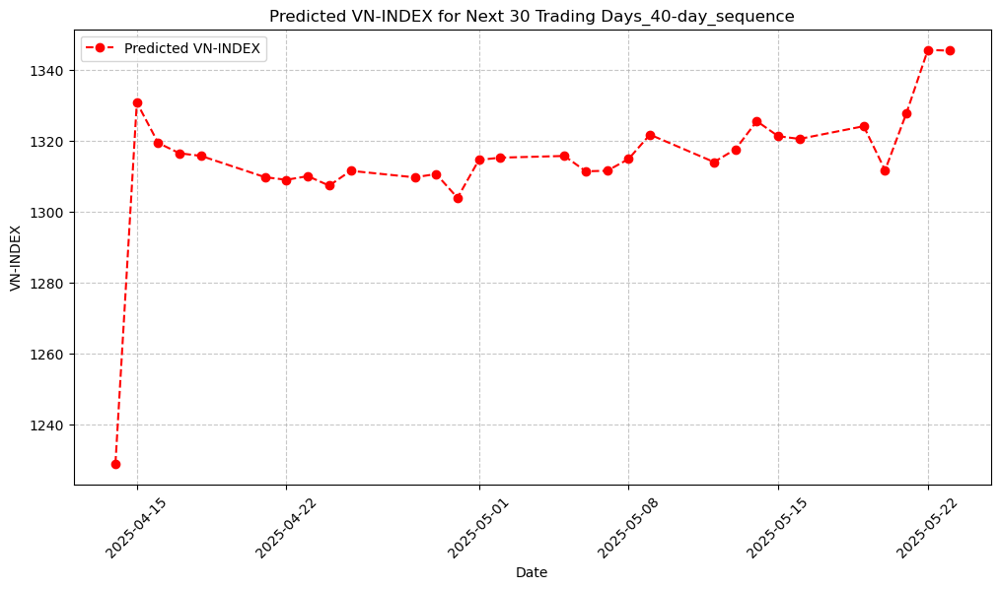

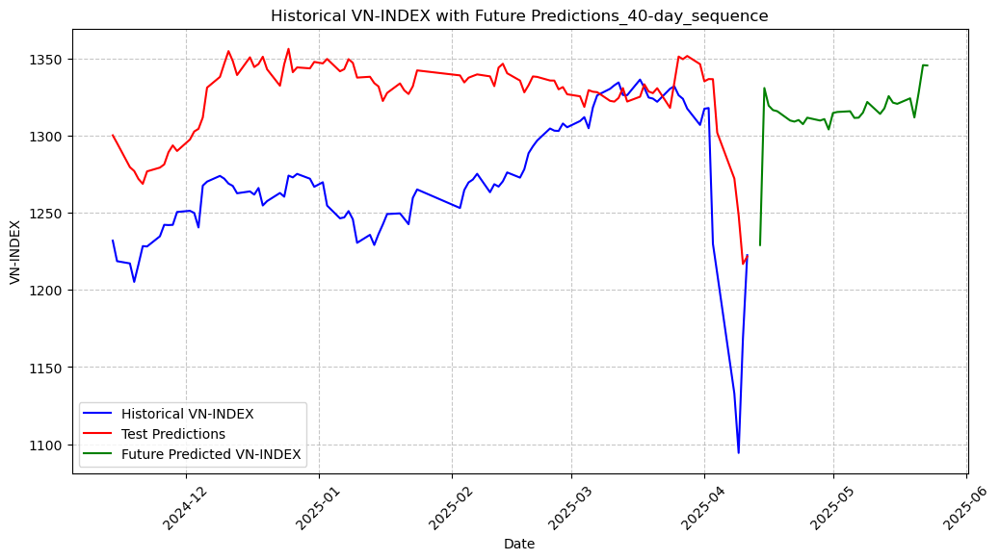

         Date  Predicted VN-INDEX
0  2025-04-14         1229.059012
1  2025-04-15         1330.777385
2  2025-04-16         1319.397175
3  2025-04-17         1316.488672
4  2025-04-18         1315.761874
5  2025-04-21         1309.752802
6  2025-04-22         1309.020763
7  2025-04-23         1310.051382
8  2025-04-24         1307.377258
9  2025-04-25         1311.556618
10 2025-04-28         1309.710489
11 2025-04-29         1310.652629
12 2025-04-30         1303.937800
13 2025-05-01         1314.611020
14 2025-05-02         1315.261362
15 2025-05-05         1315.737750
16 2025-05-06         1311.419351
17 2025-05-07         1311.567100
18 2025-05-08         1314.863819
19 2025-05-09         1321.749442
20 2025-05-12         1314.022414
21 2025-05-13         1317.619486
22 2025-05-14         1325.542126
23 2025-05-15         1321.302650
24 2025-05-16         1320.539473
25 2025-05-19         1324.116970
26 2025-05-20         1311.712691
27 2025-05-21         1327.817012
28 2025-05-22 

[I 2025-04-14 20:31:51,573] A new study created in memory with name: no-name-334f5165-2a2c-4241-8950-64072c3bbfe0
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3227780591936443 and num_layers=1
  warnings.warn(
[I 2025-04-14 20:33:01,151] Trial 0 finished with value: 0.002035746959973039 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.3227780591936443, 'learning_rate': 0.00011120753516106314, 'batch_size': 128}. Best is trial 0 with value: 0.002035746959973039.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4127787870141253 and num_layers=1
  warnings.warn(
[I 2025-04-14 20:34:48,565] Trial 1 finished with value: 0.000460

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.22428565357153196, 'learning_rate': 0.0005380714249782515, 'batch_size': 32}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0007
RMSE: 33.6374, MAE: 27.4271, R²: 0.7534, Directional Accuracy: 0.5117


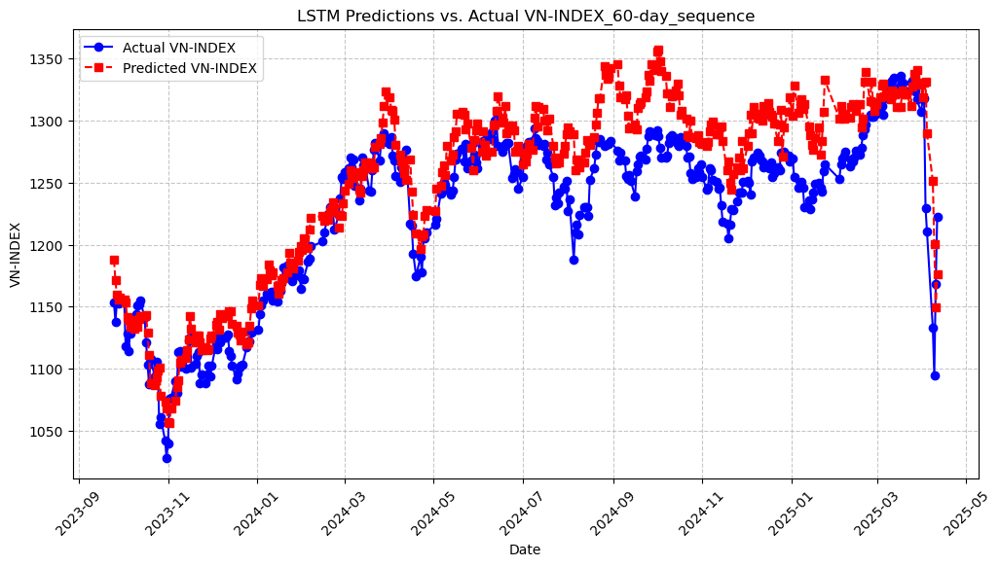

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-25      1153.200011         1187.965704
1   2023-09-26      1137.959985         1171.088418
2   2023-09-27      1153.849967         1159.433057
3   2023-09-28      1152.429975         1156.034524
4   2023-09-29      1154.150012         1157.045413
..         ...              ...                 ...
381 2025-04-04      1210.670016         1289.653479
382 2025-04-08      1132.790007         1251.231983
383 2025-04-09      1094.299993         1200.513879
384 2025-04-10      1168.339995         1149.690570
385 2025-04-11      1222.460024         1176.008834

[386 rows x 3 columns]


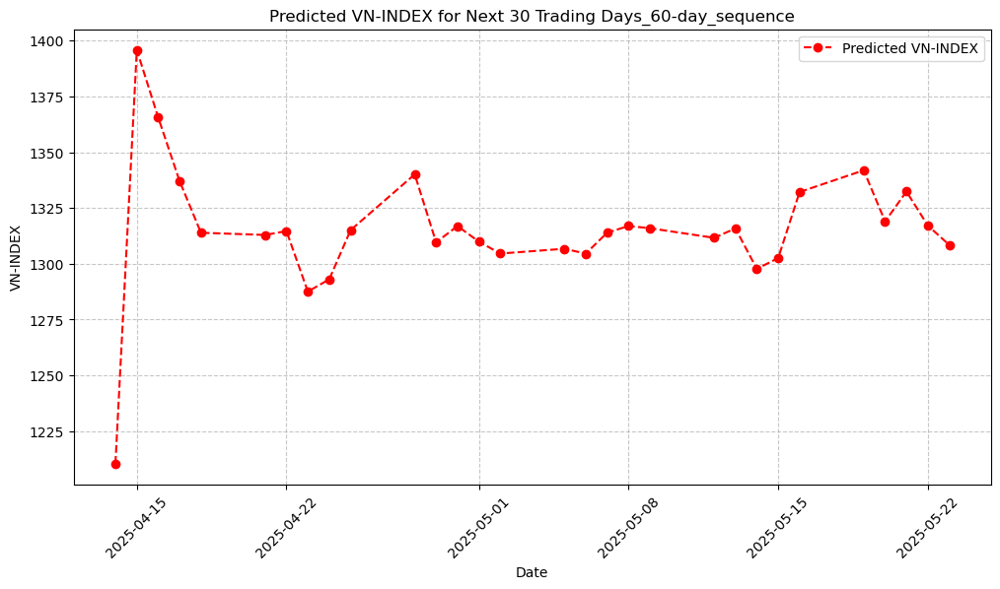

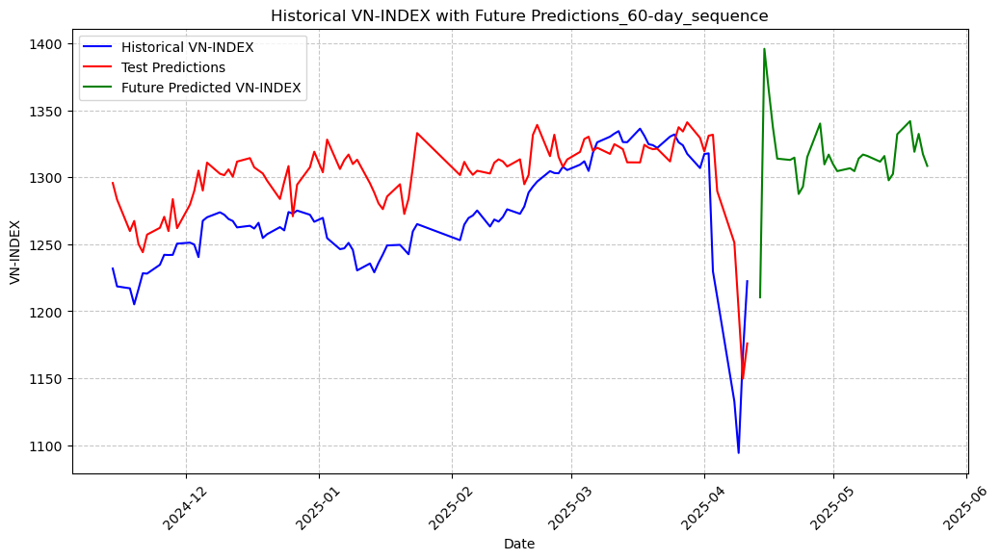

         Date  Predicted VN-INDEX
0  2025-04-14         1210.395868
1  2025-04-15         1395.830062
2  2025-04-16         1365.589091
3  2025-04-17         1337.088429
4  2025-04-18         1313.899020
5  2025-04-21         1312.904162
6  2025-04-22         1314.640231
7  2025-04-23         1287.516323
8  2025-04-24         1293.006385
9  2025-04-25         1315.080086
10 2025-04-28         1340.066606
11 2025-04-29         1309.600274
12 2025-04-30         1316.897159
13 2025-05-01         1309.904327
14 2025-05-02         1304.562707
15 2025-05-05         1306.714431
16 2025-05-06         1304.536194
17 2025-05-07         1313.927614
18 2025-05-08         1316.927063
19 2025-05-09         1315.922185
20 2025-05-12         1311.619663
21 2025-05-13         1315.832241
22 2025-05-14         1297.717317
23 2025-05-15         1302.515957
24 2025-05-16         1332.143735
25 2025-05-19         1341.891925
26 2025-05-20         1318.986761
27 2025-05-21         1332.369405
28 2025-05-22 

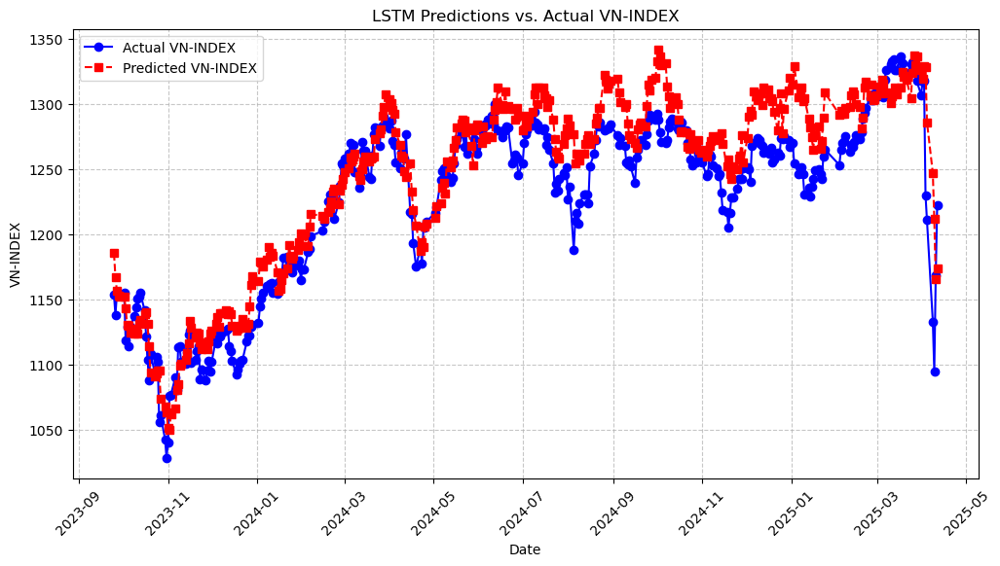

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-25      1153.200011         1185.383509
1   2023-09-26      1137.959985         1166.865826
2   2023-09-27      1153.849967         1156.314407
3   2023-09-28      1152.429975         1152.872826
4   2023-09-29      1154.150012         1151.744446
..         ...              ...                 ...
381 2025-04-04      1210.670016         1285.999169
382 2025-04-08      1132.790007         1246.790367
383 2025-04-09      1094.299993         1211.479543
384 2025-04-10      1168.339995         1165.249582
385 2025-04-11      1222.460024         1173.666893

[386 rows x 3 columns]


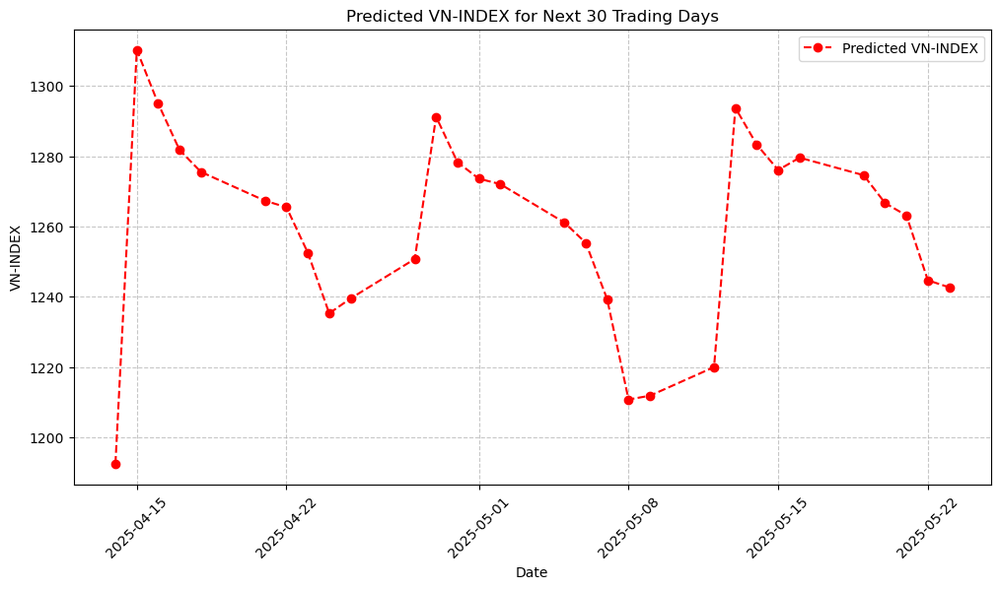

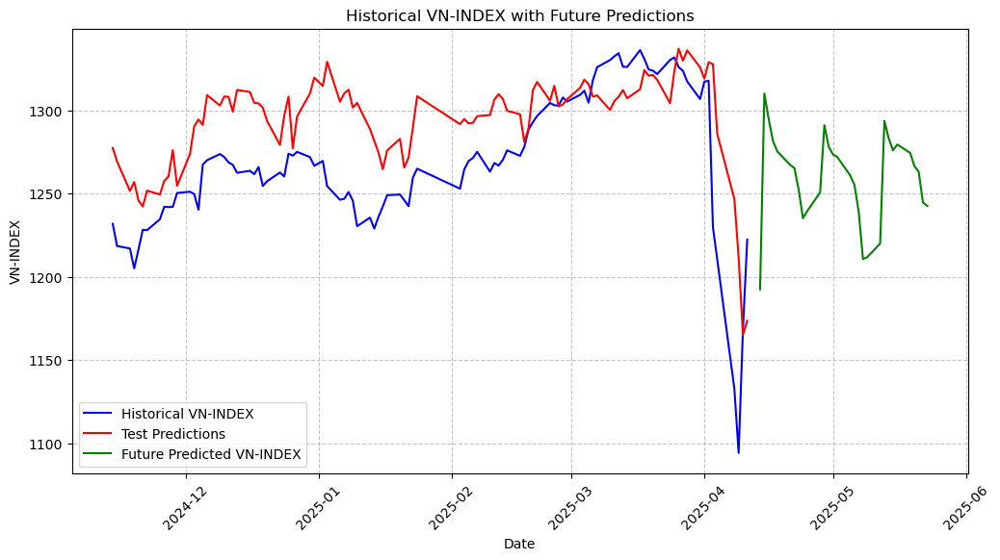


Ensemble Future Predictions (weighted average) for next 30 days:
         Date  Predicted Future VN-INDEX
0  2025-04-14                1192.586104
1  2025-04-15                1310.181993
2  2025-04-16                1294.932730
3  2025-04-17                1281.732482
4  2025-04-18                1275.513777
5  2025-04-21                1267.314617
6  2025-04-22                1265.472887
7  2025-04-23                1252.522548
8  2025-04-24                1235.313725
9  2025-04-25                1239.542412
10 2025-04-28                1250.754653
11 2025-04-29                1291.187375
12 2025-04-30                1278.269571
13 2025-05-01                1273.591998
14 2025-05-02                1272.054119
15 2025-05-05                1261.119845
16 2025-05-06                1255.355260
17 2025-05-07                1239.356883
18 2025-05-08                1210.822127
19 2025-05-09                1211.896588
20 2025-05-12                1220.028462
21 2025-05-13                129

In [14]:
data = lag_features_indicators(df_2, df_2.columns)

ensemble_lstm_model(data)

In [15]:
# 📂 Load dataset
file_path_3 = "../ready_data/vn_index_merged_data.csv"
df_3 = pd.read_csv(file_path_3)
df_3 = quicky_data(df_3)

[I 2025-04-14 20:56:22,250] A new study created in memory with name: no-name-0355ae5b-fe88-42d3-824e-50b2302a6836



Training LSTM with sequence length = 5


/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.34463120181607326 and num_layers=1
  warnings.warn(
[I 2025-04-14 20:56:25,826] Trial 0 finished with value: 0.0037205351416287158 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.34463120181607326, 'learning_rate': 0.00025353353642753495, 'batch_size': 128}. Best is trial 0 with value: 0.0037205351416287158.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2135675377531588 and num_layers=1
  warnings.warn(
[I 2025-04-14 20:56:40,020] Trial 1 finished with value: 0.0006675890997746591 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.2135675377531588, 'learning_r

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.28809887778561255, 'learning_rate': 0.009049342962249938, 'batch_size': 32}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0003
RMSE: 16.6238, MAE: 12.3441, R²: 0.9354, Directional Accuracy: 0.5179


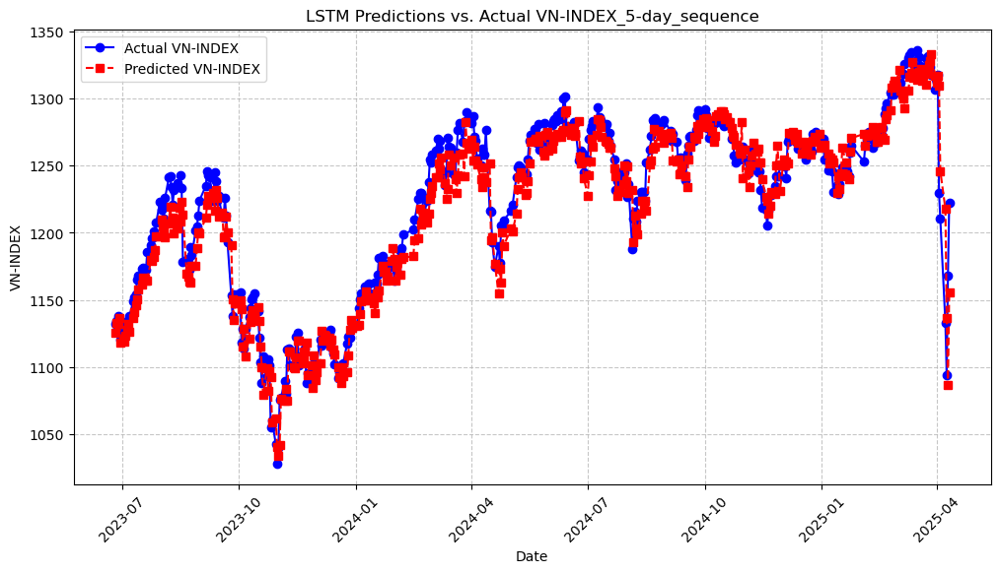

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-06-26      1132.029991         1125.411117
1   2023-06-27      1134.330002         1132.534048
2   2023-06-28      1138.349975         1132.321943
3   2023-06-29      1125.389999         1136.428777
4   2023-06-30      1120.180020         1118.378208
..         ...              ...                 ...
444 2025-04-04      1210.670016         1246.050059
445 2025-04-08      1132.790007         1217.709014
446 2025-04-09      1094.299993         1136.859692
447 2025-04-10      1168.339995         1086.463983
448 2025-04-11      1222.460024         1155.369692

[449 rows x 3 columns]


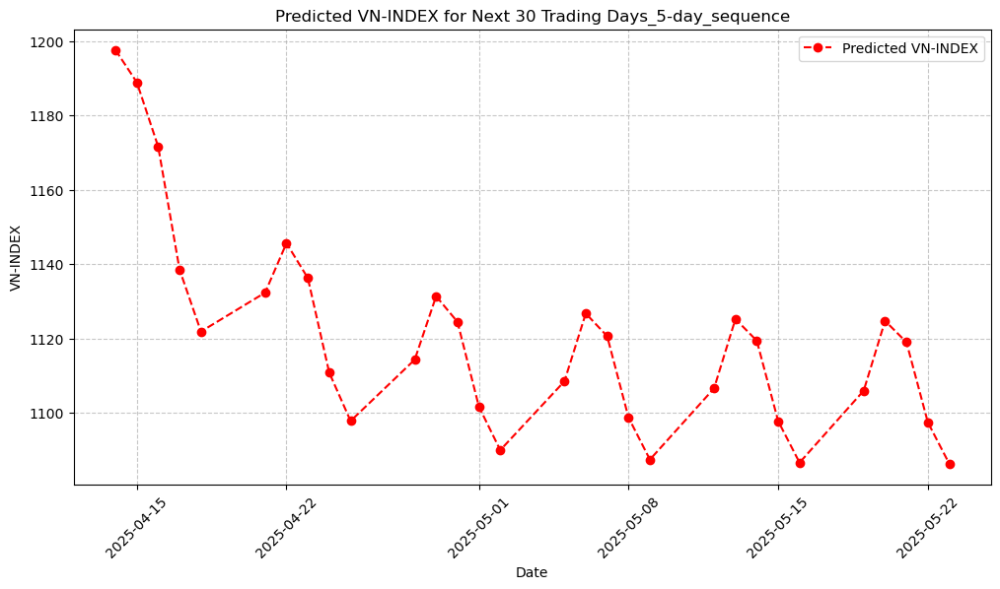

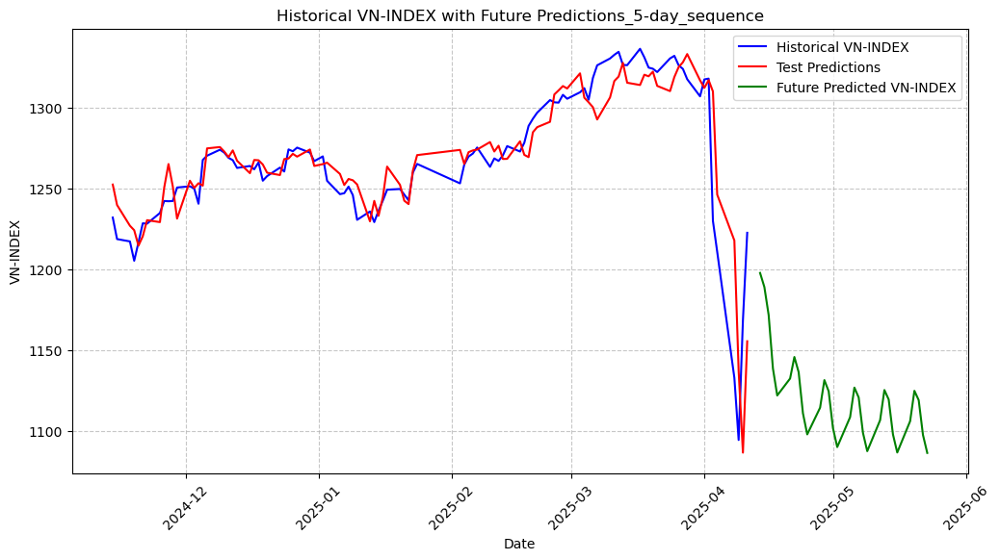

[I 2025-04-14 20:57:58,960] A new study created in memory with name: no-name-6a6aa5ed-4c4e-46d4-b305-7e99d64ef969


         Date  Predicted VN-INDEX
0  2025-04-14         1197.616474
1  2025-04-15         1188.919560
2  2025-04-16         1171.591242
3  2025-04-17         1138.492483
4  2025-04-18         1121.837012
5  2025-04-21         1132.301981
6  2025-04-22         1145.619960
7  2025-04-23         1136.229389
8  2025-04-24         1110.799083
9  2025-04-25         1097.765657
10 2025-04-28         1114.277078
11 2025-04-29         1131.337952
12 2025-04-30         1124.435605
13 2025-05-01         1101.656763
14 2025-05-02         1089.926795
15 2025-05-05         1108.436025
16 2025-05-06         1126.702244
17 2025-05-07         1120.606311
18 2025-05-08         1098.688914
19 2025-05-09         1087.382539
20 2025-05-12         1106.541648
21 2025-05-13         1125.199167
22 2025-05-14         1119.364819
23 2025-05-15         1097.726889
24 2025-05-16         1086.557781
25 2025-05-19         1105.927608
26 2025-05-20         1124.712142
27 2025-05-21         1118.962575
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.45701247335913453 and num_layers=1
  warnings.warn(
[I 2025-04-14 20:58:18,070] Trial 0 finished with value: 0.0003119355919238842 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.45701247335913453, 'learning_rate': 0.008579822334923756, 'batch_size': 32}. Best is trial 0 with value: 0.0003119355919238842.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2482855292896395 and num_layers=1
  warnings.warn(
[I 2025-04-14 20:58:36,798] Trial 1 finished with value: 0.0006499973802095838 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.2482855292896395, 'learning_rat

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.45701247335913453, 'learning_rate': 0.008579822334923756, 'batch_size': 32}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0008
RMSE: 35.9809, MAE: 33.0918, R²: 0.6937, Directional Accuracy: 0.5147


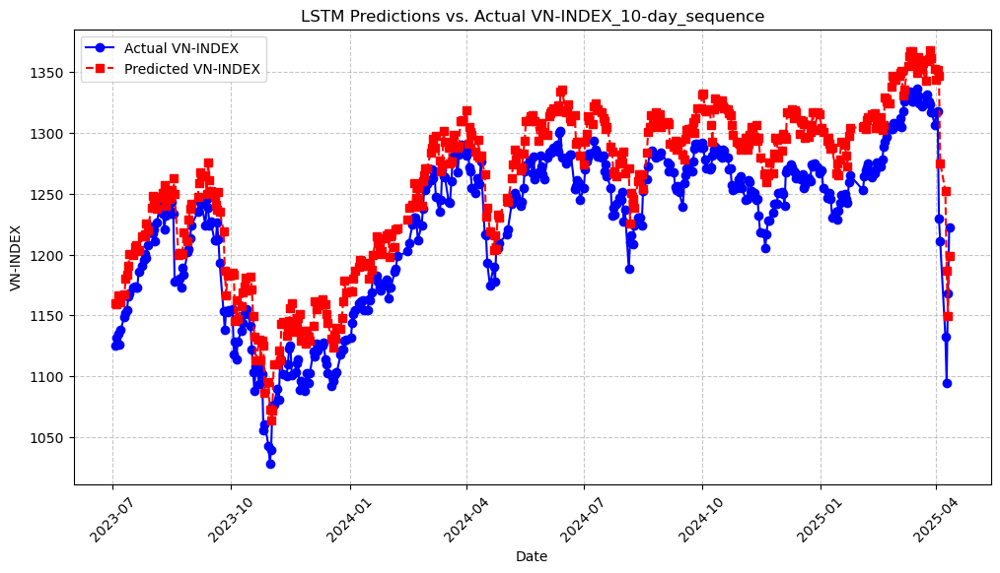

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-03      1125.499982         1160.228450
1   2023-07-04      1132.000009         1159.410320
2   2023-07-05      1134.620028         1166.701270
3   2023-07-06      1126.219998         1162.174774
4   2023-07-07      1138.069969         1160.592234
..         ...              ...                 ...
439 2025-04-04      1210.670016         1275.344341
440 2025-04-08      1132.790007         1252.283182
441 2025-04-09      1094.299993         1186.874813
442 2025-04-10      1168.339995         1149.094950
443 2025-04-11      1222.460024         1199.020513

[444 rows x 3 columns]


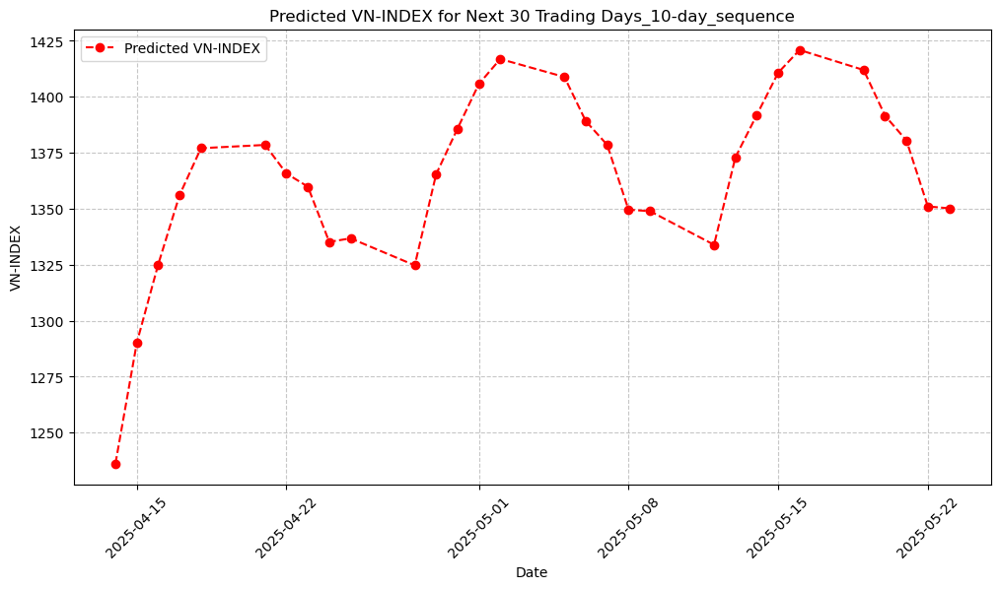

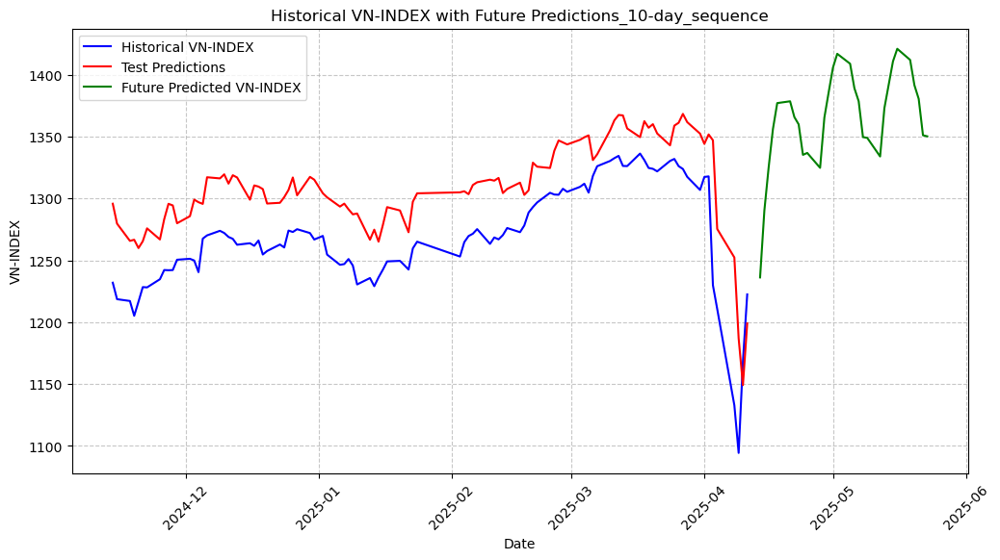

[I 2025-04-14 21:01:15,137] A new study created in memory with name: no-name-f404e0e3-6f88-4998-9ce2-02e9e16e0c62


         Date  Predicted VN-INDEX
0  2025-04-14         1236.145179
1  2025-04-15         1290.157151
2  2025-04-16         1325.097030
3  2025-04-17         1356.108190
4  2025-04-18         1377.053080
5  2025-04-21         1378.516542
6  2025-04-22         1365.746012
7  2025-04-23         1359.872126
8  2025-04-24         1335.213089
9  2025-04-25         1336.782912
10 2025-04-28         1324.741569
11 2025-04-29         1365.391168
12 2025-04-30         1385.797935
13 2025-05-01         1405.749971
14 2025-05-02         1416.892565
15 2025-05-05         1408.880521
16 2025-05-06         1389.141746
17 2025-05-07         1378.571264
18 2025-05-08         1349.574560
19 2025-05-09         1348.943563
20 2025-05-12         1333.915874
21 2025-05-13         1373.000891
22 2025-05-14         1391.927857
23 2025-05-15         1410.777595
24 2025-05-16         1420.938896
25 2025-05-19         1411.975232
26 2025-05-20         1391.536634
27 2025-05-21         1380.490073
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4072640032421947 and num_layers=1
  warnings.warn(
[I 2025-04-14 21:02:17,808] Trial 0 finished with value: 0.0006426105942057347 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.4072640032421947, 'learning_rate': 0.0010337198316889011, 'batch_size': 64}. Best is trial 0 with value: 0.0006426105942057347.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.15267903286833626 and num_layers=1
  warnings.warn(
[I 2025-04-14 21:03:09,767] Trial 1 finished with value: 0.0009202626251862966 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.15267903286833626, 'learning_ra

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.341831741252897, 'learning_rate': 0.001959313658823636, 'batch_size': 32}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0002
RMSE: 17.1414, MAE: 12.9326, R²: 0.9295, Directional Accuracy: 0.5035


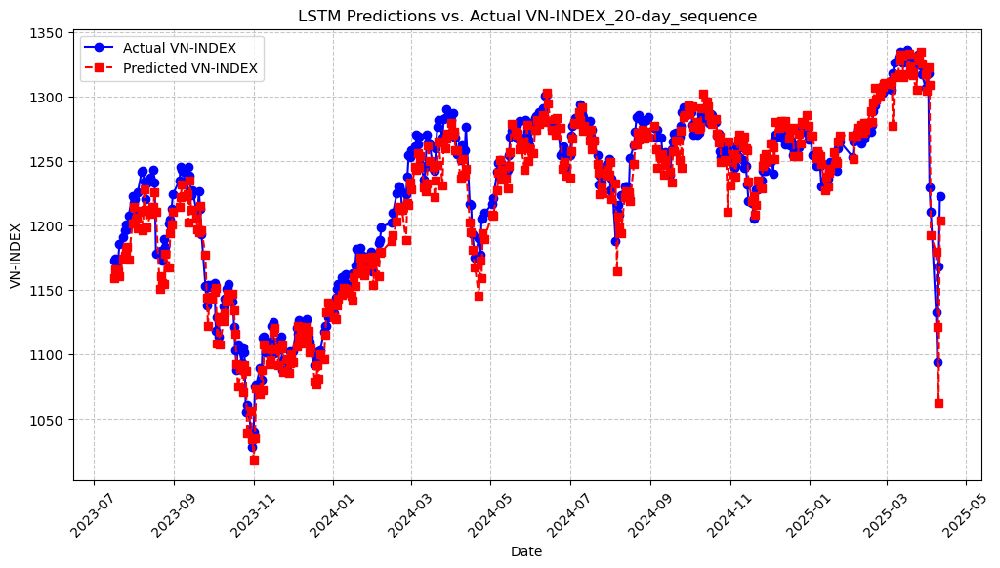

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-17      1173.130004         1158.843603
1   2023-07-18      1174.090025         1165.623558
2   2023-07-19      1172.980020         1165.769072
3   2023-07-20      1172.809997         1164.490971
4   2023-07-21      1185.899994         1160.729347
..         ...              ...                 ...
429 2025-04-04      1210.670016         1192.684497
430 2025-04-08      1132.790007         1179.330602
431 2025-04-09      1094.299993         1121.203087
432 2025-04-10      1168.339995         1062.245342
433 2025-04-11      1222.460024         1203.848595

[434 rows x 3 columns]


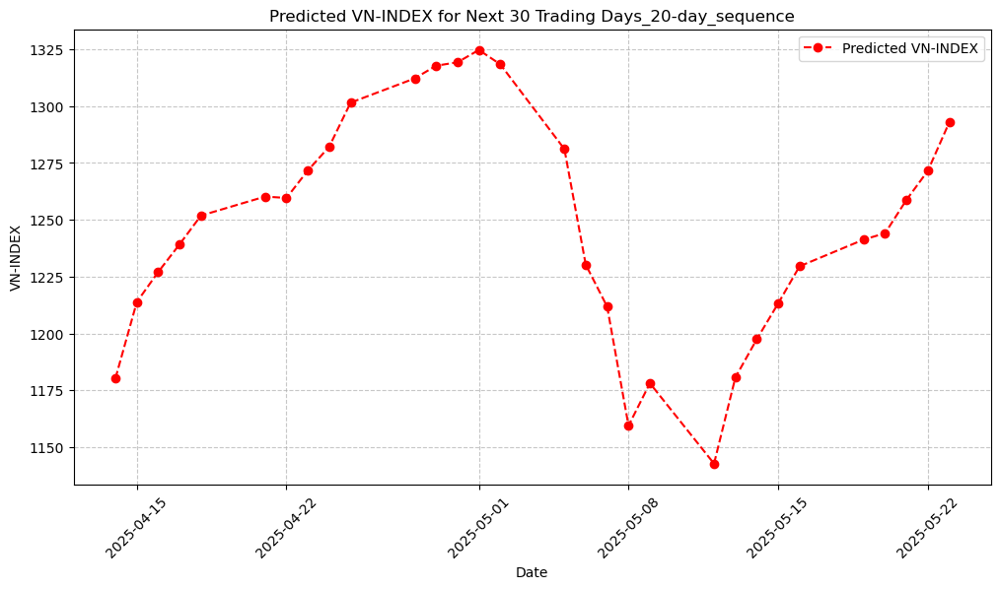

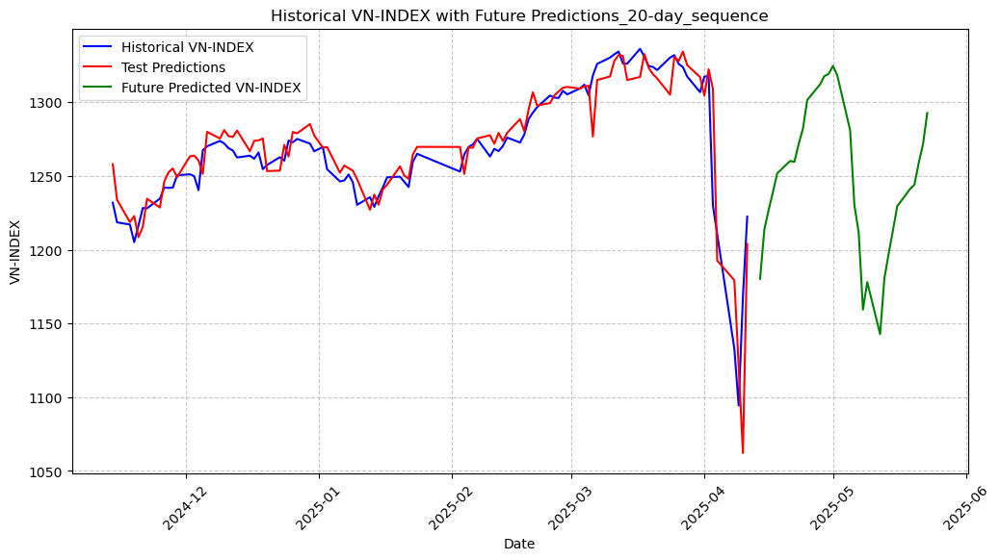

[I 2025-04-14 21:08:45,812] A new study created in memory with name: no-name-09857131-03c0-4ddf-93d9-62a42586f7bf


         Date  Predicted VN-INDEX
0  2025-04-14         1180.274592
1  2025-04-15         1213.839411
2  2025-04-16         1227.019199
3  2025-04-17         1239.204745
4  2025-04-18         1251.834386
5  2025-04-21         1260.202970
6  2025-04-22         1259.590548
7  2025-04-23         1271.679598
8  2025-04-24         1282.131619
9  2025-04-25         1301.520560
10 2025-04-28         1312.173587
11 2025-04-29         1317.750742
12 2025-04-30         1319.248578
13 2025-05-01         1324.678986
14 2025-05-02         1318.373800
15 2025-05-05         1281.112252
16 2025-05-06         1230.220965
17 2025-05-07         1211.794974
18 2025-05-08         1159.434675
19 2025-05-09         1178.103754
20 2025-05-12         1142.751150
21 2025-05-13         1180.715449
22 2025-05-14         1197.472964
23 2025-05-15         1213.207875
24 2025-05-16         1229.544726
25 2025-05-19         1241.296660
26 2025-05-20         1244.081461
27 2025-05-21         1258.750606
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4642328565903074 and num_layers=1
  warnings.warn(
[I 2025-04-14 21:09:33,937] Trial 0 finished with value: 0.0004499978209032918 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.4642328565903074, 'learning_rate': 0.0019098276260490039, 'batch_size': 32}. Best is trial 0 with value: 0.0004499978209032918.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3791338998061455 and num_layers=1
  warnings.warn(
[I 2025-04-14 21:11:51,988] Trial 1 finished with value: 0.0005372274971506385 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.3791338998061455, 'learning_rate'

Best Hyperparameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.4642328565903074, 'learning_rate': 0.0019098276260490039, 'batch_size': 32}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0003
RMSE: 23.7698, MAE: 18.0642, R²: 0.8693, Directional Accuracy: 0.5036


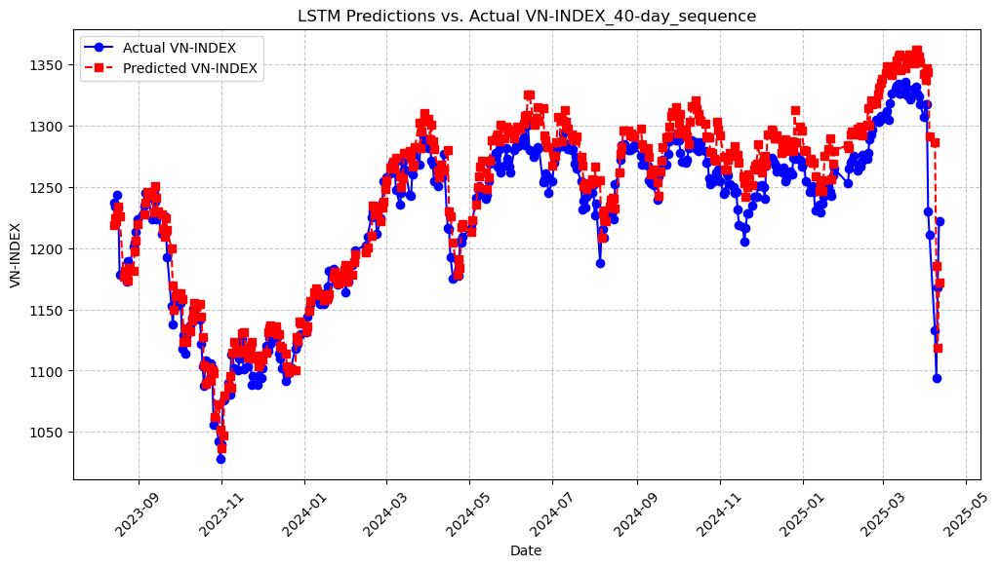

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-08-14      1236.839992         1218.872123
1   2023-08-15      1234.050027         1224.648126
2   2023-08-16      1243.260017         1226.499573
3   2023-08-17      1233.479995         1234.322018
4   2023-08-18      1177.989995         1226.199990
..         ...              ...                 ...
409 2025-04-04      1210.670016         1291.280413
410 2025-04-08      1132.790007         1286.438303
411 2025-04-09      1094.299993         1185.679951
412 2025-04-10      1168.339995         1118.287570
413 2025-04-11      1222.460024         1172.036878

[414 rows x 3 columns]


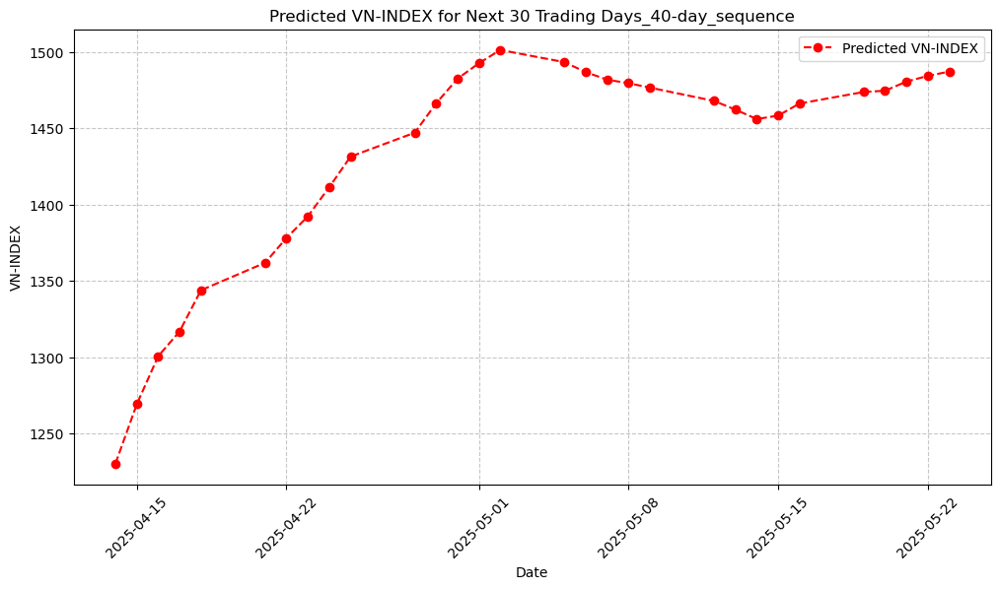

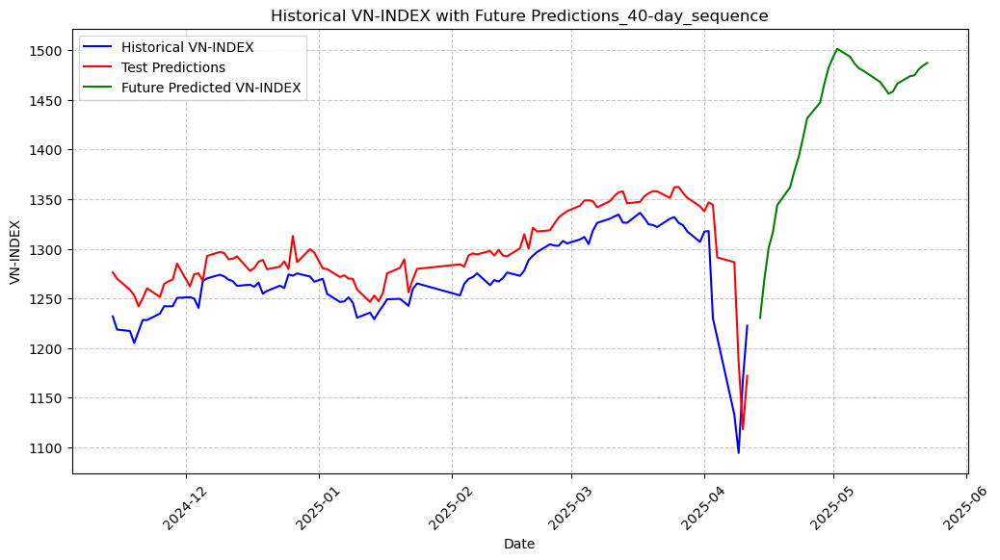

[I 2025-04-14 21:22:37,974] A new study created in memory with name: no-name-106b1e7e-6a47-40ea-af8b-8ba1b9a3d71e


         Date  Predicted VN-INDEX
0  2025-04-14         1230.197766
1  2025-04-15         1269.208408
2  2025-04-16         1300.622428
3  2025-04-17         1316.849990
4  2025-04-18         1343.877094
5  2025-04-21         1361.884193
6  2025-04-22         1378.159386
7  2025-04-23         1392.316613
8  2025-04-24         1411.427629
9  2025-04-25         1431.508685
10 2025-04-28         1447.166291
11 2025-04-29         1466.379814
12 2025-04-30         1482.556276
13 2025-05-01         1492.662239
14 2025-05-02         1501.403548
15 2025-05-05         1493.417863
16 2025-05-06         1486.862652
17 2025-05-07         1481.915491
18 2025-05-08         1479.603919
19 2025-05-09         1476.707593
20 2025-05-12         1467.984551
21 2025-05-13         1462.280842
22 2025-05-14         1456.097585
23 2025-05-15         1458.383647
24 2025-05-16         1466.306055
25 2025-05-19         1473.852270
26 2025-05-20         1474.676335
27 2025-05-21         1480.696043
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.31612090780291563 and num_layers=1
  warnings.warn(
[I 2025-04-14 21:23:16,590] Trial 0 finished with value: 0.005631147114927444 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.31612090780291563, 'learning_rate': 0.00014806137114020156, 'batch_size': 128}. Best is trial 0 with value: 0.005631147114927444.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.14776448571479914 and num_layers=1
  warnings.warn(
[I 2025-04-14 21:24:29,495] Trial 1 finished with value: 0.0010515825041437666 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.14776448571479914, 'learning_ra

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.13355462126463863, 'learning_rate': 0.003942614361629, 'batch_size': 64}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0005
RMSE: 20.8153, MAE: 16.7137, R²: 0.9037, Directional Accuracy: 0.5064


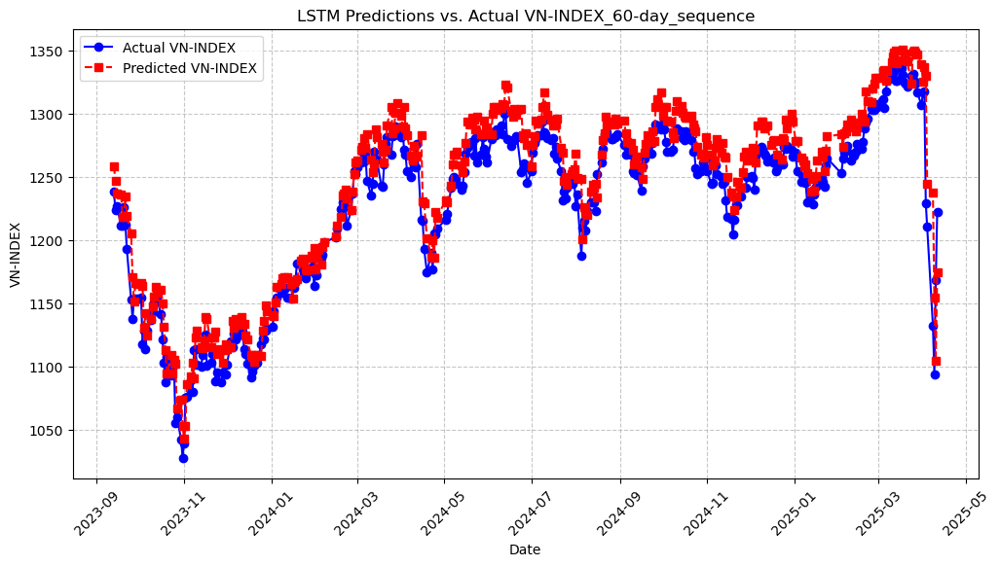

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-13      1238.390007         1258.658735
1   2023-09-14      1223.810034         1246.977863
2   2023-09-15      1227.360016         1237.275685
3   2023-09-18      1211.810003         1236.348420
4   2023-09-19      1211.500015         1218.849155
..         ...              ...                 ...
389 2025-04-04      1210.670016         1245.075856
390 2025-04-08      1132.790007         1238.209502
391 2025-04-09      1094.299993         1154.807830
392 2025-04-10      1168.339995         1105.077647
393 2025-04-11      1222.460024         1175.000026

[394 rows x 3 columns]


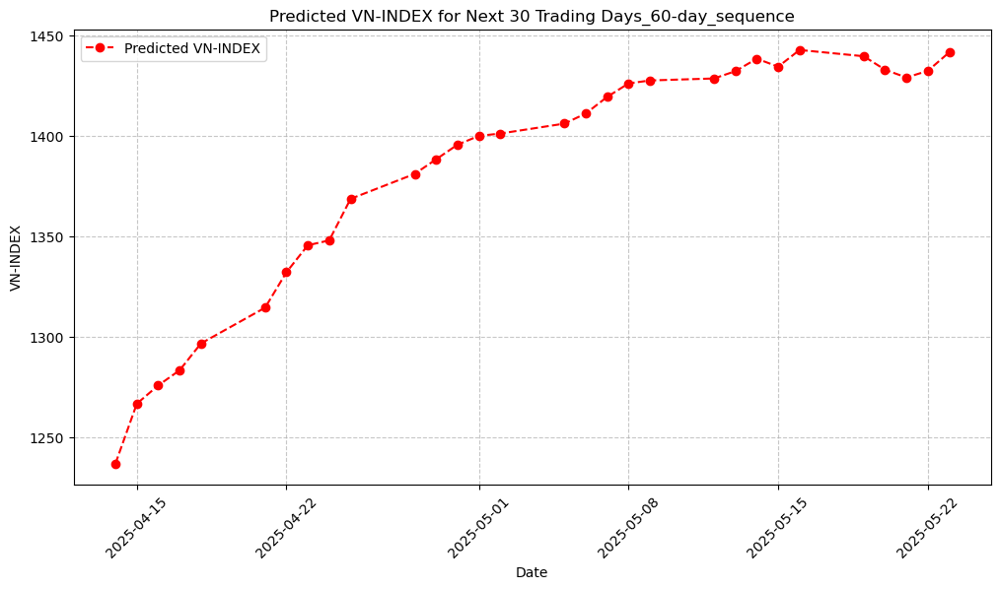

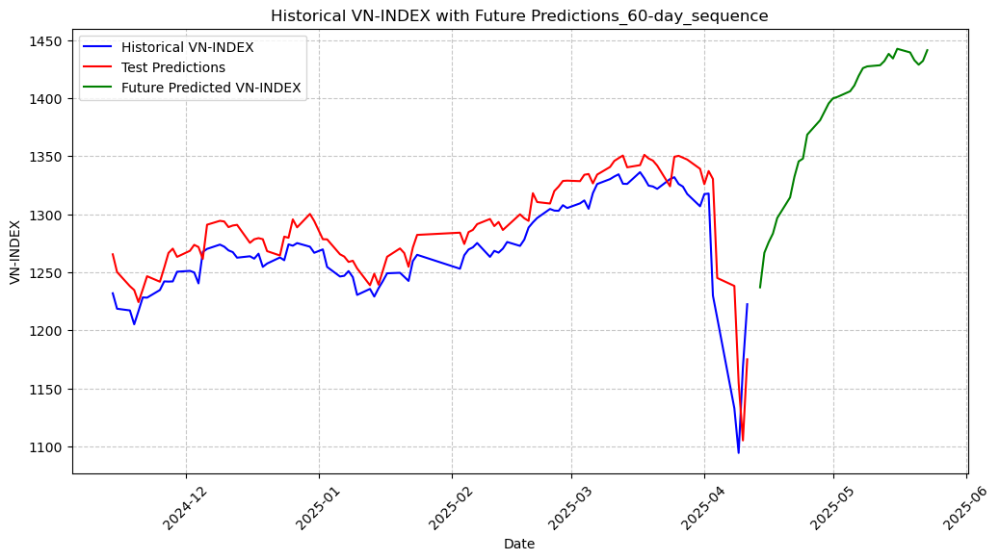

         Date  Predicted VN-INDEX
0  2025-04-14         1237.013869
1  2025-04-15         1266.790243
2  2025-04-16         1275.867821
3  2025-04-17         1283.391608
4  2025-04-18         1296.737026
5  2025-04-21         1314.509515
6  2025-04-22         1332.141269
7  2025-04-23         1345.538094
8  2025-04-24         1347.943773
9  2025-04-25         1368.592086
10 2025-04-28         1380.995055
11 2025-04-29         1388.237526
12 2025-04-30         1395.504120
13 2025-05-01         1399.861672
14 2025-05-02         1401.048288
15 2025-05-05         1405.978800
16 2025-05-06         1411.003342
17 2025-05-07         1419.241749
18 2025-05-08         1425.940547
19 2025-05-09         1427.417728
20 2025-05-12         1428.410043
21 2025-05-13         1432.044881
22 2025-05-14         1438.240932
23 2025-05-15         1434.260421
24 2025-05-16         1442.573513
25 2025-05-19         1439.461152
26 2025-05-20         1432.724819
27 2025-05-21         1428.891903
28 2025-05-22 

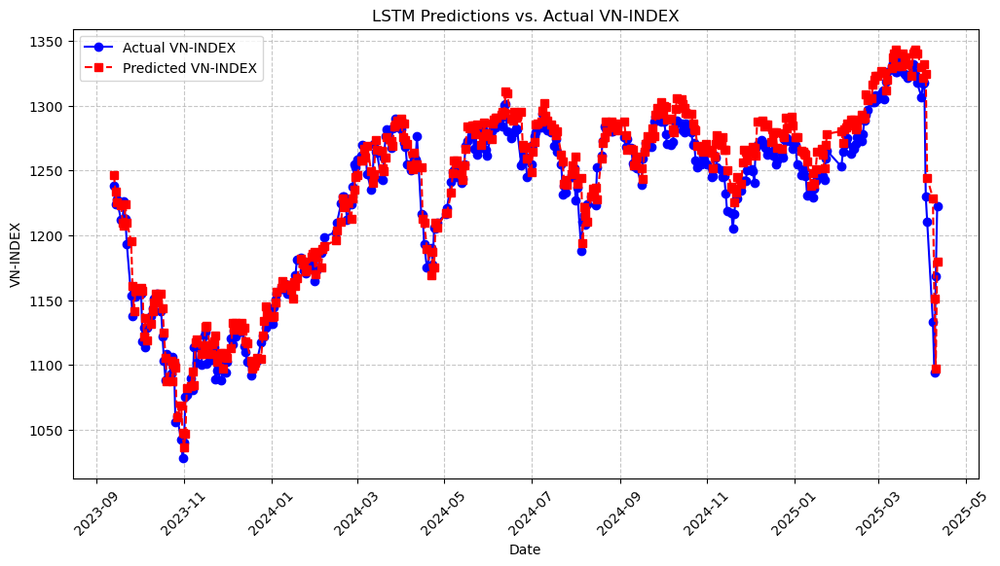

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-13      1238.390007         1246.678264
1   2023-09-14      1223.810034         1233.617496
2   2023-09-15      1227.360016         1225.095269
3   2023-09-18      1211.810003         1223.146640
4   2023-09-19      1211.500015         1209.734972
..         ...              ...                 ...
389 2025-04-04      1210.670016         1244.175909
390 2025-04-08      1132.790007         1228.700273
391 2025-04-09      1094.299993         1151.211801
392 2025-04-10      1168.339995         1097.296808
393 2025-04-11      1222.460024         1179.420732

[394 rows x 3 columns]


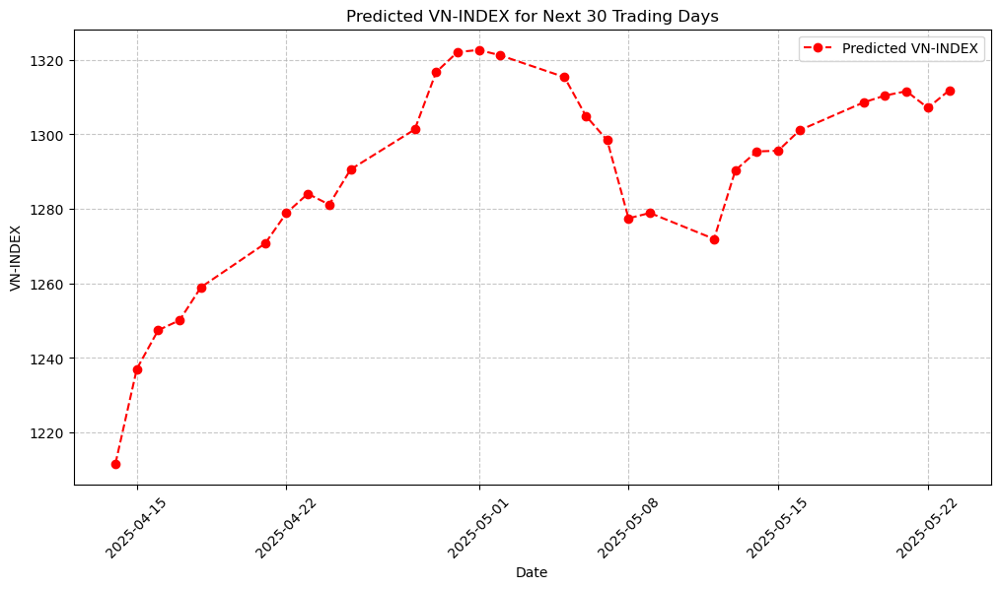

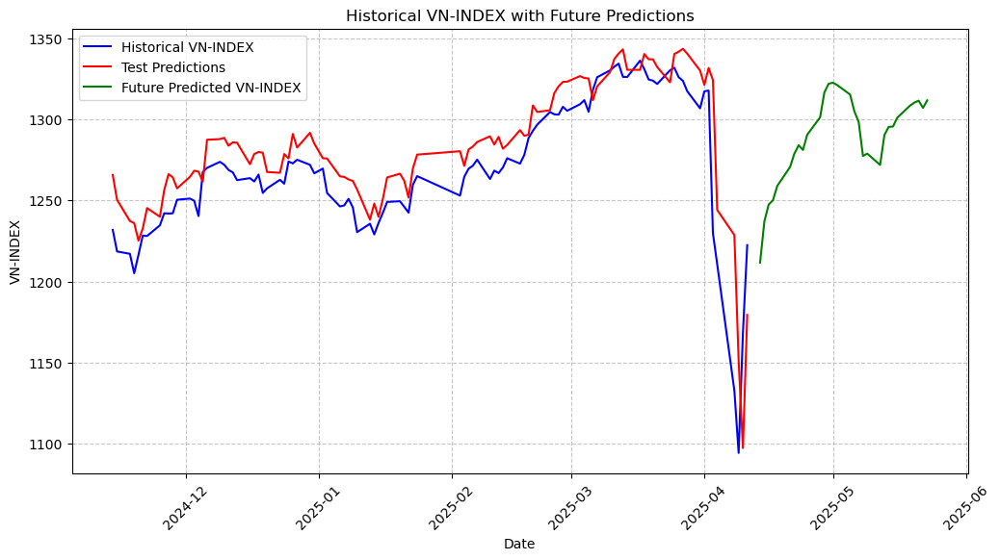


Ensemble Future Predictions (weighted average) for next 30 days:
         Date  Predicted Future VN-INDEX
0  2025-04-14                1211.671319
1  2025-04-15                1237.085170
2  2025-04-16                1247.471346
3  2025-04-17                1250.118841
4  2025-04-18                1258.981737
5  2025-04-21                1270.698372
6  2025-04-22                1278.914399
7  2025-04-23                1284.059627
8  2025-04-24                1281.158741
9  2025-04-25                1290.581496
10 2025-04-28                1301.303441
11 2025-04-29                1316.691368
12 2025-04-30                1322.059329
13 2025-05-01                1322.632782
14 2025-05-02                1321.198704
15 2025-05-05                1315.352118
16 2025-05-06                1304.975149
17 2025-05-07                1298.427862
18 2025-05-08                1277.470087
19 2025-05-09                1278.910746
20 2025-05-12                1271.944256
21 2025-05-13                129

In [16]:
data = df_3

ensemble_lstm_model(data)

[I 2025-04-14 21:36:05,695] A new study created in memory with name: no-name-e3f15c3b-5ff9-4ea8-949f-8241cb8007b1



Training LSTM with sequence length = 5


/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.14273216751426548 and num_layers=1
  warnings.warn(
[I 2025-04-14 21:36:12,610] Trial 0 finished with value: 0.0006354333331705674 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.14273216751426548, 'learning_rate': 0.0014722392253651631, 'batch_size': 128}. Best is trial 0 with value: 0.0006354333331705674.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.38670655360382256 and num_layers=1
  warnings.warn(
[I 2025-04-14 21:36:24,784] Trial 1 finished with value: 0.00025651715478198334 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.38670655360382256, 'learnin

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.38670655360382256, 'learning_rate': 0.002565972955495321, 'batch_size': 32}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0001
RMSE: 14.9792, MAE: 10.3818, R²: 0.9473, Directional Accuracy: 0.5090


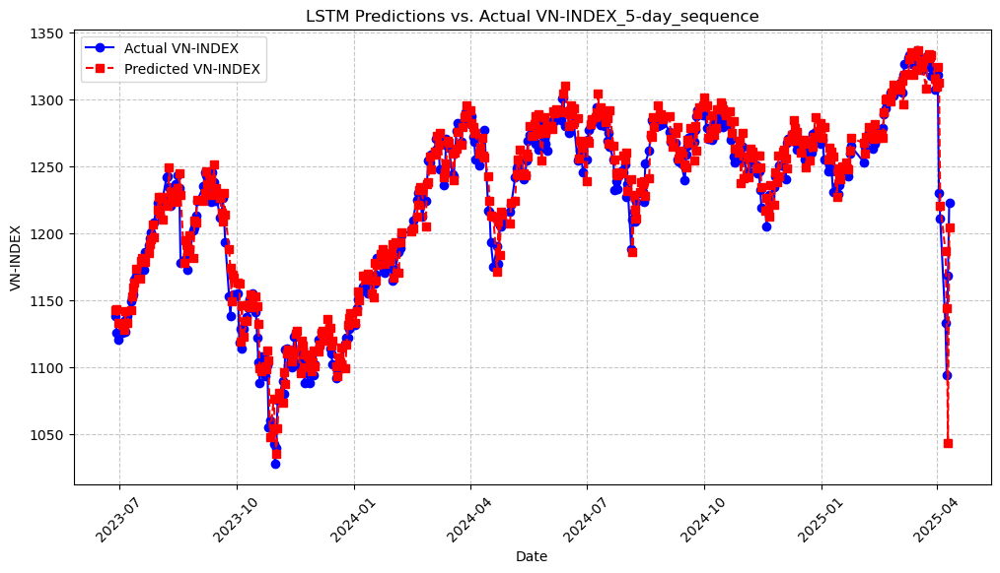

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-06-28      1138.349975         1142.912849
1   2023-06-29      1125.389999         1142.998092
2   2023-06-30      1120.180020         1133.224082
3   2023-07-03      1125.499982         1131.837462
4   2023-07-04      1132.000009         1132.208646
..         ...              ...                 ...
442 2025-04-04      1210.670016         1220.542371
443 2025-04-08      1132.790007         1186.675811
444 2025-04-09      1094.299993         1143.885741
445 2025-04-10      1168.339995         1043.259878
446 2025-04-11      1222.460024         1204.427028

[447 rows x 3 columns]


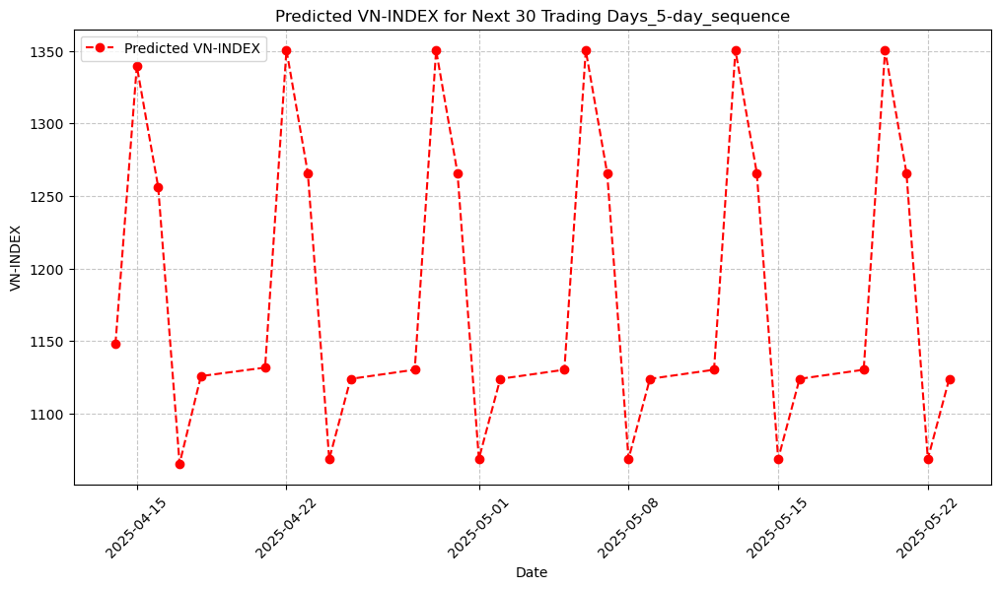

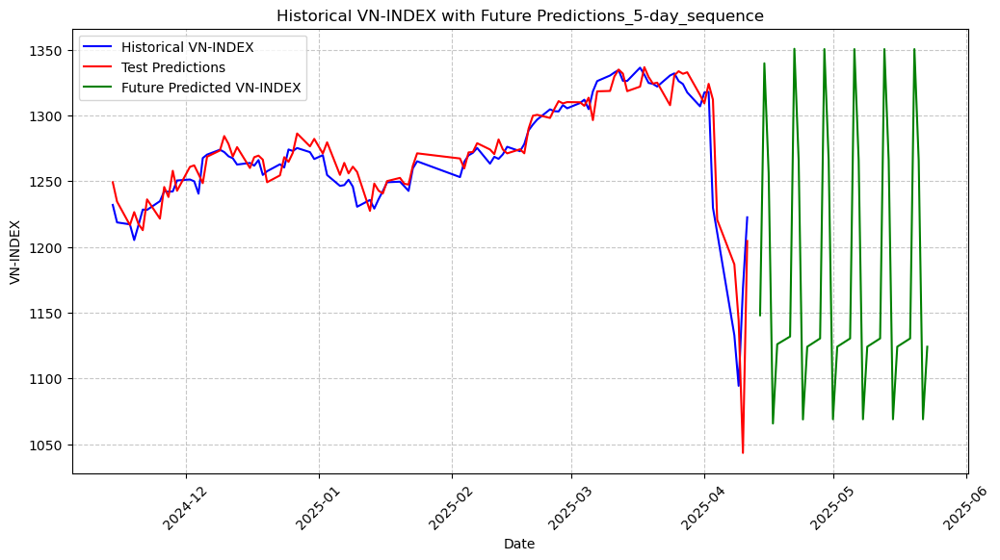

[I 2025-04-14 21:38:03,463] A new study created in memory with name: no-name-89d6776d-d2bc-4776-8128-adae653c0636


         Date  Predicted VN-INDEX
0  2025-04-14         1147.950108
1  2025-04-15         1339.578811
2  2025-04-16         1256.115481
3  2025-04-17         1065.619905
4  2025-04-18         1125.924655
5  2025-04-21         1131.797076
6  2025-04-22         1350.593773
7  2025-04-23         1265.688253
8  2025-04-24         1068.719395
9  2025-04-25         1124.001838
10 2025-04-28         1130.334462
11 2025-04-29         1350.372188
12 2025-04-30         1265.804865
13 2025-05-01         1068.872307
14 2025-05-02         1124.037369
15 2025-05-05         1130.316735
16 2025-05-06         1350.356542
17 2025-05-07         1265.799161
18 2025-05-08         1068.873232
19 2025-05-09         1124.039835
20 2025-05-12         1130.317737
21 2025-05-13         1350.356388
22 2025-05-14         1265.798853
23 2025-05-15         1068.873078
24 2025-05-16         1124.039835
25 2025-05-19         1130.317737
26 2025-05-20         1350.356311
27 2025-05-21         1265.798853
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3143438305653168 and num_layers=1
  warnings.warn(
[I 2025-04-14 21:38:15,212] Trial 0 finished with value: 0.0009989110973128844 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.3143438305653168, 'learning_rate': 0.0009353865662090991, 'batch_size': 128}. Best is trial 0 with value: 0.0009989110973128844.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.16001984141356487 and num_layers=1
  warnings.warn(
[I 2025-04-14 21:38:22,063] Trial 1 finished with value: 0.001566205770391207 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.16001984141356487, 'learning_rat

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.35261603566564403, 'learning_rate': 0.0016066126217169794, 'batch_size': 32}
Best Overall Average Training Loss: 0.0002
Final Evaluation Loss on Test Set: 0.0001
RMSE: 14.8884, MAE: 10.2067, R²: 0.9473, Directional Accuracy: 0.4875


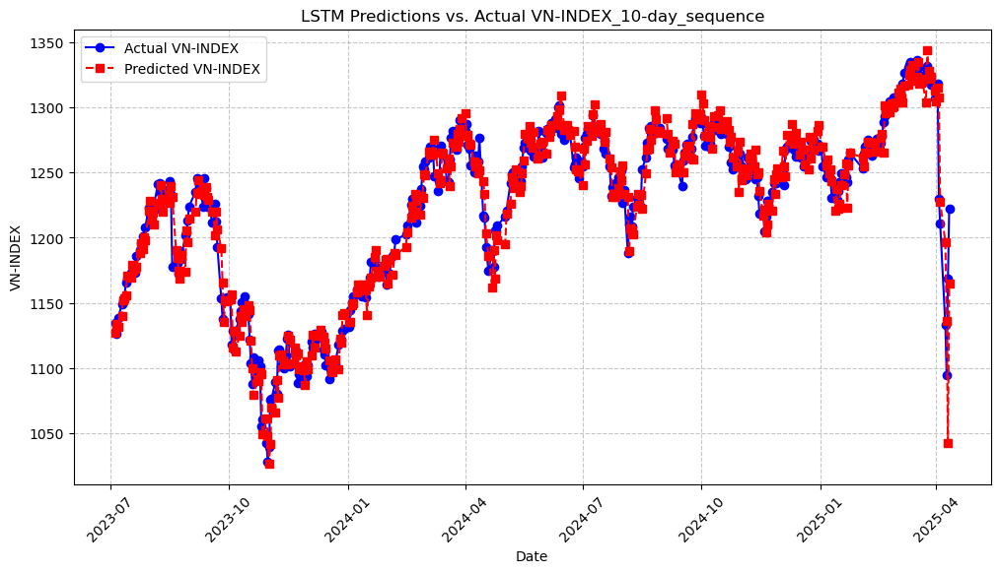

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-05      1134.620028         1127.036818
1   2023-07-06      1126.219998         1134.129536
2   2023-07-07      1138.069969         1131.419881
3   2023-07-10      1149.020035         1140.005656
4   2023-07-11      1151.769999         1152.375253
..         ...              ...                 ...
437 2025-04-04      1210.670016         1227.654203
438 2025-04-08      1132.790007         1196.306927
439 2025-04-09      1094.299993         1135.802482
440 2025-04-10      1168.339995         1042.573851
441 2025-04-11      1222.460024         1164.497522

[442 rows x 3 columns]


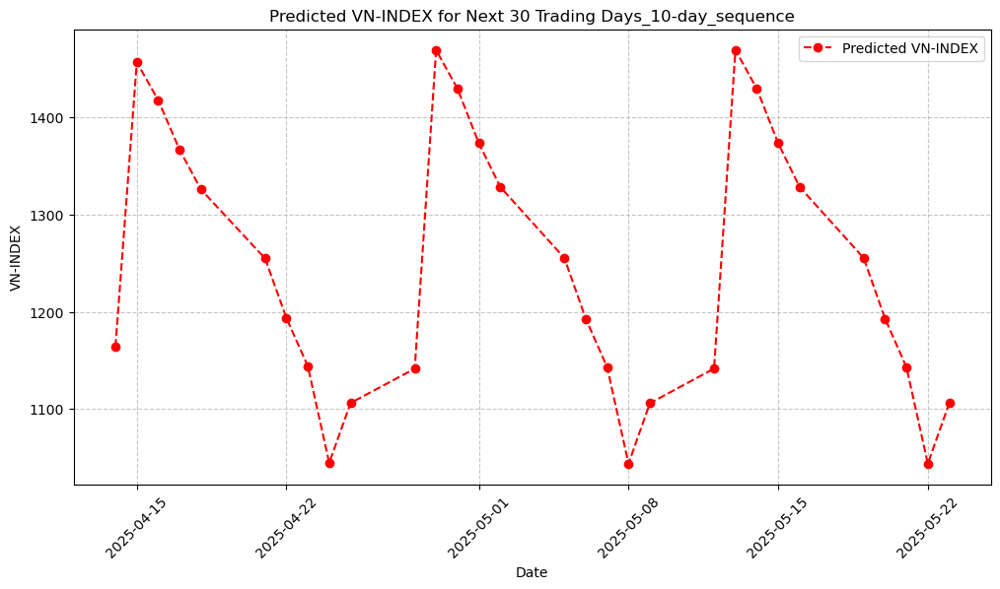

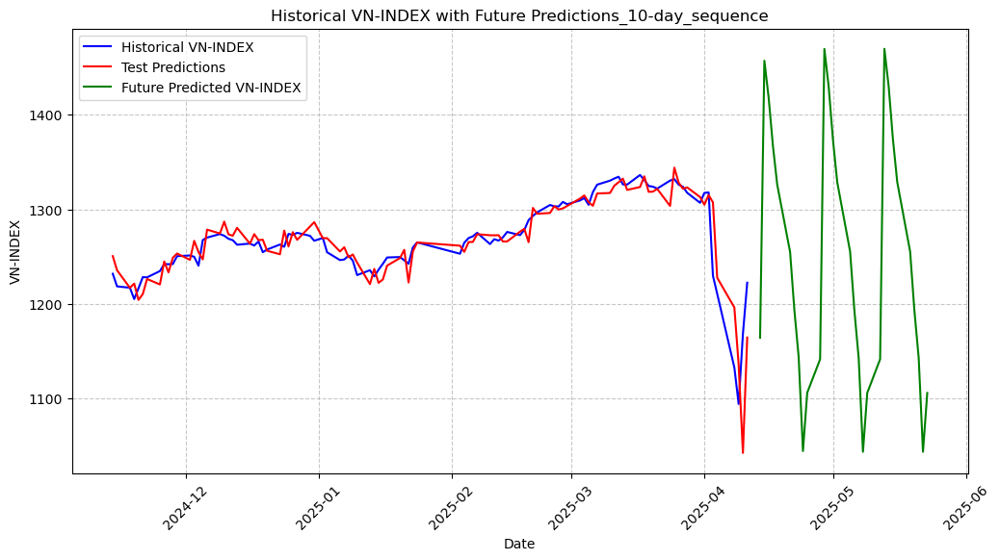

[I 2025-04-14 21:40:32,635] A new study created in memory with name: no-name-47f52697-92b5-4ea1-8e88-892c56d07af8


         Date  Predicted VN-INDEX
0  2025-04-14         1164.244723
1  2025-04-15         1456.977759
2  2025-04-16         1417.961876
3  2025-04-17         1366.905883
4  2025-04-18         1325.974043
5  2025-04-21         1254.959464
6  2025-04-22         1193.509795
7  2025-04-23         1143.994568
8  2025-04-24         1044.554858
9  2025-04-25         1106.207075
10 2025-04-28         1141.529929
11 2025-04-29         1469.468205
12 2025-04-30         1429.659550
13 2025-05-01         1373.523755
14 2025-05-02         1328.607704
15 2025-05-05         1255.405716
16 2025-05-06         1192.933906
17 2025-05-07         1142.965798
18 2025-05-08         1043.759080
19 2025-05-09         1105.956125
20 2025-05-12         1141.597136
21 2025-05-13         1469.589441
22 2025-05-14         1429.721825
23 2025-05-15         1373.545258
24 2025-05-16         1328.608089
25 2025-05-19         1255.398471
26 2025-05-20         1192.925659
27 2025-05-21         1142.959324
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3812058322751711 and num_layers=1
  warnings.warn(
[I 2025-04-14 21:41:00,142] Trial 0 finished with value: 0.0007663548799155251 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.3812058322751711, 'learning_rate': 0.0006555791841062752, 'batch_size': 64}. Best is trial 0 with value: 0.0007663548799155251.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4089381177909066 and num_layers=1
  warnings.warn(
[I 2025-04-14 21:41:27,700] Trial 1 finished with value: 0.0011028524781545458 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.4089381177909066, 'learning_rate

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.49170335585782565, 'learning_rate': 0.005546862201253932, 'batch_size': 32}
Best Overall Average Training Loss: 0.0002
Final Evaluation Loss on Test Set: 0.0008
RMSE: 36.2107, MAE: 33.4834, R²: 0.6858, Directional Accuracy: 0.5383


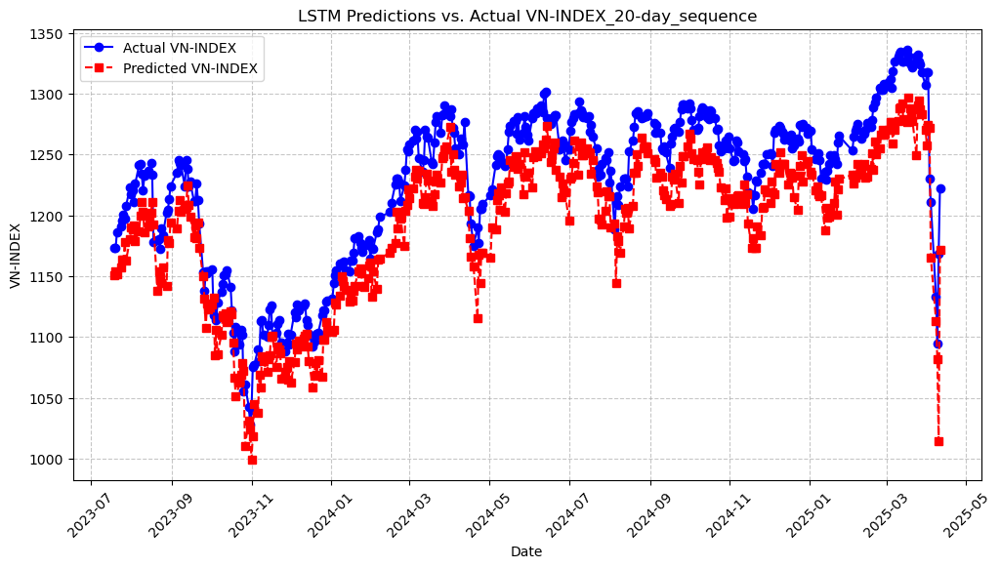

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-19      1172.980020         1151.048750
1   2023-07-20      1172.809997         1154.209281
2   2023-07-21      1185.899994         1151.558896
3   2023-07-24      1190.719984         1156.799242
4   2023-07-25      1195.899982         1163.312525
..         ...              ...                 ...
427 2025-04-04      1210.670016         1165.349410
428 2025-04-08      1132.790007         1113.243760
429 2025-04-09      1094.299993         1081.873363
430 2025-04-10      1168.339995         1014.373311
431 2025-04-11      1222.460024         1171.982541

[432 rows x 3 columns]


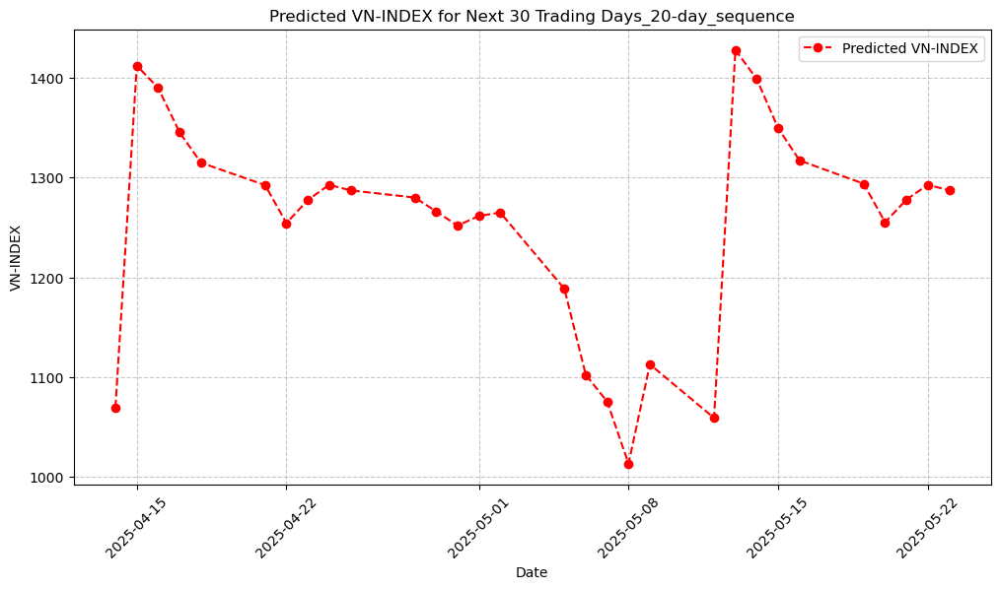

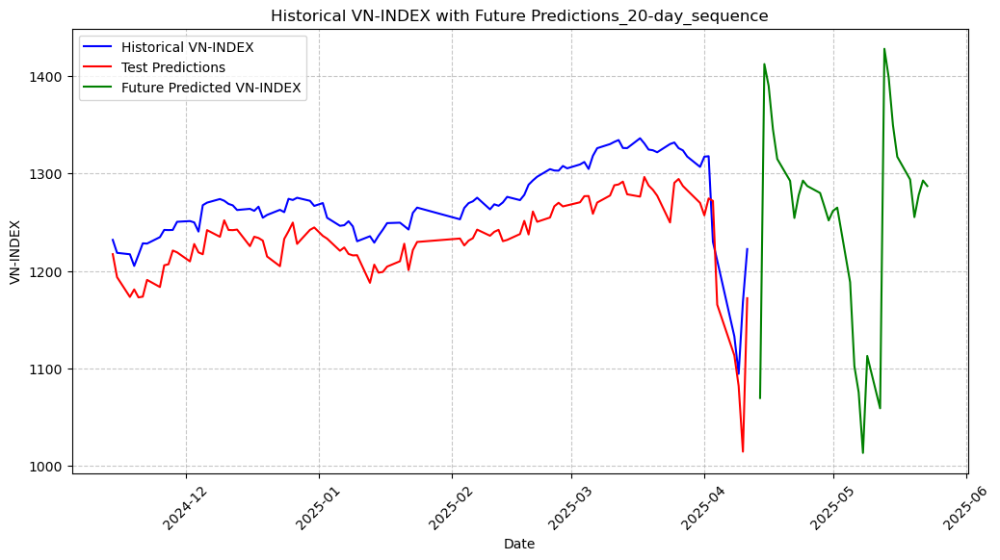

[I 2025-04-14 21:48:30,981] A new study created in memory with name: no-name-9c916961-688d-4449-b3cc-017694ae9222


         Date  Predicted VN-INDEX
0  2025-04-14         1069.523651
1  2025-04-15         1412.461640
2  2025-04-16         1389.953555
3  2025-04-17         1345.482755
4  2025-04-18         1315.032994
5  2025-04-21         1292.526452
6  2025-04-22         1254.386966
7  2025-04-23         1277.628862
8  2025-04-24         1292.798519
9  2025-04-25         1287.238629
10 2025-04-28         1280.059435
11 2025-04-29         1266.217051
12 2025-04-30         1251.870610
13 2025-05-01         1261.591054
14 2025-05-02         1265.022574
15 2025-05-05         1188.462979
16 2025-05-06         1102.191495
17 2025-05-07         1075.324164
18 2025-05-08         1013.072319
19 2025-05-09         1112.676349
20 2025-05-12         1058.927196
21 2025-05-13         1428.139285
22 2025-05-14         1398.808932
23 2025-05-15         1349.608857
24 2025-05-16         1317.297167
25 2025-05-19         1293.927947
26 2025-05-20         1255.291109
27 2025-05-21         1277.970449
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.17094420607761537 and num_layers=1
  warnings.warn(
[I 2025-04-14 21:50:40,271] Trial 0 finished with value: 0.00030361467103887205 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.17094420607761537, 'learning_rate': 0.001647313849026902, 'batch_size': 64}. Best is trial 0 with value: 0.00030361467103887205.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4223924858128628 and num_layers=1
  warnings.warn(
[I 2025-04-14 21:51:28,575] Trial 1 finished with value: 0.0022005859839691767 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.4223924858128628, 'learning_r

Best Hyperparameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.3785375122700354, 'learning_rate': 0.0021087308812356795, 'batch_size': 32}
Best Overall Average Training Loss: 0.0002
Final Evaluation Loss on Test Set: 0.0002
RMSE: 17.2630, MAE: 12.4706, R²: 0.9314, Directional Accuracy: 0.5036


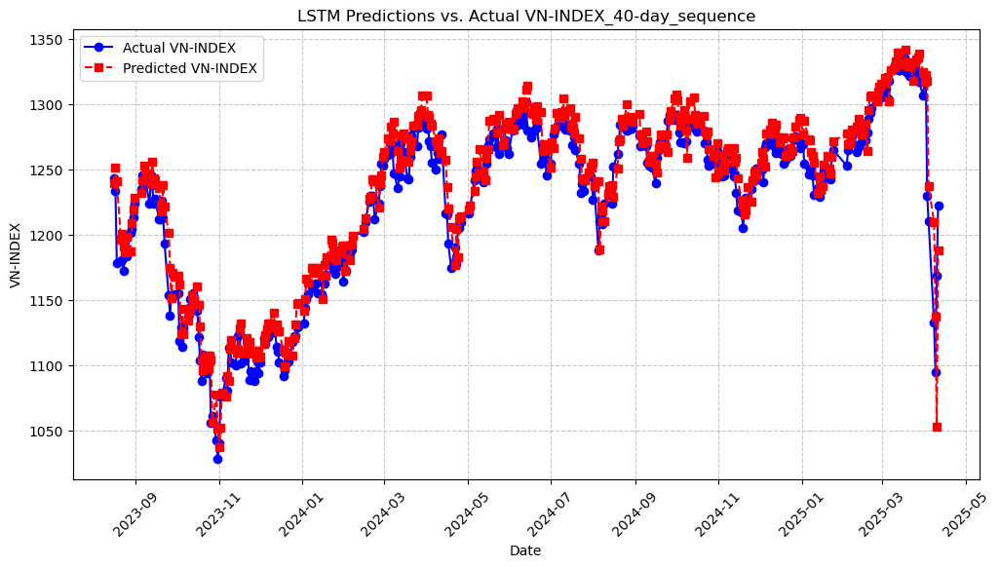

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-08-16      1243.260017         1239.670959
1   2023-08-17      1233.479995         1251.143272
2   2023-08-18      1177.989995         1240.853413
3   2023-08-21      1179.759976         1196.460765
4   2023-08-22      1180.490011         1200.708719
..         ...              ...                 ...
407 2025-04-04      1210.670016         1237.133255
408 2025-04-08      1132.790007         1209.601554
409 2025-04-09      1094.299993         1137.302476
410 2025-04-10      1168.339995         1052.578926
411 2025-04-11      1222.460024         1187.800537

[412 rows x 3 columns]


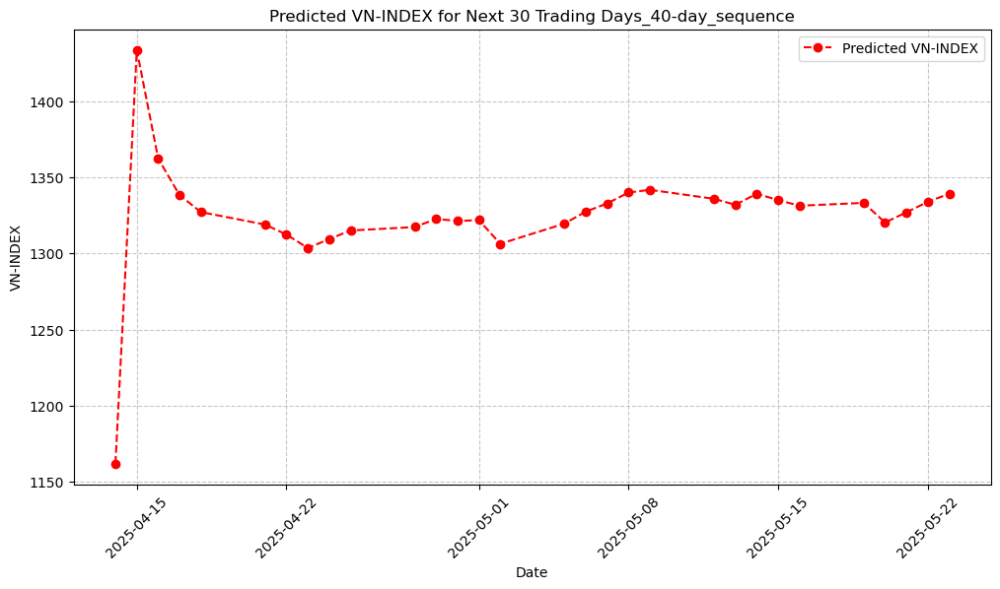

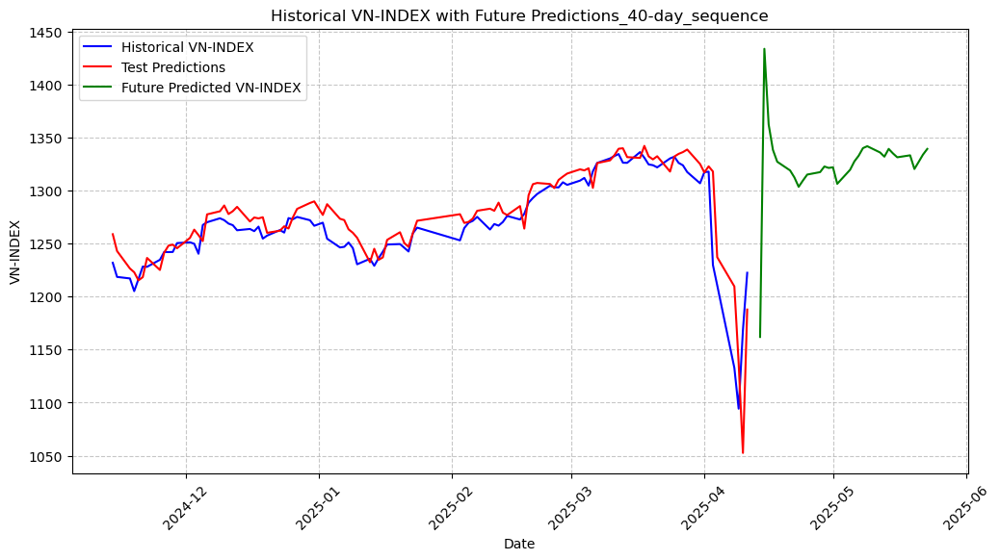

[I 2025-04-14 22:02:33,279] A new study created in memory with name: no-name-491fa287-58a0-4633-b8fe-35ba72abcd6f


         Date  Predicted VN-INDEX
0  2025-04-14         1161.961975
1  2025-04-15         1433.674281
2  2025-04-16         1362.327671
3  2025-04-17         1338.320209
4  2025-04-18         1327.178231
5  2025-04-21         1318.981520
6  2025-04-22         1312.421839
7  2025-04-23         1303.532165
8  2025-04-24         1309.485127
9  2025-04-25         1315.084402
10 2025-04-28         1317.380021
11 2025-04-29         1322.695127
12 2025-04-30         1321.354289
13 2025-05-01         1321.905977
14 2025-05-02         1306.360897
15 2025-05-05         1319.600879
16 2025-05-06         1327.503171
17 2025-05-07         1332.859743
18 2025-05-08         1340.017510
19 2025-05-09         1341.820556
20 2025-05-12         1335.896804
21 2025-05-13         1331.957835
22 2025-05-14         1339.279151
23 2025-05-15         1335.026573
24 2025-05-16         1331.366994
25 2025-05-19         1333.235243
26 2025-05-20         1320.334690
27 2025-05-21         1327.064163
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3594155398390353 and num_layers=1
  warnings.warn(
[I 2025-04-14 22:03:49,127] Trial 0 finished with value: 0.0006890002365321379 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.3594155398390353, 'learning_rate': 0.0012124503115944682, 'batch_size': 128}. Best is trial 0 with value: 0.0006890002365321379.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.42500299774180406 and num_layers=1
  warnings.warn(
[I 2025-04-14 22:04:59,674] Trial 1 finished with value: 0.00023676295695189255 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.42500299774180406, 'learning_r

Best Hyperparameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.2727062128521106, 'learning_rate': 0.001602345189496211, 'batch_size': 32}
Best Overall Average Training Loss: 0.0002
Final Evaluation Loss on Test Set: 0.0003
RMSE: 18.3591, MAE: 14.1765, R²: 0.9255, Directional Accuracy: 0.5115


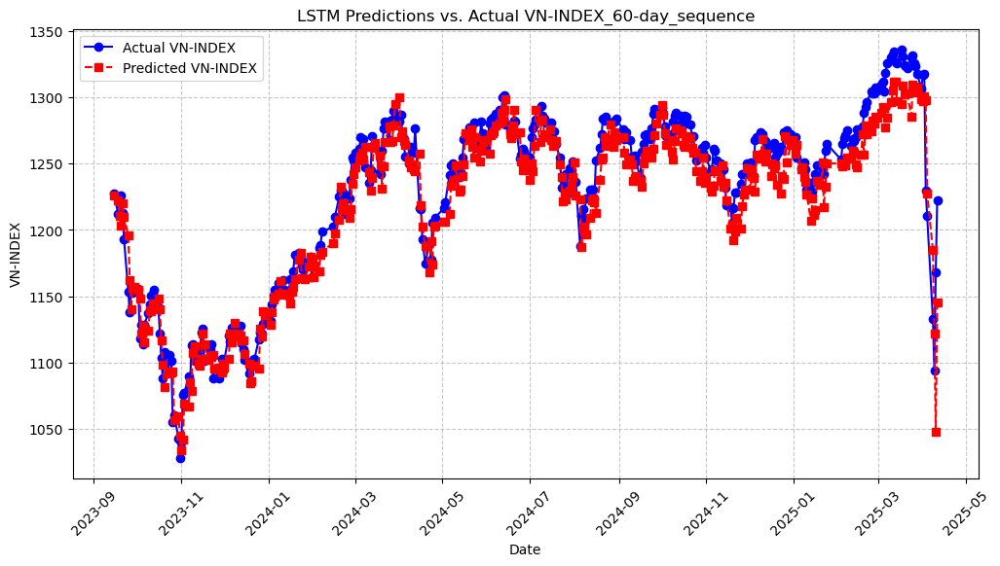

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-15      1227.360016         1225.908115
1   2023-09-18      1211.810003         1222.145720
2   2023-09-19      1211.500015         1210.333516
3   2023-09-20      1226.109969         1203.346773
4   2023-09-21      1212.739965         1219.865593
..         ...              ...                 ...
387 2025-04-04      1210.670016         1227.649116
388 2025-04-08      1132.790007         1184.748601
389 2025-04-09      1094.299993         1121.640168
390 2025-04-10      1168.339995         1047.555463
391 2025-04-11      1222.460024         1145.168775

[392 rows x 3 columns]


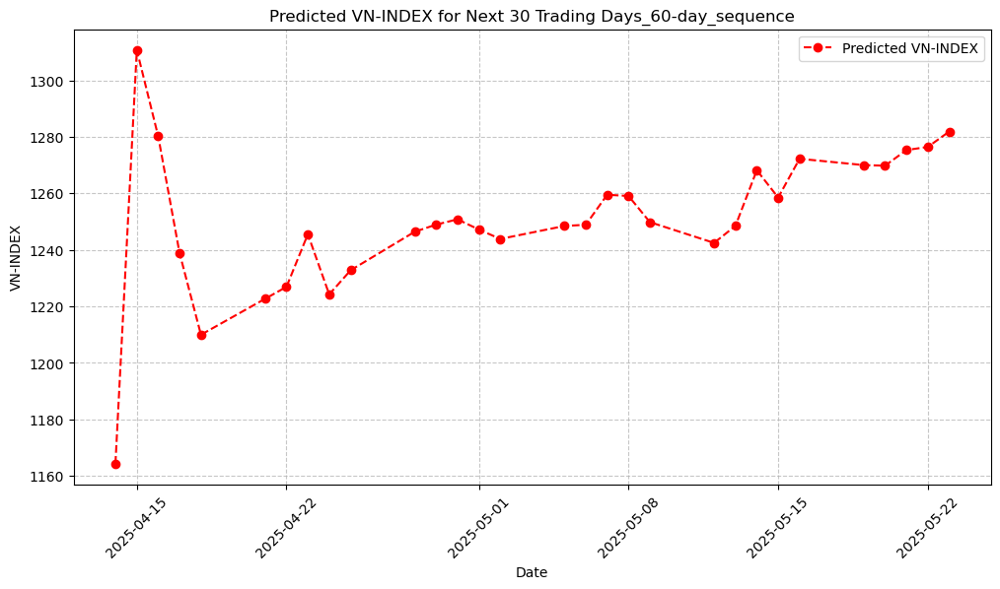

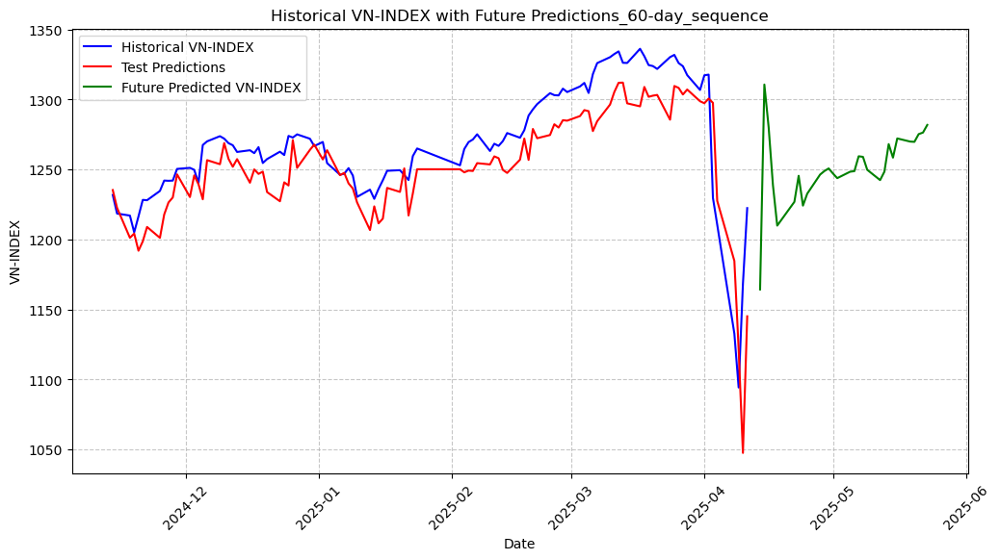

         Date  Predicted VN-INDEX
0  2025-04-14         1164.345072
1  2025-04-15         1310.737024
2  2025-04-16         1280.202405
3  2025-04-17         1238.847974
4  2025-04-18         1209.954933
5  2025-04-21         1222.682071
6  2025-04-22         1226.903204
7  2025-04-23         1245.533670
8  2025-04-24         1224.233781
9  2025-04-25         1232.768689
10 2025-04-28         1246.413149
11 2025-04-29         1248.923108
12 2025-04-30         1250.803072
13 2025-05-01         1247.188658
14 2025-05-02         1243.860184
15 2025-05-05         1248.451113
16 2025-05-06         1248.873781
17 2025-05-07         1259.491971
18 2025-05-08         1259.064756
19 2025-05-09         1249.807366
20 2025-05-12         1242.461618
21 2025-05-13         1248.477780
22 2025-05-14         1268.179329
23 2025-05-15         1258.510986
24 2025-05-16         1272.230747
25 2025-05-19         1269.994629
26 2025-05-20         1269.792312
27 2025-05-21         1275.324842
28 2025-05-22 

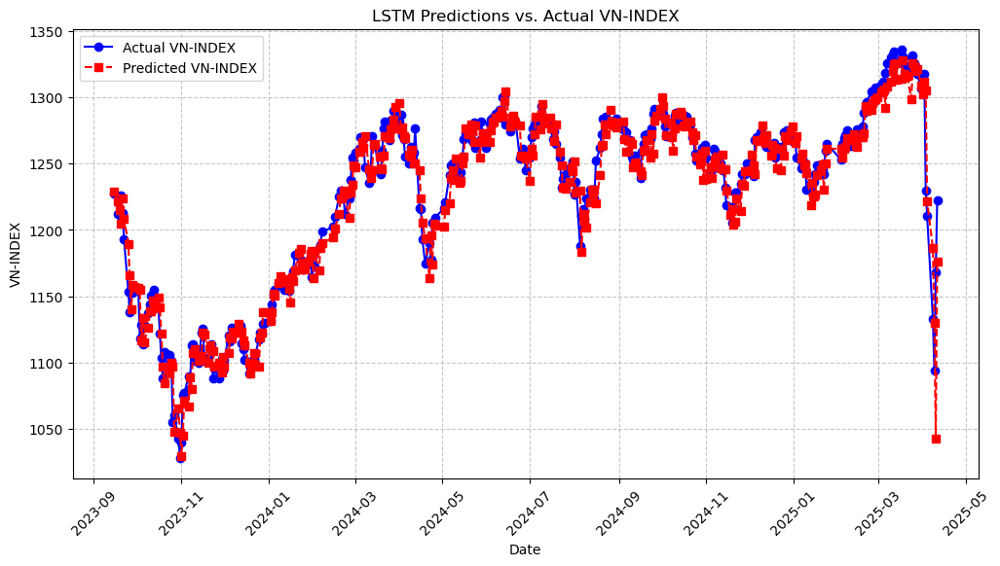

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-15      1227.360016         1229.150462
1   2023-09-18      1211.810003         1221.471896
2   2023-09-19      1211.500015         1214.844839
3   2023-09-20      1226.109969         1205.101055
4   2023-09-21      1212.739965         1223.606713
..         ...              ...                 ...
387 2025-04-04      1210.670016         1221.643430
388 2025-04-08      1132.790007         1186.099152
389 2025-04-09      1094.299993         1129.836893
390 2025-04-10      1168.339995         1043.004313
391 2025-04-11      1222.460024         1176.067418

[392 rows x 3 columns]


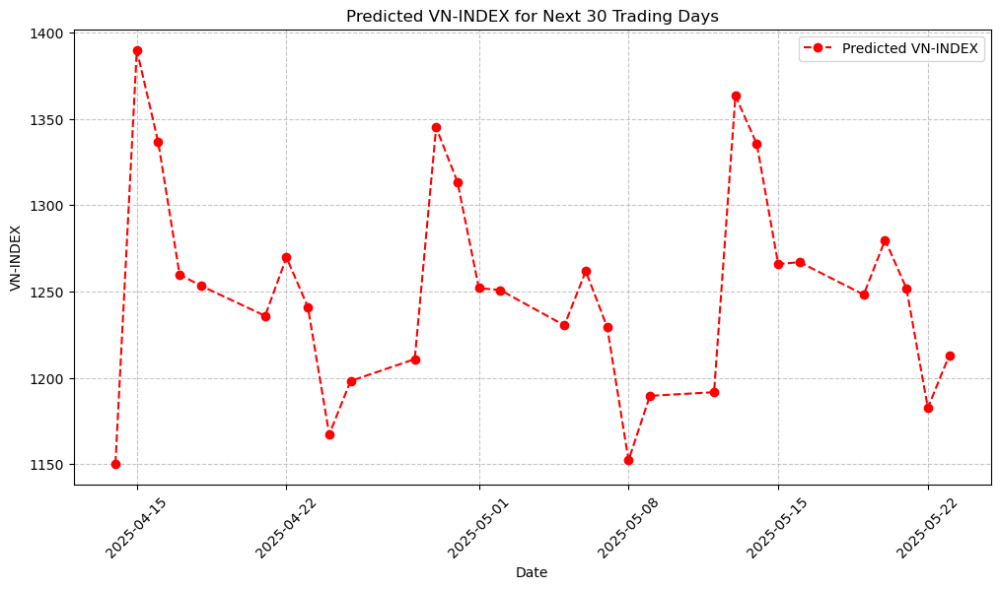

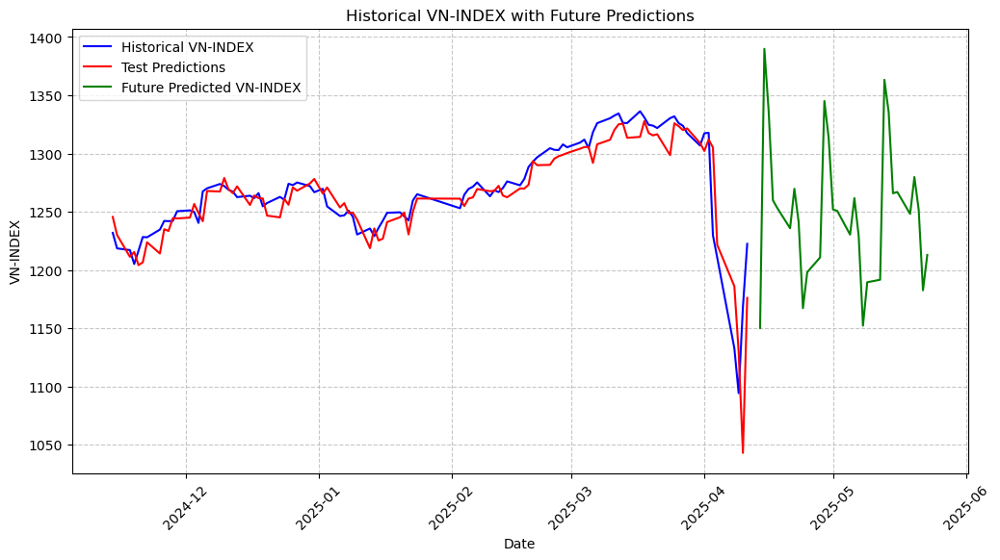


Ensemble Future Predictions (weighted average) for next 30 days:
         Date  Predicted Future VN-INDEX
0  2025-04-14                1150.261937
1  2025-04-15                1389.873868
2  2025-04-16                1336.539921
3  2025-04-17                1259.814942
4  2025-04-18                1253.304506
5  2025-04-21                1235.852126
6  2025-04-22                1269.713766
7  2025-04-23                1241.049298
8  2025-04-24                1167.219222
9  2025-04-25                1198.128583
10 2025-04-28                1210.807292
11 2025-04-29                1345.064765
12 2025-04-30                1313.338976
13 2025-05-01                1251.960348
14 2025-05-02                1250.788205
15 2025-05-05                1230.364758
16 2025-05-06                1261.729342
17 2025-05-07                1229.406480
18 2025-05-08                1152.244018
19 2025-05-09                1189.519976
20 2025-05-12                1191.656842
21 2025-05-13                136

In [17]:
data = lag_features_indicators(df_3, ['VN_Index_Close'])

ensemble_lstm_model(data)

/var/folders/fl/t1q3j3rn0dg278fhg2bvg0dw0000gn/T/ipykernel_31202/3744217377.py:40: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  copy_df[f'{col}_Lag{lag}'] = copy_df[col].shift(lag)
/var/folders/fl/t1q3j3rn0dg278fhg2bvg0dw0000gn/T/ipykernel_31202/3744217377.py:40: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  copy_df[f'{col}_Lag{lag}'] = copy_df[col].shift(lag)
/var/folders/fl/t1q3j3rn0dg278fhg2bvg0dw0000gn/T/ipykernel_31202/3744217377.py:40: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of call


Training LSTM with sequence length = 5


/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3947032819914179 and num_layers=1
  warnings.warn(
[I 2025-04-14 22:23:20,219] Trial 0 finished with value: 0.008975867816516256 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.3947032819914179, 'learning_rate': 0.004247570043276168, 'batch_size': 128}. Best is trial 0 with value: 0.008975867816516256.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3019607412144473 and num_layers=1
  warnings.warn(
[I 2025-04-14 22:23:44,739] Trial 1 finished with value: 0.0005948238977286983 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.3019607412144473, 'learning_rate':

Best Hyperparameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.29287868631540115, 'learning_rate': 0.0014321413235374772, 'batch_size': 64}
Best Overall Average Training Loss: 0.0006
Final Evaluation Loss on Test Set: 0.0037
RMSE: 77.3765, MAE: 63.5301, R²: -0.4273, Directional Accuracy: 0.5227


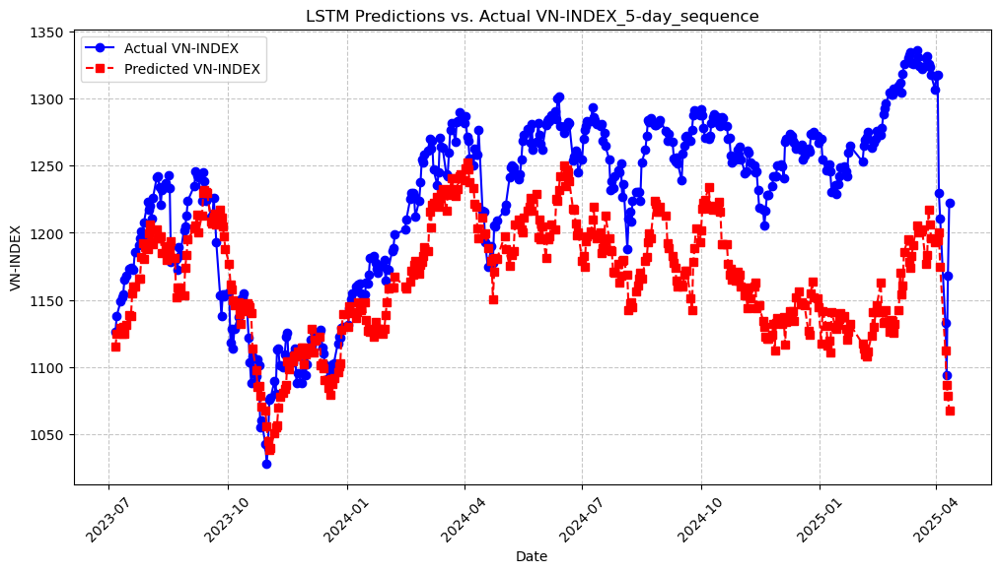

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-06      1126.219998         1115.089350
1   2023-07-07      1138.069969         1124.445162
2   2023-07-10      1149.020035         1129.366194
3   2023-07-11      1151.769999         1124.831220
4   2023-07-12      1154.200033         1129.897921
..         ...              ...                 ...
436 2025-04-04      1210.670016         1174.554467
437 2025-04-08      1132.790007         1112.550027
438 2025-04-09      1094.299993         1086.906459
439 2025-04-10      1168.339995         1078.318988
440 2025-04-11      1222.460024         1067.613706

[441 rows x 3 columns]


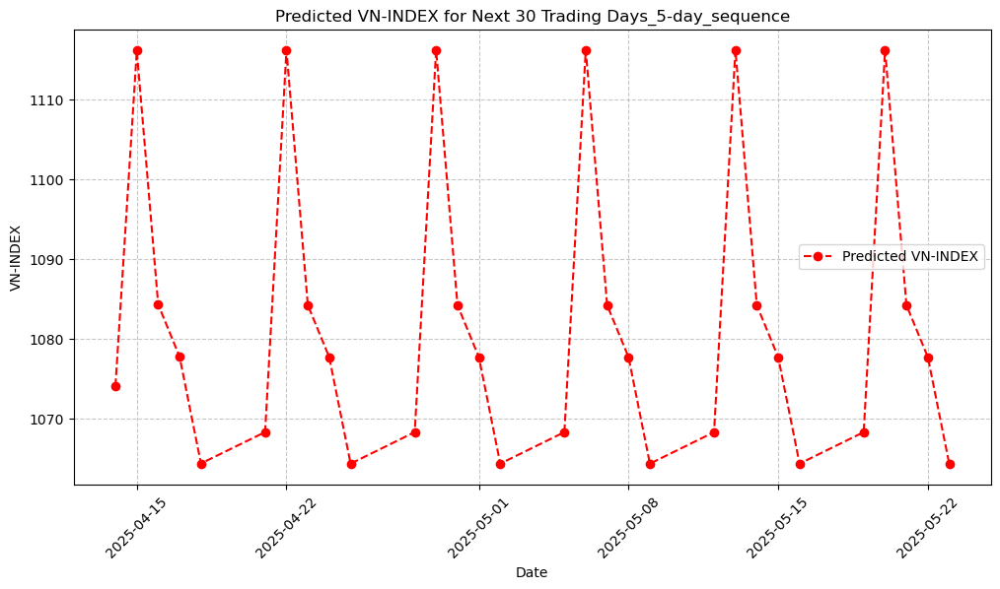

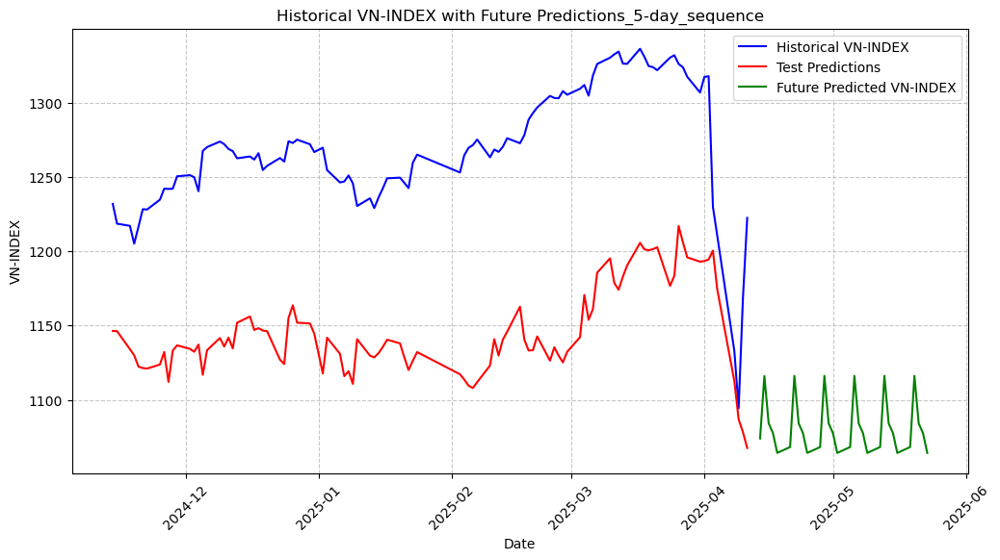

[I 2025-04-14 22:25:43,106] A new study created in memory with name: no-name-ab2b48dc-fdac-412c-89bd-32d82dc69b7f


         Date  Predicted VN-INDEX
0  2025-04-14         1074.037276
1  2025-04-15         1116.073572
2  2025-04-16         1084.253685
3  2025-04-17         1077.714582
4  2025-04-18         1064.323614
5  2025-04-21         1068.251099
6  2025-04-22         1116.168218
7  2025-04-23         1084.170292
8  2025-04-24         1077.657086
9  2025-04-25         1064.300107
10 2025-04-28         1068.249712
11 2025-04-29         1116.168140
12 2025-04-30         1084.170215
13 2025-05-01         1077.657086
14 2025-05-02         1064.300107
15 2025-05-05         1068.249712
16 2025-05-06         1116.168140
17 2025-05-07         1084.170215
18 2025-05-08         1077.657086
19 2025-05-09         1064.300107
20 2025-05-12         1068.249712
21 2025-05-13         1116.168140
22 2025-05-14         1084.170215
23 2025-05-15         1077.657086
24 2025-05-16         1064.300107
25 2025-05-19         1068.249712
26 2025-05-20         1116.168140
27 2025-05-21         1084.170215
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4818638992656413 and num_layers=1
  warnings.warn(
[I 2025-04-14 22:26:04,058] Trial 0 finished with value: 0.0005176435824424039 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.4818638992656413, 'learning_rate': 0.00070663553238606, 'batch_size': 64}. Best is trial 0 with value: 0.0005176435824424039.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.10552652542734259 and num_layers=1
  warnings.warn(
[I 2025-04-14 22:26:33,421] Trial 1 finished with value: 0.0003109806562592678 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.10552652542734259, 'learning_rate

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.2142185104296456, 'learning_rate': 0.0003416310708289469, 'batch_size': 32}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0005
RMSE: 29.0902, MAE: 23.5261, R²: 0.7968, Directional Accuracy: 0.5471


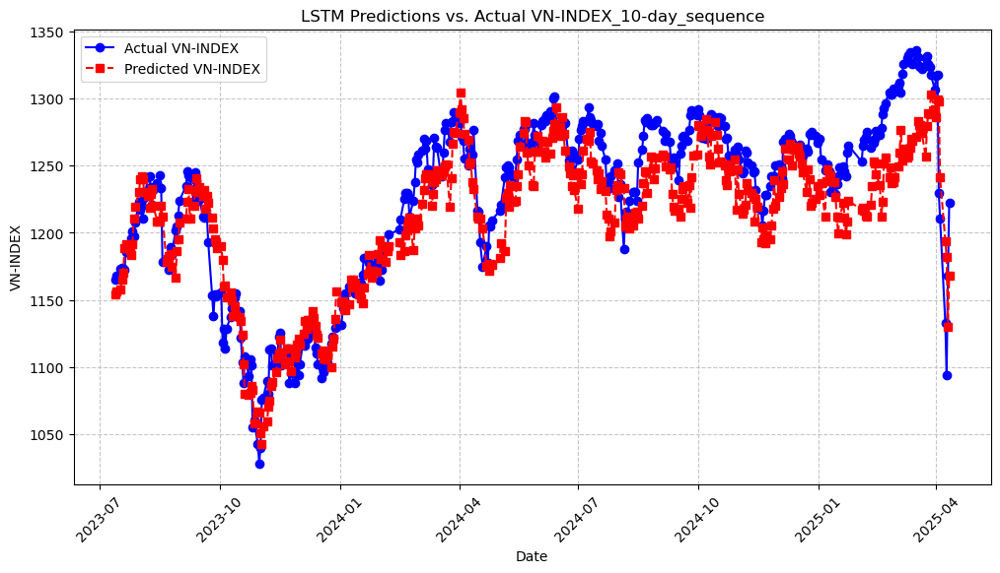

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-13      1165.420009         1154.242269
1   2023-07-14      1168.400035         1156.404012
2   2023-07-17      1173.130004         1158.114955
3   2023-07-18      1174.090025         1165.284206
4   2023-07-19      1172.980020         1170.215181
..         ...              ...                 ...
431 2025-04-04      1210.670016         1241.133419
432 2025-04-08      1132.790007         1194.014546
433 2025-04-09      1094.299993         1182.325581
434 2025-04-10      1168.339995         1130.140238
435 2025-04-11      1222.460024         1168.220995

[436 rows x 3 columns]


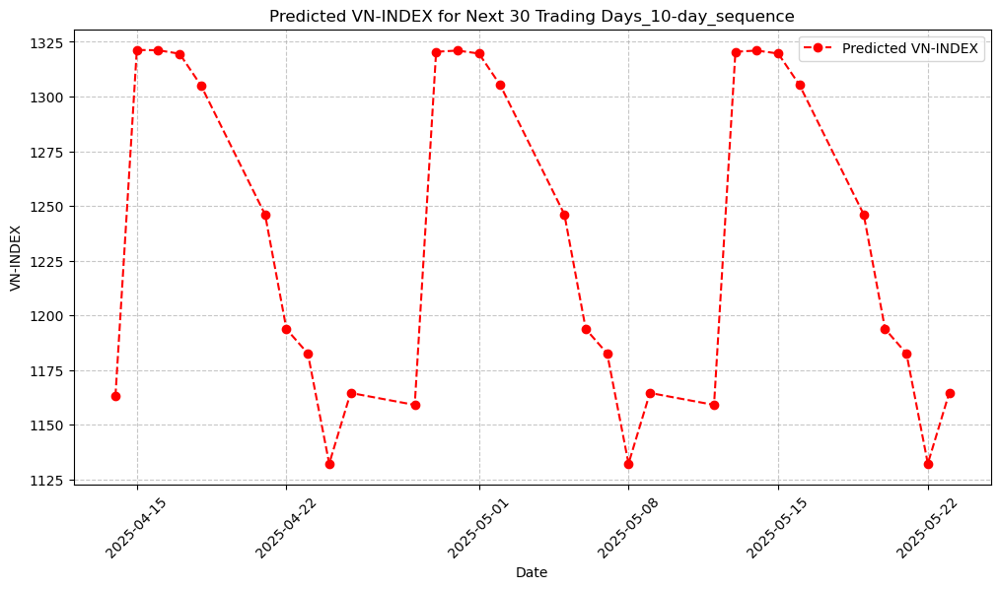

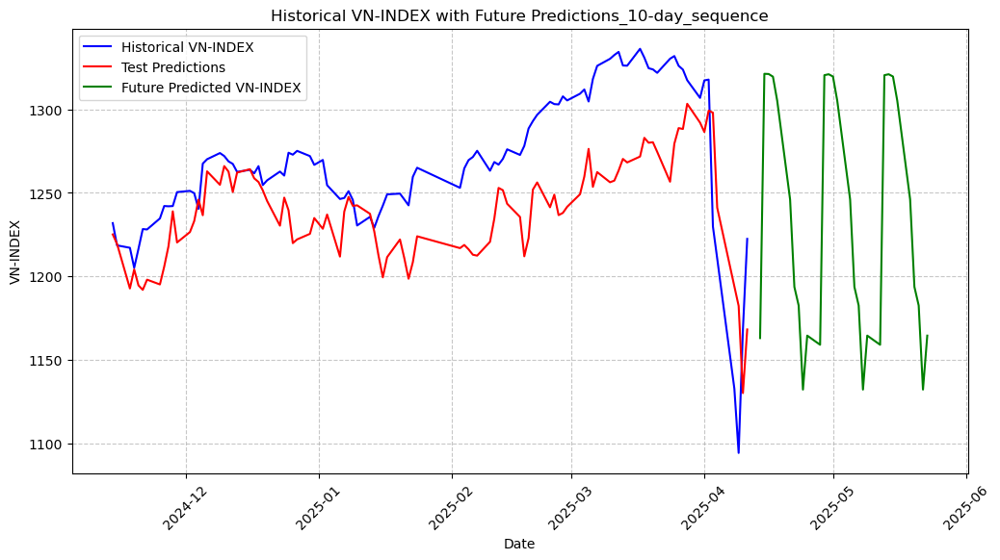

         Date  Predicted VN-INDEX
0  2025-04-14         1163.077067
1  2025-04-15         1321.296407
2  2025-04-16         1321.172088
3  2025-04-17         1319.576909
4  2025-04-18         1305.103066
5  2025-04-21         1246.060695
6  2025-04-22         1193.691070
7  2025-04-23         1182.562580
8  2025-04-24         1132.224600
9  2025-04-25         1164.543612
10 2025-04-28         1159.066652
11 2025-04-29         1320.471957
12 2025-04-30         1321.025264
13 2025-05-01         1319.673790
14 2025-05-02         1305.221604
15 2025-05-05         1246.142007
16 2025-05-06         1193.725599
17 2025-05-07         1182.574064
18 2025-05-08         1132.235544
19 2025-05-09         1164.548236
20 2025-05-12         1159.066420
21 2025-05-13         1320.471649
22 2025-05-14         1321.025033
23 2025-05-15         1319.673713
24 2025-05-16         1305.221604
25 2025-05-19         1246.142084
26 2025-05-20         1193.725522
27 2025-05-21         1182.574218
28 2025-05-22 

[I 2025-04-14 22:30:54,880] A new study created in memory with name: no-name-e07105d3-0f00-48a5-9372-3e012b89734c
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3253871967346884 and num_layers=1
  warnings.warn(
[I 2025-04-14 22:31:44,629] Trial 0 finished with value: 0.002128551899472118 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.3253871967346884, 'learning_rate': 0.0058819042419930604, 'batch_size': 32}. Best is trial 0 with value: 0.002128551899472118.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.27685196213721663 and num_layers=1
  warnings.warn(
[I 2025-04-14 22:32:18,349] Trial 1 finished with value: 0.000373

Best Hyperparameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.27685196213721663, 'learning_rate': 0.00020142709634375067, 'batch_size': 32}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0035
RMSE: 73.4813, MAE: 57.3793, R²: -0.2833, Directional Accuracy: 0.5435


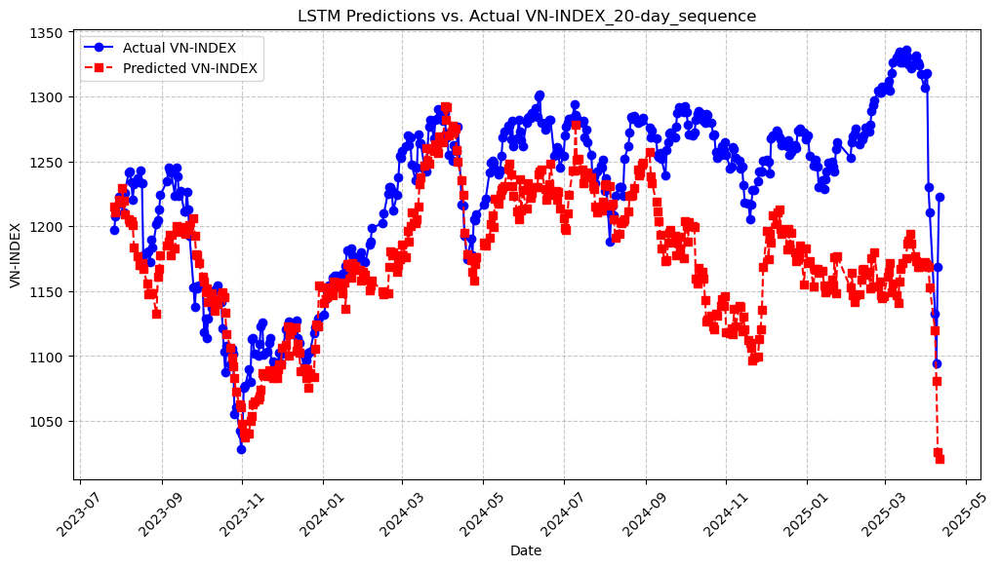

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-27      1197.329994         1215.256244
1   2023-07-28      1207.670028         1210.340067
2   2023-07-31      1222.900034         1220.633780
3   2023-08-01      1217.560032         1218.311417
4   2023-08-02      1220.429999         1229.523994
..         ...              ...                 ...
421 2025-04-04      1210.670016         1152.961624
422 2025-04-08      1132.790007         1119.988648
423 2025-04-09      1094.299993         1080.577226
424 2025-04-10      1168.339995         1026.398622
425 2025-04-11      1222.460024         1020.987175

[426 rows x 3 columns]


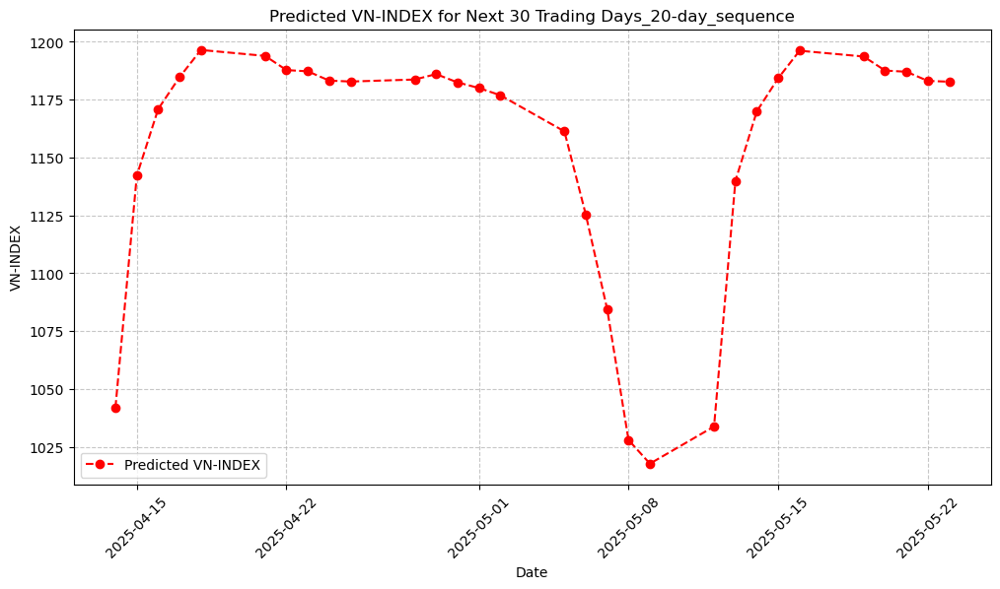

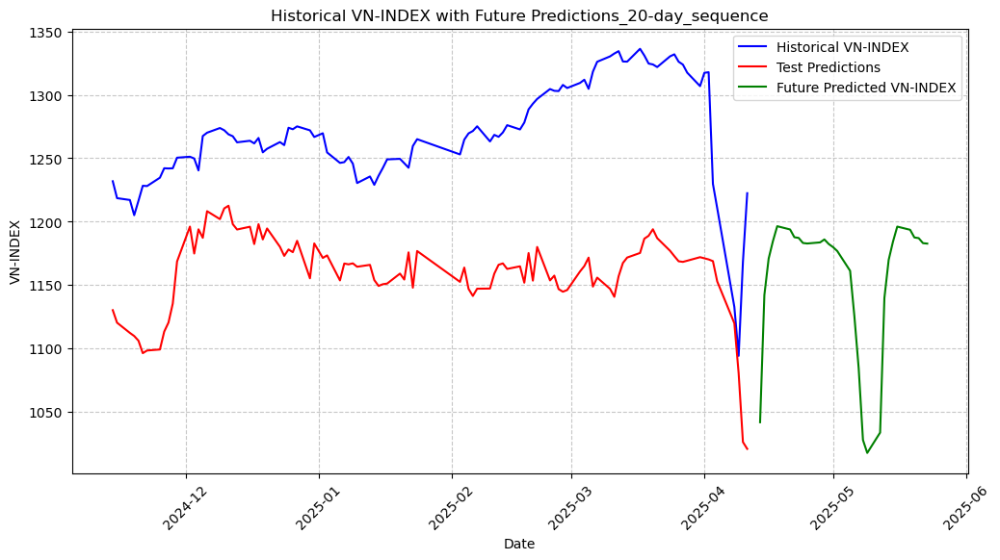

         Date  Predicted VN-INDEX
0  2025-04-14         1041.980389
1  2025-04-15         1142.210329
2  2025-04-16         1170.952846
3  2025-04-17         1184.748139
4  2025-04-18         1196.470707
5  2025-04-21         1193.905642
6  2025-04-22         1187.779265
7  2025-04-23         1187.244532
8  2025-04-24         1183.243289
9  2025-04-25         1182.833800
10 2025-04-28         1183.703877
11 2025-04-29         1186.034795
12 2025-04-30         1182.471095
13 2025-05-01         1180.040521
14 2025-05-02         1176.925231
15 2025-05-05         1161.312481
16 2025-05-06         1125.424143
17 2025-05-07         1084.557044
18 2025-05-08         1028.004669
19 2025-05-09         1017.799744
20 2025-05-12         1033.833621
21 2025-05-13         1139.938063
22 2025-05-14         1169.964848
23 2025-05-15         1184.252637
24 2025-05-16         1196.144458
25 2025-05-19         1193.639663
26 2025-05-20         1187.576563
27 2025-05-21         1187.067419
28 2025-05-22 

[I 2025-04-14 22:37:55,398] A new study created in memory with name: no-name-e3a3ab46-1c64-473f-b5b2-8ba3dac8e29d
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2161670087968132 and num_layers=1
  warnings.warn(
[I 2025-04-14 22:39:06,956] Trial 0 finished with value: 0.0009135026328613094 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.2161670087968132, 'learning_rate': 0.00011662365133974051, 'batch_size': 128}. Best is trial 0 with value: 0.0009135026328613094.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4189475556040146 and num_layers=1
  warnings.warn(
[I 2025-04-14 22:41:36,477] Trial 1 finished with value: 0.000

Best Hyperparameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.42950115809928685, 'learning_rate': 0.0018797854365611745, 'batch_size': 32}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0019
RMSE: 55.2949, MAE: 44.8661, R²: 0.3025, Directional Accuracy: 0.5086


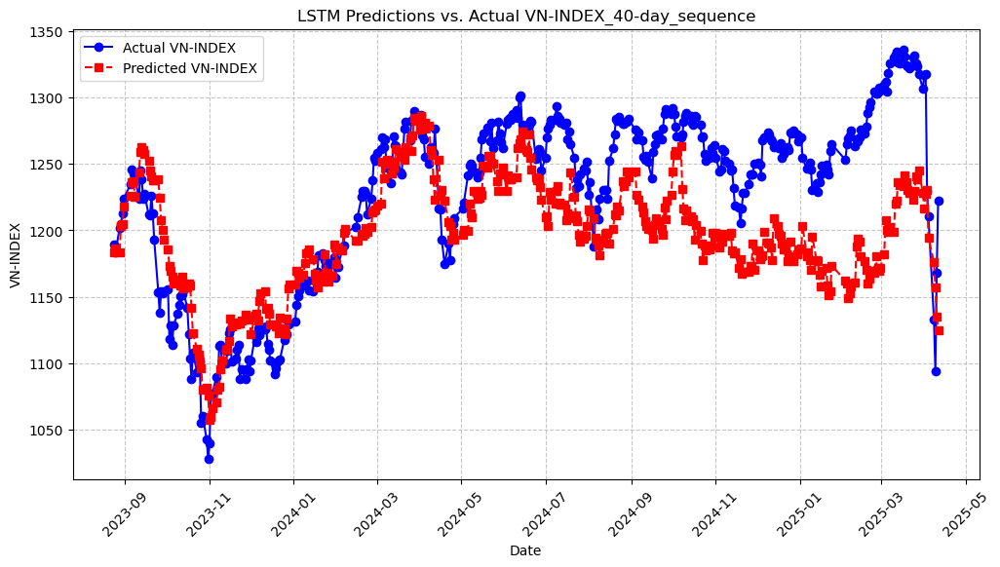

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-08-24      1189.390013         1183.836211
1   2023-08-25      1183.369997         1186.112639
2   2023-08-28      1201.719994         1183.254233
3   2023-08-29      1204.430034         1203.121566
4   2023-08-30      1213.160013         1204.816555
..         ...              ...                 ...
401 2025-04-04      1210.670016         1194.407233
402 2025-04-08      1132.790007         1175.962128
403 2025-04-09      1094.299993         1157.320255
404 2025-04-10      1168.339995         1134.918069
405 2025-04-11      1222.460024         1124.930490

[406 rows x 3 columns]


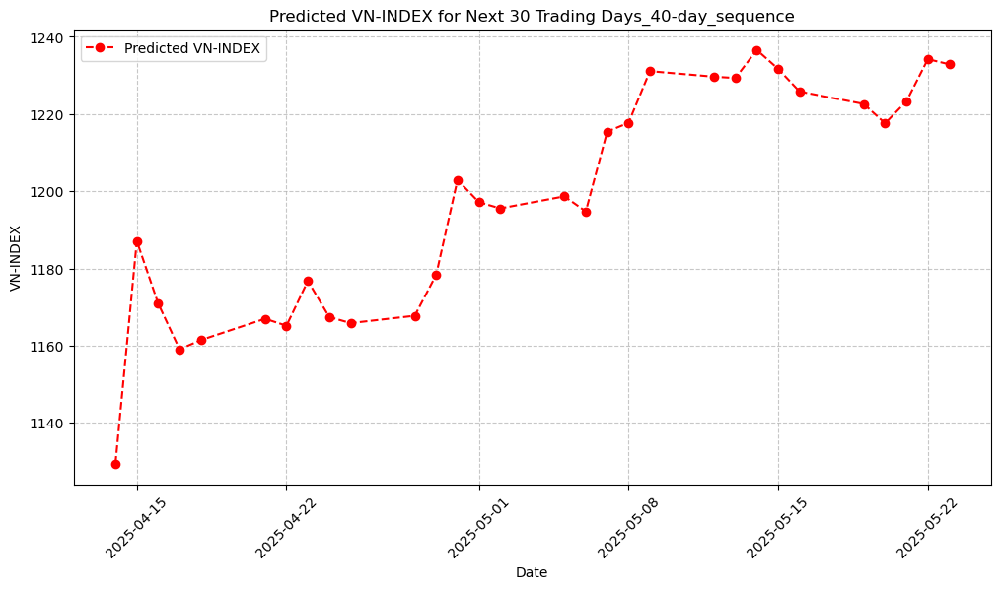

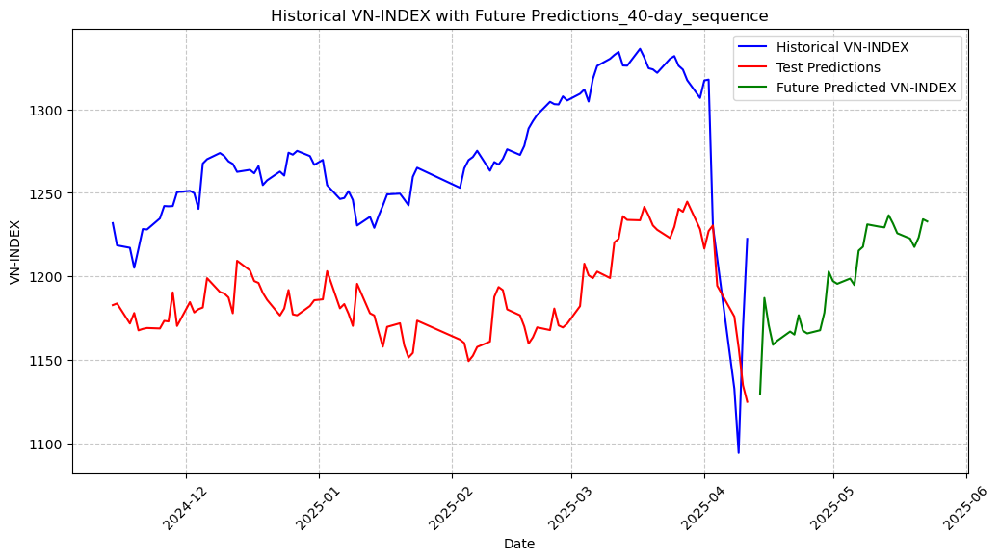

         Date  Predicted VN-INDEX
0  2025-04-14         1129.418758
1  2025-04-15         1187.106032
2  2025-04-16         1170.914233
3  2025-04-17         1159.048154
4  2025-04-18         1161.452137
5  2025-04-21         1166.975495
6  2025-04-22         1165.169598
7  2025-04-23         1176.771856
8  2025-04-24         1167.436546
9  2025-04-25         1165.846145
10 2025-04-28         1167.748691
11 2025-04-29         1178.320175
12 2025-04-30         1202.923797
13 2025-05-01         1197.164441
14 2025-05-02         1195.553616
15 2025-05-05         1198.676767
16 2025-05-06         1194.771942
17 2025-05-07         1215.437365
18 2025-05-08         1217.733986
19 2025-05-09         1231.121254
20 2025-05-12         1229.679681
21 2025-05-13         1229.342256
22 2025-05-14         1236.615941
23 2025-05-15         1231.695987
24 2025-05-16         1225.833508
25 2025-05-19         1222.620336
26 2025-05-20         1217.612519
27 2025-05-21         1223.311295
28 2025-05-22 

[I 2025-04-14 22:52:05,110] A new study created in memory with name: no-name-743ca81e-6483-49b1-9fd7-ff04dc228f5e
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2232992052607545 and num_layers=1
  warnings.warn(
[I 2025-04-14 22:55:48,858] Trial 0 finished with value: 0.0022662520752010098 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.2232992052607545, 'learning_rate': 0.0015846338458711615, 'batch_size': 128}. Best is trial 0 with value: 0.0022662520752010098.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.15825858210623386 and num_layers=1
  warnings.warn(
[I 2025-04-14 22:57:23,806] Trial 1 finished with value: 0.000

Best Hyperparameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.15825858210623386, 'learning_rate': 0.0004100768366867193, 'batch_size': 32}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0017
RMSE: 39.7875, MAE: 32.6927, R²: 0.6550, Directional Accuracy: 0.5065


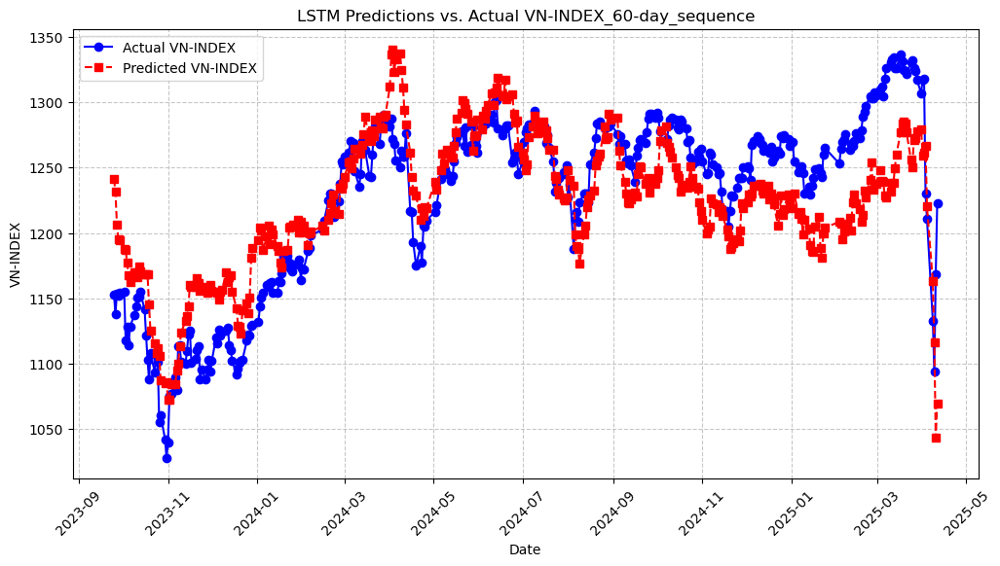

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-25      1153.200011         1241.386835
1   2023-09-26      1137.959985         1231.655601
2   2023-09-27      1153.849967         1206.650429
3   2023-09-28      1152.429975         1194.991985
4   2023-09-29      1154.150012         1194.602844
..         ...              ...                 ...
381 2025-04-04      1210.670016         1220.223520
382 2025-04-08      1132.790007         1163.018800
383 2025-04-09      1094.299993         1116.494622
384 2025-04-10      1168.339995         1043.753145
385 2025-04-11      1222.460024         1069.965819

[386 rows x 3 columns]


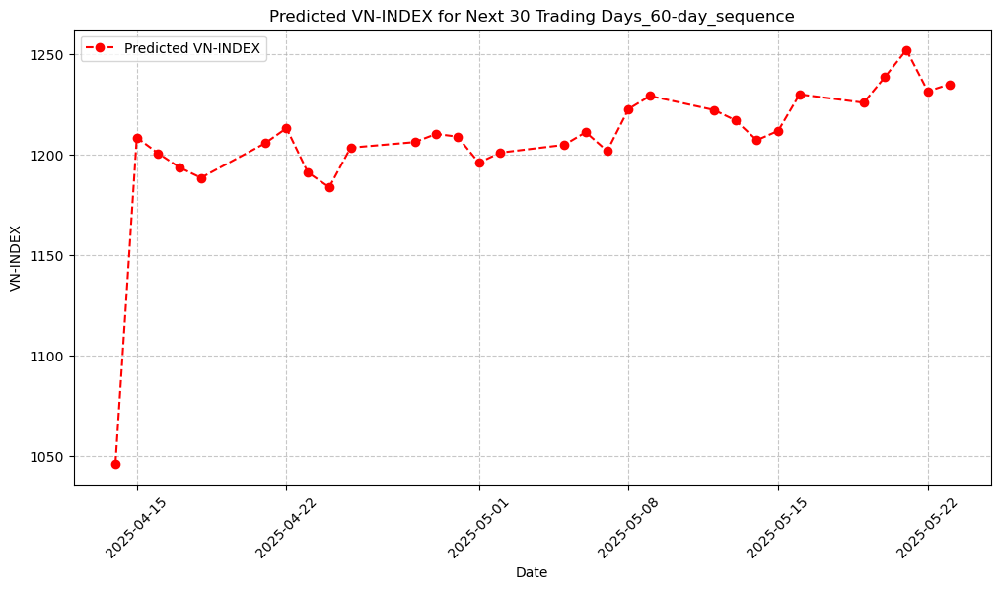

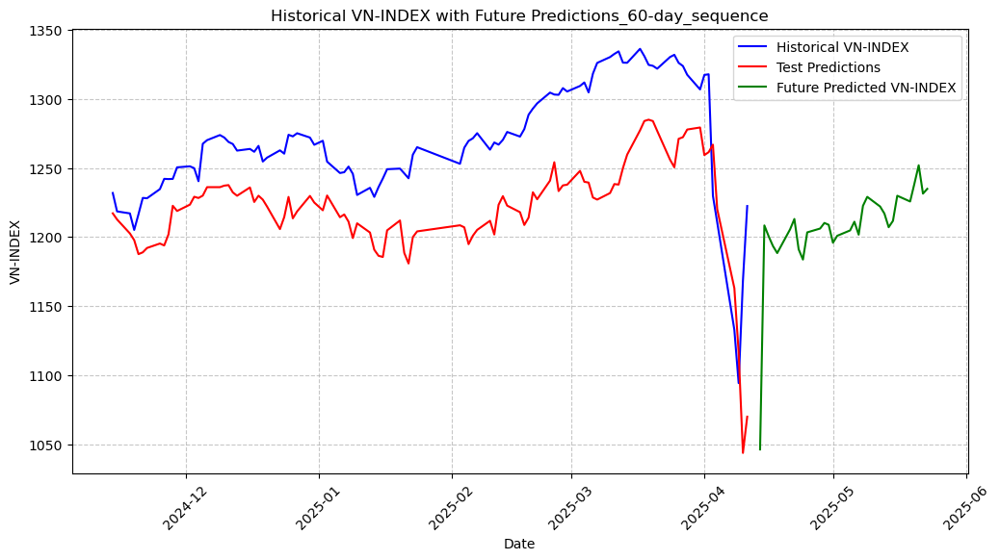

         Date  Predicted VN-INDEX
0  2025-04-14         1046.275743
1  2025-04-15         1208.437829
2  2025-04-16         1200.574150
3  2025-04-17         1193.530065
4  2025-04-18         1188.418508
5  2025-04-21         1205.599770
6  2025-04-22         1213.090802
7  2025-04-23         1191.099569
8  2025-04-24         1183.707576
9  2025-04-25         1203.403961
10 2025-04-28         1206.163174
11 2025-04-29         1210.212819
12 2025-04-30         1208.882154
13 2025-05-01         1195.893970
14 2025-05-02         1200.931614
15 2025-05-05         1204.807846
16 2025-05-06         1211.107405
17 2025-05-07         1201.728857
18 2025-05-08         1222.597753
19 2025-05-09         1229.107337
20 2025-05-12         1222.117974
21 2025-05-13         1217.008729
22 2025-05-14         1207.125970
23 2025-05-15         1211.760059
24 2025-05-16         1229.907894
25 2025-05-19         1225.747880
26 2025-05-20         1238.635253
27 2025-05-21         1251.981749
28 2025-05-22 

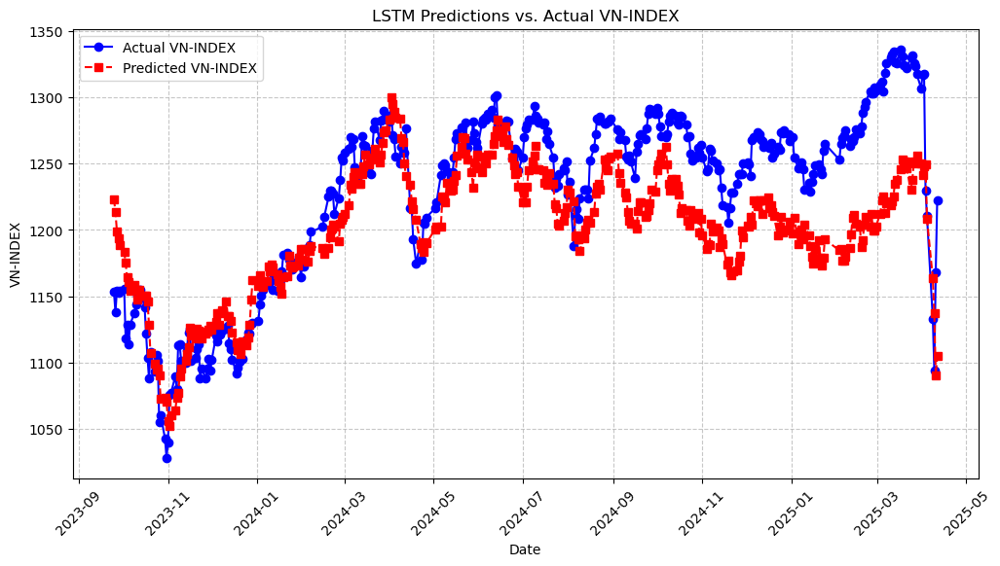

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-25      1153.200011         1223.414750
1   2023-09-26      1137.959985         1213.502510
2   2023-09-27      1153.849967         1199.247096
3   2023-09-28      1152.429975         1193.455998
4   2023-09-29      1154.150012         1188.592052
..         ...              ...                 ...
381 2025-04-04      1210.670016         1208.183704
382 2025-04-08      1132.790007         1163.611721
383 2025-04-09      1094.299993         1136.951669
384 2025-04-10      1168.339995         1090.128065
385 2025-04-11      1222.460024         1105.256261

[386 rows x 3 columns]


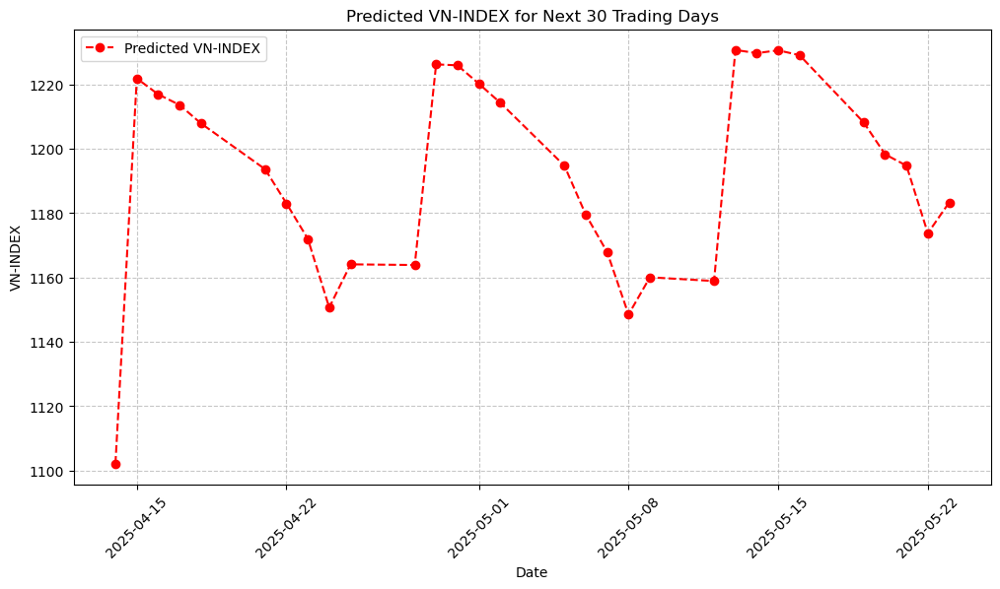

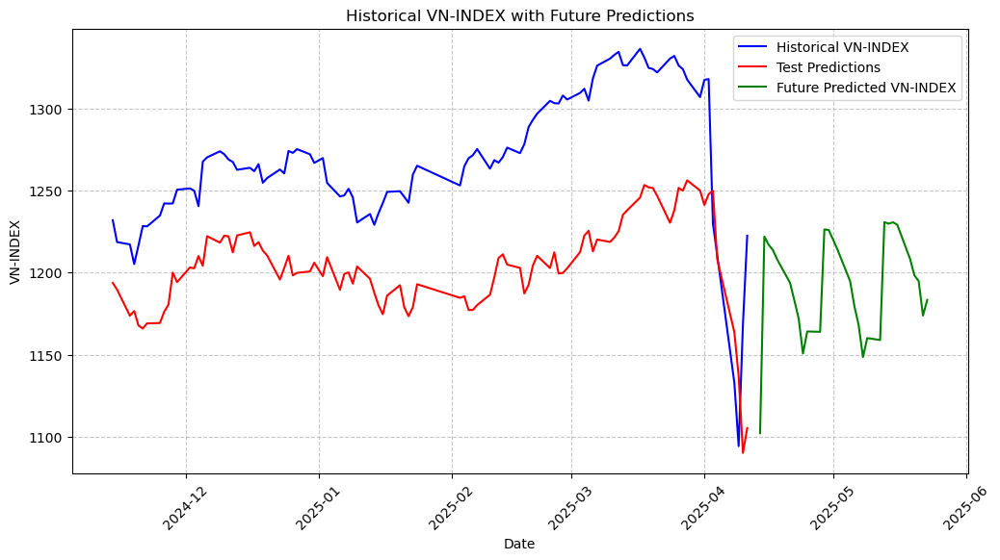


Ensemble Future Predictions (weighted average) for next 30 days:
         Date  Predicted Future VN-INDEX
0  2025-04-14                1102.160421
1  2025-04-15                1221.871806
2  2025-04-16                1216.927624
3  2025-04-17                1213.631205
4  2025-04-18                1207.906682
5  2025-04-21                1193.673438
6  2025-04-22                1183.025546
7  2025-04-23                1172.017293
8  2025-04-24                1150.662092
9  2025-04-25                1164.098324
10 2025-04-28                1163.890558
11 2025-04-29                1226.241520
12 2025-04-30                1225.938961
13 2025-05-01                1220.231445
14 2025-05-02                1214.331508
15 2025-05-05                1194.755091
16 2025-05-06                1179.550032
17 2025-05-07                1167.881390
18 2025-05-08                1148.499518
19 2025-05-09                1160.071831
20 2025-05-12                1158.910438
21 2025-05-13                123

In [18]:
data = lag_features_indicators(df_3, df_3.columns)

ensemble_lstm_model(data)

/var/folders/fl/t1q3j3rn0dg278fhg2bvg0dw0000gn/T/ipykernel_31202/3744217377.py:65: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  copy_df['Month'] = copy_df.index.month
/var/folders/fl/t1q3j3rn0dg278fhg2bvg0dw0000gn/T/ipykernel_31202/3744217377.py:69: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  copy_df[f'{col}_EMA_Ratio'] = copy_df[f'{col}_EMA_10'] / copy_df[f'{col}_EMA_20']
/var/folders/fl/t1q3j3rn0dg278fhg2bvg0dw0000gn/T/ipykernel_31202/3744217377.py:69: PerformanceWarning: DataFrame is highly fragmented.  This is usually the


Training LSTM with sequence length = 5


/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.30371019033933466 and num_layers=1
  warnings.warn(
[I 2025-04-14 23:17:38,687] Trial 0 finished with value: 0.0021300348034174023 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.30371019033933466, 'learning_rate': 0.00565166086230721, 'batch_size': 128}. Best is trial 0 with value: 0.0021300348034174023.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3439614689132753 and num_layers=1
  warnings.warn(
[I 2025-04-14 23:17:47,409] Trial 1 finished with value: 0.00048269481176021144 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.3439614689132753, 'learning_ra

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.11074088842640771, 'learning_rate': 0.0011540950891180623, 'batch_size': 32}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0002
RMSE: 18.5115, MAE: 12.9898, R²: 0.9196, Directional Accuracy: 0.5336


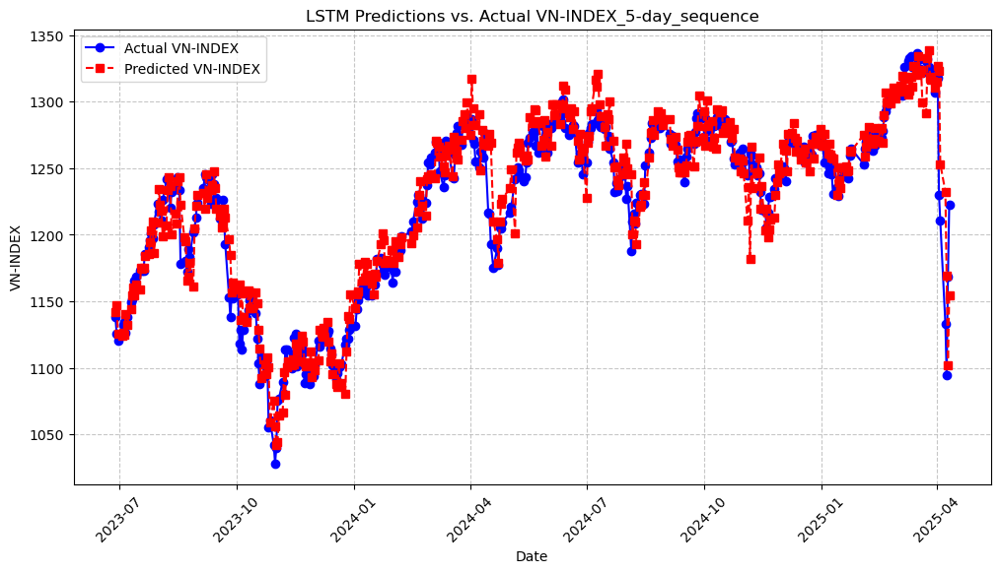

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-06-28      1138.349975         1141.849319
1   2023-06-29      1125.389999         1146.986773
2   2023-06-30      1120.180020         1125.344989
3   2023-07-03      1125.499982         1123.991664
4   2023-07-04      1132.000009         1126.210287
..         ...              ...                 ...
442 2025-04-04      1210.670016         1253.203587
443 2025-04-08      1132.790007         1232.392033
444 2025-04-09      1094.299993         1169.414007
445 2025-04-10      1168.339995         1101.952955
446 2025-04-11      1222.460024         1154.773379

[447 rows x 3 columns]


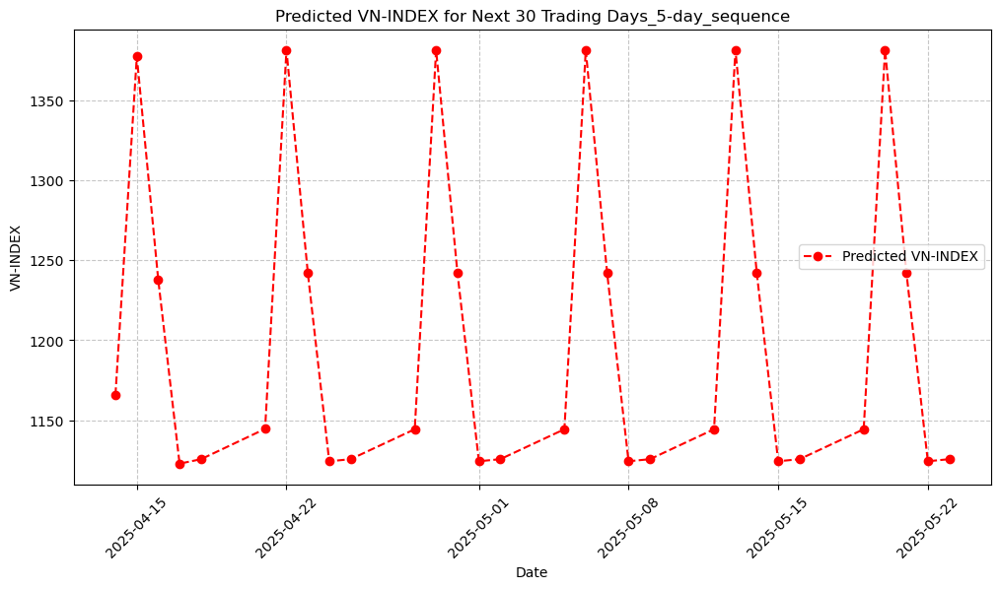

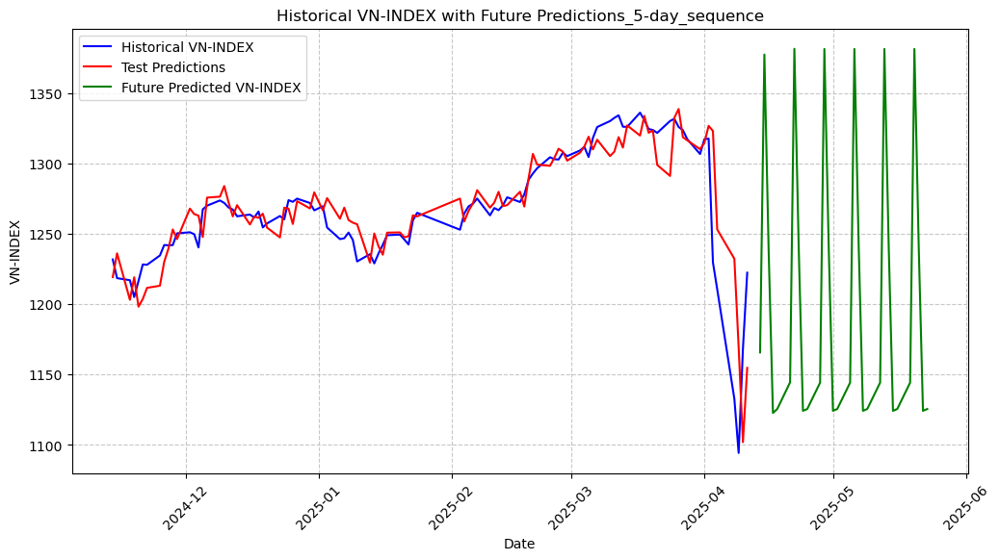

[I 2025-04-14 23:19:23,303] A new study created in memory with name: no-name-3611ec0d-656d-467b-90b1-165534ff4ba3


         Date  Predicted VN-INDEX
0  2025-04-14         1165.745796
1  2025-04-15         1377.583651
2  2025-04-16         1238.157477
3  2025-04-17         1122.748631
4  2025-04-18         1125.513393
5  2025-04-21         1144.496314
6  2025-04-22         1381.666515
7  2025-04-23         1241.972359
8  2025-04-24         1124.238760
9  2025-04-25         1125.524800
10 2025-04-28         1144.272262
11 2025-04-29         1381.560077
12 2025-04-30         1241.958177
13 2025-05-01         1124.247701
14 2025-05-02         1125.531120
15 2025-05-05         1144.273650
16 2025-05-06         1381.559769
17 2025-05-07         1241.957869
18 2025-05-08         1124.247624
19 2025-05-09         1125.531197
20 2025-05-12         1144.273650
21 2025-05-13         1381.559769
22 2025-05-14         1241.957869
23 2025-05-15         1124.247624
24 2025-05-16         1125.531197
25 2025-05-19         1144.273650
26 2025-05-20         1381.559769
27 2025-05-21         1241.957869
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.32823467875181905 and num_layers=1
  warnings.warn(
[I 2025-04-14 23:19:39,089] Trial 0 finished with value: 0.00044069886585361927 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.32823467875181905, 'learning_rate': 0.0009537497190364527, 'batch_size': 64}. Best is trial 0 with value: 0.00044069886585361927.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.43676676319299107 and num_layers=1
  warnings.warn(
[I 2025-04-14 23:20:10,170] Trial 1 finished with value: 0.0002722271154038936 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.43676676319299107, 'learnin

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.43676676319299107, 'learning_rate': 0.002159682898448181, 'batch_size': 64}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0002
RMSE: 18.8061, MAE: 13.8645, R²: 0.9159, Directional Accuracy: 0.5420


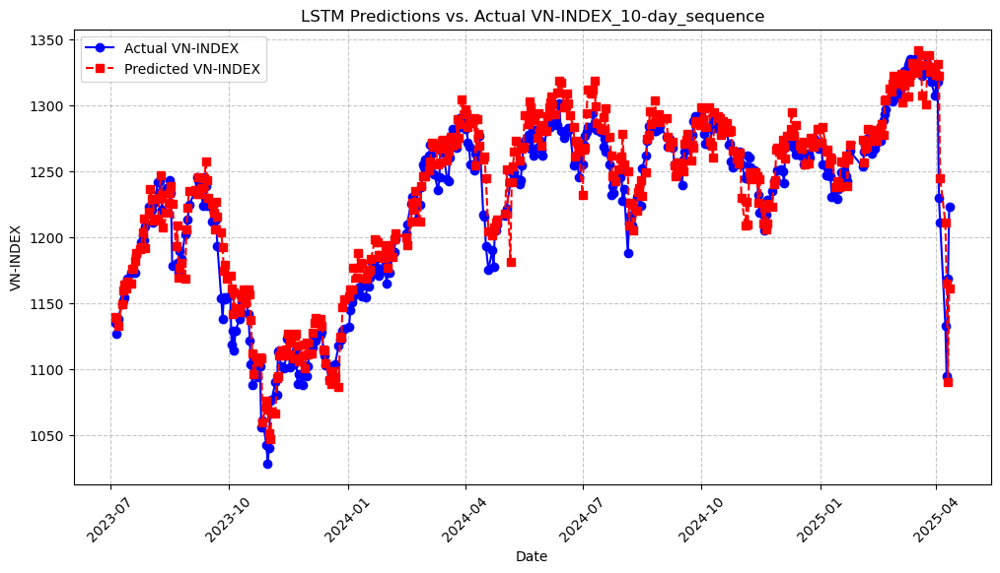

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-05      1134.620028         1139.252191
1   2023-07-06      1126.219998         1138.232438
2   2023-07-07      1138.069969         1132.581910
3   2023-07-10      1149.020035         1149.094719
4   2023-07-11      1151.769999         1159.407777
..         ...              ...                 ...
437 2025-04-04      1210.670016         1244.244008
438 2025-04-08      1132.790007         1210.612905
439 2025-04-09      1094.299993         1164.291891
440 2025-04-10      1168.339995         1090.294510
441 2025-04-11      1222.460024         1160.975518

[442 rows x 3 columns]


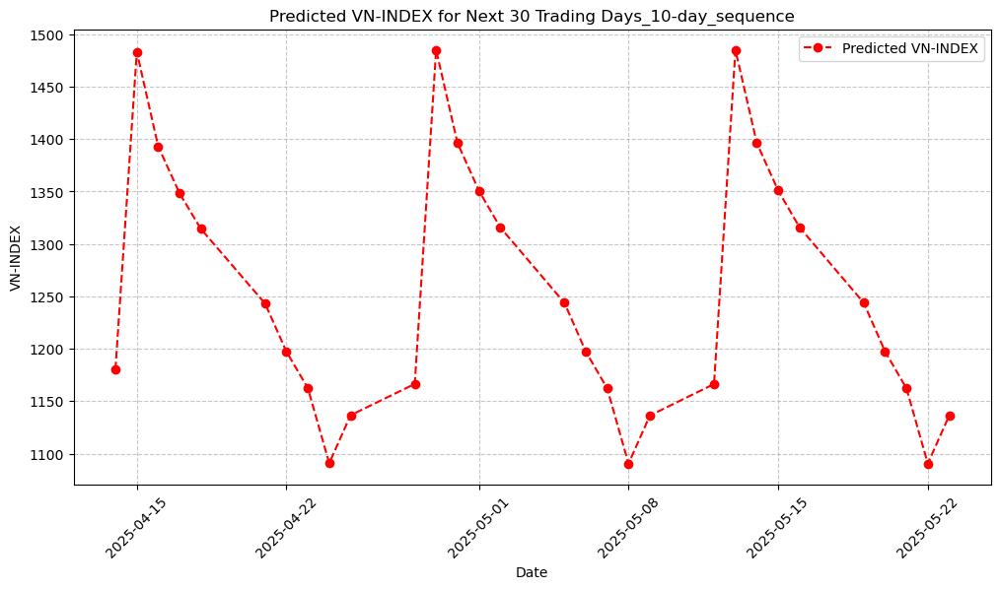

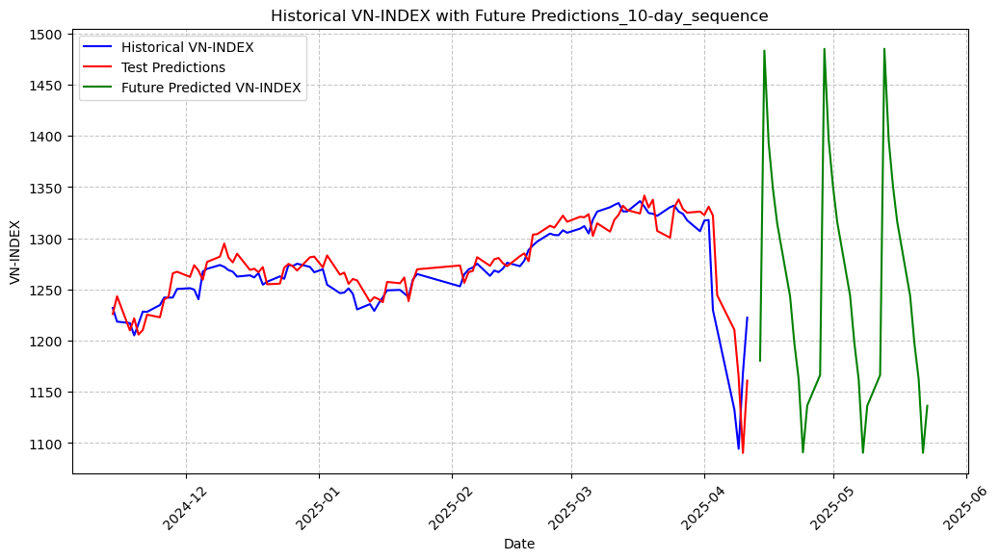

[I 2025-04-14 23:22:39,624] A new study created in memory with name: no-name-5af0d28a-8caa-4683-a6a2-0dfcfd2fc936


         Date  Predicted VN-INDEX
0  2025-04-14         1180.393361
1  2025-04-15         1483.332863
2  2025-04-16         1393.082256
3  2025-04-17         1348.283973
4  2025-04-18         1314.258180
5  2025-04-21         1243.166065
6  2025-04-22         1197.178083
7  2025-04-23         1162.445454
8  2025-04-24         1090.825929
9  2025-04-25         1136.612673
10 2025-04-28         1166.411090
11 2025-04-29         1485.035405
12 2025-04-30         1396.259666
13 2025-05-01         1350.885725
14 2025-05-02         1315.796711
15 2025-05-05         1243.880994
16 2025-05-06         1197.378473
17 2025-05-07         1162.175313
18 2025-05-08         1090.405881
19 2025-05-09         1136.336135
20 2025-05-12         1166.361917
21 2025-05-13         1485.053672
22 2025-05-14         1396.285563
23 2025-05-15         1350.904454
24 2025-05-16         1315.805651
25 2025-05-19         1243.883768
26 2025-05-20         1197.378011
27 2025-05-21         1162.172770
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.18006175613063788 and num_layers=1
  warnings.warn(
[I 2025-04-14 23:22:53,369] Trial 0 finished with value: 0.001118687981347648 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.18006175613063788, 'learning_rate': 0.0008385147078677732, 'batch_size': 128}. Best is trial 0 with value: 0.001118687981347648.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4210487414249929 and num_layers=1
  warnings.warn(
[I 2025-04-14 23:24:07,919] Trial 1 finished with value: 0.0005503210929961711 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.4210487414249929, 'learning_rate

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.3434944488445052, 'learning_rate': 0.0008447200120211155, 'batch_size': 32}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0007
RMSE: 33.1489, MAE: 27.6414, R²: 0.7367, Directional Accuracy: 0.5174


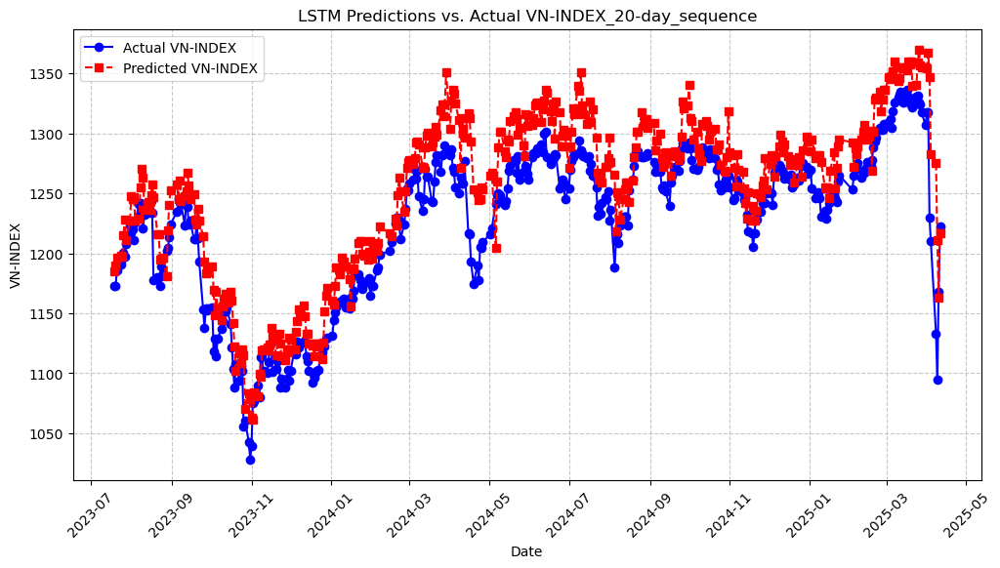

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-19      1172.980020         1184.963326
1   2023-07-20      1172.809997         1190.033649
2   2023-07-21      1185.899994         1196.243034
3   2023-07-24      1190.719984         1197.759984
4   2023-07-25      1195.899982         1196.867402
..         ...              ...                 ...
427 2025-04-04      1210.670016         1283.101120
428 2025-04-08      1132.790007         1275.209541
429 2025-04-09      1094.299993         1210.684814
430 2025-04-10      1168.339995         1162.981034
431 2025-04-11      1222.460024         1216.811191

[432 rows x 3 columns]


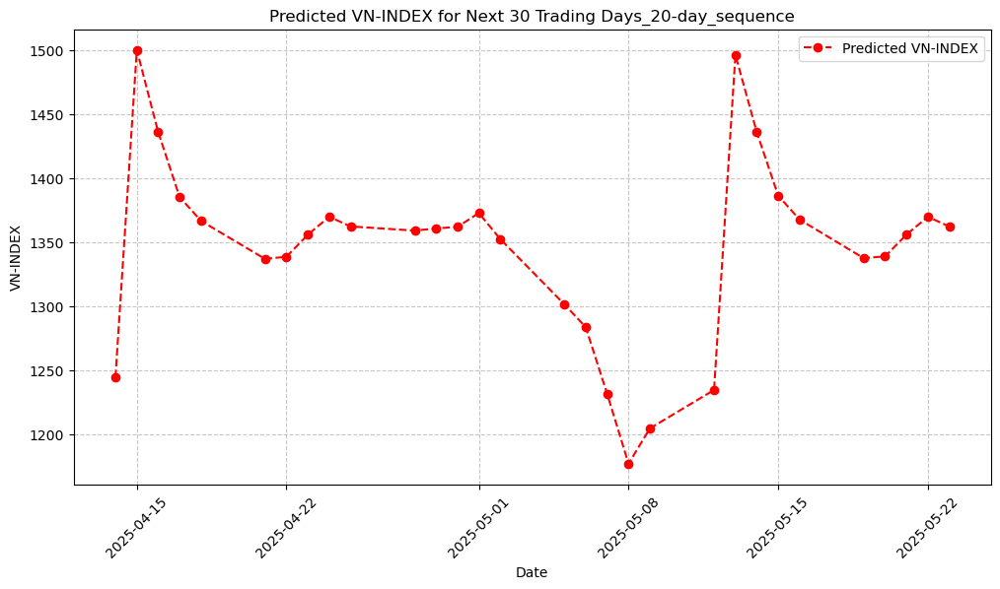

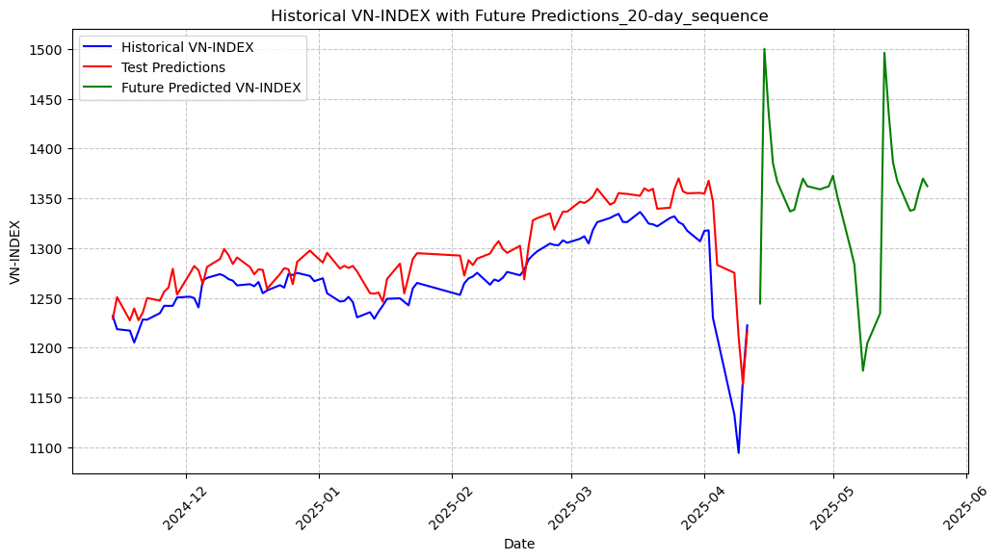

[I 2025-04-14 23:30:16,420] A new study created in memory with name: no-name-6353dcf5-ecdb-40b0-bf78-a0005ee5400e


         Date  Predicted VN-INDEX
0  2025-04-14         1244.347285
1  2025-04-15         1500.166372
2  2025-04-16         1436.015219
3  2025-04-17         1385.307134
4  2025-04-18         1366.602755
5  2025-04-21         1336.834551
6  2025-04-22         1338.576785
7  2025-04-23         1355.775852
8  2025-04-24         1369.783865
9  2025-04-25         1362.215915
10 2025-04-28         1358.990103
11 2025-04-29         1360.655188
12 2025-04-30         1361.900687
13 2025-05-01         1372.704777
14 2025-05-02         1352.365295
15 2025-05-05         1301.357936
16 2025-05-06         1283.458122
17 2025-05-07         1231.305767
18 2025-05-08         1176.833206
19 2025-05-09         1204.375081
20 2025-05-12         1234.390690
21 2025-05-13         1496.212066
22 2025-05-14         1435.799106
23 2025-05-15         1386.320258
24 2025-05-16         1367.576804
25 2025-05-19         1337.447204
26 2025-05-20         1338.843227
27 2025-05-21         1355.836585
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3166574317203485 and num_layers=1
  warnings.warn(
[I 2025-04-14 23:31:41,342] Trial 0 finished with value: 0.0002269272964385749 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.3166574317203485, 'learning_rate': 0.0033501309075305323, 'batch_size': 32}. Best is trial 0 with value: 0.0002269272964385749.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4883166975857606 and num_layers=1
  warnings.warn(
[I 2025-04-14 23:33:53,230] Trial 1 finished with value: 0.0004765790342673881 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.4883166975857606, 'learning_rate

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.3166574317203485, 'learning_rate': 0.0033501309075305323, 'batch_size': 32}
Best Overall Average Training Loss: 0.0002
Final Evaluation Loss on Test Set: 0.0006
RMSE: 32.5376, MAE: 26.8938, R²: 0.7563, Directional Accuracy: 0.5426


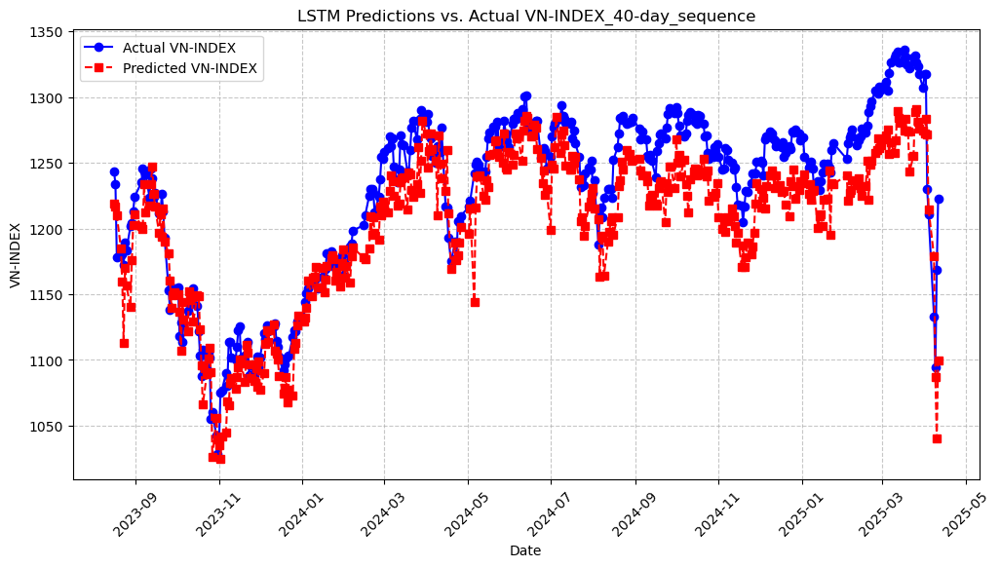

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-08-16      1243.260017         1219.268663
1   2023-08-17      1233.479995         1216.358079
2   2023-08-18      1177.989995         1209.968883
3   2023-08-21      1179.759976         1185.187917
4   2023-08-22      1180.490011         1159.720076
..         ...              ...                 ...
407 2025-04-04      1210.670016         1214.748564
408 2025-04-08      1132.790007         1178.648660
409 2025-04-09      1094.299993         1086.695202
410 2025-04-10      1168.339995         1040.538046
411 2025-04-11      1222.460024         1099.431974

[412 rows x 3 columns]


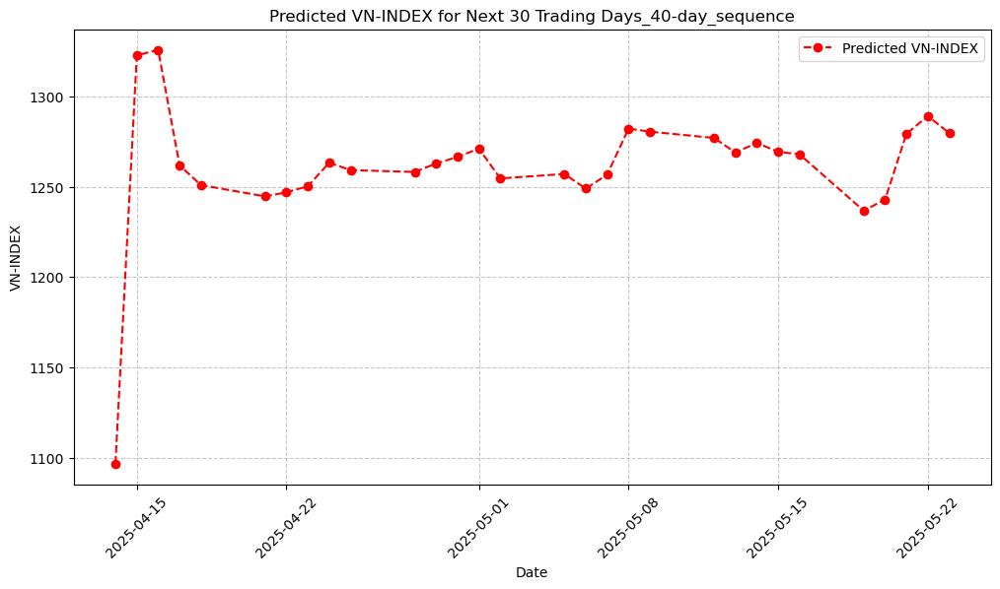

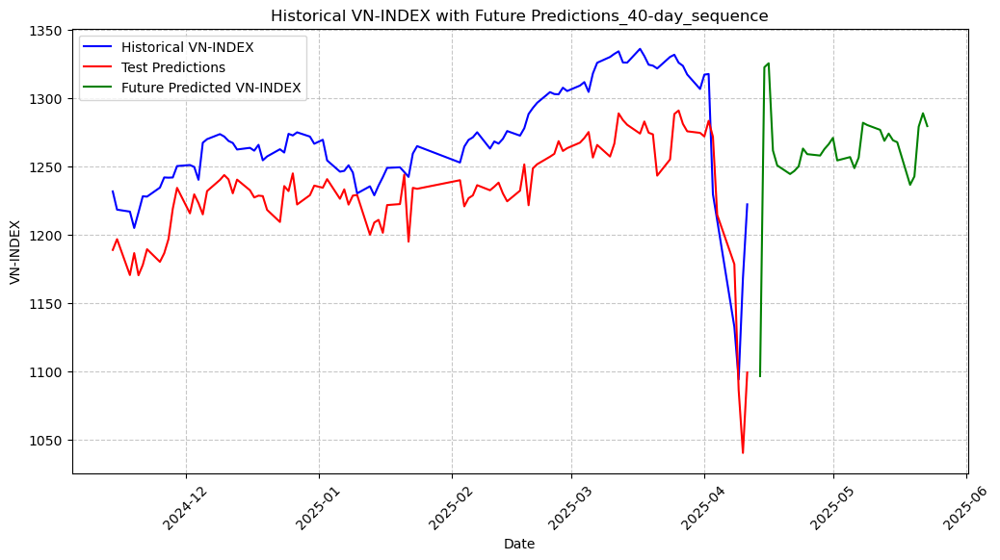

         Date  Predicted VN-INDEX
0  2025-04-14         1096.728871
1  2025-04-15         1322.747691
2  2025-04-16         1325.670453
3  2025-04-17         1261.835992
4  2025-04-18         1250.914288
5  2025-04-21         1244.629141
6  2025-04-22         1246.897707
7  2025-04-23         1250.252232
8  2025-04-24         1263.270937
9  2025-04-25         1259.180519
10 2025-04-28         1258.148975
11 2025-04-29         1262.855205
12 2025-04-30         1266.440023
13 2025-05-01         1271.092611
14 2025-05-02         1254.580496
15 2025-05-05         1257.023555
16 2025-05-06         1248.944920
17 2025-05-07         1256.640348
18 2025-05-08         1282.126995
19 2025-05-09         1280.471313
20 2025-05-12         1276.964955
21 2025-05-13         1268.937650
22 2025-05-14         1274.227169
23 2025-05-15         1269.319778
24 2025-05-16         1267.895161
25 2025-05-19         1236.718371
26 2025-05-20         1242.890067
27 2025-05-21         1279.294255
28 2025-05-22 

[I 2025-04-14 23:43:07,192] A new study created in memory with name: no-name-b6f4c0dd-cad9-4d41-b155-13e5356db75f
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2967731025721702 and num_layers=1
  warnings.warn(
[I 2025-04-14 23:44:17,896] Trial 0 finished with value: 0.00032919789339336703 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.2967731025721702, 'learning_rate': 0.00037501368102882355, 'batch_size': 32}. Best is trial 0 with value: 0.00032919789339336703.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4235977850838569 and num_layers=1
  warnings.warn(
[I 2025-04-14 23:46:07,127] Trial 1 finished with value: 0.000

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.12995709480539816, 'learning_rate': 0.0006631919720831651, 'batch_size': 32}
Best Overall Average Training Loss: 0.0002
Final Evaluation Loss on Test Set: 0.0003
RMSE: 18.7793, MAE: 14.1408, R²: 0.9220, Directional Accuracy: 0.5422


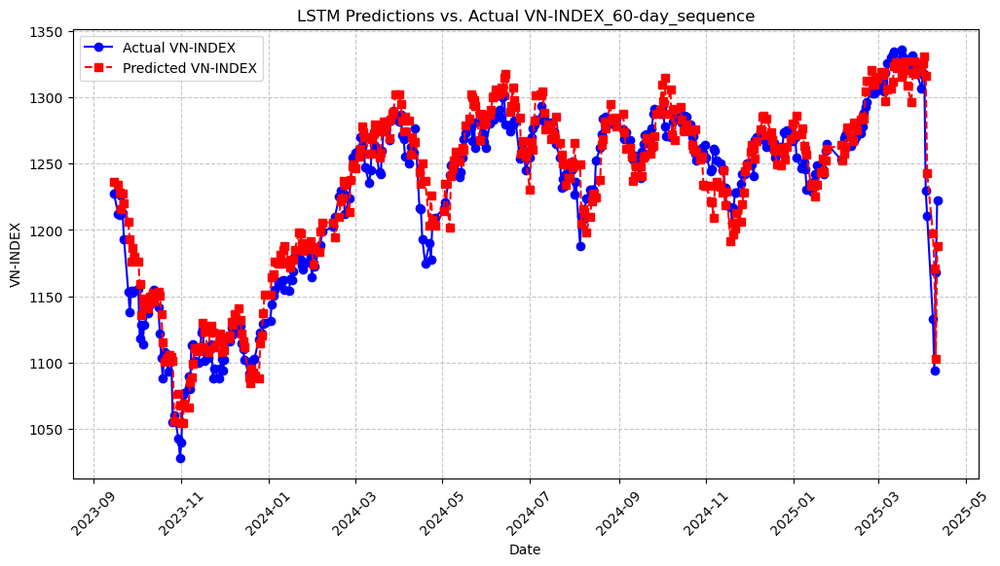

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-15      1227.360016         1236.492007
1   2023-09-18      1211.810003         1233.879542
2   2023-09-19      1211.500015         1228.144156
3   2023-09-20      1226.109969         1215.561838
4   2023-09-21      1212.739965         1227.468534
..         ...              ...                 ...
387 2025-04-04      1210.670016         1242.680968
388 2025-04-08      1132.790007         1197.622101
389 2025-04-09      1094.299993         1170.997395
390 2025-04-10      1168.339995         1103.139108
391 2025-04-11      1222.460024         1188.006784

[392 rows x 3 columns]


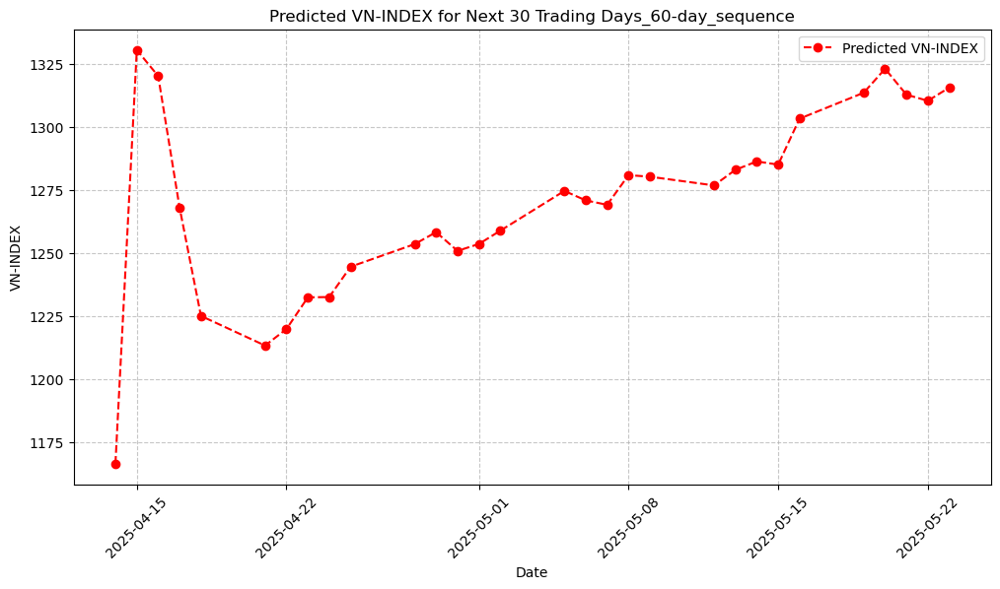

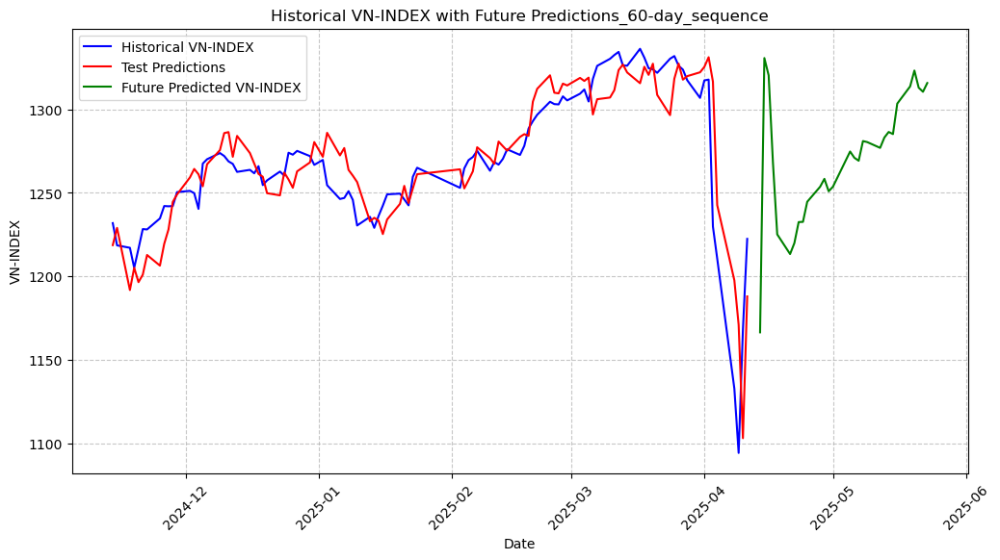

         Date  Predicted VN-INDEX
0  2025-04-14         1166.505119
1  2025-04-15         1330.721507
2  2025-04-16         1320.348641
3  2025-04-17         1268.172084
4  2025-04-18         1225.145169
5  2025-04-21         1213.381135
6  2025-04-22         1219.937040
7  2025-04-23         1232.520745
8  2025-04-24         1232.640054
9  2025-04-25         1244.671300
10 2025-04-28         1253.653077
11 2025-04-29         1258.398460
12 2025-04-30         1250.965002
13 2025-05-01         1253.698396
14 2025-05-02         1258.964946
15 2025-05-05         1274.763982
16 2025-05-06         1271.002050
17 2025-05-07         1269.253110
18 2025-05-08         1281.032327
19 2025-05-09         1280.405724
20 2025-05-12         1276.946380
21 2025-05-13         1283.152990
22 2025-05-14         1286.469826
23 2025-05-15         1285.208064
24 2025-05-16         1303.445997
25 2025-05-19         1313.740558
26 2025-05-20         1323.244581
27 2025-05-21         1312.971523
28 2025-05-22 

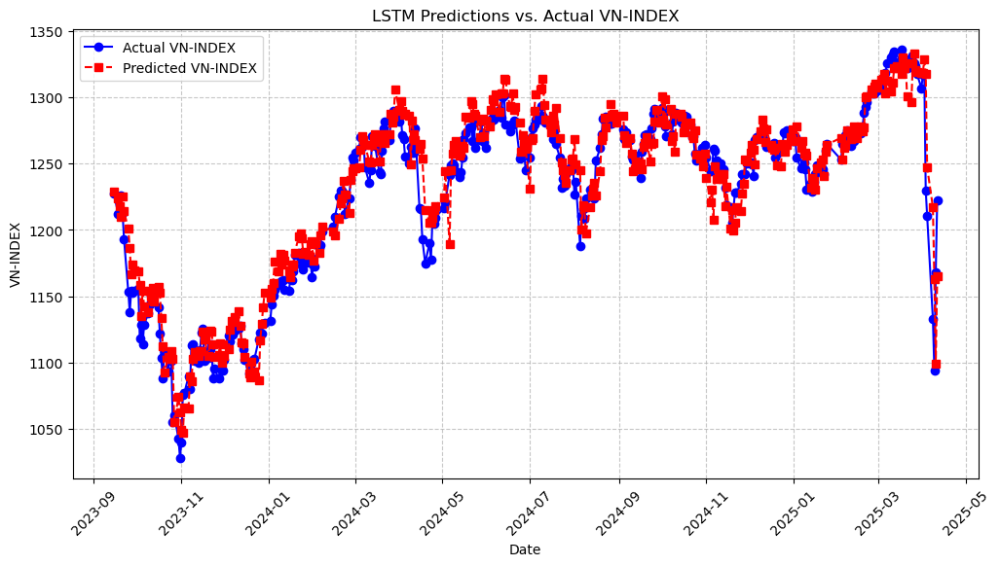

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-15      1227.360016         1229.265122
1   2023-09-18      1211.810003         1223.981809
2   2023-09-19      1211.500015         1217.945620
3   2023-09-20      1226.109969         1209.976079
4   2023-09-21      1212.739965         1224.977444
..         ...              ...                 ...
387 2025-04-04      1210.670016         1247.254971
388 2025-04-08      1132.790007         1217.168520
389 2025-04-09      1094.299993         1162.703731
390 2025-04-10      1168.339995         1099.227602
391 2025-04-11      1222.460024         1165.029401

[392 rows x 3 columns]


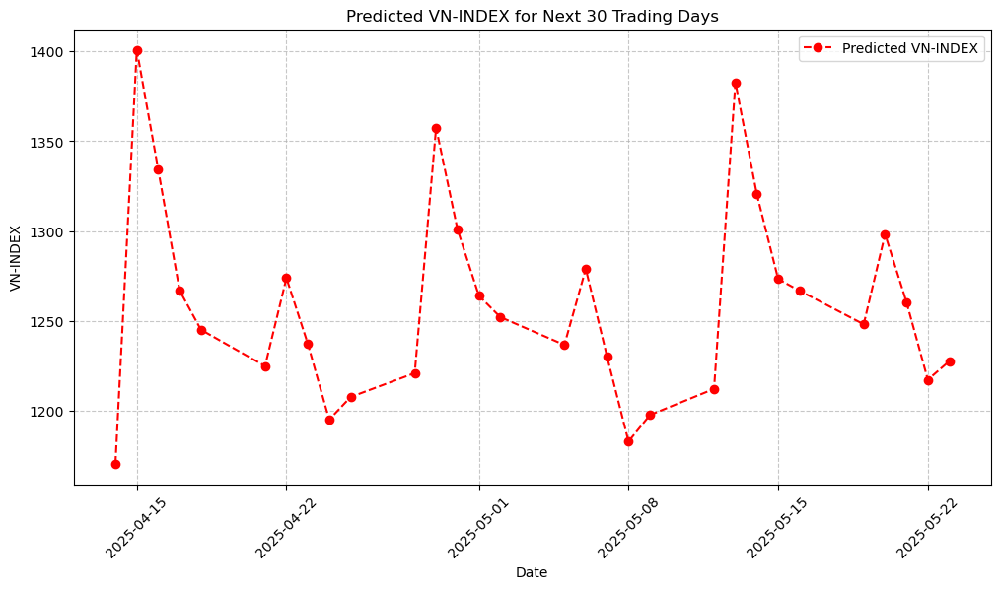

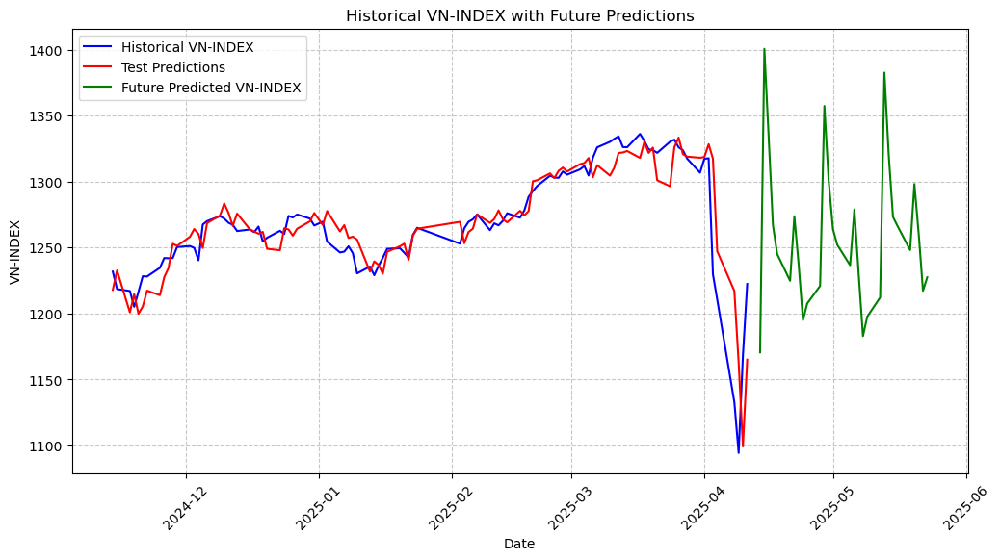


Ensemble Future Predictions (weighted average) for next 30 days:
         Date  Predicted Future VN-INDEX
0  2025-04-14                1170.576833
1  2025-04-15                1400.806866
2  2025-04-16                1334.265445
3  2025-04-17                1267.010697
4  2025-04-18                1245.094487
5  2025-04-21                1224.888848
6  2025-04-22                1273.853168
7  2025-04-23                1237.253399
8  2025-04-24                1195.060123
9  2025-04-25                1207.668479
10 2025-04-28                1220.980345
11 2025-04-29                1357.457381
12 2025-04-30                1300.939286
13 2025-05-01                1264.087283
14 2025-05-02                1252.173259
15 2025-05-05                1236.659330
16 2025-05-06                1278.932425
17 2025-05-07                1229.944973
18 2025-05-08                1182.924501
19 2025-05-09                1197.644702
20 2025-05-12                1212.203748
21 2025-05-13                138

In [19]:
data = lag_features_indicators(df_3, df_1.columns)

ensemble_lstm_model(data)

/var/folders/fl/t1q3j3rn0dg278fhg2bvg0dw0000gn/T/ipykernel_31202/3744217377.py:40: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  copy_df[f'{col}_Lag{lag}'] = copy_df[col].shift(lag)
/var/folders/fl/t1q3j3rn0dg278fhg2bvg0dw0000gn/T/ipykernel_31202/3744217377.py:40: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  copy_df[f'{col}_Lag{lag}'] = copy_df[col].shift(lag)
/var/folders/fl/t1q3j3rn0dg278fhg2bvg0dw0000gn/T/ipykernel_31202/3744217377.py:40: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of call


Training LSTM with sequence length = 5


/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4851128612519466 and num_layers=1
  warnings.warn(
[I 2025-04-15 00:02:11,305] Trial 0 finished with value: 0.001398159403297541 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.4851128612519466, 'learning_rate': 0.0029438432340123063, 'batch_size': 128}. Best is trial 0 with value: 0.001398159403297541.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.12454918066523857 and num_layers=1
  warnings.warn(
[I 2025-04-15 00:02:16,619] Trial 1 finished with value: 0.002417310890105 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.12454918066523857, 'learning_rate': 0.

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.12289529790943227, 'learning_rate': 0.0010184842212108349, 'batch_size': 32}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0008
RMSE: 35.3297, MAE: 30.4182, R²: 0.7024, Directional Accuracy: 0.5182


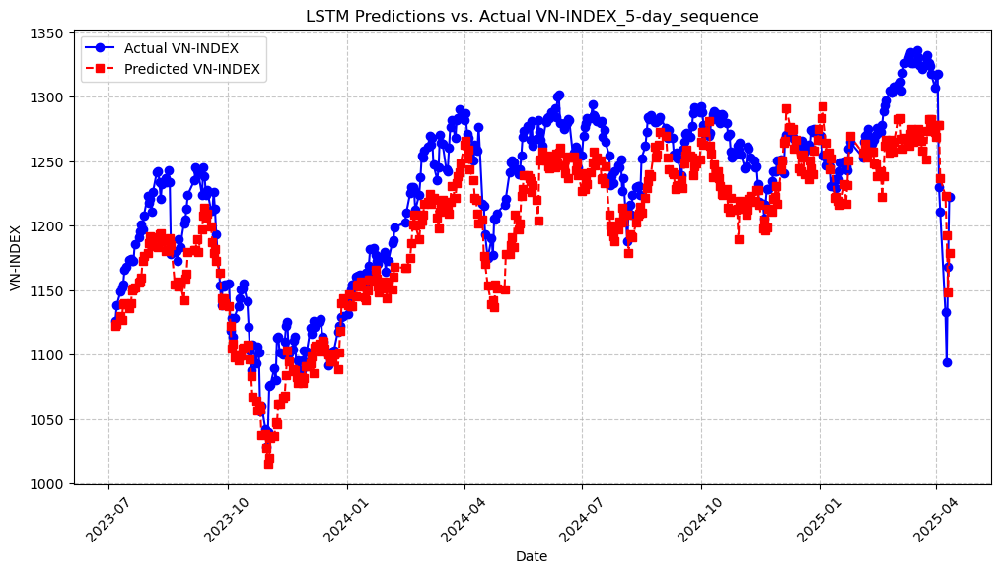

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-06      1126.219998         1122.577915
1   2023-07-07      1138.069969         1123.558052
2   2023-07-10      1149.020035         1129.713331
3   2023-07-11      1151.769999         1126.705943
4   2023-07-12      1154.200033         1139.406260
..         ...              ...                 ...
436 2025-04-04      1210.670016         1236.676289
437 2025-04-08      1132.790007         1223.180348
438 2025-04-09      1094.299993         1192.508848
439 2025-04-10      1168.339995         1147.941861
440 2025-04-11      1222.460024         1178.582223

[441 rows x 3 columns]


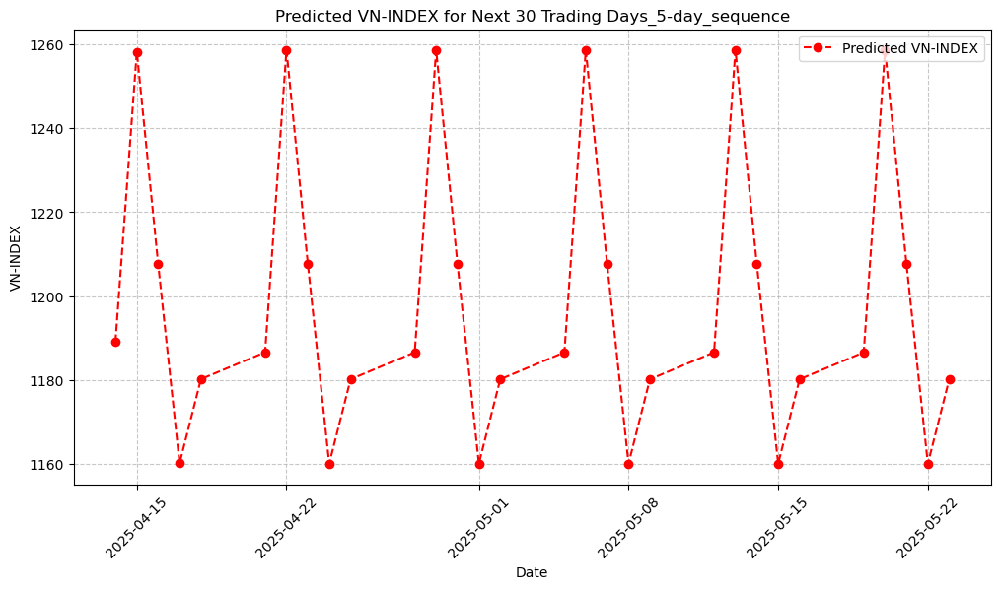

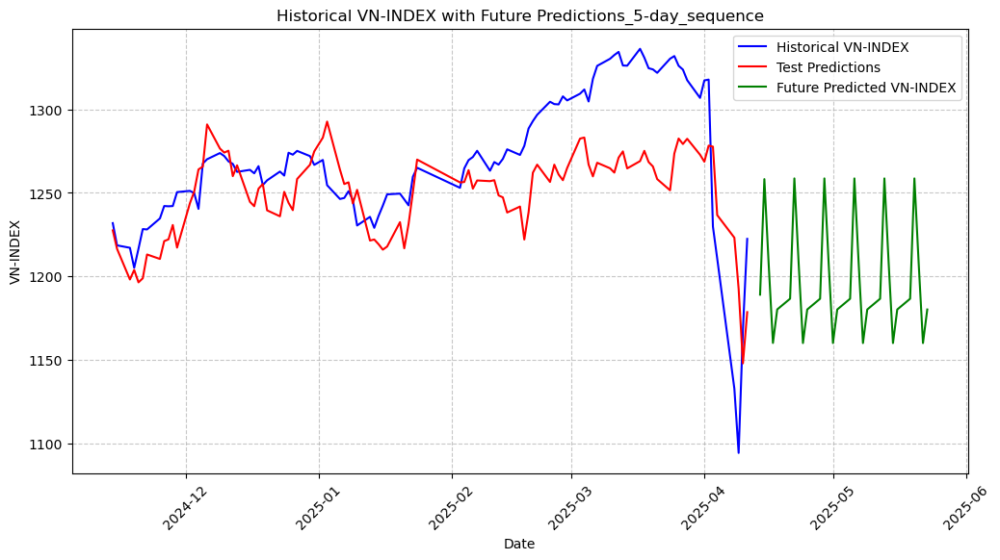

[I 2025-04-15 00:04:08,713] A new study created in memory with name: no-name-8a028a76-590a-4fc8-ae1b-c921fdc96a8a


         Date  Predicted VN-INDEX
0  2025-04-14         1189.061836
1  2025-04-15         1258.235451
2  2025-04-16         1207.586172
3  2025-04-17         1160.146059
4  2025-04-18         1180.223570
5  2025-04-21         1186.620318
6  2025-04-22         1258.662589
7  2025-04-23         1207.662629
8  2025-04-24         1160.085942
9  2025-04-25         1180.182104
10 2025-04-28         1186.616156
11 2025-04-29         1258.663051
12 2025-04-30         1207.662629
13 2025-05-01         1160.085942
14 2025-05-02         1180.182104
15 2025-05-05         1186.616156
16 2025-05-06         1258.663051
17 2025-05-07         1207.662629
18 2025-05-08         1160.085942
19 2025-05-09         1180.182104
20 2025-05-12         1186.616156
21 2025-05-13         1258.663051
22 2025-05-14         1207.662629
23 2025-05-15         1160.085942
24 2025-05-16         1180.182104
25 2025-05-19         1186.616156
26 2025-05-20         1258.663051
27 2025-05-21         1207.662629
28 2025-05-22 

/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.12309707763417044 and num_layers=1
  warnings.warn(
[I 2025-04-15 00:04:26,119] Trial 0 finished with value: 0.0005294409626130512 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.12309707763417044, 'learning_rate': 0.0003166019486602706, 'batch_size': 32}. Best is trial 0 with value: 0.0005294409626130512.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.14517209034126563 and num_layers=1
  warnings.warn(
[I 2025-04-15 00:04:37,904] Trial 1 finished with value: 0.000684130795876078 and parameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.14517209034126563, 'learning_rat

Best Hyperparameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.2939195480027686, 'learning_rate': 0.00014436829909525263, 'batch_size': 64}
Best Overall Average Training Loss: 0.0005
Final Evaluation Loss on Test Set: 0.0005
RMSE: 27.0105, MAE: 20.6669, R²: 0.8248, Directional Accuracy: 0.5402


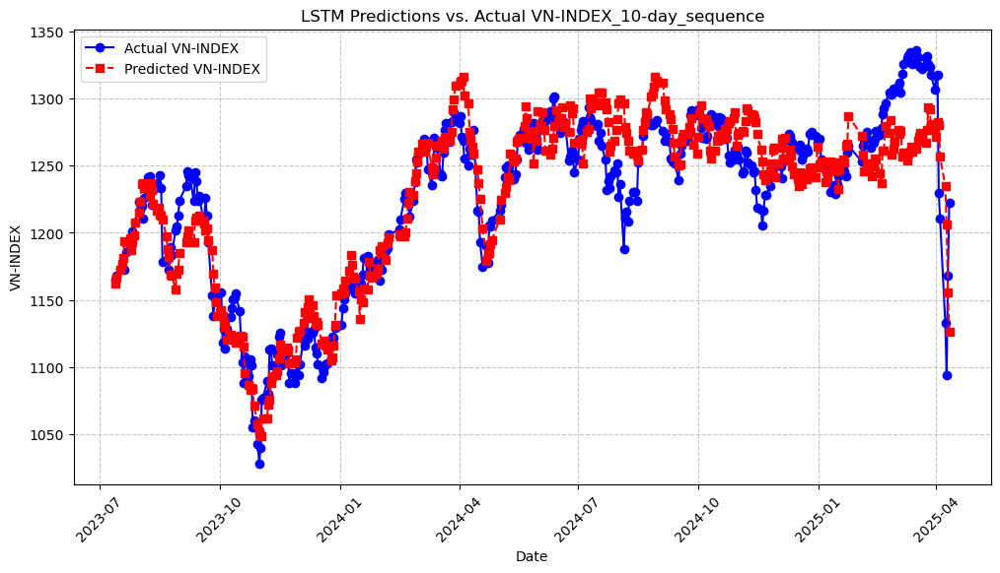

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-13      1165.420009         1162.168916
1   2023-07-14      1168.400035         1166.481920
2   2023-07-17      1173.130004         1172.696931
3   2023-07-18      1174.090025         1176.863496
4   2023-07-19      1172.980020         1181.595931
..         ...              ...                 ...
431 2025-04-04      1210.670016         1256.592563
432 2025-04-08      1132.790007         1234.676091
433 2025-04-09      1094.299993         1206.204639
434 2025-04-10      1168.339995         1155.318824
435 2025-04-11      1222.460024         1126.498771

[436 rows x 3 columns]


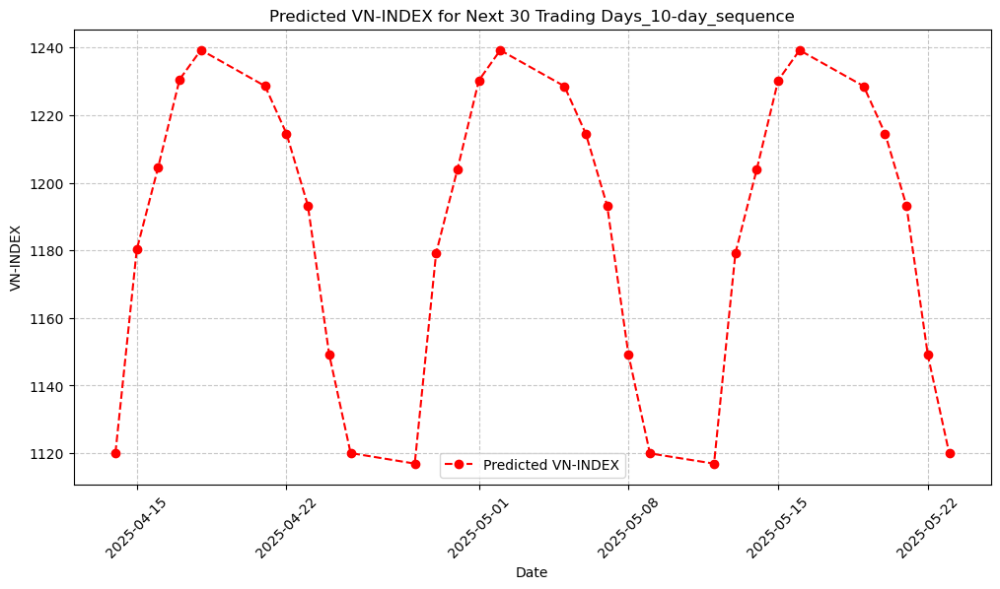

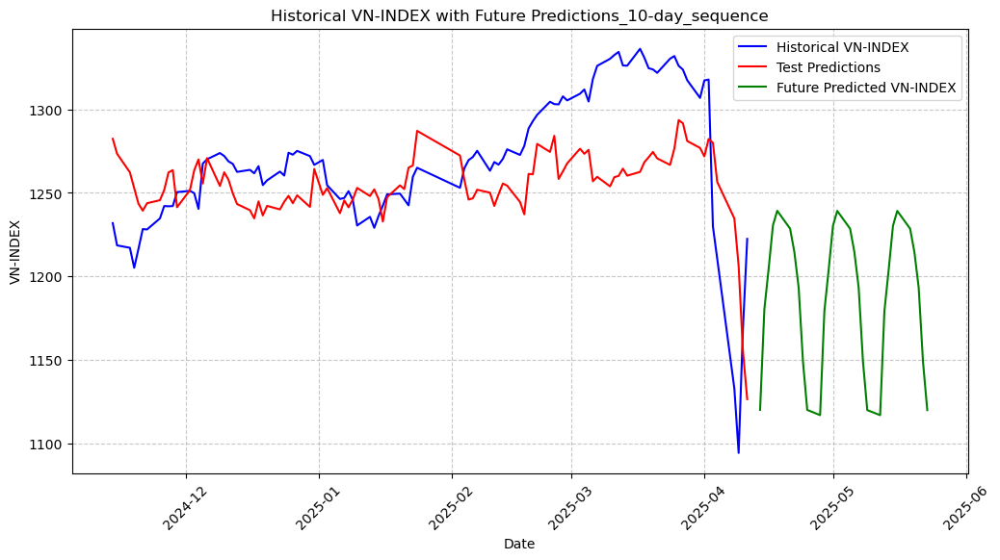

         Date  Predicted VN-INDEX
0  2025-04-14         1120.089151
1  2025-04-15         1180.302184
2  2025-04-16         1204.607225
3  2025-04-17         1230.550529
4  2025-04-18         1239.287367
5  2025-04-21         1228.604128
6  2025-04-22         1214.549639
7  2025-04-23         1193.301081
8  2025-04-24         1149.167475
9  2025-04-25         1120.046992
10 2025-04-28         1116.922300
11 2025-04-29         1179.203971
12 2025-04-30         1204.038503
13 2025-05-01         1230.291409
14 2025-05-02         1239.218464
15 2025-05-05         1228.568520
16 2025-05-06         1214.524205
17 2025-05-07         1193.231022
18 2025-05-08         1149.049554
19 2025-05-09         1119.949418
20 2025-05-12         1116.911355
21 2025-05-13         1179.198653
22 2025-05-14         1204.035420
23 2025-05-15         1230.289714
24 2025-05-16         1239.217462
25 2025-05-19         1228.567749
26 2025-05-20         1214.523665
27 2025-05-21         1193.230559
28 2025-05-22 

[I 2025-04-15 00:07:37,966] A new study created in memory with name: no-name-8c9dc40b-d9ed-4591-bfbb-d3aa6e4919de
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1606688175011966 and num_layers=1
  warnings.warn(
[I 2025-04-15 00:08:08,560] Trial 0 finished with value: 0.0010874137606651858 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.1606688175011966, 'learning_rate': 0.00043482178574360956, 'batch_size': 128}. Best is trial 0 with value: 0.0010874137606651858.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.32235769411259274 and num_layers=1
  warnings.warn(
[I 2025-04-15 00:08:29,908] Trial 1 finished with value: 0.00

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.16727294905251255, 'learning_rate': 0.0008173728131402963, 'batch_size': 32}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0005
RMSE: 25.6972, MAE: 19.4287, R²: 0.8431, Directional Accuracy: 0.5341


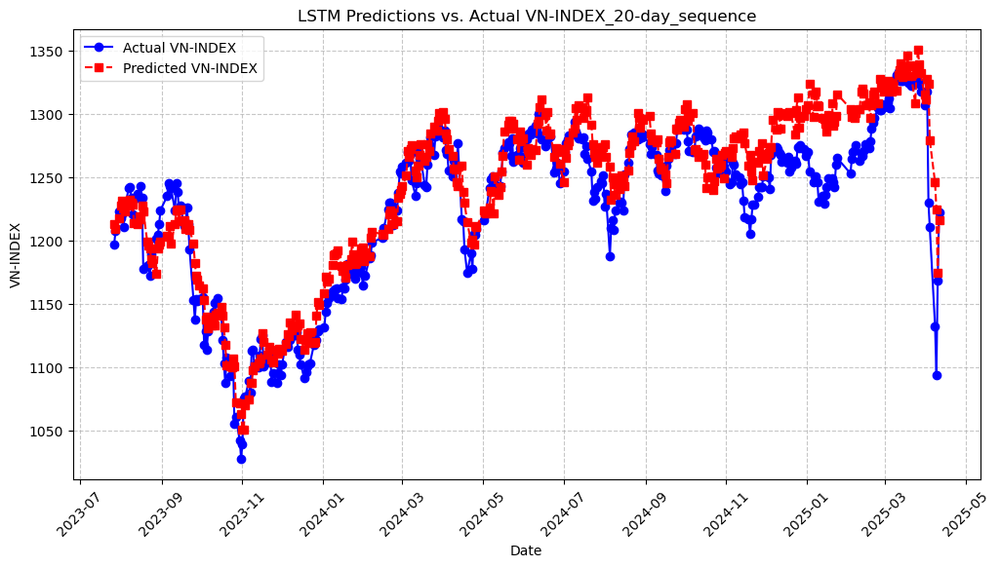

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-07-27      1197.329994         1212.701660
1   2023-07-28      1207.670028         1208.963004
2   2023-07-31      1222.900034         1217.932757
3   2023-08-01      1217.560032         1227.357164
4   2023-08-02      1220.429999         1231.314322
..         ...              ...                 ...
421 2025-04-04      1210.670016         1279.340421
422 2025-04-08      1132.790007         1245.792558
423 2025-04-09      1094.299993         1224.913334
424 2025-04-10      1168.339995         1174.628303
425 2025-04-11      1222.460024         1215.904505

[426 rows x 3 columns]


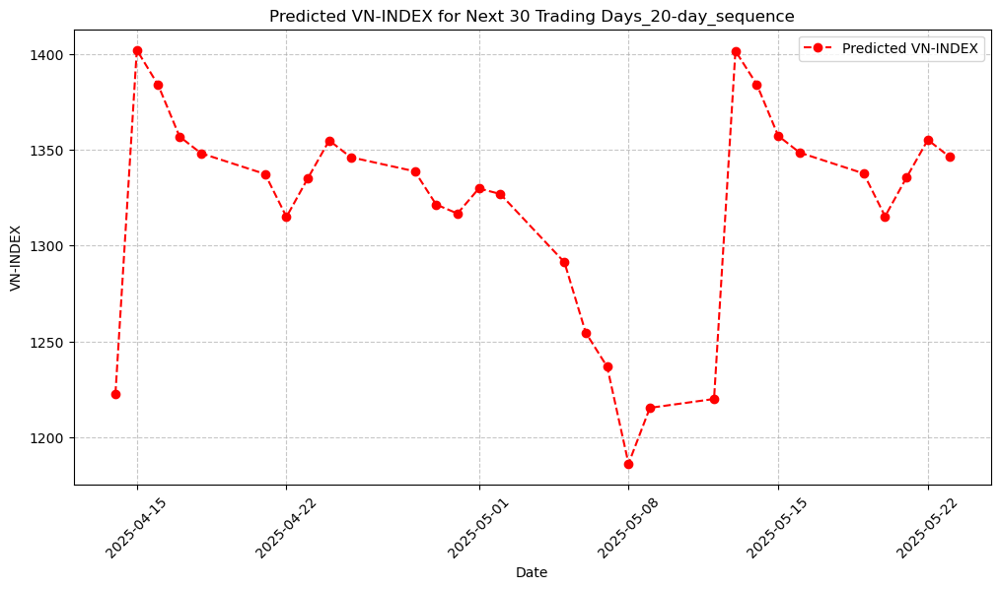

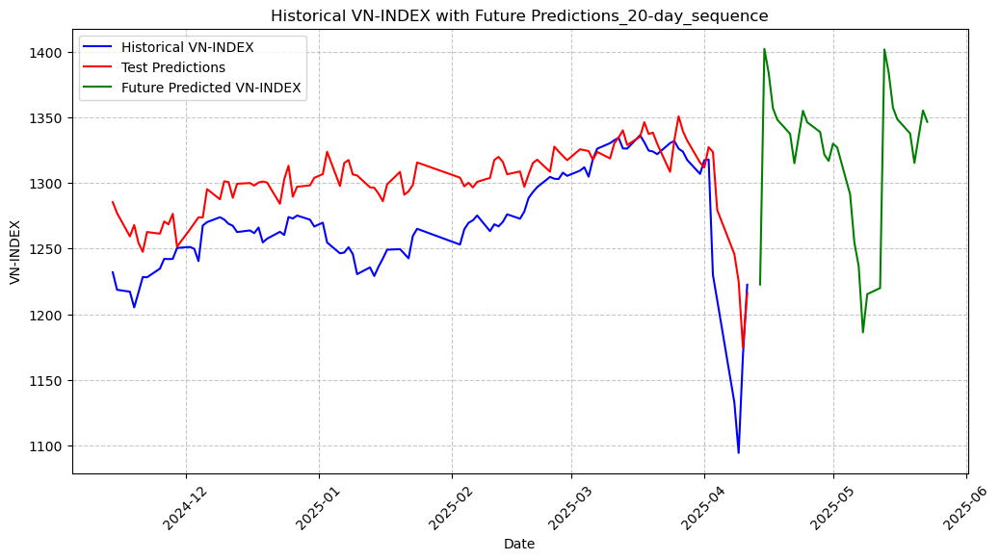

         Date  Predicted VN-INDEX
0  2025-04-14         1222.592204
1  2025-04-15         1402.160682
2  2025-04-16         1383.789875
3  2025-04-17         1356.927476
4  2025-04-18         1348.242353
5  2025-04-21         1337.364427
6  2025-04-22         1314.979891
7  2025-04-23         1335.153743
8  2025-04-24         1354.920573
9  2025-04-25         1346.168319
10 2025-04-28         1338.798062
11 2025-04-29         1321.453251
12 2025-04-30         1316.741625
13 2025-05-01         1329.848193
14 2025-05-02         1326.948014
15 2025-05-05         1291.338834
16 2025-05-06         1254.477295
17 2025-05-07         1236.741724
18 2025-05-08         1186.130057
19 2025-05-09         1215.268730
20 2025-05-12         1219.901586
21 2025-05-13         1401.630651
22 2025-05-14         1384.163217
23 2025-05-15         1357.355077
24 2025-05-16         1348.581166
25 2025-05-19         1337.659077
26 2025-05-20         1315.268761
27 2025-05-21         1335.459106
28 2025-05-22 

[I 2025-04-15 00:14:29,180] A new study created in memory with name: no-name-b19a62ff-e3be-4688-93e1-e6db6c65b375
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1869521177233876 and num_layers=1
  warnings.warn(
[I 2025-04-15 00:16:54,489] Trial 0 finished with value: 0.004878442760182225 and parameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.1869521177233876, 'learning_rate': 0.002177362524485708, 'batch_size': 128}. Best is trial 0 with value: 0.004878442760182225.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.23928089251809415 and num_layers=1
  warnings.warn(
[I 2025-04-15 00:17:59,874] Trial 1 finished with value: 0.000919

Best Hyperparameters: {'hidden_size': 256, 'num_layers': 1, 'dropout': 0.2770285625334638, 'learning_rate': 0.0002768052308001693, 'batch_size': 32}
Best Overall Average Training Loss: 0.0004
Final Evaluation Loss on Test Set: 0.0003
RMSE: 21.1171, MAE: 16.3336, R²: 0.8983, Directional Accuracy: 0.5630


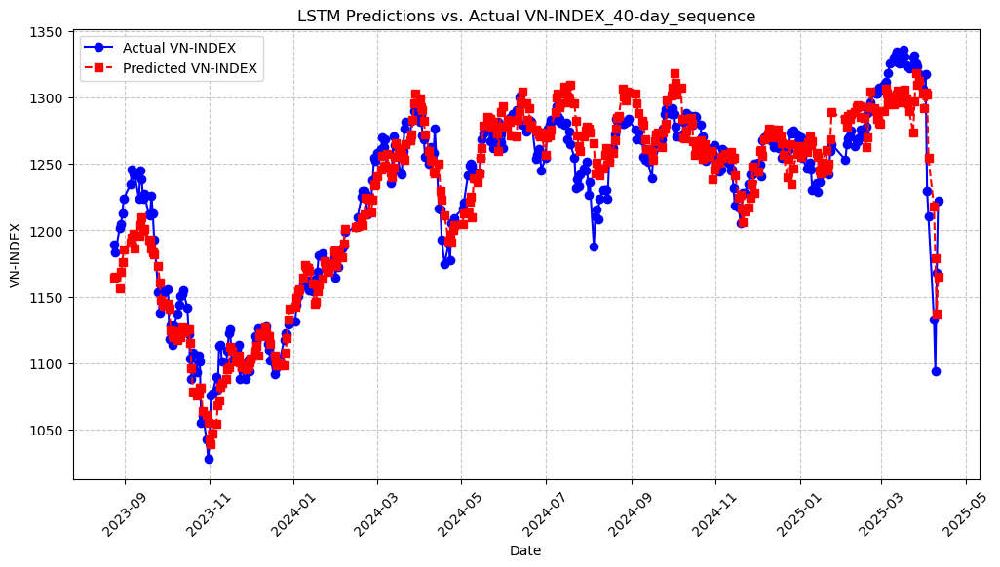

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-08-24      1189.390013         1164.705927
1   2023-08-25      1183.369997         1165.461474
2   2023-08-28      1201.719994         1156.221657
3   2023-08-29      1204.430034         1168.872570
4   2023-08-30      1213.160013         1176.263791
..         ...              ...                 ...
401 2025-04-04      1210.670016         1254.425040
402 2025-04-08      1132.790007         1217.770364
403 2025-04-09      1094.299993         1179.074180
404 2025-04-10      1168.339995         1137.194574
405 2025-04-11      1222.460024         1165.234725

[406 rows x 3 columns]


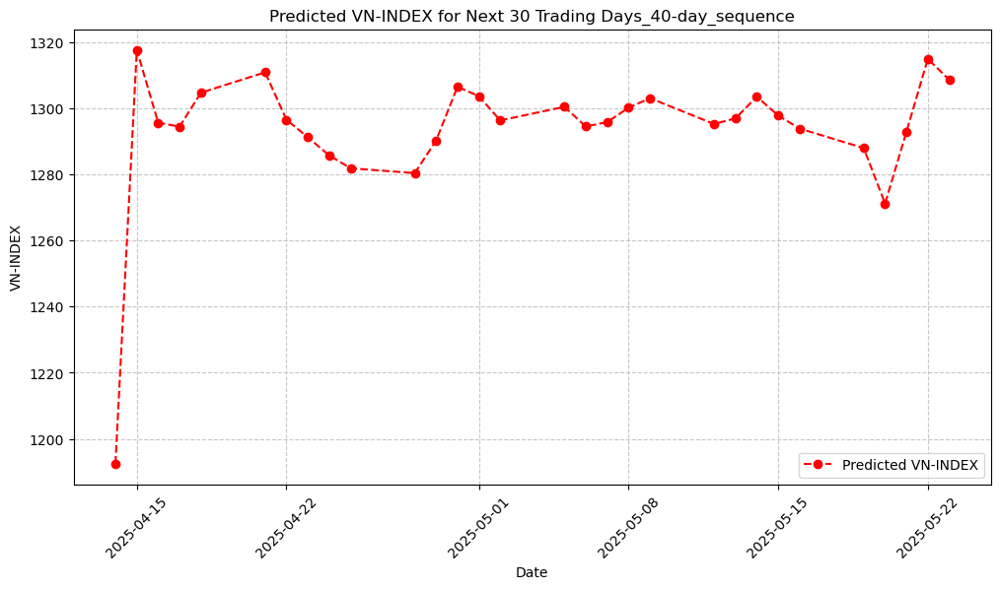

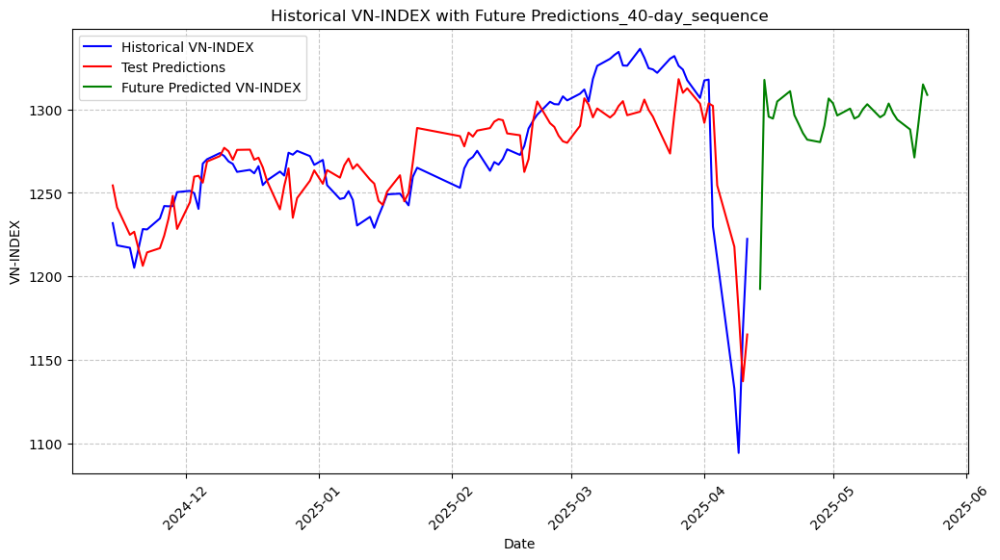

         Date  Predicted VN-INDEX
0  2025-04-14         1192.491584
1  2025-04-15         1317.653322
2  2025-04-16         1295.640817
3  2025-04-17         1294.465839
4  2025-04-18         1304.716853
5  2025-04-21         1310.891709
6  2025-04-22         1296.543264
7  2025-04-23         1291.222685
8  2025-04-24         1285.753278
9  2025-04-25         1281.859552
10 2025-04-28         1280.393161
11 2025-04-29         1290.264822
12 2025-04-30         1306.518588
13 2025-05-01         1303.661108
14 2025-05-02         1296.331236
15 2025-05-05         1300.455874
16 2025-05-06         1294.480175
17 2025-05-07         1295.843210
18 2025-05-08         1300.151898
19 2025-05-09         1303.075507
20 2025-05-12         1295.250750
21 2025-05-13         1296.959689
22 2025-05-14         1303.506576
23 2025-05-15         1297.828918
24 2025-05-16         1293.867907
25 2025-05-19         1287.967662
26 2025-05-20         1271.198046
27 2025-05-21         1292.904186
28 2025-05-22 

[I 2025-04-15 00:30:08,506] A new study created in memory with name: no-name-cd21f290-6347-40bf-8052-b9f3d30d1255
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2494962336026803 and num_layers=1
  warnings.warn(
[I 2025-04-15 00:31:59,920] Trial 0 finished with value: 0.00041558789943149936 and parameters: {'hidden_size': 128, 'num_layers': 1, 'dropout': 0.2494962336026803, 'learning_rate': 0.00039018875556880243, 'batch_size': 64}. Best is trial 0 with value: 0.00041558789943149936.
/opt/anaconda3/lib/python3.11/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.13921287871903984 and num_layers=1
  warnings.warn(
[I 2025-04-15 00:33:05,952] Trial 1 finished with value: 0.0

Best Hyperparameters: {'hidden_size': 64, 'num_layers': 1, 'dropout': 0.13921287871903984, 'learning_rate': 0.0005277250252709513, 'batch_size': 64}
Best Overall Average Training Loss: 0.0003
Final Evaluation Loss on Test Set: 0.0020
RMSE: 33.2178, MAE: 24.3696, R²: 0.7596, Directional Accuracy: 0.5169


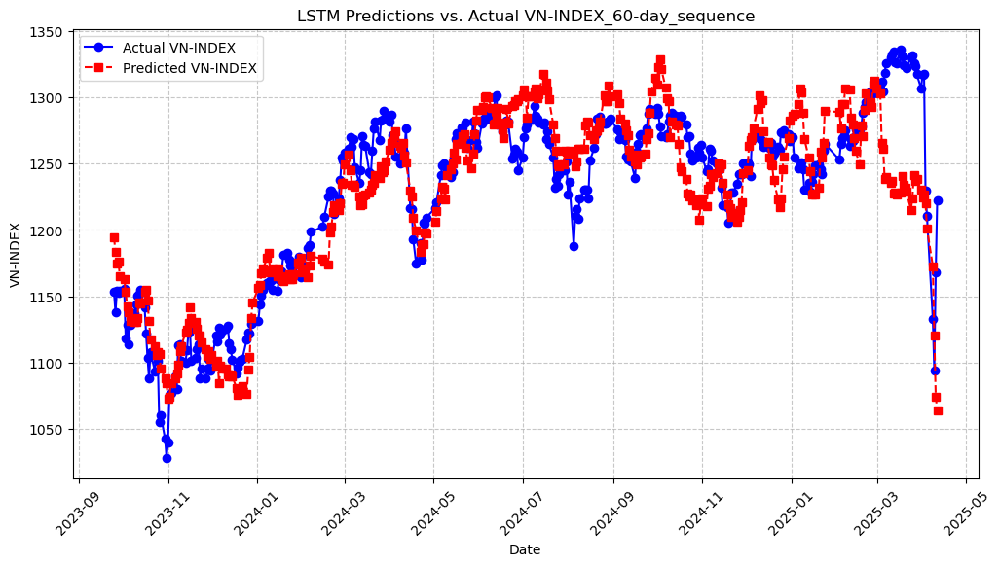

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-25      1153.200011         1194.521455
1   2023-09-26      1137.959985         1183.559211
2   2023-09-27      1153.849967         1174.409107
3   2023-09-28      1152.429975         1176.247837
4   2023-09-29      1154.150012         1165.373533
..         ...              ...                 ...
381 2025-04-04      1210.670016         1201.035971
382 2025-04-08      1132.790007         1172.725833
383 2025-04-09      1094.299993         1120.148189
384 2025-04-10      1168.339995         1074.390579
385 2025-04-11      1222.460024         1064.218795

[386 rows x 3 columns]


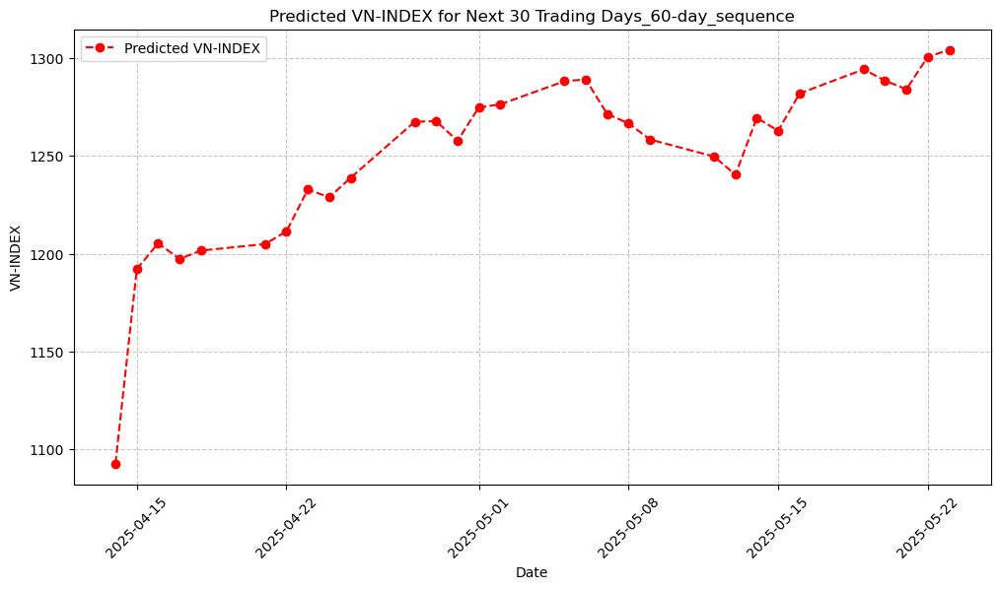

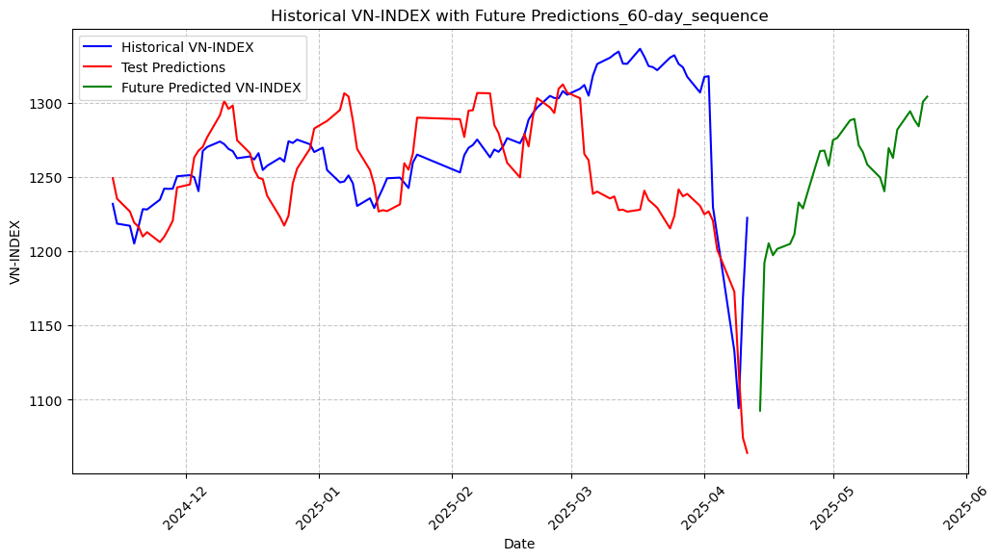

         Date  Predicted VN-INDEX
0  2025-04-14         1092.691480
1  2025-04-15         1192.097433
2  2025-04-16         1205.350516
3  2025-04-17         1197.290687
4  2025-04-18         1201.565231
5  2025-04-21         1204.933166
6  2025-04-22         1211.392113
7  2025-04-23         1232.803757
8  2025-04-24         1228.835115
9  2025-04-25         1238.761344
10 2025-04-28         1267.409370
11 2025-04-29         1267.732306
12 2025-04-30         1257.666575
13 2025-05-01         1274.784021
14 2025-05-02         1276.287638
15 2025-05-05         1288.139072
16 2025-05-06         1289.032579
17 2025-05-07         1271.402906
18 2025-05-08         1266.603264
19 2025-05-09         1258.367322
20 2025-05-12         1249.630946
21 2025-05-13         1240.351822
22 2025-05-14         1269.400011
23 2025-05-15         1262.804645
24 2025-05-16         1281.850996
25 2025-05-19         1294.220130
26 2025-05-20         1288.365744
27 2025-05-21         1284.056208
28 2025-05-22 

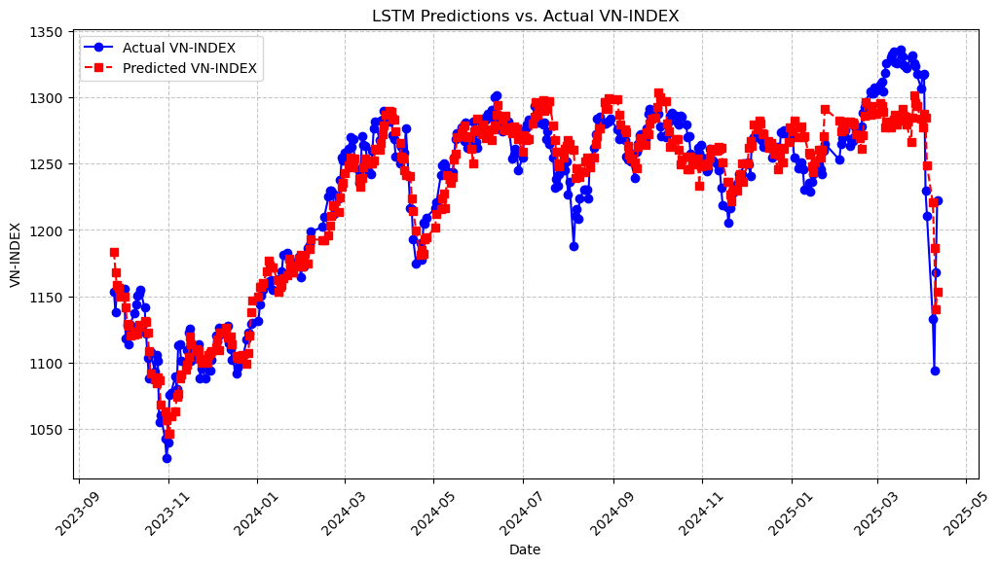

Predicted vs. Actual VN-INDEX (Test Set):
          Date  Actual VN-INDEX  Predicted VN-INDEX
0   2023-09-25      1153.200011         1183.418426
1   2023-09-26      1137.959985         1168.280723
2   2023-09-27      1153.849967         1158.206904
3   2023-09-28      1152.429975         1155.987465
4   2023-09-29      1154.150012         1149.988058
..         ...              ...                 ...
381 2025-04-04      1210.670016         1248.592443
382 2025-04-08      1132.790007         1220.596241
383 2025-04-09      1094.299993         1186.749410
384 2025-04-10      1168.339995         1140.173425
385 2025-04-11      1222.460024         1153.536860

[386 rows x 3 columns]


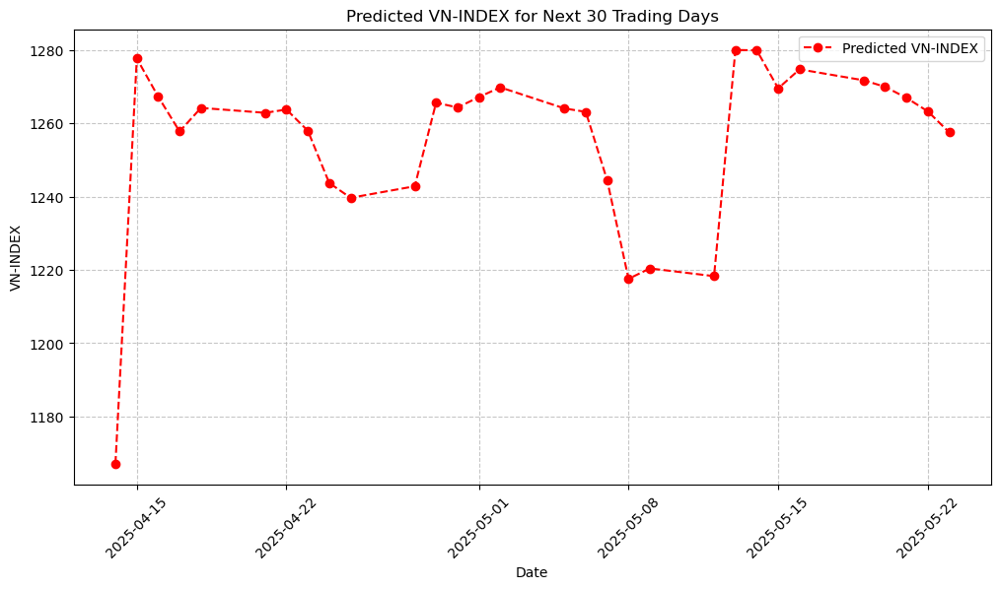

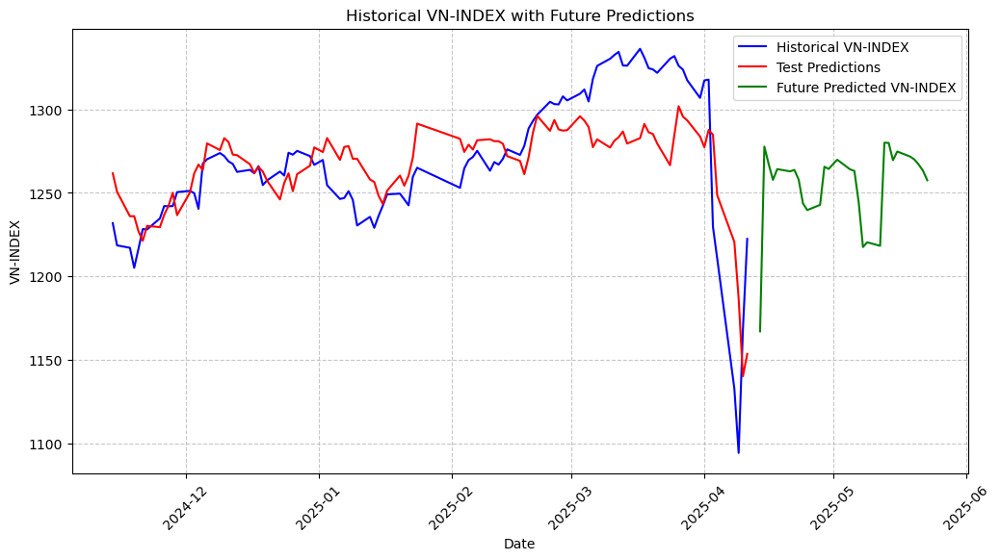


Ensemble Future Predictions (weighted average) for next 30 days:
         Date  Predicted Future VN-INDEX
0  2025-04-14                1167.116669
1  2025-04-15                1277.708146
2  2025-04-16                1267.294890
3  2025-04-17                1257.796267
4  2025-04-18                1264.223787
5  2025-04-21                1262.881062
6  2025-04-22                1263.776431
7  2025-04-23                1257.983778
8  2025-04-24                1243.730480
9  2025-04-25                1239.682873
10 2025-04-28                1242.834229
11 2025-04-29                1265.659185
12 2025-04-30                1264.333972
13 2025-05-01                1267.170134
14 2025-05-02                1269.837256
15 2025-05-05                1264.081685
16 2025-05-06                1263.139348
17 2025-05-07                1244.492039
18 2025-05-08                1217.566804
19 2025-05-09                1220.406017
20 2025-05-12                1218.294753
21 2025-05-13                128

In [20]:
data = lag_features_indicators(df_3, df_2.columns)

ensemble_lstm_model(data)